# Bricolage

## The Problem

## The Solution

1. Nodes = GND, VOUT, FEEDBACK, 2 $\times$ #resistors, 2 $\times$ #switches
1. $N =$ number of nodes.
1. Chromosome of length $N$.
1. Connection between nodes $i, j$ encoded by placing $j$ into element $i$ of the chromosome.

### Encoding the Circuit

In [86]:
from random import choice, choices, randint, shuffle
import numpy as np
import matplotlib.pyplot as plt
from skidl.pyspice import *

lib_search_paths[SPICE].append('SpiceLib')

@subcircuit
def vreg(vin, vout, vadj, gnd):
    '''Voltage regulator similar to NCP1117.'''
    
    # Fixed bandgap voltage of 1.25V.
    v_bandgap = v(dc_value=1.25 @ u_V)
    
    # Voltage source that replicates the difference between vout and vadj.
    v_oa = vcvs(gain=1.0)  # Gain=1 so output voltage == vout-vadj.
    v_oa['ip, in'] += vout, vadj  # Controlling voltage is vout-vadj.
    
    # Connect the bandgap and difference voltage sources in series
    # to generate the difference voltage v_bandgap - (vout-vadj).
    v_bandgap['p,n'] += v_oa['op'], gnd
    v_diff = v_oa['on']
    
    # Use a voltage-controlled current source to
    # generate a current from vout that keeps v_diff near zero
    # so (vout - vadj) == bandgap.
    i_out = G(gain=1e8 / (1 @ u_Ohm)) # Use high gain to keep v_diff small.
    i_out['ip, in'] += v_diff, gnd    # Current is controlled by size of v_diff.
    i_out['op, on'] += vout, gnd
    
    # The vadj pin should appear as a high impedance so connect a
    # current source that outputs a small current from the adjustment pin.
    i_adj = I(dc_value=50 @ u_uA)
    i_adj['p,n'] += vadj, gnd
    

def create_circuit(connections, resistor_values, num_switches, supply_voltage=20):
    
    global gnd
    
    # Voltage regulator.
    vin, vout, vadj = Net('VIN'), Net('VOUT'), Net('VADJ')
    vreg(vin, vout, vadj, gnd)
    
    # Power supply feeding the voltage regulator. (This is not really
    # needed when using the simplified vreg model above.)
    supply = V(dc_value=supply_voltage @ u_V)
    supply['p', 'n'] += vin, gnd
    
    # Resistors and switches for the voltage feedback.
    resistors = [R(value=resistance @ u_kOhm) for resistance in resistor_values]
    switches = S(dest=TEMPLATE) * num_switches
    
    # Create a list of circuit nodes whose interconnection will be determined by the chromosome.
    nodes = [gnd, vout, vadj]  # Start with ground and voltage regulator output and feedback.
    for r in resistors:
        nodes.extend(r[1,2])  # Add resistor terminals.
    for s in switches:
        nodes.extend(s['op, on'])  # Add switch terminals.
    
    # Create voltage pulse generators to control opening/closing of switches.
    period = 1
    for s in switches:
        open_close = PULSEV(initial_value=0, pulsed_value=1@u_V, pulse_width=0.5*period@u_ms, period=period@u_ms)
        s['ip, in'] += open_close['p, n']
        open_close['n'] += gnd
        period *= 2

    # Connect the nodes as indicated by the connection chromosome.
    for j, k in enumerate(connections):
        if int(k) >= 0:
            nodes[j] += nodes[int(k)]
    
    # Create big-ass resistors to tie every node to ground so nothing is dangling.
    if False:
        bars = R(value=10 @ u_GOhm, dest=TEMPLATE) * len(nodes)
        for node, bar in zip(nodes, bars):
            bar[1,2] += node, gnd

    return generate_netlist(libs='SpiceLib'), nodes, period/2.0

class Chromosome(list):
    def __init__(self, *args, **kwargs):
        super(Chromosome, self).__init__(*args, **kwargs)

def generate_random_chromosome(chromosome_class, resistor_values, num_switches):
    # Create a chromosome.
    num_resistors = len(resistor_values)
    num_nodes = 3 + 2*num_resistors + 2*num_switches # GND, Vout, Vadj, resistor terminals, switch terminals.
    while True:
        chromosome = list(range(num_nodes))
        shuffle(chromosome) # Each node gets connected to some other random node.
        fitness = evaluate_fitness(chromosome)
        if fitness[0] < 1000:
            break
    return chromosome_class(chromosome)

def generate_random_chromosome_2(chromosome_class, resistor_values, num_switches):
    # Create a chromosome.
    num_resistors = len(resistor_values)
    vreg_nodes = list(range(3))
    resistor_nodes = list(range(3, 3+num_resistors*2))
    switch_nodes = list(range(3+num_resistors*2, 3+num_resistors*2+num_switches*2))
    resistor_connects = resistor_nodes[:]
    shuffle(resistor_connects)
    switch_connects = resistor_nodes[:]
    shuffle(switch_connects)
    chromosome = choices(resistor_nodes, k=3) + resistor_connects + switch_connects
    print('fitness = ', evaluate_fitness(chromosome))
    return chromosome_class(chromosome)

def generate_random_chromosome_3(chromosome_class, resistor_values, num_switches):
    # Create a chromosome.
    num_nodes = 3 + 2 * len(resistor_values) + 2 * num_switches
    chromosome = [-1] * num_nodes
    nodes = list(range(num_nodes))
    shuffle(nodes)
    while nodes:
        try:
            n = randint(2, min(6,len(nodes)))
        except ValueError:
            n = len(nodes)
        connected_nodes = nodes[0:n]
        connected_nodes.append(-1)
        connections = zip(connected_nodes[:-1], connected_nodes[1:])
        for src, dest in connections:
            chromosome[src] = dest
        nodes = nodes[n:]
        print(nodes)
    print('fitness = ', evaluate_fitness(chromosome))
    return chromosome_class(chromosome)

def perturb_chromosome(chrmsm):
    a = 0
    b = len(chrmsm)-1
    gene1 = randint(a,b)
    gene2 = randint(a,b)
#    chrmsm[gene1] = gene2 # Move connection to a random node. Seems worse than swap.
    chrmsm[gene1], chrmsm[gene2] = chrmsm[gene2], chrmsm[gene1] # Swap random connections.
    return chrmsm

### Evaluating the Circuit

In [87]:
def objective_function(generated_voltages, low_voltage, high_voltage, voltage_step):
    try:
        desired_voltages = np.arange(low_voltage, high_voltage+voltage_step, voltage_step)
        obj_value = 0
        for dv in desired_voltages:
            min_diff = float('inf')
            for gv in generated_voltages:
                min_diff = min(min_diff, abs(dv-gv))
            obj_value += min_diff
        return obj_value
    except Exception:
        return 1.0e8
        return float('inf')

def evaluate_fitness(connections):
    try:
        reset()
        global gnd, GND
        GND = gnd = Net('0')
        circ, nodes, sim_time = create_circuit(connections, resistor_values, num_switches, supply_voltage)
        #print(circ)
        sim = circ.simulator()
        step_time = 0.01 @ u_ms
        waveforms = sim.transient(step_time=step_time, end_time=sim_time@u_ms)
        vout = waveforms[node(nodes[1])]
        vout_levels = set()
        last_v = vout[0]
        stable_cnt = 1
        stable_thresh = (0.5@u_ms / step_time) // 2
        noise = 0.01 @ u_V
        for v in vout[1:]:
            if last_v - noise <= v <= last_v + noise:
                stable_cnt += 1
                if stable_cnt >= stable_thresh:
                    vout_levels.add(round(v.value,2))
            else:
                stable_cnt = 1
                last_v = v
        print('.', end='')
        return (objective_function(vout_levels, 1.25, 4.0, 0.1),)
    except:
        print('!', end='')
        return (1.0e8,)
        return (float('inf'),)
    

### Running the Basin Hopper

In [65]:
from scipy.optimize import basinhopping, OptimizeResult

def null_minimizer(fun, x0, args, **kwargs):
    return OptimizeResult(x=x0, fun=fun(x0)[0], success=True)

resistor_values = [1,1,1,1,1,1,1,1]
num_switches = 8
num_nodes = 2 * (num_switches + len(resistor_values)) + 3
supply_voltage = 9 @ u_V

solutions = []

for i in range(10):
    init_connections = np.array(generate_random_chromosome_3(Chromosome, resistor_values, num_switches))
    solutions.append(basinhopping(evaluate_fitness, init_connections, niter=1500, take_step=perturb_chromosome, 
                        minimizer_kwargs={'method':null_minimizer}, disp=True))
    print(i, solutions[-1])

[19, 10, 12, 1, 20, 30, 24, 0, 26, 32, 3, 7, 25, 23, 11, 33, 14, 15, 4, 31, 17, 8, 13, 18, 27, 2, 21, 5, 29, 6, 22, 16]
[30, 24, 0, 26, 32, 3, 7, 25, 23, 11, 33, 14, 15, 4, 31, 17, 8, 13, 18, 27, 2, 21, 5, 29, 6, 22, 16]
[7, 25, 23, 11, 33, 14, 15, 4, 31, 17, 8, 13, 18, 27, 2, 21, 5, 29, 6, 22, 16]
[33, 14, 15, 4, 31, 17, 8, 13, 18, 27, 2, 21, 5, 29, 6, 22, 16]
[17, 8, 13, 18, 27, 2, 21, 5, 29, 6, 22, 16]
[21, 5, 29, 6, 22, 16]
[22, 16]
[]


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.fitness =  (26.60000000000003,)


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 0: f 3.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1: f 3.52 trial_f 3.52 accepted 1  lowest_f 3.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0190182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 2: f 3.52 trial_f 31.42 accepted 0  lowest_f 3.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 3: f 3.52 trial_f 7.49 accepted 0  lowest_f 3.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 4: f 3.52 trial_f 4.33 accepted 0  lowest_f 3.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 5: f 3.52 trial_f 1e+08 accepted 0  lowest_f 3.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 6: f 3.52 trial_f 3.52 accepted 1  lowest_f 3.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 7: f 3.52 trial_f 76.85 accepted 0  lowest_f 3.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 8: f 3.52 trial_f 1e+08 accepted 0  lowest_f 3.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 9: f 3.52 trial_f 26.6 accepted 0  lowest_f 3.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 10: f 3.52 trial_f 40.6 accepted 0  lowest_f 3.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0365183, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 11: f 3.52 trial_f 40.6 accepted 0  lowest_f 3.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 12: f 3.52 trial_f 1e+08 accepted 0  lowest_f 3.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 13: f 3.52 trial_f 16.54 accepted 0  lowest_f 3.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 14: f 3.99 trial_f 3.99 accepted 1  lowest_f 3.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 15: f 3.99 trial_f 1e+08 accepted 0  lowest_f 3.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00351829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 16: f 3.99 trial_f 40.6 accepted 0  lowest_f 3.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 17: f 3.99 trial_f 40.6 accepted 0  lowest_f 3.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 18: f 3.75 trial_f 3.75 accepted 1  lowest_f 3.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 19: f 3.75 trial_f 5.28 accepted 0  lowest_f 3.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 20: f 3.75 trial_f 42.05 accepted 0  lowest_f 3.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 21: f 2.25 trial_f 2.25 accepted 1  lowest_f 2.25
found new global minimum on step 21 with function value 2.25


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 22: f 2.25 trial_f 1e+08 accepted 0  lowest_f 2.25


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 23: f 2.25 trial_f 4.19 accepted 0  lowest_f 2.25


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 24: f 2.25 trial_f 16.95 accepted 0  lowest_f 2.25


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 25: f 2.25 trial_f 5.04 accepted 0  lowest_f 2.25


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 26: f 2.25 trial_f 4.37 accepted 0  lowest_f 2.25


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 27: f 2.25 trial_f 4.07 accepted 0  lowest_f 2.25


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 28: f 2.25 trial_f 1e+08 accepted 0  lowest_f 2.25


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 29: f 2.25 trial_f 76.85 accepted 0  lowest_f 2.25


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 30: f 2.25 trial_f 3.61 accepted 0  lowest_f 2.25


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 31: f 2.25 trial_f 4.99 accepted 0  lowest_f 2.25


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 32: f 2.2 trial_f 2.2 accepted 1  lowest_f 2.2
found new global minimum on step 32 with function value 2.2


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 33: f 2.2 trial_f 1e+08 accepted 0  lowest_f 2.2


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 34: f 2.15 trial_f 2.15 accepted 1  lowest_f 2.15
found new global minimum on step 34 with function value 2.15


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 35: f 2.15 trial_f 2.15 accepted 1  lowest_f 2.15
found new global minimum on step 35 with function value 2.15


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 36: f 2.15 trial_f 1e+08 accepted 0  lowest_f 2.15


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 37: f 2.15 trial_f 1e+08 accepted 0  lowest_f 2.15


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 38: f 2.15 trial_f 6.84 accepted 0  lowest_f 2.15


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00201821, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 39: f 2.15 trial_f 40.32 accepted 0  lowest_f 2.15


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 40: f 2.15 trial_f 5.42 accepted 0  lowest_f 2.15


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 41: f 2.15 trial_f 3.22 accepted 0  lowest_f 2.15


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 42: f 2.15 trial_f 3.43 accepted 0  lowest_f 2.15


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 43: f 2.15 trial_f 1e+08 accepted 0  lowest_f 2.15


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 44: f 2.15 trial_f 40.6 accepted 0  lowest_f 2.15


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 45: f 2.15 trial_f 1e+08 accepted 0  lowest_f 2.15


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11902, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 46: f 2.08 trial_f 2.08 accepted 1  lowest_f 2.08
found new global minimum on step 46 with function value 2.08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 47: f 2.08 trial_f 76.85 accepted 0  lowest_f 2.08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 48: f 2.08 trial_f 3.64 accepted 0  lowest_f 2.08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 49: f 2.08 trial_f 2.56 accepted 0  lowest_f 2.08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 50: f 2.08 trial_f 5.86 accepted 0  lowest_f 2.08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 51: f 2.08 trial_f 11.64 accepted 0  lowest_f 2.08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 52: f 1.76 trial_f 1.76 accepted 1  lowest_f 1.76
found new global minimum on step 52 with function value 1.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 53: f 1.76 trial_f 11.93 accepted 0  lowest_f 1.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 54: f 1.76 trial_f 1.76 accepted 1  lowest_f 1.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 55: f 2.26 trial_f 2.26 accepted 1  lowest_f 1.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 56: f 2.26 trial_f 13.3 accepted 0  lowest_f 1.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 57: f 2.26 trial_f 5.54 accepted 0  lowest_f 1.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 58: f 2.26 trial_f 13.26 accepted 0  lowest_f 1.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 59: f 2.26 trial_f 1e+08 accepted 0  lowest_f 1.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 60: f 2.26 trial_f 76.85 accepted 0  lowest_f 1.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 61: f 2.26 trial_f 8.16 accepted 0  lowest_f 1.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 62: f 2.09 trial_f 2.09 accepted 1  lowest_f 1.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 63: f 2.09 trial_f 1e+08 accepted 0  lowest_f 1.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 64: f 2.08 trial_f 2.08 accepted 1  lowest_f 1.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 65: f 2.29 trial_f 2.29 accepted 1  lowest_f 1.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 66: f 2.29 trial_f 3.1 accepted 0  lowest_f 1.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 67: f 2.29 trial_f 8.51 accepted 0  lowest_f 1.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 68: f 2.29 trial_f 6.18 accepted 0  lowest_f 1.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 69: f 2.29 trial_f 1e+08 accepted 0  lowest_f 1.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 70: f 2.15 trial_f 2.15 accepted 1  lowest_f 1.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 71: f 2.15 trial_f 1e+08 accepted 0  lowest_f 1.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 72: f 1.73 trial_f 1.73 accepted 1  lowest_f 1.73
found new global minimum on step 72 with function value 1.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.037, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 73: f 1.73 trial_f 8.85 accepted 0  lowest_f 1.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 74: f 1.73 trial_f 1.73 accepted 1  lowest_f 1.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 75: f 1.73 trial_f 40.6 accepted 0  lowest_f 1.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 76: f 2.6 trial_f 2.6 accepted 1  lowest_f 1.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 77: f 2.6 trial_f 7.77 accepted 0  lowest_f 1.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 78: f 2.6 trial_f 9.29 accepted 0  lowest_f 1.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 79: f 2.6 trial_f 26.88 accepted 0  lowest_f 1.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 80: f 2.6 trial_f 9.16 accepted 0  lowest_f 1.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 81: f 1.87 trial_f 1.87 accepted 1  lowest_f 1.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 82: f 1.87 trial_f 1.87 accepted 1  lowest_f 1.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 83: f 1.87 trial_f 1e+08 accepted 0  lowest_f 1.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 84: f 1.87 trial_f 1e+08 accepted 0  lowest_f 1.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 85: f 1.87 trial_f 6.33 accepted 0  lowest_f 1.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 86: f 1.87 trial_f 1.87 accepted 1  lowest_f 1.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 87: f 1.87 trial_f 1e+08 accepted 0  lowest_f 1.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 88: f 1.87 trial_f 1.87 accepted 1  lowest_f 1.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 89: f 2.12 trial_f 2.12 accepted 1  lowest_f 1.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 90: f 2.12 trial_f 1e+08 accepted 0  lowest_f 1.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 91: f 2.12 trial_f 7.6 accepted 0  lowest_f 1.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 92: f 2.12 trial_f 29.1 accepted 0  lowest_f 1.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 93: f 2.12 trial_f 1e+08 accepted 0  lowest_f 1.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 94: f 2.12 trial_f 1e+08 accepted 0  lowest_f 1.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 95: f 2.12 trial_f 1e+08 accepted 0  lowest_f 1.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01852, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 96: f 2.12 trial_f 3.58 accepted 0  lowest_f 1.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 97: f 2.12 trial_f 1e+08 accepted 0  lowest_f 1.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06252, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 98: f 2.12 trial_f 13.09 accepted 0  lowest_f 1.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 99: f 2.12 trial_f 76.85 accepted 0  lowest_f 1.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

Supplies reduced to   0.5750% Note: One successful source step
Supplies reduced to   0.9125% Note: One successful source step
Supplies reduced to   1.4188% Note: One successful source step
Supplies reduced to   2.1781% Note: One successful source step
Supplies reduced to   3.3172% Note: One successful source step
Supplies reduced to   5.0258% Note: One successful source step
Supplies reduced to   7.5887% Note: One successful source step
Supplies reduced to  11.4330% Note: One successful source step
Supplies reduced to  17.1995% Note: One successful source step
Supplies reduced to  25.8493% Note: One successful source step
Supplies reduced to  38.8239% Note: One successful source step
Supplies reduced to  58.2859% Note: One successful source step
Supplies reduced to  87.4788% Note: One successful source step
Supplies reduced to 100.0000% Note: One successful source step
Note: Source stepping completed
doAnalyses: TRAN:  Timestep too small; time = 0.00552, timestep = 1.25e-17: trouble wi

.basinhopping step 100: f 2.12 trial_f 14.84 accepted 0  lowest_f 1.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 101: f 2.12 trial_f 1e+08 accepted 0  lowest_f 1.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 102: f 2.12 trial_f 1e+08 accepted 0  lowest_f 1.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 103: f 2.12 trial_f 9.28 accepted 0  lowest_f 1.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00151829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 104: f 2.12 trial_f 28.2 accepted 0  lowest_f 1.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 105: f 2.12 trial_f 25.64 accepted 0  lowest_f 1.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 106: f 2.12 trial_f 1e+08 accepted 0  lowest_f 1.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0340182, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 107: f 2.12 trial_f 15.05 accepted 0  lowest_f 1.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 108: f 2.12 trial_f 5.4 accepted 0  lowest_f 1.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 109: f 2.12 trial_f 9.63 accepted 0  lowest_f 1.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01852, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 110: f 2.12 trial_f 3.58 accepted 0  lowest_f 1.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 111: f 1.82 trial_f 1.82 accepted 1  lowest_f 1.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 112: f 1.82 trial_f 1e+08 accepted 0  lowest_f 1.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 113: f 1.82 trial_f 8.49 accepted 0  lowest_f 1.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 114: f 1.82 trial_f 1e+08 accepted 0  lowest_f 1.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 115: f 1.82 trial_f 1e+08 accepted 0  lowest_f 1.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01852, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 116: f 1.82 trial_f 4.07 accepted 0  lowest_f 1.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 117: f 1.82 trial_f 1e+08 accepted 0  lowest_f 1.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 118: f 1.82 trial_f 1e+08 accepted 0  lowest_f 1.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 119: f 1.82 trial_f 25.77 accepted 0  lowest_f 1.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 120: f 1.82 trial_f 76.85 accepted 0  lowest_f 1.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 121: f 1.72 trial_f 1.72 accepted 1  lowest_f 1.72
found new global minimum on step 121 with function value 1.72


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 122: f 1.72 trial_f 1.72 accepted 1  lowest_f 1.72


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 123: f 1.72 trial_f 1.72 accepted 1  lowest_f 1.72


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 124: f 1.72 trial_f 1e+08 accepted 0  lowest_f 1.72


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 125: f 1.72 trial_f 20.17 accepted 0  lowest_f 1.72


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 126: f 1.72 trial_f 75.11 accepted 0  lowest_f 1.72


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 127: f 1.72 trial_f 1e+08 accepted 0  lowest_f 1.72


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 128: f 1.72 trial_f 1e+08 accepted 0  lowest_f 1.72


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 129: f 1.72 trial_f 7.38 accepted 0  lowest_f 1.72


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 130: f 1.72 trial_f 1e+08 accepted 0  lowest_f 1.72


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 131: f 1.72 trial_f 4.17 accepted 0  lowest_f 1.72


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 132: f 1.72 trial_f 1.72 accepted 1  lowest_f 1.72


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 133: f 1.72 trial_f 4.17 accepted 0  lowest_f 1.72


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 134: f 1.72 trial_f 15.09 accepted 0  lowest_f 1.72


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 135: f 1.72 trial_f 40.6 accepted 0  lowest_f 1.72


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 136: f 1.72 trial_f 76.85 accepted 0  lowest_f 1.72


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 137: f 1.72 trial_f 14.76 accepted 0  lowest_f 1.72


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 138: f 1.72 trial_f 29.1 accepted 0  lowest_f 1.72


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 139: f 1.81 trial_f 1.81 accepted 1  lowest_f 1.72


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 140: f 1.81 trial_f 3.96 accepted 0  lowest_f 1.72


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 141: f 1.76 trial_f 1.76 accepted 1  lowest_f 1.72


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 142: f 1.76 trial_f 40.6 accepted 0  lowest_f 1.72


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 143: f 1.76 trial_f 1e+08 accepted 0  lowest_f 1.72


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 144: f 1.76 trial_f 1e+08 accepted 0  lowest_f 1.72


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06852, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 145: f 1.76 trial_f 15.24 accepted 0  lowest_f 1.72


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 146: f 1.76 trial_f 29.1 accepted 0  lowest_f 1.72


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.12102, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 147: f 2.42 trial_f 2.42 accepted 1  lowest_f 1.72


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.12102, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 148: f 2.42 trial_f 4.54 accepted 0  lowest_f 1.72


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.12302, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 149: f 2.42 trial_f 2.42 accepted 1  lowest_f 1.72


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 150: f 2.42 trial_f 4.9 accepted 0  lowest_f 1.72


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.12302, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 151: f 2.42 trial_f 10.64 accepted 0  lowest_f 1.72


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 152: f 2.42 trial_f 14.22 accepted 0  lowest_f 1.72


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07202, timestep = 1.25e-17: trouble with S-instance s5
run simulation(s) aborted


.basinhopping step 153: f 4.02 trial_f 4.02 accepted 1  lowest_f 1.72


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 154: f 1.49 trial_f 1.49 accepted 1  lowest_f 1.49
found new global minimum on step 154 with function value 1.49


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 155: f 1.49 trial_f 2.1 accepted 0  lowest_f 1.49


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 156: f 1.49 trial_f 1.49 accepted 1  lowest_f 1.49


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 157: f 1.49 trial_f 1e+08 accepted 0  lowest_f 1.49


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.03152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 158: f 1.49 trial_f 12.88 accepted 0  lowest_f 1.49


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 159: f 1.49 trial_f 1e+08 accepted 0  lowest_f 1.49


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 160: f 1.49 trial_f 2.83 accepted 0  lowest_f 1.49


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 161: f 1.49 trial_f 1.49 accepted 1  lowest_f 1.49


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 162: f 1.49 trial_f 1e+08 accepted 0  lowest_f 1.49


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 163: f 1.5 trial_f 1.5 accepted 1  lowest_f 1.49


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 164: f 1.5 trial_f 1e+08 accepted 0  lowest_f 1.49


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 165: f 1.54 trial_f 1.54 accepted 1  lowest_f 1.49


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 166: f 1.54 trial_f 1e+08 accepted 0  lowest_f 1.49


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 167: f 1.54 trial_f 2.48 accepted 0  lowest_f 1.49


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 168: f 1.79 trial_f 1.79 accepted 1  lowest_f 1.49


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 169: f 1.28 trial_f 1.28 accepted 1  lowest_f 1.28
found new global minimum on step 169 with function value 1.28


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 170: f 1.31 trial_f 1.31 accepted 1  lowest_f 1.28


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 171: f 1.31 trial_f 1.31 accepted 1  lowest_f 1.28


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 172: f 1.31 trial_f 2.11 accepted 0  lowest_f 1.28


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 173: f 1.54 trial_f 1.54 accepted 1  lowest_f 1.28


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 174: f 1.54 trial_f 1e+08 accepted 0  lowest_f 1.28


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 175: f 1.54 trial_f 1.54 accepted 1  lowest_f 1.28


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 176: f 3.68 trial_f 3.68 accepted 1  lowest_f 1.28


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 177: f 3.68 trial_f 7.97 accepted 0  lowest_f 1.28


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 178: f 4.91 trial_f 4.91 accepted 1  lowest_f 1.28


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 179: f 3.18 trial_f 3.18 accepted 1  lowest_f 1.28


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 180: f 2.49 trial_f 2.49 accepted 1  lowest_f 1.28


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 181: f 2.49 trial_f 1e+08 accepted 0  lowest_f 1.28


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 182: f 2.49 trial_f 2.49 accepted 1  lowest_f 1.28


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 183: f 2.49 trial_f 3.79 accepted 0  lowest_f 1.28


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 184: f 1.21 trial_f 1.21 accepted 1  lowest_f 1.21
found new global minimum on step 184 with function value 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 185: f 1.21 trial_f 31 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 186: f 1.21 trial_f 1e+08 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01002, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 187: f 1.21 trial_f 21.02 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 188: f 3.17 trial_f 3.17 accepted 1  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 189: f 3.17 trial_f 1e+08 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 190: f 3.17 trial_f 3.17 accepted 1  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 191: f 3.17 trial_f 6.14 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 192: f 3.17 trial_f 1e+08 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 193: f 3.17 trial_f 6.14 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 194: f 1 trial_f 1 accepted 1  lowest_f 1
found new global minimum on step 194 with function value 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 195: f 1 trial_f 1.43 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 196: f 1.28 trial_f 1.28 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10302, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 197: f 1.28 trial_f 3.77 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 198: f 1.28 trial_f 1e+08 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 199: f 1.51 trial_f 1.51 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 200: f 1.51 trial_f 1e+08 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07902, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 201: f 2.33 trial_f 2.33 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 202: f 1.43 trial_f 1.43 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 203: f 1.43 trial_f 1.76 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 204: f 1.35 trial_f 1.35 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 205: f 1.24 trial_f 1.24 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 206: f 1.24 trial_f 76.85 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 207: f 1.24 trial_f 1e+08 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 208: f 1.24 trial_f 1e+08 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 209: f 1.24 trial_f 32.89 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0530182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 210: f 1.24 trial_f 4.03 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 211: f 1.24 trial_f 36.01 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 212: f 1.24 trial_f 1.24 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 213: f 1.24 trial_f 2.18 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 214: f 1.24 trial_f 25.41 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 215: f 1.24 trial_f 4.01 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 216: f 1.24 trial_f 1.24 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0335183, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 217: f 1.24 trial_f 21.12 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 218: f 1.24 trial_f 1e+08 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 219: f 1.24 trial_f 10342 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 220: f 1.24 trial_f 8.84 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 221: f 1.24 trial_f 5.85 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 222: f 1.24 trial_f 12.75 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 223: f 1.89 trial_f 1.89 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 224: f 1.89 trial_f 40.6 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 225: f 1.89 trial_f 1e+08 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 226: f 1.89 trial_f 40.6 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 227: f 1.89 trial_f 3.1 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 228: f 1.89 trial_f 13.53 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 229: f 1.89 trial_f 1.89 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 230: f 1.89 trial_f 5.28 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 231: f 1.89 trial_f 40.6 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0190182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 232: f 1.89 trial_f 7.48 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 233: f 1.89 trial_f 6.95 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 234: f 1.89 trial_f 9.16 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 235: f 1.89 trial_f 40.6 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 236: f 1.89 trial_f 8.9 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 237: f 1.95 trial_f 1.95 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 238: f 1.95 trial_f 14.9 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01252, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 239: f 1.95 trial_f 14.68 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00151829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 240: f 1.95 trial_f 21.12 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 241: f 1.95 trial_f 24.94 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 242: f 1.95 trial_f 40.6 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 243: f 1.95 trial_f 16.7 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 244: f 1.95 trial_f 76.85 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00852, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 245: f 1.95 trial_f 5.7 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.12252, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 246: f 1.95 trial_f 5.69 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01052, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 247: f 1.95 trial_f 4.8 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0220182, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 248: f 1.95 trial_f 4.98 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01402, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 249: f 1.95 trial_f 16.65 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 250: f 1.95 trial_f 5.09 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 251: f 1.86 trial_f 1.86 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 252: f 1.86 trial_f 17.47 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 253: f 1.86 trial_f 3.26 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 254: f 1.78 trial_f 1.78 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 255: f 1.78 trial_f 76.85 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 256: f 1.78 trial_f 1e+08 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 257: f 1.78 trial_f 2.76 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 258: f 1.78 trial_f 32.51 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 259: f 1.48 trial_f 1.48 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 260: f 1.83 trial_f 1.83 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 261: f 1.83 trial_f 1.83 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 262: f 1.83 trial_f 25.12 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 263: f 2.29 trial_f 2.29 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 264: f 2.29 trial_f 4.07 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 265: f 1.42 trial_f 1.42 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 266: f 1.42 trial_f 2.73 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 267: f 1.42 trial_f 1.42 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 268: f 1.42 trial_f 2.72 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 269: f 1.42 trial_f 2.23 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 270: f 1.26 trial_f 1.26 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 271: f 1.26 trial_f 2.74 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 272: f 1.26 trial_f 3.05 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 273: f 1.26 trial_f 1.26 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00301821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 274: f 1.26 trial_f 40.6 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.12602, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 275: f 1.26 trial_f 3.27 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 276: f 1.26 trial_f 4.96 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 277: f 1.26 trial_f 1e+08 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 278: f 1.26 trial_f 2.36 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 279: f 1.26 trial_f 37.54 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 280: f 1.5 trial_f 1.5 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 281: f 1.5 trial_f 5.03 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 282: f 1.29 trial_f 1.29 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 283: f 1.49 trial_f 1.49 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 284: f 1.49 trial_f 3.54 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 285: f 1.49 trial_f 3.25 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 286: f 1.49 trial_f 8.08 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 287: f 1.49 trial_f 3.61 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 288: f 1.49 trial_f 1e+08 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 289: f 1.49 trial_f 7.78 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 290: f 2.61 trial_f 2.61 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00351829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 291: f 2.61 trial_f 21.25 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 292: f 2.61 trial_f 76.85 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 293: f 2.61 trial_f 5.62 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 294: f 2.61 trial_f 13.72 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00251829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 295: f 2.61 trial_f 40.6 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 296: f 2.61 trial_f 1e+08 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0325183, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 297: f 2.61 trial_f 16.24 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 298: f 2.61 trial_f 14.42 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 299: f 2.61 trial_f 76.85 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0480182, timestep = 1.25e-17: trouble with S-instance s6
run simulation(s) aborted


.basinhopping step 300: f 2.61 trial_f 28.82 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 301: f 2.41 trial_f 2.41 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 302: f 2.41 trial_f 4.47 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 303: f 2.41 trial_f 14.49 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 304: f 2.41 trial_f 1e+08 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 305: f 2.41 trial_f 2.94 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 306: f 2.41 trial_f 3.9 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 307: f 3.95 trial_f 3.95 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 308: f 4.05 trial_f 4.05 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 309: f 4.05 trial_f 76.85 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 310: f 4.05 trial_f 5.16 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 311: f 4.26 trial_f 4.26 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.03152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 312: f 4.26 trial_f 13624.5 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 313: f 4.26 trial_f 18147.3 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 314: f 4.26 trial_f 14.28 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 315: f 4.26 trial_f 14540 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09102, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 316: f 4.26 trial_f 11.81 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 317: f 4.36 trial_f 4.36 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06252, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 318: f 4.36 trial_f 16.07 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 319: f 4.99 trial_f 4.99 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 320: f 4.99 trial_f 67.86 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 321: f 4.12 trial_f 4.12 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 322: f 4.12 trial_f 5.65 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 323: f 4.45 trial_f 4.45 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 324: f 4.45 trial_f 1e+08 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 325: f 4.45 trial_f 76.85 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 326: f 2.68 trial_f 2.68 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 327: f 1.89 trial_f 1.89 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 328: f 1.99 trial_f 1.99 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 329: f 1.25 trial_f 1.25 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0330182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 330: f 1.25 trial_f 14.25 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0370182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 331: f 1.25 trial_f 5.21 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00151829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 332: f 1.25 trial_f 76.27 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 333: f 1.25 trial_f 1.25 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0200182, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 334: f 1.25 trial_f 14.7 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 335: f 1.25 trial_f 14.13 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 336: f 1.25 trial_f 1e+08 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 337: f 1.25 trial_f 2.11 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 338: f 1.25 trial_f 1e+08 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07102, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 339: f 1.25 trial_f 6.44 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 340: f 1.3 trial_f 1.3 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 341: f 1.3 trial_f 27.1 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09902, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 342: f 1.3 trial_f 5.11 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 343: f 1.79 trial_f 1.79 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 344: f 2.05 trial_f 2.05 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 345: f 2.05 trial_f 6.49 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 346: f 1.51 trial_f 1.51 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 347: f 1.51 trial_f 76.85 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 348: f 1.51 trial_f 1.51 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0335183, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 349: f 1.51 trial_f 23.96 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 350: f 1.84 trial_f 1.84 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 351: f 1.84 trial_f 1e+08 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 352: f 1.84 trial_f 3.13 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 353: f 6.49 trial_f 6.49 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 354: f 3.21 trial_f 3.21 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 355: f 3.21 trial_f 7.54 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 356: f 3.21 trial_f 5.21 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 357: f 2.74 trial_f 2.74 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 358: f 2.74 trial_f 3.46 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 359: f 2.74 trial_f 12.81 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 360: f 3.21 trial_f 3.21 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 361: f 3.21 trial_f 3.21 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 362: f 3.21 trial_f 5.1 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 363: f 0.97 trial_f 0.97 accepted 1  lowest_f 0.97
found new global minimum on step 363 with function value 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 364: f 0.97 trial_f 2.88 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 365: f 0.97 trial_f 9.85 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 366: f 1.31 trial_f 1.31 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 367: f 1.31 trial_f 40.89 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 368: f 2.06 trial_f 2.06 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 369: f 2.06 trial_f 3.22 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 370: f 2.06 trial_f 76.85 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 371: f 2.06 trial_f 48.72 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 372: f 3.23 trial_f 3.23 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 373: f 3.23 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 374: f 5.27 trial_f 5.27 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 375: f 6.48 trial_f 6.48 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 376: f 6.48 trial_f 6.48 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 377: f 6.48 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 378: f 6.48 trial_f 16.2 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 379: f 3.34 trial_f 3.34 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 380: f 3.34 trial_f 76.85 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 381: f 1.61 trial_f 1.61 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 382: f 1.61 trial_f 2.21 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 383: f 1.61 trial_f 40.6 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 384: f 1.61 trial_f 3.71 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 385: f 1.61 trial_f 2.81 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 386: f 1.61 trial_f 2.91 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 387: f 1.6 trial_f 1.6 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 388: f 1.6 trial_f 2.8 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0505183, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 389: f 1.6 trial_f 4.32 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 390: f 1.6 trial_f 2.6 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 391: f 1.6 trial_f 2.8 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 392: f 1.6 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 393: f 1.6 trial_f 7.13 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 394: f 1.6 trial_f 3.17 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 395: f 1.6 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 396: f 1.6 trial_f 3.22 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 397: f 1.6 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 398: f 1.6 trial_f 7.3 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 399: f 1.6 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 400: f 1.6 trial_f 1.6 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 401: f 1.6 trial_f 2.35 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 402: f 1.6 trial_f 9.54 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 403: f 3.16 trial_f 3.16 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 404: f 3.16 trial_f 4.1 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 405: f 4.66 trial_f 4.66 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 406: f 3 trial_f 3 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 407: f 1.44 trial_f 1.44 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 408: f 1.44 trial_f 3.31 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 409: f 1.44 trial_f 19.28 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 410: f 1.63 trial_f 1.63 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 411: f 1.63 trial_f 6.89 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 412: f 0.87 trial_f 0.87 accepted 1  lowest_f 0.87
found new global minimum on step 412 with function value 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 413: f 0.87 trial_f 0.87 accepted 1  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 414: f 0.87 trial_f 1e+08 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 415: f 1.48 trial_f 1.48 accepted 1  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 416: f 1.48 trial_f 1e+08 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 417: f 0.88 trial_f 0.88 accepted 1  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00351829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 418: f 0.88 trial_f 31 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 419: f 0.88 trial_f 1.87 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00351829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 420: f 0.88 trial_f 11.02 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 421: f 1.06 trial_f 1.06 accepted 1  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 422: f 1.06 trial_f 1.06 accepted 1  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 423: f 1.06 trial_f 4.22 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 424: f 1.06 trial_f 2.63 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 425: f 1.06 trial_f 1e+08 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 426: f 1.06 trial_f 40.6 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 427: f 1.4 trial_f 1.4 accepted 1  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 428: f 1.4 trial_f 6.79 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 429: f 1.26 trial_f 1.26 accepted 1  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 430: f 1.42 trial_f 1.42 accepted 1  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 431: f 1.42 trial_f 5.27 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 432: f 1.42 trial_f 5.81 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 433: f 1.42 trial_f 1e+08 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 434: f 1.42 trial_f 2.97 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 435: f 1.42 trial_f 7230.57 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0500182, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 436: f 1.42 trial_f 5.78 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 437: f 3.74 trial_f 3.74 accepted 1  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 438: f 3.74 trial_f 5.6 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 439: f 3.74 trial_f 1e+08 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 440: f 3.74 trial_f 1e+08 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



!basinhopping step 441: f 3.74 trial_f 1e+08 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08052, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 442: f 3.74 trial_f 40.6 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 443: f 3.74 trial_f 1e+08 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 444: f 3.74 trial_f 3.74 accepted 1  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 445: f 3.74 trial_f 22.32 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 446: f 3.74 trial_f 3.74 accepted 1  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 447: f 3.74 trial_f 41.18 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 448: f 3.74 trial_f 6.74 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00201821, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 449: f 3.74 trial_f 36.65 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 450: f 3.74 trial_f 2.92377e+07 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 451: f 2.8 trial_f 2.8 accepted 1  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 452: f 2.8 trial_f 36461.4 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 453: f 2.8 trial_f 76.85 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 454: f 2.93 trial_f 2.93 accepted 1  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 455: f 2.93 trial_f 2.93 accepted 1  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 456: f 2.93 trial_f 6.44 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 457: f 2.93 trial_f 8.28 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 458: f 2.93 trial_f 40.89 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 459: f 2.93 trial_f 2.93 accepted 1  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 460: f 2.93 trial_f 1e+08 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00201821, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 461: f 2.93 trial_f 76.85 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 462: f 2.9 trial_f 2.9 accepted 1  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 463: f 2.9 trial_f 21346 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 464: f 2.9 trial_f 21.25 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 465: f 2.9 trial_f 1e+08 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08402, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 466: f 2.9 trial_f 5.42 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 467: f 2.9 trial_f 19.48 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 468: f 2.9 trial_f 2.9 accepted 1  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 469: f 2.9 trial_f 1e+08 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 470: f 2.9 trial_f 1e+08 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 471: f 2.9 trial_f 10.92 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 472: f 2.9 trial_f 1e+08 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 473: f 2.9 trial_f 2.9 accepted 1  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 474: f 2.9 trial_f 76.85 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 475: f 2.9 trial_f 7.21498e+09 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02252, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 476: f 2.9 trial_f 20.95 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 477: f 2.9 trial_f 14.07 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 478: f 2.9 trial_f 1e+08 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 479: f 2.9 trial_f 41.76 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00251829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 480: f 2.9 trial_f 18210.3 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 481: f 2.9 trial_f 1e+08 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 482: f 1.59 trial_f 1.59 accepted 1  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 483: f 1.59 trial_f 3.93 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 484: f 1.59 trial_f 1e+08 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0285183, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 485: f 1.59 trial_f 14.11 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01852, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 486: f 1.59 trial_f 13.45 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00151829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 487: f 1.59 trial_f 68.15 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 488: f 1.59 trial_f 68.73 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 489: f 1.59 trial_f 1e+08 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 490: f 1.59 trial_f 2.97 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 491: f 1.59 trial_f 76.85 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 492: f 1.59 trial_f 14.11 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 493: f 1.59 trial_f 2.29 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 494: f 1.53 trial_f 1.53 accepted 1  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 495: f 1.53 trial_f 7.18 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 496: f 1.6 trial_f 1.6 accepted 1  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 497: f 1.6 trial_f 3.39 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 498: f 1.6 trial_f 1.6 accepted 1  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 499: f 1.62 trial_f 1.62 accepted 1  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 500: f 2.3 trial_f 2.3 accepted 1  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 501: f 2.85 trial_f 2.85 accepted 1  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 502: f 2.85 trial_f 5.88 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 503: f 2.28 trial_f 2.28 accepted 1  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 504: f 2.28 trial_f 40.6 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 505: f 3.13 trial_f 3.13 accepted 1  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 506: f 3.13 trial_f 3.13 accepted 1  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 507: f 3.13 trial_f 3.24 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 508: f 3.13 trial_f 4.61 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 509: f 3.13 trial_f 1e+08 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02852, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 510: f 3.13 trial_f 22.79 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 511: f 1.76 trial_f 1.76 accepted 1  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 512: f 1.76 trial_f 2.29 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 513: f 1.76 trial_f 1.76 accepted 1  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 514: f 1.76 trial_f 1.76 accepted 1  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 515: f 1.76 trial_f 1e+08 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 516: f 2 trial_f 2 accepted 1  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 517: f 2.46 trial_f 2.46 accepted 1  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01102, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 518: f 2.46 trial_f 27.4 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08002, timestep = 1.25e-17: trouble with S-instance s6
run simulation(s) aborted


.basinhopping step 519: f 2.46 trial_f 8.96 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 520: f 1.72 trial_f 1.72 accepted 1  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00151829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 521: f 1.72 trial_f 40.6 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 522: f 1.72 trial_f 1.86 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 523: f 1.72 trial_f 1e+08 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 524: f 1.72 trial_f 2.51 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 525: f 1.72 trial_f 2.25 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 526: f 1.72 trial_f 1.72 accepted 1  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 527: f 1.72 trial_f 3.01 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 528: f 1.72 trial_f 1.72 accepted 1  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 529: f 1.91 trial_f 1.91 accepted 1  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 530: f 1.91 trial_f 3.13 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 531: f 3.22 trial_f 3.22 accepted 1  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 532: f 3.22 trial_f 8.05 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 533: f 2.79 trial_f 2.79 accepted 1  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 534: f 2.79 trial_f 13.12 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 535: f 2.79 trial_f 9.61 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 536: f 1.42 trial_f 1.42 accepted 1  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 537: f 1.42 trial_f 1e+08 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 538: f 1.42 trial_f 1.42 accepted 1  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 539: f 1.83 trial_f 1.83 accepted 1  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 540: f 1.83 trial_f 3.27 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 541: f 1.83 trial_f 1.83 accepted 1  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 542: f 1.58 trial_f 1.58 accepted 1  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 543: f 1.58 trial_f 452.98 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 544: f 1.59 trial_f 1.59 accepted 1  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 545: f 1.59 trial_f 1e+08 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 546: f 1.59 trial_f 1e+08 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 547: f 1.59 trial_f 1.59 accepted 1  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 548: f 1.59 trial_f 2.76 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 549: f 1.04 trial_f 1.04 accepted 1  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 550: f 1.04 trial_f 2.28 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 551: f 1.04 trial_f 1.84 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 552: f 1.04 trial_f 1.58 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 553: f 1.04 trial_f 8.4 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 554: f 1.04 trial_f 1.04 accepted 1  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 555: f 1.04 trial_f 1e+08 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 556: f 1.04 trial_f 1e+08 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 557: f 1.04 trial_f 2.82 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0380182, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 558: f 1.04 trial_f 10.71 accepted 0  lowest_f 0.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 559: f 0.77 trial_f 0.77 accepted 1  lowest_f 0.77
found new global minimum on step 559 with function value 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 560: f 0.77 trial_f 1.43 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 561: f 0.77 trial_f 8.82 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 562: f 0.77 trial_f 2.37 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 563: f 0.77 trial_f 1.9 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 564: f 0.8 trial_f 0.8 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 565: f 0.8 trial_f 1.35 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 566: f 0.8 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 567: f 0.8 trial_f 0.8 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 568: f 0.8 trial_f 1.41 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 569: f 0.8 trial_f 2.16 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 570: f 0.8 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 571: f 2.01 trial_f 2.01 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 572: f 2.01 trial_f 2.01 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0410182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 573: f 2.01 trial_f 30.96 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 574: f 2.01 trial_f 25.51 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 575: f 1.69 trial_f 1.69 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 576: f 1.69 trial_f 2.49 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00351829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 577: f 1.69 trial_f 21.09 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 578: f 1.69 trial_f 3.17 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 579: f 1.69 trial_f 2.94 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 580: f 1.69 trial_f 1.69 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 581: f 1.96 trial_f 1.96 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



!basinhopping step 582: f 1.96 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 583: f 1.96 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 584: f 1.46 trial_f 1.46 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 585: f 1.46 trial_f 2.45 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 586: f 1.46 trial_f 2.78 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 587: f 1.46 trial_f 14.03 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 588: f 1.77 trial_f 1.77 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 589: f 1.77 trial_f 1.77 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 590: f 1.77 trial_f 1.77 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 591: f 1.77 trial_f 5.56 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 592: f 1.77 trial_f 2.31 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 593: f 1.77 trial_f 7.4 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 594: f 1.77 trial_f 4.31 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 595: f 1.77 trial_f 3.83 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 596: f 1.77 trial_f 2.57 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 597: f 1.77 trial_f 17.11 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 598: f 1.77 trial_f 5.52 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 599: f 2.02 trial_f 2.02 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 600: f 2.02 trial_f 2.02 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 601: f 2.02 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 602: f 2.02 trial_f 4.06 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 603: f 2.5 trial_f 2.5 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 604: f 2.5 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 605: f 2.5 trial_f 9.80523e+09 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07402, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 606: f 2.5 trial_f 8.2 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00251829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 607: f 2.5 trial_f 30.6 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 608: f 2.5 trial_f 3.11 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 609: f 2.5 trial_f 3.84 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 610: f 2.5 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 611: f 2.5 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 612: f 2.5 trial_f 2.5 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 613: f 2.5 trial_f 40.6 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 614: f 2.5 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 615: f 2.5 trial_f 13.84 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 616: f 2.5 trial_f 40.6 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 617: f 2.5 trial_f 3.99 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 618: f 2.5 trial_f 3.83 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0240182, timestep = 1.25e-17: trouble with S-instance s5
run simulation(s) aborted


.basinhopping step 619: f 2.5 trial_f 20.2 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 620: f 2.5 trial_f 2.5 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 621: f 2.27 trial_f 2.27 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 622: f 2.27 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 623: f 2.27 trial_f 4.94 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 624: f 2.27 trial_f 2.27 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 625: f 2.55 trial_f 2.55 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 626: f 2.5 trial_f 2.5 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 627: f 2.54 trial_f 2.54 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 628: f 2.54 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 629: f 2.54 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 630: f 2.54 trial_f 2.54 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 631: f 2.54 trial_f 4.64 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 632: f 2.54 trial_f 11.43 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 633: f 2.54 trial_f 4.4 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00201821, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 634: f 2.54 trial_f 32.47 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 635: f 2.54 trial_f 3.01 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 636: f 2.54 trial_f 4.04 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 637: f 2.54 trial_f 2.54 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 638: f 2.54 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 639: f 2.09 trial_f 2.09 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 640: f 2.09 trial_f 18.48 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 641: f 2.09 trial_f 5.26 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08002, timestep = 1.25e-17: trouble with S-instance s6
run simulation(s) aborted


.basinhopping step 642: f 2.09 trial_f 14.39 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 643: f 2.09 trial_f 2.82 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08002, timestep = 1.25e-17: trouble with S-instance s6
run simulation(s) aborted


.basinhopping step 644: f 2.09 trial_f 14.39 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 645: f 2.09 trial_f 3.4 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 646: f 2.09 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 647: f 2.09 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 648: f 2.09 trial_f 7.52 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 649: f 2.09 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 650: f 3.32 trial_f 3.32 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 651: f 3.32 trial_f 3.32 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 652: f 3.32 trial_f 5.49 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 653: f 3.32 trial_f 3.32 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 654: f 2.85 trial_f 2.85 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 655: f 2.85 trial_f 4.6 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 656: f 2.95 trial_f 2.95 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 657: f 2.95 trial_f 4.6 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 658: f 2.95 trial_f 2.95 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 659: f 2.85 trial_f 2.85 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 660: f 2.85 trial_f 41.47 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 661: f 2.85 trial_f 2.85 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01102, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 662: f 2.85 trial_f 76.27 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 663: f 4.11 trial_f 4.11 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 664: f 4.11 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 665: f 4.11 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00351829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 666: f 4.11 trial_f 40.6 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 667: f 3.31 trial_f 3.31 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 668: f 3.34 trial_f 3.34 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 669: f 3.55 trial_f 3.55 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 670: f 2.49 trial_f 2.49 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 671: f 2.49 trial_f 2.49 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 672: f 2.49 trial_f 5.11 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 673: f 2.49 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 674: f 2.48 trial_f 2.48 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 675: f 3.08 trial_f 3.08 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 676: f 3.08 trial_f 73.95 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 677: f 3.08 trial_f 9.59 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 678: f 3.08 trial_f 3.08 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 679: f 3.08 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 680: f 3.08 trial_f 40.33 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 681: f 3.08 trial_f 76.85 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 682: f 3.45 trial_f 3.45 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 683: f 3.45 trial_f 5.31 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 684: f 3.45 trial_f 4.09 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 685: f 3.45 trial_f 8.14 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 686: f 3.45 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 687: f 3.45 trial_f 3.45 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 688: f 3.45 trial_f 23.05 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518212, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 689: f 3.45 trial_f 1.78094e+09 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 690: f 3.45 trial_f 3.45 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 691: f 3.45 trial_f 32.26 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 692: f 3.45 trial_f 3.45 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 693: f 3.56 trial_f 3.56 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 694: f 3.56 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 695: f 3.56 trial_f 3.56 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 696: f 3.56 trial_f 5.74 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 697: f 3.56 trial_f 40.6 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 698: f 1.95 trial_f 1.95 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 699: f 1.76 trial_f 1.76 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 700: f 1.76 trial_f 1.76 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 701: f 1.76 trial_f 2.16 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 702: f 1.76 trial_f 1.76 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 703: f 1.76 trial_f 40.6 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 704: f 1.92 trial_f 1.92 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 705: f 1.92 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07252, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 706: f 1.92 trial_f 15.74 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 707: f 1.92 trial_f 1.92 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 708: f 1.92 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 709: f 1.92 trial_f 76.85 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 710: f 1.92 trial_f 3.6 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 711: f 1.92 trial_f 3.12 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 712: f 1.92 trial_f 1.92 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 713: f 1.82 trial_f 1.82 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 714: f 1.82 trial_f 15.64 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 715: f 1.82 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 716: f 1.82 trial_f 3.89 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 717: f 1.82 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 718: f 1.95 trial_f 1.95 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00151829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 719: f 1.95 trial_f 16.9 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 720: f 1.95 trial_f 3.6 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07602, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 721: f 1.95 trial_f 14.52 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 722: f 4.13 trial_f 4.13 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 723: f 4.13 trial_f 40.6 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 724: f 5.7 trial_f 5.7 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 725: f 5.7 trial_f 11.86 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 726: f 5.7 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 727: f 3.45 trial_f 3.45 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 728: f 3.45 trial_f 3.45 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 729: f 3.45 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 730: f 3.45 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 731: f 3.45 trial_f 21.42 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 732: f 3.45 trial_f 30.4 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 733: f 3.45 trial_f 3.45 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 734: f 3.45 trial_f 21.42 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 735: f 3.45 trial_f 3.45 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 736: f 3.45 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 737: f 3.45 trial_f 4.23 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 738: f 3.45 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 739: f 3.45 trial_f 76.85 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 740: f 3.45 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 741: f 3.13 trial_f 3.13 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 742: f 3.13 trial_f 6.55 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 743: f 3.13 trial_f 76.85 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 744: f 3.13 trial_f 6.59 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 745: f 3.13 trial_f 3.13 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 746: f 3.13 trial_f 40.6 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.105018, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 747: f 3.13 trial_f 20.03 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 748: f 3.13 trial_f 5.96 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 749: f 3.13 trial_f 4.2 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 750: f 3.13 trial_f 7.11 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 751: f 3.13 trial_f 6.55 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0650182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 752: f 3.13 trial_f 15.45 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 753: f 2.95 trial_f 2.95 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 754: f 2.95 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0330182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 755: f 2.95 trial_f 15.96 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 756: f 2.95 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 757: f 2.95 trial_f 5.15 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 758: f 2.53 trial_f 2.53 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 759: f 2.53 trial_f 6.65 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 760: f 2.53 trial_f 15.47 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 761: f 2.53 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 762: f 2.95 trial_f 2.95 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 763: f 2.95 trial_f 15.55 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 764: f 2.95 trial_f 18.02 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 765: f 2.95 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 766: f 2.95 trial_f 11.01 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 767: f 2.33 trial_f 2.33 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 768: f 2.33 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 769: f 2.66 trial_f 2.66 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00151829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 770: f 2.66 trial_f 31.63 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 771: f 2.66 trial_f 14.77 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 772: f 2.66 trial_f 6.01 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 773: f 2.66 trial_f 7.61 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 774: f 2.66 trial_f 5.3 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 775: f 2.66 trial_f 4.47 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 776: f 2.66 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 777: f 2.66 trial_f 2.66 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.019, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 778: f 2.66 trial_f 76.56 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 779: f 2.66 trial_f 8.1 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 780: f 2.66 trial_f 84.1 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 781: f 2.66 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 782: f 2.66 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0450182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 783: f 2.66 trial_f 15.74 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0160182, timestep = 1.25e-17: trouble with S-instance s6
run simulation(s) aborted


.basinhopping step 784: f 2.66 trial_f 76.56 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 785: f 2.66 trial_f 2.66 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 786: f 2.66 trial_f 2.66 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 787: f 2.66 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 788: f 2.66 trial_f 3.89 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 789: f 2.66 trial_f 7.23525e+09 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 790: f 2.66 trial_f 2.66 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 791: f 2.66 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 792: f 2.66 trial_f 14.35 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 793: f 2.66 trial_f 2.66 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 794: f 2.13 trial_f 2.13 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 795: f 2.13 trial_f 4.76 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0130182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 796: f 2.13 trial_f 74.82 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 797: f 2.13 trial_f 5.73 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0130182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 798: f 2.13 trial_f 74.82 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 799: f 2.13 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 800: f 2.71 trial_f 2.71 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 801: f 2.71 trial_f 6.5 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 802: f 2.71 trial_f 6.2 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 803: f 2.71 trial_f 76.85 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 804: f 2.71 trial_f 3.62138e+09 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 805: f 2.71 trial_f 2.71 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 806: f 2.71 trial_f 5.16 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 807: f 2.77 trial_f 2.77 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 808: f 1.38 trial_f 1.38 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 809: f 1.38 trial_f 2.49 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 810: f 1.38 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 811: f 1.38 trial_f 1.38 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00151829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 812: f 1.38 trial_f 18047.9 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 813: f 1.38 trial_f 3.36 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 814: f 1.77 trial_f 1.77 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 815: f 1.77 trial_f 6.2052e+09 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 816: f 1.77 trial_f 2.41 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 817: f 1.77 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 818: f 1.77 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 819: f 2.94 trial_f 2.94 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 820: f 3.34 trial_f 3.34 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 821: f 3.34 trial_f 6.6 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 822: f 3.34 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 823: f 3.02 trial_f 3.02 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 824: f 3.02 trial_f 8.09 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 825: f 3.02 trial_f 3.02 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 826: f 3.02 trial_f 6.6 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 827: f 3.02 trial_f 4.55 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 828: f 6.15 trial_f 6.15 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 829: f 6.56 trial_f 6.56 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 830: f 6.55 trial_f 6.55 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 831: f 5.89 trial_f 5.89 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 832: f 5.89 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 833: f 5.89 trial_f 9.03 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06802, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 834: f 5.89 trial_f 15.64 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 835: f 5.89 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 836: f 5.9 trial_f 5.9 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0195183, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 837: f 5.9 trial_f 76.85 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01852, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 838: f 5.9 trial_f 76.85 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0325183, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 839: f 5.9 trial_f 76.85 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00801821, timestep = 1.25e-17: trouble with S-instance s5
run simulation(s) aborted


.basinhopping step 840: f 5.9 trial_f 19.91 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0360182, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 841: f 5.9 trial_f 21.14 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0320182, timestep = 1.25e-17: trouble with S-instance s7
run simulation(s) aborted


.basinhopping step 842: f 5.9 trial_f 7216.07 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 843: f 5.9 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 844: f 5.9 trial_f 5.9 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 845: f 5.9 trial_f 7.1 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0410182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 846: f 5.9 trial_f 21.14 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 847: f 5.9 trial_f 20.2 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 848: f 5.9 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 849: f 8.13 trial_f 8.13 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0325183, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 850: f 8.13 trial_f 20.59 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Warning: Furt

!basinhopping step 851: f 8.13 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 852: f 6.36 trial_f 6.36 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 853: f 5.95 trial_f 5.95 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 854: f 5.95 trial_f 5.95 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 855: f 5.95 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 856: f 5.95 trial_f 5.95 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 857: f 3.96 trial_f 3.96 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 858: f 3.96 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 859: f 2.09 trial_f 2.09 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 860: f 2.09 trial_f 40.6 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 861: f 2.09 trial_f 17487 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 862: f 2.09 trial_f 13.96 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 863: f 2.09 trial_f 23.29 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 864: f 2.09 trial_f 39.36 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 865: f 2.09 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 866: f 4.24 trial_f 4.24 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 867: f 4.24 trial_f 4.24 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 868: f 4.24 trial_f 5.29 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 869: f 4.24 trial_f 5.68 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 870: f 1.73 trial_f 1.73 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 871: f 3.07 trial_f 3.07 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00901821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 872: f 3.07 trial_f 22.64 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 873: f 3.07 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 874: f 3.07 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 875: f 3.07 trial_f 40.6 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 876: f 3.07 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 877: f 3.07 trial_f 13.87 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 878: f 2.09 trial_f 2.09 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 879: f 2.09 trial_f 2.81 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 880: f 2.09 trial_f 9.74 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 881: f 2.09 trial_f 5.57 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 882: f 2.09 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 883: f 2.09 trial_f 15.2 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 884: f 1.68 trial_f 1.68 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 885: f 1.68 trial_f 3.14 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 886: f 1.68 trial_f 26.02 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 887: f 2.32 trial_f 2.32 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 888: f 2.32 trial_f 2.32 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 889: f 2.32 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 890: f 2.32 trial_f 3.6 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 891: f 2.32 trial_f 5.27 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 892: f 2.32 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 893: f 2.32 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 894: f 2.32 trial_f 23.32 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 895: f 2.32 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 896: f 2.32 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 897: f 2.32 trial_f 2.32 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 898: f 2.32 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 899: f 2.32 trial_f 6.79 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 900: f 2.32 trial_f 5.21 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 901: f 2.32 trial_f 2.88 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 902: f 2.32 trial_f 5.52 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 903: f 1.33 trial_f 1.33 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 904: f 1.33 trial_f 33.1 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0610182, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 905: f 1.33 trial_f 50.17 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 906: f 1.33 trial_f 2.32 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 907: f 1.33 trial_f 3.07 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 908: f 1.33 trial_f 2 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 909: f 1.33 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 910: f 1.03 trial_f 1.03 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 911: f 1.03 trial_f 3.97 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 912: f 1.76 trial_f 1.76 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 913: f 1.76 trial_f 3.8 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0105183, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 914: f 1.76 trial_f 40.08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 915: f 1.76 trial_f 1.76 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 916: f 1.76 trial_f 2.9 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 917: f 1.76 trial_f 5.5 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 918: f 1.76 trial_f 3.4 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 919: f 1.1 trial_f 1.1 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 920: f 1.52 trial_f 1.52 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 921: f 0.62 trial_f 0.62 accepted 1  lowest_f 0.62
found new global minimum on step 921 with function value 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 922: f 0.79 trial_f 0.79 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 923: f 0.86 trial_f 0.86 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 924: f 0.86 trial_f 3.06 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 925: f 0.86 trial_f 0.86 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 926: f 0.86 trial_f 0.86 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 927: f 0.86 trial_f 1.31 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 928: f 0.86 trial_f 0.86 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 929: f 0.86 trial_f 1.59 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 930: f 0.86 trial_f 4.53 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 931: f 0.86 trial_f 0.86 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 932: f 0.86 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 933: f 0.86 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 934: f 3.47 trial_f 3.47 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 935: f 3.47 trial_f 6.32 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 936: f 3.47 trial_f 3.99 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 937: f 3.47 trial_f 3.47 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 938: f 3.74 trial_f 3.74 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 939: f 3.74 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 940: f 3.74 trial_f 3.74 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 941: f 2.2 trial_f 2.2 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 942: f 4.97 trial_f 4.97 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 943: f 4.97 trial_f 4.97 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 944: f 6.27 trial_f 6.27 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 945: f 6.27 trial_f 13.06 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 946: f 6.27 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 947: f 6.27 trial_f 42.05 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 948: f 6.27 trial_f 6.27 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 949: f 6.27 trial_f 6.27 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 950: f 6.27 trial_f 9.5 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 951: f 5.31 trial_f 5.31 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 952: f 1.85 trial_f 1.85 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 953: f 1.85 trial_f 7.98 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 954: f 1.85 trial_f 3.73 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 955: f 1.85 trial_f 3.83 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 956: f 1.85 trial_f 42.05 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 957: f 1.85 trial_f 1.85 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 958: f 1.85 trial_f 7.98 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 959: f 1.85 trial_f 4.3 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 960: f 1.85 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 961: f 1.85 trial_f 5.07 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 962: f 1.85 trial_f 3.99 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 963: f 1.85 trial_f 3.57 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 964: f 1.4 trial_f 1.4 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 965: f 1.4 trial_f 1.4 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 966: f 1.4 trial_f 3.11 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 967: f 1.4 trial_f 3.78 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01402, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 968: f 1.4 trial_f 76.85 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 969: f 1.4 trial_f 2 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 970: f 1.4 trial_f 3.29 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 971: f 2.16 trial_f 2.16 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 972: f 1.41 trial_f 1.41 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 973: f 1.41 trial_f 3.63 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 974: f 1.41 trial_f 3.69 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 975: f 1.41 trial_f 16.26 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 976: f 1.41 trial_f 1.72638e+10 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 977: f 1.41 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 978: f 1.66 trial_f 1.66 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 979: f 1.66 trial_f 3 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 980: f 1.66 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 981: f 1.66 trial_f 76.85 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 982: f 1.66 trial_f 2.26 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 983: f 1.66 trial_f 7.56 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 984: f 1.66 trial_f 2.37 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 985: f 1.66 trial_f 3.67 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 986: f 2.02 trial_f 2.02 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 987: f 2.02 trial_f 6.71 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 988: f 2.02 trial_f 3.18 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 989: f 2.02 trial_f 3.19 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 990: f 2.02 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01802, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 991: f 2.02 trial_f 76.85 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 992: f 2.02 trial_f 2.02 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 993: f 2.02 trial_f 16.19 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 994: f 2.02 trial_f 15.38 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 995: f 5.16 trial_f 5.16 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 996: f 3.57 trial_f 3.57 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 997: f 3.57 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 998: f 3.57 trial_f 6.37 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 999: f 3.49 trial_f 3.49 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1000: f 3.49 trial_f 4.45 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1001: f 3.49 trial_f 8.72 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1002: f 3.49 trial_f 8.72 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1003: f 3.49 trial_f 3.49 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1004: f 3.49 trial_f 4.72 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1005: f 3.49 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1006: f 2.42 trial_f 2.42 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1007: f 2.42 trial_f 7.35 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1008: f 1.59 trial_f 1.59 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1009: f 1.59 trial_f 5.1 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1010: f 1.59 trial_f 2.63 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1011: f 1.59 trial_f 1.92 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1012: f 1.58 trial_f 1.58 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1013: f 1.58 trial_f 13.77 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09802, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1014: f 1.58 trial_f 5.14 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1015: f 1.58 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1016: f 1.18 trial_f 1.18 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1017: f 1.18 trial_f 3.07 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1018: f 1.18 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1019: f 1.24 trial_f 1.24 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00251829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1020: f 1.24 trial_f 76.85 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1021: f 0.97 trial_f 0.97 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1022: f 0.97 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1023: f 0.97 trial_f 7.96 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1024: f 0.97 trial_f 9.48762e+09 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1025: f 0.97 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1026: f 1.26 trial_f 1.26 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1027: f 1.26 trial_f 13.98 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1028: f 1.88 trial_f 1.88 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1029: f 1.88 trial_f 2.45 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1030: f 3.76 trial_f 3.76 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1031: f 3.76 trial_f 6.74 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1032: f 3.76 trial_f 5.12 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1033: f 3.76 trial_f 3.76 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1034: f 3.76 trial_f 22.27 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1035: f 5.48 trial_f 5.48 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07052, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1036: f 5.48 trial_f 5.48 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1037: f 5.48 trial_f 5.48 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1038: f 5.48 trial_f 15.75 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1039: f 5.48 trial_f 15 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06302, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1040: f 5.02 trial_f 5.02 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1041: f 4.04 trial_f 4.04 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1042: f 4.04 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1043: f 4.04 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1044: f 4.04 trial_f 4.04 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1045: f 3.53 trial_f 3.53 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1046: f 3.53 trial_f 3.53 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1047: f 3.53 trial_f 41.18 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1048: f 3.53 trial_f 5.78 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1049: f 3.53 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1050: f 3.53 trial_f 4.68 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01052, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1051: f 3.53 trial_f 26.28 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1052: f 3.53 trial_f 17.7 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1053: f 3.53 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01002, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1054: f 3.53 trial_f 9.11 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1055: f 3.15 trial_f 3.15 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1056: f 3.15 trial_f 3.15 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1057: f 5.23 trial_f 5.23 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1058: f 5.23 trial_f 5.6 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1059: f 3.17 trial_f 3.17 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1060: f 3.17 trial_f 3.17 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1061: f 3.17 trial_f 7.14 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1062: f 3.17 trial_f 3.17 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1063: f 1.94 trial_f 1.94 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1064: f 1.94 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1065: f 1.94 trial_f 2.83 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1066: f 1.94 trial_f 3.94 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1067: f 1.94 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1068: f 1.94 trial_f 2.03 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1069: f 1.94 trial_f 3.94 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1070: f 1.94 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1071: f 1.94 trial_f 14.64 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1072: f 1.94 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11802, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1073: f 1.94 trial_f 5.55 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1074: f 1.94 trial_f 3.06 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1075: f 1.94 trial_f 2.56 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1076: f 1.87 trial_f 1.87 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1077: f 1.87 trial_f 4.53 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1078: f 1.87 trial_f 3.06 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1079: f 1.94 trial_f 1.94 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1080: f 1.94 trial_f 40.6 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1081: f 3.94 trial_f 3.94 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1082: f 3.94 trial_f 4.29 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1083: f 3.94 trial_f 3.94 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1084: f 3.94 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1085: f 3.94 trial_f 25.25 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1086: f 3.94 trial_f 8.06 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1087: f 3.94 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0170182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1088: f 3.94 trial_f 66.12 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1089: f 3.89 trial_f 3.89 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1090: f 2.77 trial_f 2.77 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1091: f 2.77 trial_f 5.1 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1092: f 2.77 trial_f 2.77 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1093: f 2.77 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1094: f 1.93 trial_f 1.93 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1095: f 1.93 trial_f 3.96 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1096: f 1.97 trial_f 1.97 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1097: f 1.97 trial_f 21.8 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1098: f 1.97 trial_f 4.12 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1099: f 2.38 trial_f 2.38 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1100: f 2.38 trial_f 5.25 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1101: f 2.38 trial_f 10.53 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1102: f 2.38 trial_f 4.74 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1103: f 2.38 trial_f 22.69 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1104: f 2.38 trial_f 2.38 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1105: f 2.1 trial_f 2.1 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1106: f 2.1 trial_f 8.2 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1107: f 2.1 trial_f 2.1 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1108: f 2.1 trial_f 8.17 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1109: f 2.1 trial_f 5.39 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1110: f 2.1 trial_f 3.7 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1111: f 2.1 trial_f 8.32 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1112: f 2.1 trial_f 2.81 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1113: f 2.1 trial_f 2.1 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1114: f 1.26 trial_f 1.26 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0530182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1115: f 1.26 trial_f 5.85 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1116: f 1.26 trial_f 2.24 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1117: f 1.26 trial_f 14.66 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1118: f 2.82 trial_f 2.82 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1119: f 2.82 trial_f 21.06 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1120: f 2.38 trial_f 2.38 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1121: f 2.38 trial_f 7.15 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1122: f 2.38 trial_f 6.51 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1123: f 2.15 trial_f 2.15 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1124: f 3.66 trial_f 3.66 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1125: f 3.66 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1126: f 3.66 trial_f 5.08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0370182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1127: f 3.66 trial_f 74.24 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0365183, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1128: f 3.66 trial_f 5.17 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1129: f 3.66 trial_f 7.69 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1130: f 3.66 trial_f 40.6 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00801821, timestep = 1.25e-17: trouble with S-instance s5
run simulation(s) aborted


.basinhopping step 1131: f 3.66 trial_f 17.5 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1132: f 3.66 trial_f 12.7 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0370182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1133: f 3.66 trial_f 74.24 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1134: f 4.4 trial_f 4.4 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1135: f 4.4 trial_f 8.26 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1136: f 4.4 trial_f 1.05904e+10 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1137: f 4.4 trial_f 4.4 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1138: f 4.4 trial_f 5.25 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1139: f 4.4 trial_f 5.39 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1140: f 4.4 trial_f 5.69 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1141: f 4.4 trial_f 4.4 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1142: f 3.7 trial_f 3.7 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1143: f 3.73 trial_f 3.73 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1144: f 3.76 trial_f 3.76 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1145: f 3.76 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1146: f 2.81 trial_f 2.81 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1147: f 2.81 trial_f 14.39 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1148: f 2.93 trial_f 2.93 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1149: f 2.93 trial_f 40.6 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1150: f 2.28 trial_f 2.28 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1151: f 2.28 trial_f 2.99 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1152: f 2.28 trial_f 3.74 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1153: f 2.01 trial_f 2.01 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1154: f 2.01 trial_f 2.27 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1155: f 2.01 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00901821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1156: f 2.01 trial_f 12.33 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1157: f 1.33 trial_f 1.33 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1158: f 1.33 trial_f 40.6 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1159: f 1.33 trial_f 3.2 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1160: f 1.33 trial_f 1.33 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1161: f 1.33 trial_f 3.29 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1162: f 2.23 trial_f 2.23 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1163: f 2.23 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1164: f 1.92 trial_f 1.92 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1165: f 2.43 trial_f 2.43 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1166: f 2.43 trial_f 43.5 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1167: f 2.43 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1168: f 2.43 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1169: f 2.06 trial_f 2.06 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1170: f 2.8 trial_f 2.8 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1171: f 2.8 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1172: f 2.8 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1173: f 2.8 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1174: f 2.8 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1175: f 2.8 trial_f 6.12 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1176: f 2.8 trial_f 3.48 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1177: f 1.82 trial_f 1.82 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1178: f 1.29 trial_f 1.29 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1179: f 1.29 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1180: f 1.29 trial_f 40.32 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1181: f 2.78 trial_f 2.78 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1182: f 2.78 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1183: f 2.78 trial_f 27.25 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1184: f 2.78 trial_f 9.96 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1185: f 4.69 trial_f 4.69 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1186: f 4.69 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1187: f 4.69 trial_f 23.14 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1188: f 4.69 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1189: f 4.69 trial_f 3.27744e+09 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1190: f 4.69 trial_f 42.05 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1191: f 4.69 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1192: f 4.69 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1193: f 4.69 trial_f 16.66 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1194: f 4.69 trial_f 25.53 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1195: f 2.3 trial_f 2.3 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1196: f 2.3 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1197: f 2.3 trial_f 17.96 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1198: f 2.3 trial_f 17.96 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Warning: Furt

!basinhopping step 1199: f 2.3 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1200: f 2.3 trial_f 23.61 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1201: f 1.13 trial_f 1.13 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1202: f 1.13 trial_f 8.94 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1203: f 1.13 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1204: f 0.71 trial_f 0.71 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1205: f 0.71 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1206: f 0.71 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0200182, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 1207: f 4.16 trial_f 4.16 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01802, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1208: f 4.16 trial_f 71.63 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1209: f 4.16 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1210: f 4.16 trial_f 40.6 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1211: f 4.45 trial_f 4.45 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1212: f 4.45 trial_f 6.01 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1213: f 4.45 trial_f 6.01 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1214: f 3.74 trial_f 3.74 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1215: f 3.74 trial_f 39.2 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1216: f 3.74 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1217: f 3.74 trial_f 4.66 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1218: f 3.47 trial_f 3.47 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1219: f 4.3 trial_f 4.3 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1220: f 4.3 trial_f 2.41667e+12 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1221: f 4.3 trial_f 10.06 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1222: f 4.3 trial_f 18209.7 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1223: f 4.81 trial_f 4.81 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00602, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1224: f 4.81 trial_f 76.85 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1225: f 4.66 trial_f 4.66 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1226: f 5.12 trial_f 5.12 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1227: f 5.12 trial_f 18.89 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1228: f 5.12 trial_f 5.2 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1229: f 5.12 trial_f 7.4 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1230: f 5.12 trial_f 14.64 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1231: f 3.43 trial_f 3.43 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1232: f 5.45 trial_f 5.45 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1233: f 5.45 trial_f 5.45 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1234: f 5.45 trial_f 72.5 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1235: f 5.45 trial_f 5.45 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1236: f 5.45 trial_f 5.45 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1237: f 5.45 trial_f 7.55 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1238: f 5.45 trial_f 76.85 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1239: f 5.45 trial_f 40.6 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1240: f 5.45 trial_f 6.81 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1241: f 5.45 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1242: f 5.45 trial_f 5.45 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1243: f 3.67 trial_f 3.67 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1244: f 3.67 trial_f 9.62 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1245: f 3.67 trial_f 16.07 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1246: f 3.67 trial_f 10.02 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1247: f 3.67 trial_f 10.23 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1248: f 3.67 trial_f 3.67 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1249: f 3.67 trial_f 6.32 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1250: f 3.67 trial_f 14.9 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1251: f 3.67 trial_f 3.67 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1252: f 3.67 trial_f 9.62 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1253: f 3.67 trial_f 4.84 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1254: f 3.67 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1255: f 3.67 trial_f 11.79 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1256: f 3.66 trial_f 3.66 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1257: f 3.66 trial_f 4.53 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1258: f 3.99 trial_f 3.99 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1259: f 3.99 trial_f 9.76 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1260: f 3.99 trial_f 13.67 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1261: f 4 trial_f 4 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1262: f 4 trial_f 82.65 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1263: f 4 trial_f 4 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1264: f 4 trial_f 76.85 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1265: f 4 trial_f 5.07 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1266: f 4 trial_f 6.32 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1267: f 4 trial_f 8.86 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1268: f 4 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1269: f 4 trial_f 4 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1270: f 3.54 trial_f 3.54 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1271: f 3.54 trial_f 3.54 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1272: f 3.54 trial_f 13.3 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1273: f 3.54 trial_f 23.4 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1274: f 3.54 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1275: f 3.54 trial_f 5.76 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1276: f 3.54 trial_f 40.33 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1277: f 3.54 trial_f 76.85 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1278: f 3.54 trial_f 76.85 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1279: f 3.54 trial_f 11.25 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1280: f 3.54 trial_f 76.85 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1281: f 3.54 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1282: f 3.54 trial_f 5.76 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1283: f 3.54 trial_f 9.12 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1284: f 3.54 trial_f 14.75 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0510182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1285: f 3.54 trial_f 15.8 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1286: f 3.54 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1287: f 3.54 trial_f 14.75 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1288: f 3.54 trial_f 7.88 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0330182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1289: f 3.54 trial_f 40.6 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1290: f 3.54 trial_f 76.85 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1291: f 3.54 trial_f 76.85 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1292: f 3.54 trial_f 76.85 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1293: f 3.4 trial_f 3.4 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1294: f 3.56 trial_f 3.56 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1295: f 3.56 trial_f 7.8 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0560182, timestep = 1.25e-17: trouble with S-instance s5
run simulation(s) aborted


.basinhopping step 1296: f 3.56 trial_f 76.85 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1297: f 3.56 trial_f 3.56 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1298: f 3.56 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1299: f 3.56 trial_f 3.56 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1300: f 3.56 trial_f 6.79 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07202, timestep = 1.25e-17: trouble with S-instance s5
run simulation(s) aborted


.basinhopping step 1301: f 3.56 trial_f 16.7 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1302: f 3.56 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00901821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1303: f 8.53 trial_f 8.53 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1304: f 3.04 trial_f 3.04 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1305: f 3.04 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1306: f 3.04 trial_f 76.85 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1307: f 2.88 trial_f 2.88 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1308: f 2.88 trial_f 9.99 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1309: f 2.44 trial_f 2.44 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1310: f 2.44 trial_f 2.44 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1311: f 2.44 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1312: f 2.44 trial_f 40.6 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1313: f 2.44 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1314: f 2.44 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1315: f 2.44 trial_f 6.51 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1316: f 2.44 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1317: f 2.44 trial_f 26.5 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1318: f 2.44 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1319: f 2.26 trial_f 2.26 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1320: f 2.26 trial_f 4.68 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1321: f 2.26 trial_f 3.96 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1322: f 2.26 trial_f 2.87 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1323: f 2.26 trial_f 24.16 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1324: f 2.26 trial_f 2.56 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1325: f 2.26 trial_f 2.26 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1326: f 2.26 trial_f 4.36 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1327: f 2.26 trial_f 3.44 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1328: f 2.26 trial_f 2.26 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1329: f 2.26 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1330: f 2.26 trial_f 3.23 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1331: f 2.26 trial_f 7.57 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1332: f 2.26 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1333: f 2.26 trial_f 5.45 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1334: f 2.26 trial_f 40.6 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1335: f 2.26 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1336: f 2.26 trial_f 16.56 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1337: f 2.36 trial_f 2.36 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1338: f 2.16 trial_f 2.16 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1339: f 1.44 trial_f 1.44 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1340: f 1.44 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1341: f 1.67 trial_f 1.67 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1342: f 1.67 trial_f 3.29 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1343: f 1.67 trial_f 7.17779e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1344: f 1.67 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1345: f 2.49 trial_f 2.49 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1346: f 2.49 trial_f 3.59 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1347: f 2.49 trial_f 4.13 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1348: f 2.49 trial_f 36216.9 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1349: f 2.49 trial_f 30180.3 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1350: f 2.49 trial_f 42325.5 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1351: f 3.41 trial_f 3.41 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1352: f 3.45 trial_f 3.45 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1353: f 3.63 trial_f 3.63 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1354: f 2.54 trial_f 2.54 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1355: f 2.54 trial_f 22655.1 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1356: f 2.54 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1357: f 2.54 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1358: f 2.54 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1359: f 2.62 trial_f 2.62 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1360: f 2.62 trial_f 3.72 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1361: f 2.62 trial_f 18159.5 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1362: f 4.14 trial_f 4.14 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1363: f 4.14 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1364: f 4.14 trial_f 4.14 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1365: f 4.14 trial_f 11.59 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1366: f 4.14 trial_f 5.14 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1367: f 4.14 trial_f 15.55 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1368: f 4.14 trial_f 6.54 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1369: f 4.14 trial_f 8.75 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1370: f 4.14 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1371: f 4.14 trial_f 10.4 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1372: f 4.14 trial_f 12.15 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1373: f 1.76 trial_f 1.76 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1374: f 2.06 trial_f 2.06 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1375: f 2.82 trial_f 2.82 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1376: f 2.82 trial_f 14.21 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1377: f 2.92 trial_f 2.92 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1378: f 2.92 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1379: f 2.92 trial_f 5.81 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1380: f 2.92 trial_f 5.29 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1381: f 2.92 trial_f 6.8 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1382: f 2.38 trial_f 2.38 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1383: f 2.38 trial_f 4.77 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1384: f 2.38 trial_f 16.04 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1385: f 2.38 trial_f 2.84 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1386: f 6.47 trial_f 6.47 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1387: f 4.88 trial_f 4.88 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1388: f 4.88 trial_f 4.88 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1389: f 4.88 trial_f 20.87 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518212, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1390: f 4.88 trial_f 76.85 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1391: f 4.88 trial_f 11.36 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1392: f 4.88 trial_f 4.88 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1393: f 3.71 trial_f 3.71 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1394: f 3.35 trial_f 3.35 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1395: f 3.88 trial_f 3.88 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1396: f 4.33 trial_f 4.33 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1397: f 4.33 trial_f 4.33 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1398: f 2.84 trial_f 2.84 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1399: f 3.19 trial_f 3.19 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1400: f 2.36 trial_f 2.36 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1401: f 2.36 trial_f 2.36 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1402: f 2.52 trial_f 2.52 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1403: f 2.76 trial_f 2.76 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1404: f 2.76 trial_f 4.72 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1405: f 2.76 trial_f 4.98 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1406: f 2.76 trial_f 3.76 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08252, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1407: f 2.76 trial_f 5.33 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1408: f 2.78 trial_f 2.78 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0450182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1409: f 2.78 trial_f 40.6 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1410: f 2.76 trial_f 2.76 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1411: f 2.76 trial_f 5.92 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1412: f 2.76 trial_f 3.91 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1413: f 3.76 trial_f 3.76 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1414: f 3.76 trial_f 40.89 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1415: f 4.82 trial_f 4.82 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08902, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1416: f 4.82 trial_f 40.6 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1417: f 4.82 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1418: f 4.82 trial_f 4.82 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1419: f 4.82 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1420: f 4.82 trial_f 32.26 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1421: f 4.82 trial_f 7.52 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1422: f 5.35 trial_f 5.35 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1423: f 6.5 trial_f 6.5 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1424: f 6.5 trial_f 76.85 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1425: f 6.5 trial_f 14.89 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.03152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1426: f 6.58 trial_f 6.58 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1427: f 6.58 trial_f 21.31 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01402, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1428: f 6.58 trial_f 25.82 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.03152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1429: f 6.58 trial_f 6.58 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.03152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1430: f 6.58 trial_f 30.72 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0120182, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 1431: f 6.58 trial_f 7.98 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1432: f 6.58 trial_f 23.14 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0465183, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1433: f 6.58 trial_f 15.94 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.03152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1434: f 6.58 trial_f 6.58 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1435: f 6.58 trial_f 6.58 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1436: f 6.58 trial_f 17.2 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1437: f 6.58 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00852, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1438: f 6.58 trial_f 15.43 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1439: f 6.58 trial_f 6.58 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1440: f 6.58 trial_f 53.65 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1441: f 6.58 trial_f 41.47 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1442: f 6.58 trial_f 40.6 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1443: f 6.58 trial_f 76.85 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1444: f 6.58 trial_f 14.71 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1445: f 6.58 trial_f 21.94 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1446: f 6.58 trial_f 14.71 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1447: f 6.58 trial_f 6.58 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1448: f 6.58 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1449: f 6.58 trial_f 15.52 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1450: f 6.58 trial_f 76.85 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00301821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1451: f 6.58 trial_f 76.85 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1452: f 6.58 trial_f 40.89 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1453: f 6.58 trial_f 30.8 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1454: f 6.58 trial_f 28.41 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1455: f 6.58 trial_f 76.85 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1456: f 6.58 trial_f 13.32 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0130182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1457: f 6.58 trial_f 26.86 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01002, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1458: f 6.58 trial_f 76.85 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1459: f 6.58 trial_f 36192.9 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00251829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1460: f 6.58 trial_f 76.85 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1461: f 6.58 trial_f 6.58 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1462: f 6.58 trial_f 41.47 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0635183, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1463: f 6.58 trial_f 11.64 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1464: f 6.58 trial_f 17.2 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1465: f 6.58 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01002, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1466: f 6.58 trial_f 75.11 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1467: f 6.58 trial_f 21.4 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1468: f 6.58 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1469: f 6.58 trial_f 40.89 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01002, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1470: f 6.58 trial_f 15.11 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1471: f 6.58 trial_f 76.85 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1472: f 6.58 trial_f 34.51 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1473: f 6.58 trial_f 6.58 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1474: f 6.58 trial_f 14.61 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1475: f 6.58 trial_f 27152.7 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1476: f 6.58 trial_f 22.53 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1477: f 6.58 trial_f 25.84 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1478: f 6.58 trial_f 7.87 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1479: f 4.61 trial_f 4.61 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1480: f 4.61 trial_f 6.25 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1481: f 4.61 trial_f 5.53 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1482: f 4.61 trial_f 76.85 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1483: f 4.61 trial_f 11.33 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1484: f 4.12 trial_f 4.12 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1485: f 4.12 trial_f 38.97 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1486: f 3.12 trial_f 3.12 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1487: f 3.12 trial_f 76.85 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1488: f 2.18 trial_f 2.18 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1489: f 2.18 trial_f 3.37 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1490: f 2.18 trial_f 2.89 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1491: f 2.18 trial_f 6.25 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1492: f 2.18 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1493: f 2.18 trial_f 6.76 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1494: f 2.18 trial_f 4.69 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1495: f 2.18 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



!basinhopping step 1496: f 2.18 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1497: f 2.57 trial_f 2.57 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1498: f 2.57 trial_f 1e+08 accepted 0  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1499: f 1.81 trial_f 1.81 accepted 1  lowest_f 0.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1500: f 1.81 trial_f 9.01 accepted 0  lowest_f 0.62
0                         fun: 0.6200000000000025
 lowest_optimization_result:      fun: 0.6200000000000025
 success: True
       x: array([-1., 13., -1., 31., 20., -1., -1., 27., 26., 11., -1.,  4.,  8.,
       25.,  9.,  0., 23.,  3.,  5., 18., -1., 12., 15., -1., -1.,  6.,
       24., 29., 16.,  2., 14., 28., 10.,  1., 32.])
                    message: ['requested number of basinhopping iterations completed successfully']
      minimization_failures: 0
                        nit: 1500
                          x: array([-1., 13., -1., 31., 20., -1., -1., 27., 26., 11., -1.,  4.,  8.,
       25.,  9.,  0., 23.,  3.,  5., 18., -1., 12., 15., -1., -1.,  6.,
       24., 29., 16.,  2., 14., 28., 10.,  1., 32.])
[32, 12, 24, 15, 23, 26, 33, 19, 17, 1, 5, 0, 31, 20, 6, 14, 22, 25, 13, 2, 16, 9, 28, 8, 4, 34, 18, 10, 11, 29]
[23, 26, 33, 19, 17, 1, 5, 0, 31, 20, 6, 14, 22, 25, 13, 2, 16, 9, 28, 8, 4, 34, 18, 10, 11, 29

Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!fitness =  (100000000.0,)


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 0: f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 2: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 3: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 4: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 5: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 6: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 7: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 8: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 9: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 10: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 11: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 12: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 13: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 14: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 15: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 16: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 17: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 18: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 19: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 20: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 21: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 22: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 23: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 24: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 25: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 26: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 27: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 28: f 42.05 trial_f 42.05 accepted 1  lowest_f 42.05
found new global minimum on step 28 with function value 42.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 29: f 42.05 trial_f 76.85 accepted 0  lowest_f 42.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 30: f 42.05 trial_f 42.05 accepted 1  lowest_f 42.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 31: f 42.05 trial_f 42.05 accepted 1  lowest_f 42.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 32: f 42.05 trial_f 42.05 accepted 1  lowest_f 42.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 33: f 42.05 trial_f 42.05 accepted 1  lowest_f 42.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 34: f 42.05 trial_f 42.05 accepted 1  lowest_f 42.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 35: f 42.05 trial_f 1e+08 accepted 0  lowest_f 42.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 36: f 42.05 trial_f 42.05 accepted 1  lowest_f 42.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 37: f 42.05 trial_f 42.05 accepted 1  lowest_f 42.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 38: f 42.05 trial_f 42.05 accepted 1  lowest_f 42.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 39: f 42.05 trial_f 1e+08 accepted 0  lowest_f 42.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 40: f 42.05 trial_f 1e+08 accepted 0  lowest_f 42.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 41: f 42.05 trial_f 42.05 accepted 1  lowest_f 42.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 42: f 42.05 trial_f 42.05 accepted 1  lowest_f 42.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 43: f 42.05 trial_f 76.85 accepted 0  lowest_f 42.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 44: f 42.05 trial_f 42.05 accepted 1  lowest_f 42.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 45: f 42.05 trial_f 42.05 accepted 1  lowest_f 42.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 46: f 42.05 trial_f 42.05 accepted 1  lowest_f 42.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 47: f 42.05 trial_f 1e+08 accepted 0  lowest_f 42.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 48: f 42.05 trial_f 1e+08 accepted 0  lowest_f 42.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 49: f 42.05 trial_f 42.05 accepted 1  lowest_f 42.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 50: f 42.05 trial_f 42.05 accepted 1  lowest_f 42.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 51: f 42.05 trial_f 42.05 accepted 1  lowest_f 42.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 52: f 42.05 trial_f 42.05 accepted 1  lowest_f 42.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 53: f 42.05 trial_f 42.05 accepted 1  lowest_f 42.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 54: f 42.05 trial_f 1e+08 accepted 0  lowest_f 42.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 55: f 42.05 trial_f 42.05 accepted 1  lowest_f 42.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 56: f 42.05 trial_f 42.05 accepted 1  lowest_f 42.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 57: f 42.05 trial_f 42.05 accepted 1  lowest_f 42.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 58: f 42.05 trial_f 42.05 accepted 1  lowest_f 42.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 59: f 14.69 trial_f 14.69 accepted 1  lowest_f 14.69
found new global minimum on step 59 with function value 14.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 60: f 14.37 trial_f 14.37 accepted 1  lowest_f 14.37
found new global minimum on step 60 with function value 14.37


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0325183, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 61: f 14.37 trial_f 23.2 accepted 0  lowest_f 14.37


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 62: f 1.9 trial_f 1.9 accepted 1  lowest_f 1.9
found new global minimum on step 62 with function value 1.9


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 63: f 1.91 trial_f 1.91 accepted 1  lowest_f 1.9


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 64: f 1.91 trial_f 13.65 accepted 0  lowest_f 1.9


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 65: f 1.91 trial_f 13.9 accepted 0  lowest_f 1.9


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 66: f 2.51 trial_f 2.51 accepted 1  lowest_f 1.9


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09302, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 67: f 2.51 trial_f 13.91 accepted 0  lowest_f 1.9


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 68: f 2.51 trial_f 3.77 accepted 0  lowest_f 1.9


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 69: f 2.51 trial_f 30.92 accepted 0  lowest_f 1.9


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 70: f 2.51 trial_f 2.67 accepted 0  lowest_f 1.9


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 71: f 2.51 trial_f 8.81 accepted 0  lowest_f 1.9


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 72: f 1.45 trial_f 1.45 accepted 1  lowest_f 1.45
found new global minimum on step 72 with function value 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 73: f 1.93 trial_f 1.93 accepted 1  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 74: f 1.93 trial_f 1.93 accepted 1  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 75: f 1.93 trial_f 3.17 accepted 0  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 76: f 2.31 trial_f 2.31 accepted 1  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 77: f 2.31 trial_f 6.39 accepted 0  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00151829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 78: f 2.31 trial_f 76.85 accepted 0  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00301821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 79: f 2.31 trial_f 21.08 accepted 0  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 80: f 2.31 trial_f 7.23192e+09 accepted 0  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 81: f 2.31 trial_f 40.6 accepted 0  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 82: f 2.31 trial_f 2.31 accepted 1  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 83: f 2.31 trial_f 10.43 accepted 0  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 84: f 2.64 trial_f 2.64 accepted 1  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00151829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 85: f 2.64 trial_f 31.84 accepted 0  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 86: f 2.64 trial_f 2.64 accepted 1  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 87: f 2.64 trial_f 5.58 accepted 0  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 88: f 2.64 trial_f 1e+08 accepted 0  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 89: f 2.64 trial_f 8.05 accepted 0  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 90: f 2.64 trial_f 2.64 accepted 1  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 91: f 2.64 trial_f 1e+08 accepted 0  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 92: f 3.97 trial_f 3.97 accepted 1  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 93: f 3.97 trial_f 1e+08 accepted 0  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 94: f 3.97 trial_f 8.39 accepted 0  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 95: f 5.22 trial_f 5.22 accepted 1  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 96: f 2.3 trial_f 2.3 accepted 1  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 97: f 2.3 trial_f 2.3 accepted 1  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 98: f 2.3 trial_f 1e+08 accepted 0  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 99: f 1.66 trial_f 1.66 accepted 1  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 100: f 0.94 trial_f 0.94 accepted 1  lowest_f 0.94
found new global minimum on step 100 with function value 0.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 101: f 0.94 trial_f 1e+08 accepted 0  lowest_f 0.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 102: f 0.94 trial_f 0.94 accepted 1  lowest_f 0.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 103: f 0.94 trial_f 3.12 accepted 0  lowest_f 0.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00852, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 104: f 0.94 trial_f 20.99 accepted 0  lowest_f 0.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 105: f 0.94 trial_f 1e+08 accepted 0  lowest_f 0.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 106: f 0.94 trial_f 0.94 accepted 1  lowest_f 0.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 107: f 0.94 trial_f 0.94 accepted 1  lowest_f 0.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 108: f 0.94 trial_f 6.85 accepted 0  lowest_f 0.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 109: f 0.94 trial_f 2.23 accepted 0  lowest_f 0.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 110: f 0.94 trial_f 0.94 accepted 1  lowest_f 0.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 111: f 0.94 trial_f 5.27 accepted 0  lowest_f 0.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 112: f 0.94 trial_f 2.63 accepted 0  lowest_f 0.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 113: f 0.94 trial_f 1e+08 accepted 0  lowest_f 0.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 114: f 0.91 trial_f 0.91 accepted 1  lowest_f 0.91
found new global minimum on step 114 with function value 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00251829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 115: f 0.91 trial_f 21.25 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 116: f 0.91 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00151829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 117: f 0.91 trial_f 21.25 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 118: f 1.53 trial_f 1.53 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 119: f 1.53 trial_f 16.53 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 120: f 1.53 trial_f 5.27 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 121: f 1.53 trial_f 4.09 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 122: f 1.53 trial_f 21.25 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00251829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 123: f 1.53 trial_f 20.2 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 124: f 1.53 trial_f 2.31 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 125: f 1.53 trial_f 1.26214e+10 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00301821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 126: f 1.53 trial_f 21.25 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00251829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 127: f 1.53 trial_f 20.2 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00251829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 128: f 1.53 trial_f 20.2 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 129: f 4.52 trial_f 4.52 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 130: f 4.52 trial_f 5.18 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 131: f 4.52 trial_f 40.6 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07002, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 132: f 4.28 trial_f 4.28 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07002, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 133: f 4.28 trial_f 4.28 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 134: f 4.28 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 135: f 4.28 trial_f 6.37 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 136: f 4.28 trial_f 41.18 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 137: f 4.28 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 138: f 4.28 trial_f 5.6 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 139: f 1.88 trial_f 1.88 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 140: f 1.88 trial_f 13.59 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 141: f 1.86 trial_f 1.86 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00201821, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 142: f 1.86 trial_f 76.56 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 143: f 1.86 trial_f 2.22 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 144: f 1.86 trial_f 15.06 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 145: f 1.27 trial_f 1.27 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 146: f 1.27 trial_f 6.56 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 147: f 1.27 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 148: f 1.27 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 149: f 1.27 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 150: f 1.27 trial_f 22.32 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 151: f 1.27 trial_f 1.27 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 152: f 1.27 trial_f 1.27 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 153: f 0.98 trial_f 0.98 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 154: f 0.98 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06252, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 155: f 0.98 trial_f 3.38 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 156: f 0.98 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 157: f 0.98 trial_f 1.33 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 158: f 0.98 trial_f 5.42 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 159: f 0.98 trial_f 1.45 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 160: f 0.98 trial_f 4.33 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 161: f 0.98 trial_f 5.29 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.040515, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 162: f 0.98 trial_f 2.73 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 163: f 1.68 trial_f 1.68 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 164: f 1.68 trial_f 2.68 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 165: f 1.68 trial_f 13.8 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 166: f 2.06 trial_f 2.06 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 167: f 2.06 trial_f 32.05 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 168: f 2.83 trial_f 2.83 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 169: f 3.68 trial_f 3.68 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00852, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 170: f 3.68 trial_f 36.28 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07302, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 171: f 3.68 trial_f 42.05 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01052, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 172: f 3.68 trial_f 14.62 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 173: f 3.68 trial_f 6.85 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes n2 and vadj
Trying gmin =   5.62

!basinhopping step 174: f 3.68 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 175: f 3.68 trial_f 6.02 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10802, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 176: f 3.68 trial_f 14.17 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 177: f 3.68 trial_f 11.04 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 178: f 3.68 trial_f 13.97 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 179: f 2.26 trial_f 2.26 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.12202, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 180: f 2.26 trial_f 13.77 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 181: f 2.74 trial_f 2.74 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01102, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 182: f 2.74 trial_f 7.12 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 183: f 2.74 trial_f 6.81 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 184: f 2.15 trial_f 2.15 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 185: f 2.15 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00852, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 186: f 2.15 trial_f 4.46 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 187: f 2.15 trial_f 2.15 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 188: f 2.2 trial_f 2.2 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 189: f 2.2 trial_f 76.85 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 190: f 2.2 trial_f 3.62 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 191: f 2.2 trial_f 3.35 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01402, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 192: f 2.2 trial_f 32.05 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 193: f 3.06 trial_f 3.06 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 194: f 3.06 trial_f 4.32 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 195: f 3.06 trial_f 29.9 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00802, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 196: f 3.06 trial_f 75.98 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 197: f 3.06 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 198: f 3.06 trial_f 3.41 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes n21 and vadj
Trying gmin =   5.6

!basinhopping step 199: f 3.06 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 200: f 2.68 trial_f 2.68 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 201: f 2.7 trial_f 2.7 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.053, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 202: f 2.7 trial_f 8.3 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 203: f 2.7 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 204: f 2.7 trial_f 2.7 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 205: f 2.7 trial_f 2.7 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 206: f 2.7 trial_f 4.46 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 207: f 2.7 trial_f 40.6 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 208: f 2.98 trial_f 2.98 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 209: f 2.98 trial_f 2.98 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 210: f 2.98 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10102, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 211: f 2.98 trial_f 18.05 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 212: f 1.91 trial_f 1.91 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00251829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 213: f 1.91 trial_f 76.85 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 214: f 2.66 trial_f 2.66 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes vadj and vadj
Trying gmin =   5.

!basinhopping step 215: f 2.66 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 216: f 2.16 trial_f 2.16 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 217: f 3.05 trial_f 3.05 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 218: f 3.05 trial_f 14.67 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 219: f 3.05 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 220: f 3.05 trial_f 14.7 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08002, timestep = 1.25e-17: trouble with S-instance s6
run simulation(s) aborted


.basinhopping step 221: f 3.05 trial_f 36.15 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00351829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 222: f 3.05 trial_f 14.98 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00351829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 223: f 3.05 trial_f 14.98 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 224: f 2.62 trial_f 2.62 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 225: f 2.62 trial_f 76.85 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 226: f 2.62 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 227: f 2.62 trial_f 4.46 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 228: f 2.62 trial_f 40.6 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 229: f 2.62 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 230: f 2.62 trial_f 40.6 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 231: f 2.62 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 232: f 2.62 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 233: f 2.62 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 234: f 2.62 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 235: f 2.62 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 236: f 2.62 trial_f 17.3 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 237: f 2.62 trial_f 2.62 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 238: f 2.62 trial_f 26.17 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 239: f 2.62 trial_f 25.52 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 240: f 2.62 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 241: f 2.62 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06802, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 242: f 2.62 trial_f 3.67 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.04151, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 243: f 2.62 trial_f 40.6 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 244: f 2.62 trial_f 4.87 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00201821, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 245: f 2.62 trial_f 40.6 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 246: f 2.62 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 247: f 2.62 trial_f 3.65 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 248: f 2.62 trial_f 5.6 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00852, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 249: f 2.62 trial_f 25.16 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 250: f 2.62 trial_f 6.8 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518212, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 251: f 2.62 trial_f 8.25135e+11 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 252: f 2.62 trial_f 40.6 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 253: f 2.62 trial_f 22642.3 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.12602, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 254: f 2.62 trial_f 5.4 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 255: f 2.62 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 256: f 2.94 trial_f 2.94 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0210182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 257: f 2.94 trial_f 25.52 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 258: f 2.94 trial_f 7.42677e+06 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 259: f 2.94 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 260: f 2.94 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 261: f 2.94 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00201821, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 262: f 2.94 trial_f 40.6 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 263: f 2.94 trial_f 4.65 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 264: f 2.94 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02052, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 265: f 2.94 trial_f 26.26 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 266: f 2.94 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 267: f 2.94 trial_f 15.4 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 268: f 2.94 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 269: f 2.94 trial_f 21.28 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 270: f 3.79 trial_f 3.79 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 271: f 3.79 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 272: f 3.79 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 273: f 3.79 trial_f 3.79 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 274: f 3.79 trial_f 7.6 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 275: f 3.79 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 276: f 3.81 trial_f 3.81 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 277: f 3.81 trial_f 3.81 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 278: f 3.81 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 279: f 6.48 trial_f 6.48 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 280: f 6.48 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 281: f 5.95 trial_f 5.95 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 282: f 5.95 trial_f 10.25 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 283: f 5.95 trial_f 10.25 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 284: f 5.95 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 285: f 5.95 trial_f 18.05 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 286: f 5.95 trial_f 16.13 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 287: f 5.95 trial_f 13.65 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 288: f 7.2 trial_f 7.2 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 289: f 7.2 trial_f 7.2 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 290: f 6.35 trial_f 6.35 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 291: f 8.15 trial_f 8.15 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 292: f 8.15 trial_f 8.15 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 293: f 8.15 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 294: f 8.15 trial_f 43.5 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 295: f 8.15 trial_f 8.15 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 296: f 6.03 trial_f 6.03 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 297: f 5.71 trial_f 5.71 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 298: f 5.71 trial_f 42.05 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 299: f 5.71 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes vout and vadj
Trying gmin =   5.

!basinhopping step 300: f 5.71 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 301: f 3.85 trial_f 3.85 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 302: f 3.85 trial_f 22.17 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 303: f 3.85 trial_f 4.05 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 304: f 3.85 trial_f 16.15 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 305: f 4.51 trial_f 4.51 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 306: f 4.51 trial_f 4.51 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 307: f 4.51 trial_f 4.51 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 308: f 4.51 trial_f 4.51 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 309: f 4.51 trial_f 5.83 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 310: f 4.51 trial_f 8.93 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 311: f 4.51 trial_f 4.51 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 312: f 4.51 trial_f 7.47 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 313: f 4.51 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 314: f 4.51 trial_f 5.52 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 315: f 3.5 trial_f 3.5 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 316: f 3.5 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 317: f 3.5 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 318: f 3.6 trial_f 3.6 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 319: f 3.6 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 320: f 5.21 trial_f 5.21 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 321: f 5.21 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 322: f 5.21 trial_f 30.12 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 323: f 7.6 trial_f 7.6 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 324: f 7.6 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 325: f 5.11 trial_f 5.11 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 326: f 5.11 trial_f 5.11 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 327: f 5.11 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09252, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 328: f 5.11 trial_f 28.03 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11002, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 329: f 5.11 trial_f 8.77 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09252, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 330: f 5.11 trial_f 12.28 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06302, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 331: f 5.11 trial_f 16.07 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 332: f 5.11 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 333: f 5.11 trial_f 76.85 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 334: f 5.11 trial_f 3.02862e+12 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 335: f 3.14 trial_f 3.14 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 336: f 3.14 trial_f 42.05 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 337: f 3.14 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07302, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 338: f 5.21 trial_f 5.21 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 339: f 5.21 trial_f 6.61 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 340: f 5.21 trial_f 76.85 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 341: f 3.82 trial_f 3.82 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 342: f 3.82 trial_f 17.57 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 343: f 3.82 trial_f 3.82 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 344: f 3.82 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 345: f 3.82 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 346: f 3.82 trial_f 76.85 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 347: f 3.82 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 348: f 3.82 trial_f 58.58 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 349: f 3.82 trial_f 6.24 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 350: f 2.74 trial_f 2.74 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07902, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 351: f 2.74 trial_f 4.93 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 352: f 2.74 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 353: f 2.74 trial_f 42.05 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 354: f 2.74 trial_f 16.1 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 355: f 2.74 trial_f 2.74 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 356: f 2.74 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 357: f 2.74 trial_f 6.46 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 358: f 2.3 trial_f 2.3 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 359: f 2.3 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 360: f 2.3 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 361: f 3.07 trial_f 3.07 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 362: f 3.07 trial_f 6.11 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 363: f 2.55 trial_f 2.55 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 364: f 2.55 trial_f 3.49 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 365: f 2.07 trial_f 2.07 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 366: f 2.07 trial_f 4.41 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 367: f 2.07 trial_f 7.88 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07002, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 368: f 2.07 trial_f 27.59 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 369: f 2.07 trial_f 4.31 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 370: f 2.07 trial_f 3.93 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 371: f 2.07 trial_f 3.67 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 372: f 1.91 trial_f 1.91 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 373: f 1.91 trial_f 4.43 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 374: f 1.91 trial_f 5.44 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 375: f 1.91 trial_f 16.36 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 376: f 1.91 trial_f 8.88 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 377: f 1.91 trial_f 1.91 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 378: f 1.91 trial_f 1.91 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 379: f 1.56 trial_f 1.56 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 380: f 1.5 trial_f 1.5 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 381: f 2.04 trial_f 2.04 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 382: f 2.79 trial_f 2.79 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 383: f 3.33 trial_f 3.33 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09252, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 384: f 3.33 trial_f 10.83 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 385: f 3.45 trial_f 3.45 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 386: f 3.45 trial_f 4.24 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 387: f 4.28 trial_f 4.28 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 388: f 4.8 trial_f 4.8 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 389: f 4.8 trial_f 6.36 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 390: f 4.8 trial_f 40.6 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 391: f 4.8 trial_f 15.88 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0425183, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 392: f 4.8 trial_f 15.24 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0160182, timestep = 1.25e-17: trouble with S-instance s6
run simulation(s) aborted


.basinhopping step 393: f 4.8 trial_f 33.64 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 394: f 4.8 trial_f 4.8 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 395: f 4.8 trial_f 4.8 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 396: f 4.8 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 397: f 4.8 trial_f 6.37 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 398: f 4.8 trial_f 4.8 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 399: f 2.87 trial_f 2.87 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 400: f 2.87 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 401: f 2.87 trial_f 42.05 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 402: f 2.87 trial_f 2.87 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 403: f 2.87 trial_f 5.83 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 404: f 1.92 trial_f 1.92 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 405: f 1.92 trial_f 2.75 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 406: f 2.26 trial_f 2.26 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 407: f 3.01 trial_f 3.01 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 408: f 3.01 trial_f 3.79 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 409: f 3.01 trial_f 21.04 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 410: f 2.87 trial_f 2.87 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 411: f 3.3 trial_f 3.3 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 412: f 3.3 trial_f 7.83 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 413: f 3.3 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 414: f 3.3 trial_f 3.3 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 415: f 3.3 trial_f 22.89 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 416: f 1.74 trial_f 1.74 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 417: f 1.74 trial_f 4.28 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 418: f 2.64 trial_f 2.64 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 419: f 2.64 trial_f 8.29 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 420: f 2.64 trial_f 3.18 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 421: f 2.5 trial_f 2.5 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 422: f 2.5 trial_f 4.66 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 423: f 2.5 trial_f 8.13 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 424: f 2.5 trial_f 2.88 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 425: f 2.8 trial_f 2.8 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 426: f 1.67 trial_f 1.67 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 427: f 1.36 trial_f 1.36 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 428: f 1.36 trial_f 30.2 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 429: f 1.36 trial_f 5.88 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 430: f 1.36 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 431: f 1.47 trial_f 1.47 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 432: f 1.47 trial_f 6.06 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 433: f 2.24 trial_f 2.24 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 434: f 2.24 trial_f 5.73 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 435: f 2.24 trial_f 76.85 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01802, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 436: f 2.24 trial_f 10.05 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 437: f 2.24 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 438: f 2.24 trial_f 1.26778e+10 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 439: f 3.4 trial_f 3.4 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 440: f 3.4 trial_f 6.03 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 441: f 3.4 trial_f 4.66 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 442: f 3.4 trial_f 67.35 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 443: f 3.4 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 444: f 3.04 trial_f 3.04 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00201821, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 445: f 3.04 trial_f 51.25 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 446: f 3.04 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0835125, timestep = 8.5e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 447: f 3.04 trial_f 5.55 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 448: f 3.04 trial_f 9.8 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 449: f 3.04 trial_f 5.97 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 450: f 2.41 trial_f 2.41 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 451: f 2.41 trial_f 2.41 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 452: f 1.66 trial_f 1.66 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 453: f 1.66 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 454: f 1.66 trial_f 6.33 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01252, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 455: f 1.66 trial_f 14.7 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 456: f 0.66 trial_f 0.66 accepted 1  lowest_f 0.66
found new global minimum on step 456 with function value 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 457: f 0.66 trial_f 0.66 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 458: f 1.39 trial_f 1.39 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 459: f 1.39 trial_f 1.39 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 460: f 1.39 trial_f 1.39 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 461: f 2.35 trial_f 2.35 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 462: f 2.35 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 463: f 2.35 trial_f 5.71 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 464: f 2.35 trial_f 3.19 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 465: f 2.35 trial_f 2.35 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 466: f 2.35 trial_f 9.66 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 467: f 2.35 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 468: f 2.35 trial_f 2.56 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 469: f 2.35 trial_f 14.63 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 470: f 2.35 trial_f 2.35 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 471: f 2.56 trial_f 2.56 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 472: f 2.15 trial_f 2.15 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 473: f 2.15 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 474: f 1.93 trial_f 1.93 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 475: f 1.93 trial_f 40.6 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 476: f 1.93 trial_f 1.93 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 477: f 1.93 trial_f 14.61 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 478: f 1.93 trial_f 2.41 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 479: f 1.93 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 480: f 1.69 trial_f 1.69 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 481: f 1.69 trial_f 1.69 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 482: f 1.69 trial_f 1.69 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 483: f 1.69 trial_f 1.69 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 484: f 1.69 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 485: f 1.69 trial_f 11.81 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00351829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 486: f 1.69 trial_f 30.2 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 487: f 1.08 trial_f 1.08 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 488: f 1.41 trial_f 1.41 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 489: f 2.7 trial_f 2.7 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 490: f 2.07 trial_f 2.07 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 491: f 2.31 trial_f 2.31 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 492: f 2.31 trial_f 2.31 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 493: f 2.31 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 494: f 2.31 trial_f 5.12 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 495: f 2.24 trial_f 2.24 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 496: f 2.24 trial_f 41.47 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes vout and vadj
Trying gmin =   5.

!basinhopping step 497: f 2.24 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09602, timestep = 1.25e-17: trouble with S-instance s7
run simulation(s) aborted


.basinhopping step 498: f 2.24 trial_f 71.63 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 499: f 1.81 trial_f 1.81 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 500: f 1.36 trial_f 1.36 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 501: f 1.36 trial_f 4.82 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 502: f 1.36 trial_f 1.97 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 503: f 1.36 trial_f 1.36 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 504: f 2.78 trial_f 2.78 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 505: f 2.78 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes vout and vadj
Trying gmin =   5.

!basinhopping step 506: f 2.78 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 507: f 2.78 trial_f 2.78 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 508: f 2.78 trial_f 5.78 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 509: f 1.56 trial_f 1.56 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 510: f 1.27 trial_f 1.27 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 511: f 1.27 trial_f 2.72 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00201821, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 512: f 1.27 trial_f 40.6 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 513: f 1.27 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 514: f 1.27 trial_f 2.86 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 515: f 1.56 trial_f 1.56 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 516: f 2.09 trial_f 2.09 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 517: f 2.09 trial_f 2.09 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes vadj and vadj
Trying gmin =   5.

!basinhopping step 518: f 2.09 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 519: f 2.09 trial_f 2.91 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 520: f 1.43 trial_f 1.43 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 521: f 1.43 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 522: f 1.43 trial_f 76.85 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 523: f 1.43 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01802, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 524: f 1.43 trial_f 17.79 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00201821, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 525: f 1.43 trial_f 73.95 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01802, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 526: f 1.43 trial_f 17.79 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 527: f 1.43 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 528: f 1.43 trial_f 1.43 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0200182, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 529: f 1.43 trial_f 40.6 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0520182, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 530: f 1.43 trial_f 26.2 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 531: f 1.43 trial_f 7.72 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 532: f 1.43 trial_f 1.98 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 533: f 1.06 trial_f 1.06 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 534: f 1.06 trial_f 40.6 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 535: f 1.06 trial_f 1.06 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 536: f 1.06 trial_f 1.06 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0200182, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 537: f 1.06 trial_f 26 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 538: f 1.06 trial_f 1.57 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 539: f 1.06 trial_f 1.06 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 540: f 1.33 trial_f 1.33 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 541: f 2.06 trial_f 2.06 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 542: f 2.06 trial_f 10.93 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 543: f 2.06 trial_f 6 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 544: f 2.06 trial_f 2.06 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02252, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 545: f 2.06 trial_f 15.84 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 546: f 2.2 trial_f 2.2 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00401821, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 547: f 2.2 trial_f 40.6 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 548: f 2.2 trial_f 5.21 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 549: f 2.89 trial_f 2.89 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 550: f 2.89 trial_f 2.89 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 551: f 2.89 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 552: f 3.49 trial_f 3.49 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 553: f 3.49 trial_f 3.71 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00401821, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 554: f 3.49 trial_f 40.6 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 555: f 3.49 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00852, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 556: f 3.49 trial_f 12.07 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 557: f 3.49 trial_f 10.34 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 558: f 3.49 trial_f 76.85 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 559: f 3.49 trial_f 6.77 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 560: f 3.49 trial_f 8.55 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 561: f 3.07 trial_f 3.07 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 562: f 3.07 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07402, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 563: f 3.07 trial_f 7.81 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 564: f 1.81 trial_f 1.81 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0880182, timestep = 1.25e-17: trouble with S-instance s5
run simulation(s) aborted


.basinhopping step 565: f 1.81 trial_f 14.76 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 566: f 1.81 trial_f 1.81 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00401821, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 567: f 1.81 trial_f 76.85 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 568: f 1.81 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00401821, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 569: f 1.81 trial_f 58.29 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09602, timestep = 1.25e-17: trouble with S-instance s7
run simulation(s) aborted


.basinhopping step 570: f 1.81 trial_f 6.96 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 571: f 2.44 trial_f 2.44 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 572: f 2.44 trial_f 7.18 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 573: f 2.44 trial_f 5.48 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 574: f 2.44 trial_f 76.85 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 575: f 2.44 trial_f 20.23 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 576: f 2.44 trial_f 15.49 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 577: f 2.44 trial_f 2.44 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 578: f 2.44 trial_f 2.44 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0200182, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 579: f 2.44 trial_f 40.6 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 580: f 2.41 trial_f 2.41 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00301821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 581: f 2.41 trial_f 40.6 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 582: f 2.41 trial_f 2.41 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 583: f 2.41 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 584: f 2.42 trial_f 2.42 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 585: f 3.24 trial_f 3.24 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 586: f 3.24 trial_f 28.68 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01002, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 587: f 3.24 trial_f 28.55 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 588: f 3.24 trial_f 3.24 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 589: f 3.24 trial_f 10.55 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00901821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 590: f 3.24 trial_f 5.92 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 591: f 3.24 trial_f 7.28 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 592: f 3.24 trial_f 13.51 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 593: f 3.24 trial_f 3.59 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 594: f 3.24 trial_f 6.32 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 595: f 3.24 trial_f 5.19 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 596: f 3.24 trial_f 14.04 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 597: f 3.24 trial_f 5.41 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 598: f 3.24 trial_f 5.84 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 599: f 3.24 trial_f 6.4 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 600: f 3.24 trial_f 6.47 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 601: f 3.24 trial_f 3.24 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 602: f 3.24 trial_f 12 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 603: f 3.24 trial_f 3.24 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 604: f 3.24 trial_f 8.2 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 605: f 3.9 trial_f 3.9 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 606: f 3.9 trial_f 8.05 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 607: f 4.07 trial_f 4.07 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 608: f 4.07 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 609: f 4.07 trial_f 16.35 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 610: f 4.07 trial_f 8.14 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 611: f 4.07 trial_f 4.39 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 612: f 4.07 trial_f 16.27 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 613: f 4.07 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 614: f 4.07 trial_f 4.07 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 615: f 4.07 trial_f 8.5 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 616: f 4.07 trial_f 9.18 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 617: f 4.07 trial_f 4.07 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06902, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 618: f 4.32 trial_f 4.32 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 619: f 2.62 trial_f 2.62 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 620: f 2.62 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 621: f 3.02 trial_f 3.02 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 622: f 3.02 trial_f 14.7 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 623: f 3.02 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 624: f 3.02 trial_f 28.17 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 625: f 3.7 trial_f 3.7 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 626: f 3.7 trial_f 3.7 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00301821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 627: f 3.7 trial_f 40.6 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 628: f 3.7 trial_f 74.82 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 629: f 3.7 trial_f 7.3 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 630: f 3.7 trial_f 3.7 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes n2 and vadj
Trying gmin =   5.62

!basinhopping step 631: f 3.7 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 632: f 3.7 trial_f 12.91 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 633: f 3.7 trial_f 3.7 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 634: f 3.7 trial_f 3.7 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 635: f 3.44 trial_f 3.44 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 636: f 2.64 trial_f 2.64 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 637: f 1.15 trial_f 1.15 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 638: f 1.15 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 639: f 2.01 trial_f 2.01 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 640: f 2.01 trial_f 2.01 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 641: f 2.01 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 642: f 2.01 trial_f 6.4 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 643: f 2.1 trial_f 2.1 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 644: f 2.1 trial_f 14.52 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 645: f 2.18 trial_f 2.18 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 646: f 1.71 trial_f 1.71 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 647: f 1.87 trial_f 1.87 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 648: f 1.3 trial_f 1.3 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 649: f 1.3 trial_f 2.3 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 650: f 1.3 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 651: f 1.3 trial_f 1.3 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 652: f 1.3 trial_f 1.99 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 653: f 1.3 trial_f 15.36 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 654: f 0.97 trial_f 0.97 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 655: f 0.97 trial_f 2.18 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Warning: Furt

!basinhopping step 656: f 0.97 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06252, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 657: f 0.97 trial_f 5.54 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06252, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 658: f 0.97 trial_f 3.79 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 659: f 1.07 trial_f 1.07 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 660: f 0.8 trial_f 0.8 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 661: f 0.8 trial_f 3.64 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 662: f 1.02 trial_f 1.02 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 663: f 1.02 trial_f 1.02 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00201821, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 664: f 1.02 trial_f 21.4 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 665: f 1.02 trial_f 3.78 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 666: f 1.36 trial_f 1.36 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 667: f 1.36 trial_f 8.45 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 668: f 1.36 trial_f 76.85 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 669: f 1.36 trial_f 3.68 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 670: f 1.36 trial_f 2.33 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 671: f 1.36 trial_f 3.4 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 672: f 1.36 trial_f 4.27 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 673: f 1.36 trial_f 1.59 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 674: f 1.36 trial_f 40.6 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 675: f 1.36 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 676: f 1.36 trial_f 3.24 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 677: f 1.36 trial_f 40.6 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 678: f 1.36 trial_f 76.85 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 679: f 1.36 trial_f 40.6 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 680: f 1.36 trial_f 3.57 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 681: f 1.92 trial_f 1.92 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 682: f 1.92 trial_f 2.13 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 683: f 1.92 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 684: f 1.92 trial_f 9.69 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 685: f 1.87 trial_f 1.87 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 686: f 1.87 trial_f 2.79 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 687: f 1.87 trial_f 4.26 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 688: f 1.87 trial_f 76.85 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 689: f 1.87 trial_f 2.47 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 690: f 1.87 trial_f 5.21 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 691: f 1.87 trial_f 4.26 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 692: f 2.56 trial_f 2.56 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 693: f 2.56 trial_f 14.9 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 694: f 2.56 trial_f 14.85 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 695: f 2.43 trial_f 2.43 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 696: f 2.43 trial_f 3.24 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes vadj and vadj
Trying gmin =   5.

!basinhopping step 697: f 2.43 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 698: f 1.98 trial_f 1.98 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 699: f 1.98 trial_f 3.85 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 700: f 1.98 trial_f 3.1 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 701: f 2.13 trial_f 2.13 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 702: f 2.13 trial_f 19.85 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 703: f 2.13 trial_f 2.13 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 704: f 2.13 trial_f 3.53 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 705: f 2.13 trial_f 4.9 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 706: f 2.13 trial_f 40.6 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 707: f 2.13 trial_f 3.5 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 708: f 2.13 trial_f 6.37 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 709: f 2.13 trial_f 4.64 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 710: f 2.31 trial_f 2.31 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 711: f 2.31 trial_f 3.79 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 712: f 2.31 trial_f 4.88 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 713: f 2.31 trial_f 6.92 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 714: f 2.31 trial_f 25.92 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 715: f 1.23 trial_f 1.23 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 716: f 1.23 trial_f 4.37 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 717: f 1.23 trial_f 40.6 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 718: f 1.39 trial_f 1.39 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 719: f 1.39 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 720: f 1.5 trial_f 1.5 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 721: f 1.5 trial_f 1.5 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 722: f 1.25 trial_f 1.25 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 723: f 1.25 trial_f 3.46 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 724: f 1.12 trial_f 1.12 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 725: f 1.12 trial_f 1.76 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 726: f 1.12 trial_f 1.12 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 727: f 1.12 trial_f 1.57 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 728: f 1.12 trial_f 6.6 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 729: f 1.12 trial_f 2.15 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.053, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 730: f 1.12 trial_f 6.09 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 731: f 2.07 trial_f 2.07 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 732: f 2.07 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 733: f 3.03 trial_f 3.03 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 734: f 3.2 trial_f 3.2 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 735: f 3.2 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 736: f 3.2 trial_f 4.1 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 737: f 3.2 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 738: f 3.02 trial_f 3.02 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 739: f 3.07 trial_f 3.07 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 740: f 3.07 trial_f 7.48 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 741: f 3.07 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 742: f 3.07 trial_f 6.9 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 743: f 3.07 trial_f 3.07 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 744: f 3.07 trial_f 6.17 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 745: f 3.07 trial_f 13.06 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 746: f 3.07 trial_f 3.07 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 747: f 3.81 trial_f 3.81 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 748: f 3.51 trial_f 3.51 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 749: f 3.51 trial_f 13.06 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 750: f 3.67 trial_f 3.67 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 751: f 3.75 trial_f 3.75 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 752: f 3.14 trial_f 3.14 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 753: f 3.14 trial_f 3.14 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 754: f 2.99 trial_f 2.99 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 755: f 3.03 trial_f 3.03 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 756: f 2.72 trial_f 2.72 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 757: f 2.72 trial_f 76.85 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 758: f 2.72 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 759: f 2.72 trial_f 3.64 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 760: f 2.72 trial_f 2.72 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 761: f 2.72 trial_f 7.37 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 762: f 2.72 trial_f 14.07 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 763: f 2.72 trial_f 4.91 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 764: f 2.72 trial_f 2.72 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 765: f 2.72 trial_f 4.5 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 766: f 2.72 trial_f 2.72 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 767: f 1.52 trial_f 1.52 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 768: f 1.52 trial_f 3.49 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 769: f 1.52 trial_f 2.56 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00301821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 770: f 1.52 trial_f 17.04 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 771: f 1.52 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 772: f 1.63 trial_f 1.63 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 773: f 1.63 trial_f 40.6 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 774: f 1.63 trial_f 6.25 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 775: f 2.07 trial_f 2.07 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 776: f 2.07 trial_f 4.46 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 777: f 1.64 trial_f 1.64 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 778: f 1.64 trial_f 2.96 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 779: f 1.64 trial_f 1.64 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes vout and vadj
Trying gmin =   5.

!basinhopping step 780: f 1.64 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 781: f 1.64 trial_f 8.8 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 782: f 1.44 trial_f 1.44 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 783: f 1.44 trial_f 7.86 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 784: f 1.44 trial_f 8.8 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 785: f 1.44 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 786: f 1.13 trial_f 1.13 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 787: f 1.13 trial_f 40.6 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 788: f 1.13 trial_f 3.33 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.03152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 789: f 1.13 trial_f 32.91 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 790: f 1.3 trial_f 1.3 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 791: f 1.3 trial_f 2.32 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 792: f 1.3 trial_f 1.3 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 793: f 1.3 trial_f 2.46 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 794: f 1.3 trial_f 5.94 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 795: f 1.3 trial_f 1.95 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 796: f 1.3 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 797: f 1.48 trial_f 1.48 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 798: f 1.48 trial_f 5.06718e+09 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 799: f 1.48 trial_f 1.48 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 800: f 2.58 trial_f 2.58 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 801: f 2.81 trial_f 2.81 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 802: f 3.58 trial_f 3.58 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 803: f 3.74 trial_f 3.74 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 804: f 3.74 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 805: f 3.74 trial_f 4.91 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 806: f 3.74 trial_f 13.9 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 807: f 3.74 trial_f 8.62 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 808: f 3.74 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 809: f 3.74 trial_f 4.27 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 810: f 3.74 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 811: f 3.74 trial_f 5.41 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 812: f 3.74 trial_f 17.5 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 813: f 3.46 trial_f 3.46 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 814: f 3.46 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 815: f 3.46 trial_f 9.39 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 816: f 3.46 trial_f 5.75 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 817: f 3.46 trial_f 3.46 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 818: f 3.46 trial_f 6.82 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 819: f 3.46 trial_f 40.6 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 820: f 3.46 trial_f 8.4 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 821: f 3.46 trial_f 41.47 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06302, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 822: f 3.46 trial_f 8.16 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 823: f 3.46 trial_f 5.89 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 824: f 3.46 trial_f 15.94 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 825: f 3.46 trial_f 3.46 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 826: f 3.46 trial_f 4.83 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 827: f 3.46 trial_f 9.39 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 828: f 3.46 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 829: f 3.2 trial_f 3.2 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 830: f 3.2 trial_f 3.2 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 831: f 3.2 trial_f 4.57 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 832: f 3.2 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 833: f 3.2 trial_f 4.57 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 834: f 3.2 trial_f 4.57 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 835: f 3.2 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 836: f 3.2 trial_f 4.11 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 837: f 3.2 trial_f 7.86 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 838: f 3.2 trial_f 5.87 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.055007, timestep = 8e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 839: f 3.2 trial_f 15.8 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 840: f 3.2 trial_f 15.43 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 841: f 3.2 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 842: f 3.2 trial_f 3.2 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 843: f 3.2 trial_f 16.51 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 844: f 4.11 trial_f 4.11 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 845: f 4.11 trial_f 4.11 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 846: f 4.89 trial_f 4.89 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 847: f 4.89 trial_f 4.89 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 848: f 4.89 trial_f 4.89 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 849: f 4.89 trial_f 8.9 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 850: f 4.89 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 851: f 4.89 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 852: f 4.89 trial_f 6.56 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 853: f 4.89 trial_f 6.32 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 854: f 2.42 trial_f 2.42 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 855: f 2.42 trial_f 8.86 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 856: f 2.42 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 857: f 3.91 trial_f 3.91 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 858: f 3.91 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 859: f 3.91 trial_f 7.39 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 860: f 3.91 trial_f 5.16 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 861: f 3.91 trial_f 14.05 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 862: f 3.91 trial_f 7.22 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 863: f 3.91 trial_f 8.26 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 864: f 3.91 trial_f 14.31 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 865: f 3.06 trial_f 3.06 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 866: f 3.06 trial_f 3.06 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 867: f 3.18 trial_f 3.18 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 868: f 3.18 trial_f 5.69 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 869: f 3.18 trial_f 3.18 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00851829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 870: f 3.18 trial_f 76.85 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 871: f 3.18 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 872: f 3.18 trial_f 17.2 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 873: f 3.18 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 874: f 3.12 trial_f 3.12 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01252, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 875: f 3.12 trial_f 75.4 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 876: f 3.12 trial_f 3.76 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 877: f 3.12 trial_f 5.87 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 878: f 3.12 trial_f 3.9 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 879: f 3.12 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 880: f 3.12 trial_f 3.12 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 881: f 3.12 trial_f 3.12 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 882: f 3.12 trial_f 3.12 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 883: f 3.12 trial_f 6.26 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 884: f 3.12 trial_f 15.42 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 885: f 3.12 trial_f 3.12 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 886: f 3.12 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 887: f 3.12 trial_f 3.12 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 888: f 3.12 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 889: f 3.12 trial_f 11.24 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 890: f 3.12 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 891: f 3.12 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 892: f 3.12 trial_f 76.85 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 893: f 3.12 trial_f 3.12 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 894: f 3.12 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 895: f 3.12 trial_f 3.12 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 896: f 3.12 trial_f 4.58 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes n19 and vadj
Trying gmin =   5.6

!basinhopping step 897: f 3.12 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 898: f 3.12 trial_f 6.26 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 899: f 3.12 trial_f 12.14 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 900: f 3.04 trial_f 3.04 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 901: f 3.04 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 902: f 3.04 trial_f 5.96 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 903: f 3.04 trial_f 40.6 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 904: f 3.04 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 905: f 3.04 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 906: f 3.04 trial_f 4.58 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 907: f 3.04 trial_f 5.64 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 908: f 3.04 trial_f 7.82 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 909: f 3.04 trial_f 5.97 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 910: f 3.04 trial_f 3.04 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 911: f 3.04 trial_f 1.08526e+10 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 912: f 3.04 trial_f 6.63 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 913: f 3.04 trial_f 3.04 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 914: f 3.04 trial_f 3.04 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 915: f 3.04 trial_f 3.04 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 916: f 3.04 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08252, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 917: f 3.04 trial_f 14.54 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 918: f 3.04 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 919: f 3.04 trial_f 3.04 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 920: f 3.04 trial_f 4.23 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 921: f 2.25 trial_f 2.25 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 922: f 2.25 trial_f 4.34 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 923: f 2.25 trial_f 4.27 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07002, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 924: f 2.25 trial_f 15.55 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 925: f 2.64 trial_f 2.64 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 926: f 2.59 trial_f 2.59 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 927: f 2.59 trial_f 3.9 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 928: f 2.59 trial_f 18173.7 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 929: f 3.09 trial_f 3.09 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 930: f 3.09 trial_f 4.78 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 931: f 3.09 trial_f 5.6 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 932: f 2.16 trial_f 2.16 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 933: f 2.16 trial_f 29.82 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 934: f 2.16 trial_f 2.52 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 935: f 2.16 trial_f 30.62 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 936: f 2.03 trial_f 2.03 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 937: f 2.03 trial_f 2.72758e+12 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 938: f 2.03 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 939: f 2.03 trial_f 2.03 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 940: f 1.78 trial_f 1.78 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 941: f 2.37 trial_f 2.37 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 942: f 2.37 trial_f 3.59 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 943: f 2.26 trial_f 2.26 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 944: f 2.78 trial_f 2.78 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 945: f 2.78 trial_f 5.73 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 946: f 2.78 trial_f 6.14 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 947: f 2.13 trial_f 2.13 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 948: f 2.13 trial_f 1e+08 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 949: f 2.13 trial_f 2.13 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 950: f 2.13 trial_f 31.16 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 951: f 1.44 trial_f 1.44 accepted 1  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 952: f 1.44 trial_f 3.36 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09052, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 953: f 1.44 trial_f 5.28 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 954: f 1.44 trial_f 4.03 accepted 0  lowest_f 0.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 955: f 0.52 trial_f 0.52 accepted 1  lowest_f 0.52
found new global minimum on step 955 with function value 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 956: f 0.52 trial_f 0.88 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 957: f 0.52 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 958: f 0.52 trial_f 0.52 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 959: f 2.76 trial_f 2.76 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 960: f 2.76 trial_f 2.76 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 961: f 2.76 trial_f 2.76 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 962: f 2.76 trial_f 7.68 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 963: f 2.5 trial_f 2.5 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 964: f 3.27 trial_f 3.27 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00801821, timestep = 1.25e-17: trouble with S-instance s5
run simulation(s) aborted


.basinhopping step 965: f 3.27 trial_f 22.48 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 966: f 3.27 trial_f 4.47 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 967: f 3.2 trial_f 3.2 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 968: f 3.2 trial_f 3.2 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00301821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 969: f 3.2 trial_f 5.79918e+09 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 970: f 3.2 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 971: f 3.2 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 972: f 2.19 trial_f 2.19 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 973: f 1.27 trial_f 1.27 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 974: f 1.27 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 975: f 1.22 trial_f 1.22 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 976: f 1.22 trial_f 2.36 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 977: f 1.22 trial_f 3.83 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 978: f 1.22 trial_f 1.22 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 979: f 1.22 trial_f 1.89 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 980: f 1.8 trial_f 1.8 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 981: f 1.8 trial_f 5.5 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 982: f 2.02 trial_f 2.02 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 983: f 3.24 trial_f 3.24 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 984: f 3.34 trial_f 3.34 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 985: f 3.34 trial_f 8.56 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 986: f 3.35 trial_f 3.35 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 987: f 3.35 trial_f 3.77 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 988: f 3.35 trial_f 9.14 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 989: f 3.35 trial_f 6.72885e+09 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 990: f 3.35 trial_f 5.15 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 991: f 3.35 trial_f 7.16 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 992: f 3.35 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 993: f 2.77 trial_f 2.77 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 994: f 2.92 trial_f 2.92 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 995: f 2.34 trial_f 2.34 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 996: f 2.64 trial_f 2.64 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 997: f 2.55 trial_f 2.55 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 998: f 2.55 trial_f 76.85 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 999: f 2.44 trial_f 2.44 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1000: f 2.44 trial_f 2.44 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1001: f 2.22 trial_f 2.22 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1002: f 2.22 trial_f 42.05 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1003: f 2.22 trial_f 2.93 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes n2 and vadj
Trying gmin =   5.62

!basinhopping step 1004: f 2.22 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1005: f 1.93 trial_f 1.93 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1006: f 1.93 trial_f 1.93 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1007: f 1.93 trial_f 2.78 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1008: f 1.93 trial_f 27.77 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1009: f 1.93 trial_f 5.54 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1010: f 1.93 trial_f 5.07 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1011: f 1 trial_f 1 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1012: f 1 trial_f 1 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1013: f 1 trial_f 1 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1014: f 1.48 trial_f 1.48 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1015: f 1.48 trial_f 2.4 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1016: f 1.48 trial_f 2.47 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0170182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1017: f 1.48 trial_f 40.6 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1018: f 2 trial_f 2 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1019: f 2 trial_f 15.15 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1020: f 2 trial_f 6.04 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1021: f 2 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1022: f 2 trial_f 2 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes n2 and vadj
Trying gmin =   5.62

!basinhopping step 1023: f 2 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1024: f 2 trial_f 7.29 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1025: f 2 trial_f 4.09 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1026: f 2.08 trial_f 2.08 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11102, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1027: f 2.08 trial_f 4.12 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1028: f 2.08 trial_f 2.08 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1029: f 2.08 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1030: f 2.08 trial_f 4.46 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1031: f 3.13 trial_f 3.13 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1032: f 3.13 trial_f 3.56 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1033: f 3.13 trial_f 14.24 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1034: f 3.13 trial_f 6.36 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1035: f 2.07 trial_f 2.07 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10202, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1036: f 2.09 trial_f 2.09 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1037: f 2.09 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1038: f 2.09 trial_f 14.52 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1039: f 2.09 trial_f 21.4 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09402, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1040: f 2.53 trial_f 2.53 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes n2 and vadj
Trying gmin =   5.62

!basinhopping step 1041: f 2.53 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1042: f 2.53 trial_f 55.1 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1043: f 2.53 trial_f 32.81 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1044: f 2.85 trial_f 2.85 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1045: f 2.85 trial_f 40.33 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00301821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1046: f 2.85 trial_f 71.63 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1047: f 2.85 trial_f 4.67 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1048: f 2.85 trial_f 4.12 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1049: f 2.85 trial_f 5.84 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1050: f 2.85 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00201821, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1051: f 2.85 trial_f 17.15 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1052: f 2.85 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1053: f 2.85 trial_f 2.85 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00301821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1054: f 2.85 trial_f 18.74 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1055: f 3.06 trial_f 3.06 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1056: f 3.06 trial_f 3.06 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1057: f 2.12 trial_f 2.12 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1058: f 2.12 trial_f 6.55 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1059: f 5 trial_f 5 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1060: f 1.29 trial_f 1.29 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1061: f 1.29 trial_f 9.62 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1062: f 1.29 trial_f 1.29 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes vadj and vadj
Trying gmin =   5.

!basinhopping step 1063: f 1.29 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1064: f 1.29 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1065: f 1.29 trial_f 1.53 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1066: f 1.29 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00301821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1067: f 1.29 trial_f 13.09 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1068: f 1.17 trial_f 1.17 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1069: f 1.17 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1070: f 1.17 trial_f 30.4 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1071: f 1.17 trial_f 4.35 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1072: f 1.17 trial_f 1.17 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1073: f 0.94 trial_f 0.94 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1074: f 0.94 trial_f 1.41 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1075: f 0.94 trial_f 4.61 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1076: f 0.94 trial_f 14.41 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1077: f 0.92 trial_f 0.92 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1078: f 1.34 trial_f 1.34 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1079: f 1.34 trial_f 7.59 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1080: f 1.34 trial_f 40.6 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1081: f 1.39 trial_f 1.39 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1082: f 2.59 trial_f 2.59 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1083: f 2.64 trial_f 2.64 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1084: f 3.09 trial_f 3.09 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1085: f 3.09 trial_f 3.09 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0320182, timestep = 1.25e-17: trouble with S-instance s7
run simulation(s) aborted


.basinhopping step 1086: f 3.09 trial_f 5.65 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1087: f 3.09 trial_f 16.1 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1088: f 3.09 trial_f 4.36 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1089: f 3.09 trial_f 3.66 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1090: f 2.98 trial_f 2.98 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1091: f 2.98 trial_f 16.44 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1092: f 2.98 trial_f 4.65 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1093: f 2.07 trial_f 2.07 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1094: f 2.07 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Warning: Furt

!basinhopping step 1095: f 2.07 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1096: f 2.35 trial_f 2.35 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1097: f 2.35 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1098: f 2.35 trial_f 3.36 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1099: f 3.58 trial_f 3.58 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1100: f 2.26 trial_f 2.26 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1101: f 2.26 trial_f 2.26 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1102: f 2.26 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1103: f 2.39 trial_f 2.39 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1104: f 2.39 trial_f 2.39 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1105: f 2.39 trial_f 103.24 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1106: f 2.39 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1107: f 2.39 trial_f 5.91 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1108: f 2.37 trial_f 2.37 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1109: f 3.27 trial_f 3.27 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1110: f 3.27 trial_f 3.27 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1111: f 3.27 trial_f 3.27 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1112: f 3.27 trial_f 3.27 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1113: f 3.27 trial_f 4.9 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1114: f 3.27 trial_f 32.05 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1115: f 3.29 trial_f 3.29 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1116: f 3.29 trial_f 7.61 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1117: f 3.29 trial_f 10.33 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1118: f 1.93 trial_f 1.93 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1119: f 1.93 trial_f 4.79 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1120: f 1.93 trial_f 4.76 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1121: f 1.93 trial_f 7.98 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1122: f 1.93 trial_f 3.58 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1123: f 1.93 trial_f 4.3 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1124: f 1.93 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1125: f 1.93 trial_f 40.6 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1126: f 2.21 trial_f 2.21 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1127: f 2.21 trial_f 40.6 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1128: f 2.21 trial_f 2.21 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1129: f 2.21 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1130: f 2.21 trial_f 6.9 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1131: f 2.21 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1132: f 2.21 trial_f 10.33 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1133: f 2.21 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1134: f 1.9 trial_f 1.9 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1135: f 2.29 trial_f 2.29 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1136: f 2.29 trial_f 40.32 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1137: f 2.29 trial_f 7.65 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1138: f 2.29 trial_f 2.29 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1139: f 2.29 trial_f 7.49 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes vadj and vadj
Trying gmin =   5.

!basinhopping step 1140: f 2.29 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00351829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1141: f 2.29 trial_f 22.04 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1142: f 2.29 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1143: f 2.29 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1144: f 2.29 trial_f 7.65 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1145: f 2.29 trial_f 40.33 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1146: f 2.29 trial_f 2.29 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1147: f 2.29 trial_f 40.33 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1148: f 2.29 trial_f 23.43 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1149: f 1.9 trial_f 1.9 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1150: f 2.45 trial_f 2.45 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1151: f 2.45 trial_f 40.6 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1152: f 2.27 trial_f 2.27 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1153: f 2.27 trial_f 13.68 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1154: f 2.27 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1155: f 6.05 trial_f 6.05 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1156: f 6.05 trial_f 40.6 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1157: f 6.05 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1158: f 6.05 trial_f 21.34 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1159: f 6.05 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1160: f 6.05 trial_f 21.31 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1161: f 6.05 trial_f 9.60894e+06 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1162: f 6.05 trial_f 13.77 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1163: f 2.2 trial_f 2.2 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1164: f 2.2 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1165: f 2.55 trial_f 2.55 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1166: f 2.9 trial_f 2.9 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1167: f 2.9 trial_f 2.9 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1168: f 2.05 trial_f 2.05 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1169: f 2.05 trial_f 8.19 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1170: f 2.05 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1171: f 2.35 trial_f 2.35 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1172: f 2.35 trial_f 5.36 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1173: f 2.35 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1174: f 2.35 trial_f 4.07 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.12252, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1175: f 2.35 trial_f 4.59 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1176: f 2.35 trial_f 4.43 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1177: f 2.35 trial_f 2.35 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1178: f 2.16 trial_f 2.16 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08302, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1179: f 2.16 trial_f 5.94 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1180: f 2.16 trial_f 4.25 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1181: f 2.16 trial_f 4.78 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1182: f 2.19 trial_f 2.19 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1183: f 1.68 trial_f 1.68 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1184: f 1.68 trial_f 1.68 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1185: f 1.68 trial_f 1.68 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1186: f 3.04 trial_f 3.04 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1187: f 4.16 trial_f 4.16 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1188: f 4.16 trial_f 76.85 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1189: f 3.98 trial_f 3.98 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1190: f 3.98 trial_f 3.98 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1191: f 3.98 trial_f 5.5 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1192: f 3.98 trial_f 4.43 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1193: f 1.86 trial_f 1.86 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1194: f 1.86 trial_f 4.41 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1195: f 1.86 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1196: f 2.93 trial_f 2.93 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1197: f 2.93 trial_f 8.19 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1198: f 2.93 trial_f 7.11 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1199: f 2.93 trial_f 6.24 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1200: f 2.93 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1201: f 2.94 trial_f 2.94 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1202: f 2.94 trial_f 21.26 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1203: f 2.94 trial_f 4.46 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1204: f 2.93 trial_f 2.93 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1205: f 2.93 trial_f 16.54 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1206: f 2.93 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1207: f 1.89 trial_f 1.89 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1208: f 1.91 trial_f 1.91 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1209: f 2.31 trial_f 2.31 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1210: f 2.31 trial_f 4.02 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00852, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1211: f 2.31 trial_f 40.6 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1212: f 1.65 trial_f 1.65 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1213: f 1.65 trial_f 2.76 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes vout and vadj
Trying gmin =   5.

!basinhopping step 1214: f 1.65 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1215: f 1.65 trial_f 3.42 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1216: f 1.65 trial_f 5.21 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1217: f 1.28 trial_f 1.28 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1218: f 1.28 trial_f 4.06 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1219: f 2.14 trial_f 2.14 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1220: f 2.14 trial_f 3.64 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1221: f 2.14 trial_f 14.58 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1222: f 1.21 trial_f 1.21 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1223: f 1.75 trial_f 1.75 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1224: f 0.81 trial_f 0.81 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1225: f 0.81 trial_f 15.26 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1226: f 0.81 trial_f 2.93 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1227: f 0.82 trial_f 0.82 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1228: f 2.56 trial_f 2.56 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1229: f 1.75 trial_f 1.75 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1230: f 1.75 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1231: f 1.75 trial_f 6.42 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1232: f 0.74 trial_f 0.74 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1233: f 1.59 trial_f 1.59 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes vout and vadj
Trying gmin =   5.

!basinhopping step 1234: f 1.59 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1235: f 1.85 trial_f 1.85 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1236: f 1.85 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1237: f 1.85 trial_f 6.34 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1238: f 1.85 trial_f 5.15 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1239: f 2.35 trial_f 2.35 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1240: f 2.35 trial_f 4.43 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1241: f 3.22 trial_f 3.22 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1242: f 2.02 trial_f 2.02 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1243: f 2.02 trial_f 4.23 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1244: f 2.02 trial_f 5.71 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1245: f 2.02 trial_f 17.14 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1246: f 2.02 trial_f 2.02 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1247: f 2.02 trial_f 8.62 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1248: f 2.02 trial_f 2.02 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1249: f 2.02 trial_f 3.39 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1250: f 2.02 trial_f 17.12 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1251: f 2.05 trial_f 2.05 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1252: f 2.02 trial_f 2.02 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1253: f 2.02 trial_f 2.02 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1254: f 2.02 trial_f 2.02 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1255: f 2.02 trial_f 19.19 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1256: f 2.02 trial_f 5.85 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1257: f 2.02 trial_f 12.59 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1258: f 2.02 trial_f 3.19 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1259: f 2.02 trial_f 2.78 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1260: f 1.94 trial_f 1.94 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1261: f 1.94 trial_f 6.26 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1262: f 1.94 trial_f 2.88 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes vadj and vadj
Trying gmin =   5.

!basinhopping step 1263: f 1.94 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1264: f 1.94 trial_f 40.6 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1265: f 1.94 trial_f 3.14 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00351829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1266: f 1.94 trial_f 20.26 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1267: f 1.94 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1268: f 2.37 trial_f 2.37 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1269: f 1.53 trial_f 1.53 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1270: f 1.53 trial_f 14.1 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1271: f 1.53 trial_f 1.53 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1272: f 1.53 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1273: f 1.53 trial_f 2.26 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1274: f 1.53 trial_f 2.37 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1275: f 1.53 trial_f 3.78 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1276: f 1.67 trial_f 1.67 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1277: f 1.81 trial_f 1.81 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1278: f 1.81 trial_f 2.34 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1279: f 1.81 trial_f 5.46 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1280: f 1.81 trial_f 1.81 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes vadj and vadj
Trying gmin =   5.

!basinhopping step 1281: f 1.81 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1282: f 1.81 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1283: f 1.81 trial_f 1.81 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1284: f 1.81 trial_f 16.36 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1285: f 2.01 trial_f 2.01 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1286: f 2.01 trial_f 2.63 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1287: f 2.01 trial_f 2.01 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1288: f 1.21 trial_f 1.21 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1289: f 1.21 trial_f 4.39 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1290: f 1.21 trial_f 66.41 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1291: f 1.21 trial_f 3.76 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1292: f 1.21 trial_f 1.21 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1293: f 1.21 trial_f 3.15 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1294: f 1.21 trial_f 2.57 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1295: f 1.21 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1296: f 1.21 trial_f 1.21 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1297: f 1.21 trial_f 3.73 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1298: f 1.21 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1299: f 1.21 trial_f 2.01874e+12 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1300: f 1.21 trial_f 1.21 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1301: f 1.21 trial_f 1.21 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1302: f 1.21 trial_f 3.83 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1303: f 1.21 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1304: f 1.21 trial_f 1.21 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1305: f 1.48 trial_f 1.48 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1306: f 2.24 trial_f 2.24 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1307: f 2.24 trial_f 3.66 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1308: f 2.24 trial_f 12.16 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0230182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1309: f 2.24 trial_f 14.38 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1310: f 2.24 trial_f 4.09 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1311: f 2.24 trial_f 25.54 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1312: f 2.24 trial_f 5.38 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1313: f 2.24 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1314: f 1.82 trial_f 1.82 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1315: f 2.57 trial_f 2.57 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1316: f 2.57 trial_f 2.57 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1317: f 1.93 trial_f 1.93 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1318: f 1.93 trial_f 3.29 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1319: f 1.93 trial_f 10.69 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1320: f 1.93 trial_f 40.6 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1321: f 1.93 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1322: f 1.93 trial_f 2.96 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1323: f 1.93 trial_f 4.02 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1324: f 1.93 trial_f 10.47 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1325: f 1.93 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes n22 and vadj
Trying gmin =   5.6

!basinhopping step 1326: f 1.93 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1327: f 2.04 trial_f 2.04 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1328: f 2.06 trial_f 2.06 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1329: f 2.06 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1330: f 2.06 trial_f 2.98 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1331: f 1.9 trial_f 1.9 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1332: f 1.9 trial_f 3.56 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0420182, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1333: f 1.9 trial_f 9.58 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06302, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1334: f 1.9 trial_f 18.6 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1335: f 1.9 trial_f 73.66 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1336: f 2.3 trial_f 2.3 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1337: f 1.9 trial_f 1.9 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00801821, timestep = 1.25e-17: trouble with S-instance s5
run simulation(s) aborted


.basinhopping step 1338: f 1.9 trial_f 27.85 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0400182, timestep = 1.25e-17: trouble with S-instance s5
run simulation(s) aborted


.basinhopping step 1339: f 1.9 trial_f 11.9 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1340: f 1.9 trial_f 2.62 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0330182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1341: f 1.9 trial_f 6.46 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0360182, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 1342: f 1.9 trial_f 19.09 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1343: f 1.9 trial_f 4.69 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07902, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1344: f 1.9 trial_f 6.9 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1345: f 1.1 trial_f 1.1 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1346: f 1.83 trial_f 1.83 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1347: f 2.12 trial_f 2.12 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1348: f 2.12 trial_f 7.55 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1349: f 2.12 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1350: f 2.12 trial_f 3.62 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1351: f 2.12 trial_f 2.12 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1352: f 2.12 trial_f 2.12 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1353: f 1.06 trial_f 1.06 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1354: f 1.59 trial_f 1.59 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1355: f 1.32 trial_f 1.32 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1356: f 1.37 trial_f 1.37 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1357: f 1.37 trial_f 15.25 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00602, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1358: f 1.37 trial_f 65.25 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1359: f 1.37 trial_f 2.05 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1360: f 1.37 trial_f 1.37 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1361: f 1.37 trial_f 1.37 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1362: f 1.37 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1363: f 1.37 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1364: f 1.37 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1365: f 1.37 trial_f 40.6 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1366: f 1.37 trial_f 1.37 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1367: f 1.46 trial_f 1.46 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1368: f 1.46 trial_f 2.57 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1369: f 2.52 trial_f 2.52 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1370: f 2.52 trial_f 4.86 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1371: f 2.52 trial_f 2.52 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1372: f 2.89 trial_f 2.89 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1373: f 3.41 trial_f 3.41 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1374: f 3.41 trial_f 3.41 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1375: f 3.41 trial_f 6.53022e+12 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes n2 and vadj
Trying gmin =   5.62

!basinhopping step 1376: f 3.41 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1377: f 3.41 trial_f 40.6 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1378: f 5.93 trial_f 5.93 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1379: f 5.93 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1380: f 3.6 trial_f 3.6 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1381: f 3.6 trial_f 6.71 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1382: f 4.55 trial_f 4.55 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1383: f 4.55 trial_f 11.73 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1384: f 4.55 trial_f 40.6 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1385: f 4.55 trial_f 8.34 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1386: f 4.55 trial_f 7.42 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1387: f 4.55 trial_f 10.84 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1388: f 4.55 trial_f 5.73 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1389: f 4.55 trial_f 6.38 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1390: f 4.1 trial_f 4.1 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1391: f 4.1 trial_f 4.1 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.05252, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1392: f 4.1 trial_f 11.22 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1393: f 2.87 trial_f 2.87 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1394: f 2.87 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1395: f 2.87 trial_f 2.87 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1396: f 2.87 trial_f 42.05 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1397: f 2.87 trial_f 3.76 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1398: f 3.28 trial_f 3.28 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1399: f 3.28 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes n2 and vadj
Trying gmin =   5.62

!basinhopping step 1400: f 3.28 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10602, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1401: f 3.28 trial_f 18.82 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1402: f 3.29 trial_f 3.29 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1403: f 3.29 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1404: f 3.29 trial_f 4.43 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1405: f 3.29 trial_f 6.41 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1406: f 3.29 trial_f 6.41 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1407: f 3.29 trial_f 40.16 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1408: f 3.37 trial_f 3.37 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1409: f 3.37 trial_f 4.45 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10602, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1410: f 3.37 trial_f 9.74 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1411: f 3.37 trial_f 40.6 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1412: f 3.27 trial_f 3.27 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1413: f 3.27 trial_f 3.27 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1414: f 3.27 trial_f 3.27 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1415: f 3.25 trial_f 3.25 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1416: f 3.25 trial_f 14.85 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1417: f 3.25 trial_f 7.16 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1418: f 3.25 trial_f 13.35 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1419: f 3.25 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1420: f 3.25 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1421: f 3.25 trial_f 27.38 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1422: f 3.25 trial_f 3.25 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1423: f 3.25 trial_f 5.51 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1424: f 3.25 trial_f 3.25 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1425: f 2.63 trial_f 2.63 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1426: f 2.63 trial_f 5.31 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1427: f 2.63 trial_f 12.41 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1428: f 2.63 trial_f 8.56 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01802, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1429: f 2.63 trial_f 32.44 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1430: f 2.63 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1431: f 2.76 trial_f 2.76 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1432: f 2.76 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00201821, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1433: f 2.76 trial_f 76.85 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01052, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1434: f 2.76 trial_f 17.26 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes vout and vadj
Trying gmin =   5.

!basinhopping step 1435: f 2.76 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1436: f 2.76 trial_f 14.47 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1437: f 2.76 trial_f 2.76 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1438: f 2.76 trial_f 17.24 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1439: f 2.76 trial_f 40.6 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1440: f 2.76 trial_f 31.66 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1441: f 2.76 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1442: f 2.76 trial_f 14.49 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1443: f 2.76 trial_f 14.57 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1444: f 2.76 trial_f 3.75 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1445: f 2.76 trial_f 4.24 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1446: f 2.76 trial_f 7.05 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1447: f 2.76 trial_f 5.15 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1448: f 2.76 trial_f 2.76 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1449: f 2.76 trial_f 2.76 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1450: f 2.76 trial_f 2.76 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes vout and vadj
Trying gmin =   5.

!basinhopping step 1451: f 2.76 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1452: f 3.75 trial_f 3.75 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0105183, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1453: f 3.75 trial_f 29.7 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1454: f 3.75 trial_f 14.61 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00201821, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1455: f 3.75 trial_f 33.95 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1456: f 3.75 trial_f 21.14 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1457: f 3.75 trial_f 3.75 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1458: f 3.75 trial_f 5.51 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1459: f 3.75 trial_f 14.42 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1460: f 3.75 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1461: f 3.75 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00201821, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1462: f 3.75 trial_f 27.4 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1463: f 3.75 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1464: f 3.75 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1465: f 3.75 trial_f 15.37 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1466: f 3.75 trial_f 5.51 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1467: f 3.75 trial_f 3.75 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1468: f 3.72 trial_f 3.72 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1469: f 3.72 trial_f 40.6 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1470: f 3.72 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1471: f 3.72 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1472: f 3.72 trial_f 40.6 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1473: f 3.72 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06302, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1474: f 3.72 trial_f 30.2 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1475: f 3.72 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0185183, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1476: f 3.72 trial_f 41.18 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01052, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1477: f 3.72 trial_f 16.14 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1478: f 3.72 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1479: f 3.72 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1480: f 3.72 trial_f 3.72 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1481: f 3.72 trial_f 3.72 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1482: f 7.17 trial_f 7.17 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1483: f 4.81 trial_f 4.81 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1484: f 4.81 trial_f 26.87 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1485: f 4.81 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1486: f 5.99 trial_f 5.99 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1487: f 5.99 trial_f 25.54 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1488: f 5.99 trial_f 9.07 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1489: f 5.99 trial_f 8.55 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1490: f 5.99 trial_f 5.99 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1491: f 5.99 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1492: f 5.99 trial_f 40.6 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1493: f 5.99 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1494: f 6.18 trial_f 6.18 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1495: f 5.33 trial_f 5.33 accepted 1  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0425183, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1496: f 5.33 trial_f 26.42 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1497: f 5.33 trial_f 7.54 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1498: f 5.33 trial_f 1e+08 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1499: f 5.33 trial_f 21.4 accepted 0  lowest_f 0.52


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1500: f 5.33 trial_f 1e+08 accepted 0  lowest_f 0.52
1                         fun: 0.5200000000000147
 lowest_optimization_result:      fun: 0.5200000000000147
 success: True
       x: array([-1., -1., 20., -1., 19.,  4., 27., 22., -1.,  6.,  8., 10., -1.,
        0., 18., 17.,  9., 21., 15., -1., 12., -1., -1., 26.,  3., 16.,
       13., -1.,  1., 25., 31., 24., 28.,  7., 11.])
                    message: ['requested number of basinhopping iterations completed successfully']
      minimization_failures: 0
                        nit: 1500
                          x: array([-1., -1., 20., -1., 19.,  4., 27., 22., -1.,  6.,  8., 10., -1.,
        0., 18., 17.,  9., 21., 15., -1., 12., -1., -1., 26.,  3., 16.,
       13., -1.,  1., 25., 31., 24., 28.,  7., 11.])
[22, 6, 7, 23, 2, 20, 12, 3, 0, 26, 14, 13, 24, 25, 27, 15, 30, 19, 33, 10, 29, 21, 18, 5, 11, 28, 1, 32, 9, 31, 8, 4]
[23, 2, 20, 12, 3, 0, 26, 14, 13, 24, 25, 27, 15, 30, 19, 33, 10, 29, 21, 18, 5, 11, 28,

Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!fitness =  (100000000.0,)


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 0: f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 2: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 3: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 4: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 5: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 6: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 7: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 8: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 9: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 10: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 11: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 12: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 13: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 14: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 15: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 16: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 17: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 18: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 19: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 20: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 21: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 22: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 23: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 24: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 25: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 26: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 27: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 28: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 29: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 30: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 31: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 32: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 33: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 34: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 35: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 36: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 37: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 38: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 39: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 40: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 41: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 42: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 43: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 44: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 45: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 46: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 47: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 48: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 49: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 50: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 51: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 52: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 53: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 54: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 55: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 56: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 57: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 58: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 59: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 60: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 61: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 62: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 63: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 64: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 65: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 66: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 67: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 68: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 69: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 70: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 71: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 72: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 73: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 74: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 75: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 76: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 77: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 78: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 79: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 80: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 81: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 82: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 83: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 84: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 85: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 86: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 87: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 88: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 89: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 90: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 91: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 92: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 93: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 94: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 95: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 96: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 97: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 98: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 99: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 100: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 101: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 102: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 103: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 104: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 105: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 106: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 107: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 108: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 109: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 110: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 111: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 112: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 113: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 114: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 115: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 116: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 117: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 118: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 119: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 120: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 121: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 122: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 123: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 124: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 125: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 126: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 127: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 128: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 129: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 130: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 131: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 132: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 133: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 134: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 135: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 136: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 137: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 138: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 139: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 140: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 141: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 142: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 143: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 144: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 145: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 146: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 147: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 148: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 149: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 150: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 151: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 152: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 153: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 154: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 155: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 156: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 157: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 158: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 159: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 160: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 161: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 162: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 163: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 164: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 165: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 166: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 167: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 168: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 169: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 170: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 171: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 172: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 173: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 174: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 175: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 176: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 177: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 178: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 179: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 180: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 181: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 182: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 183: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 184: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 185: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 186: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 187: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 188: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 189: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 190: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 191: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 192: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 193: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 194: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 195: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 196: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 197: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 198: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 199: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 200: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 201: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 202: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 203: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 204: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 205: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 206: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 207: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 208: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 209: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 210: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 211: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 212: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 213: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 214: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 215: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 216: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 217: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 218: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 219: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 220: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 221: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 222: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 223: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 224: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 225: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 226: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 227: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 228: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 229: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 230: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 231: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 232: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 233: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 234: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 235: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 236: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 237: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 238: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 239: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 240: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 241: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 242: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 243: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 244: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 245: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 246: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 247: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 248: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 249: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 250: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 251: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 252: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 253: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 254: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 255: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 256: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 257: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 258: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 259: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 260: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 261: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 262: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 263: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 264: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 265: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 266: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 267: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 268: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 269: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 270: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 271: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 272: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 273: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 274: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 275: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 276: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 277: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 278: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 279: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 280: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 281: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 282: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 283: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 284: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 285: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 286: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 287: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 288: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 289: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 290: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 291: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 292: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 293: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 294: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 295: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 296: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 297: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 298: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 299: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 300: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 301: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 302: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 303: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 304: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 305: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 306: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 307: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 308: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 309: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 310: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 311: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 312: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 313: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 314: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 315: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 316: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 317: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 318: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 319: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 320: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 321: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 322: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 323: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 324: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 325: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 326: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 327: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 328: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 329: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 330: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 331: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 332: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 333: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 334: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 335: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 336: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 337: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 338: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 339: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 340: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 341: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 342: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 343: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 344: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 345: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 346: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 347: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 348: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 349: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 350: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 351: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 352: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 353: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 354: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 355: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 356: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 357: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 358: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 359: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 360: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 361: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 362: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 363: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 364: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 365: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 366: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 367: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 368: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 369: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 370: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 371: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 372: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 373: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 374: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 375: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 376: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 377: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 378: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 379: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 380: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 381: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 382: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 383: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 384: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 385: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 386: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 387: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 388: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 389: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 390: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 391: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 392: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 393: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 394: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 395: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 396: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 397: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 398: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 399: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 400: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 401: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 402: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 403: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 404: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 405: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 406: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 407: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 408: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 409: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 410: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 411: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 412: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 413: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 414: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 415: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 416: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 417: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 418: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 419: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 420: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 421: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 422: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 423: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 424: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 425: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 426: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 427: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 428: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 429: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 430: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 431: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 432: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 433: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 434: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 435: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 436: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 437: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 438: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 439: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 440: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 441: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 442: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 443: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 444: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 445: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 446: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 447: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 448: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 449: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 450: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 451: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 452: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 453: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 454: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 455: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 456: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 457: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 458: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 459: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 460: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 461: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 462: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 463: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 464: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 465: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 466: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 467: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 468: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 469: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 470: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 471: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 472: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 473: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 474: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 475: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 476: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 477: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 478: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 479: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 480: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 481: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 482: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 483: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 484: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 485: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 486: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 487: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 488: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 489: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 490: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 491: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 492: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 493: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 494: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 495: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 496: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 497: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 498: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 499: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 500: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 501: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 502: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 503: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 504: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 505: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 506: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 507: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 508: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 509: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 510: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 511: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 512: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 513: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 514: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 515: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 516: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 517: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 518: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 519: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 520: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 521: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 522: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 523: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 524: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 525: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 526: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 527: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 528: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 529: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 530: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 531: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 532: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 533: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 534: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 535: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 536: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 537: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 538: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 539: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 540: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 541: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 542: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 543: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 544: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 545: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 546: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 547: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 548: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 549: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 550: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 551: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 552: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 553: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 554: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 555: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 556: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 557: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 558: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 559: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 560: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 561: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 562: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 563: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 564: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 565: f 42.92 trial_f 42.92 accepted 1  lowest_f 42.92
found new global minimum on step 565 with function value 42.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 566: f 42.92 trial_f 42.92 accepted 1  lowest_f 42.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 567: f 42.92 trial_f 1e+08 accepted 0  lowest_f 42.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 568: f 42.92 trial_f 1e+08 accepted 0  lowest_f 42.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 569: f 42.92 trial_f 42.92 accepted 1  lowest_f 42.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 570: f 42.92 trial_f 1e+08 accepted 0  lowest_f 42.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 571: f 42.92 trial_f 1e+08 accepted 0  lowest_f 42.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 572: f 42.63 trial_f 42.63 accepted 1  lowest_f 42.63
found new global minimum on step 572 with function value 42.63


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 573: f 42.63 trial_f 42.63 accepted 1  lowest_f 42.63


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 574: f 42.05 trial_f 42.05 accepted 1  lowest_f 42.05
found new global minimum on step 574 with function value 42.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 575: f 42.05 trial_f 42.05 accepted 1  lowest_f 42.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 576: f 42.05 trial_f 1e+08 accepted 0  lowest_f 42.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 577: f 42.63 trial_f 42.63 accepted 1  lowest_f 42.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 578: f 40.6 trial_f 40.6 accepted 1  lowest_f 40.6
found new global minimum on step 578 with function value 40.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 579: f 40.6 trial_f 1e+08 accepted 0  lowest_f 40.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 580: f 11.5 trial_f 11.5 accepted 1  lowest_f 11.5
found new global minimum on step 580 with function value 11.5


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 581: f 3.51 trial_f 3.51 accepted 1  lowest_f 3.51
found new global minimum on step 581 with function value 3.51


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 582: f 3.51 trial_f 4.03 accepted 0  lowest_f 3.51


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 583: f 3.51 trial_f 3.51 accepted 1  lowest_f 3.51


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 584: f 4.5 trial_f 4.5 accepted 1  lowest_f 3.51


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 585: f 4.5 trial_f 8.76 accepted 0  lowest_f 3.51


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 586: f 4.5 trial_f 1e+08 accepted 0  lowest_f 3.51


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 587: f 4.5 trial_f 1e+08 accepted 0  lowest_f 3.51


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 588: f 5.3 trial_f 5.3 accepted 1  lowest_f 3.51


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 589: f 5.3 trial_f 5.3 accepted 1  lowest_f 3.51


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 590: f 5.3 trial_f 1.31478e+12 accepted 0  lowest_f 3.51


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 591: f 4.41 trial_f 4.41 accepted 1  lowest_f 3.51


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 592: f 4.41 trial_f 1e+08 accepted 0  lowest_f 3.51


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 593: f 4.41 trial_f 4.41 accepted 1  lowest_f 3.51


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 594: f 4.41 trial_f 1e+08 accepted 0  lowest_f 3.51


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 595: f 2.58 trial_f 2.58 accepted 1  lowest_f 2.58
found new global minimum on step 595 with function value 2.58


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 596: f 2.65 trial_f 2.65 accepted 1  lowest_f 2.58


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 597: f 2.47 trial_f 2.47 accepted 1  lowest_f 2.47
found new global minimum on step 597 with function value 2.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10402, timestep = 1.25e-17: trouble with S-instance s5
run simulation(s) aborted


.basinhopping step 598: f 2.47 trial_f 2.47 accepted 1  lowest_f 2.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07202, timestep = 1.25e-17: trouble with S-instance s5
run simulation(s) aborted


.basinhopping step 599: f 3.49 trial_f 3.49 accepted 1  lowest_f 2.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 600: f 3.49 trial_f 1e+08 accepted 0  lowest_f 2.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 601: f 3.07 trial_f 3.07 accepted 1  lowest_f 2.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 602: f 3.07 trial_f 1e+08 accepted 0  lowest_f 2.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 603: f 3.07 trial_f 3.53 accepted 0  lowest_f 2.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 604: f 3.07 trial_f 6.54 accepted 0  lowest_f 2.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 605: f 3.07 trial_f 8.04 accepted 0  lowest_f 2.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09952, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 606: f 3.07 trial_f 5.12 accepted 0  lowest_f 2.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 607: f 3.07 trial_f 7.05 accepted 0  lowest_f 2.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 608: f 3.2 trial_f 3.2 accepted 1  lowest_f 2.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 609: f 3.2 trial_f 1e+08 accepted 0  lowest_f 2.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 610: f 3.2 trial_f 16.25 accepted 0  lowest_f 2.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 611: f 3.22 trial_f 3.22 accepted 1  lowest_f 2.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 612: f 3.23 trial_f 3.23 accepted 1  lowest_f 2.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 613: f 3.23 trial_f 3.23 accepted 1  lowest_f 2.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 614: f 3.23 trial_f 4.8 accepted 0  lowest_f 2.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 615: f 3.23 trial_f 1e+08 accepted 0  lowest_f 2.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 616: f 3.23 trial_f 7.11 accepted 0  lowest_f 2.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 617: f 3.23 trial_f 3.23 accepted 1  lowest_f 2.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 618: f 3.23 trial_f 10.69 accepted 0  lowest_f 2.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10402, timestep = 1.25e-17: trouble with S-instance s5
run simulation(s) aborted


.basinhopping step 619: f 3.23 trial_f 16.25 accepted 0  lowest_f 2.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 620: f 3.23 trial_f 3.23 accepted 1  lowest_f 2.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 621: f 3.23 trial_f 5.47 accepted 0  lowest_f 2.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 622: f 3.23 trial_f 7.04 accepted 0  lowest_f 2.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 623: f 3.23 trial_f 6.44 accepted 0  lowest_f 2.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09852, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 624: f 3.23 trial_f 14.28 accepted 0  lowest_f 2.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 625: f 2.73 trial_f 2.73 accepted 1  lowest_f 2.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 626: f 3.3 trial_f 3.3 accepted 1  lowest_f 2.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 627: f 3.3 trial_f 1e+08 accepted 0  lowest_f 2.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 628: f 3.3 trial_f 1e+08 accepted 0  lowest_f 2.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 629: f 3.3 trial_f 1e+08 accepted 0  lowest_f 2.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 630: f 2.3 trial_f 2.3 accepted 1  lowest_f 2.3
found new global minimum on step 630 with function value 2.3


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 631: f 2.3 trial_f 14.87 accepted 0  lowest_f 2.3


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 632: f 2.3 trial_f 1e+08 accepted 0  lowest_f 2.3


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 633: f 2.3 trial_f 4.66 accepted 0  lowest_f 2.3


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 634: f 2.3 trial_f 2.96 accepted 0  lowest_f 2.3


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.053, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 635: f 2.3 trial_f 44.37 accepted 0  lowest_f 2.3


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 636: f 2.3 trial_f 4.18 accepted 0  lowest_f 2.3


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 637: f 2.3 trial_f 2.3 accepted 1  lowest_f 2.3


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 638: f 2.3 trial_f 2.3 accepted 1  lowest_f 2.3


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 639: f 2.3 trial_f 3.24 accepted 0  lowest_f 2.3


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 640: f 2.3 trial_f 1e+08 accepted 0  lowest_f 2.3


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 641: f 2.3 trial_f 42.92 accepted 0  lowest_f 2.3


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 642: f 2.3 trial_f 1e+08 accepted 0  lowest_f 2.3


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 643: f 2.38 trial_f 2.38 accepted 1  lowest_f 2.3


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 644: f 2.38 trial_f 10.55 accepted 0  lowest_f 2.3


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 645: f 3.03 trial_f 3.03 accepted 1  lowest_f 2.3


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 646: f 3.03 trial_f 1e+08 accepted 0  lowest_f 2.3


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 647: f 3.03 trial_f 1e+08 accepted 0  lowest_f 2.3


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 648: f 3.68 trial_f 3.68 accepted 1  lowest_f 2.3


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.12352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 649: f 5.64 trial_f 5.64 accepted 1  lowest_f 2.3


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 650: f 5.64 trial_f 21.97 accepted 0  lowest_f 2.3


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 651: f 5.6 trial_f 5.6 accepted 1  lowest_f 2.3


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 652: f 5.6 trial_f 10.67 accepted 0  lowest_f 2.3


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 653: f 4.55 trial_f 4.55 accepted 1  lowest_f 2.3


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 654: f 4.55 trial_f 4.55 accepted 1  lowest_f 2.3


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 655: f 4.55 trial_f 4.55 accepted 1  lowest_f 2.3


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: Further gmin increment
Trying gmin =   5.6234E-03 Note: One su

!basinhopping step 656: f 4.55 trial_f 1e+08 accepted 0  lowest_f 2.3


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 657: f 4.55 trial_f 1e+08 accepted 0  lowest_f 2.3


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 658: f 4.55 trial_f 15.88 accepted 0  lowest_f 2.3


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 659: f 4.55 trial_f 1e+08 accepted 0  lowest_f 2.3


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 660: f 4.55 trial_f 15.88 accepted 0  lowest_f 2.3


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 661: f 3.77 trial_f 3.77 accepted 1  lowest_f 2.3


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 662: f 2.66 trial_f 2.66 accepted 1  lowest_f 2.3


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 663: f 1.94 trial_f 1.94 accepted 1  lowest_f 1.94
found new global minimum on step 663 with function value 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 664: f 3.62 trial_f 3.62 accepted 1  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 665: f 3.62 trial_f 3.62 accepted 1  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 666: f 3.62 trial_f 3.62 accepted 1  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 667: f 3.62 trial_f 3.62 accepted 1  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 668: f 3.62 trial_f 1e+08 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 669: f 3.27 trial_f 3.27 accepted 1  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 670: f 3.27 trial_f 40.6 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 671: f 3.27 trial_f 5.42 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 672: f 3.03 trial_f 3.03 accepted 1  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 673: f 3.03 trial_f 15.82 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 674: f 3.03 trial_f 3.03 accepted 1  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 675: f 3.03 trial_f 5.68 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 676: f 3.03 trial_f 30.69 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 677: f 3.03 trial_f 9.13 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 678: f 3.03 trial_f 1e+08 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 679: f 3.03 trial_f 6.54 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 680: f 3.03 trial_f 3.03 accepted 1  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 681: f 3.03 trial_f 7.03258e+09 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 682: f 3.03 trial_f 66.98 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 683: f 3.03 trial_f 22.02 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 684: f 3.03 trial_f 7.1 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 685: f 3.03 trial_f 3.7 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 686: f 3.03 trial_f 40.6 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 687: f 3.54 trial_f 3.54 accepted 1  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 688: f 3.54 trial_f 4.37 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0460182, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 689: f 3.54 trial_f 25.64 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 690: f 3.59 trial_f 3.59 accepted 1  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 691: f 3.43 trial_f 3.43 accepted 1  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 692: f 3.43 trial_f 1e+08 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 693: f 3.54 trial_f 3.54 accepted 1  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02602, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 694: f 3.54 trial_f 63.51 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 695: f 3.54 trial_f 1e+08 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 696: f 3.54 trial_f 1e+08 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 697: f 3.54 trial_f 27218.2 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 698: f 3.54 trial_f 7.05654e+09 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 699: f 3.54 trial_f 3.54 accepted 1  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 700: f 3.54 trial_f 36387.8 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 701: f 3.54 trial_f 3.54 accepted 1  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 702: f 3.54 trial_f 1e+08 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 703: f 3.54 trial_f 17.44 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 704: f 3.54 trial_f 15.51 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 705: f 3.54 trial_f 4 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 706: f 3.54 trial_f 14.58 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01252, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 707: f 3.54 trial_f 36371.2 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 708: f 3.54 trial_f 127.02 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 709: f 3.54 trial_f 14.39 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 710: f 2.59 trial_f 2.59 accepted 1  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 711: f 2.59 trial_f 2.59 accepted 1  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 712: f 2.59 trial_f 69694.3 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 713: f 2.59 trial_f 4.71 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 714: f 2.59 trial_f 1e+08 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 715: f 2.59 trial_f 1e+08 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 716: f 2.59 trial_f 5.88 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 717: f 2.59 trial_f 351.48 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 718: f 2.59 trial_f 6.44 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 719: f 2.59 trial_f 1e+08 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 720: f 2.59 trial_f 3.14 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 721: f 2.59 trial_f 2.59 accepted 1  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 722: f 2.39 trial_f 2.39 accepted 1  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 723: f 2.39 trial_f 1e+08 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 724: f 2.39 trial_f 2.78 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 725: f 2.39 trial_f 1e+08 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 726: f 2.15 trial_f 2.15 accepted 1  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 727: f 2.22 trial_f 2.22 accepted 1  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 728: f 2.22 trial_f 2.22 accepted 1  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 729: f 2.22 trial_f 2.64 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 730: f 2.22 trial_f 1e+08 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 731: f 2.22 trial_f 2.22 accepted 1  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 732: f 2.22 trial_f 3.01 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 733: f 2.13 trial_f 2.13 accepted 1  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 734: f 2.13 trial_f 3.84 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 735: f 2.13 trial_f 89442.1 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 736: f 2.37 trial_f 2.37 accepted 1  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 737: f 2.33 trial_f 2.33 accepted 1  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 738: f 3.43 trial_f 3.43 accepted 1  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 739: f 3.73 trial_f 3.73 accepted 1  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 740: f 3.73 trial_f 1e+08 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 741: f 3.73 trial_f 6.02 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 742: f 3.73 trial_f 6.36 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 743: f 3.73 trial_f 2.64353e+12 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10852, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 744: f 3.73 trial_f 5.08495e+12 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 745: f 3.73 trial_f 19.31 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 746: f 3.73 trial_f 4.63 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 747: f 4.79 trial_f 4.79 accepted 1  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 748: f 4.62 trial_f 4.62 accepted 1  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 749: f 5.07 trial_f 5.07 accepted 1  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 750: f 5.07 trial_f 5.07 accepted 1  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 751: f 2.56 trial_f 2.56 accepted 1  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 752: f 3.18 trial_f 3.18 accepted 1  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 753: f 3.04 trial_f 3.04 accepted 1  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 754: f 3.04 trial_f 3.04 accepted 1  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 755: f 3.04 trial_f 1e+08 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 756: f 3.04 trial_f 3.04 accepted 1  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 757: f 3.13 trial_f 3.13 accepted 1  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 758: f 2.96 trial_f 2.96 accepted 1  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 759: f 2.96 trial_f 2.87493e+12 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 760: f 2.96 trial_f 8.17 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 761: f 2.96 trial_f 1e+08 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 762: f 2.39 trial_f 2.39 accepted 1  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 763: f 2.39 trial_f 1e+08 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 764: f 2.39 trial_f 3.89 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 765: f 2.39 trial_f 1e+08 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 766: f 2.39 trial_f 2.39 accepted 1  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 767: f 2.09 trial_f 2.09 accepted 1  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 768: f 2.09 trial_f 1e+08 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 769: f 2.09 trial_f 8.34 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 770: f 2.09 trial_f 1e+08 accepted 0  lowest_f 1.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 771: f 1.87 trial_f 1.87 accepted 1  lowest_f 1.87
found new global minimum on step 771 with function value 1.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 772: f 3.35 trial_f 3.35 accepted 1  lowest_f 1.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 773: f 3.35 trial_f 3.35 accepted 1  lowest_f 1.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 774: f 3.35 trial_f 1e+08 accepted 0  lowest_f 1.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 775: f 2.67 trial_f 2.67 accepted 1  lowest_f 1.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 776: f 2.23 trial_f 2.23 accepted 1  lowest_f 1.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 777: f 2.23 trial_f 2.23 accepted 1  lowest_f 1.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 778: f 2.23 trial_f 8.11 accepted 0  lowest_f 1.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 779: f 2.23 trial_f 9.07 accepted 0  lowest_f 1.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 780: f 2.23 trial_f 2.23 accepted 1  lowest_f 1.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 781: f 2.23 trial_f 22.19 accepted 0  lowest_f 1.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 782: f 2.23 trial_f 5.49 accepted 0  lowest_f 1.87


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 783: f 1.5 trial_f 1.5 accepted 1  lowest_f 1.5
found new global minimum on step 783 with function value 1.5


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 784: f 1.5 trial_f 1.5 accepted 1  lowest_f 1.5


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 785: f 1.5 trial_f 1.5 accepted 1  lowest_f 1.5


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 786: f 1.5 trial_f 2.26 accepted 0  lowest_f 1.5


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 787: f 1.5 trial_f 4.15 accepted 0  lowest_f 1.5


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 788: f 4.23 trial_f 4.23 accepted 1  lowest_f 1.5


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 789: f 4.23 trial_f 4.23 accepted 1  lowest_f 1.5


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 790: f 2.22 trial_f 2.22 accepted 1  lowest_f 1.5


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 791: f 2.22 trial_f 1e+08 accepted 0  lowest_f 1.5


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 792: f 2.22 trial_f 4.81 accepted 0  lowest_f 1.5


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 793: f 2.22 trial_f 3.43 accepted 0  lowest_f 1.5


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 794: f 2.22 trial_f 2.90053e+12 accepted 0  lowest_f 1.5


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 795: f 2.22 trial_f 25.1 accepted 0  lowest_f 1.5


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 796: f 2.22 trial_f 2.22 accepted 1  lowest_f 1.5


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 797: f 2.97 trial_f 2.97 accepted 1  lowest_f 1.5


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 798: f 2.97 trial_f 25.18 accepted 0  lowest_f 1.5


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 799: f 2 trial_f 2 accepted 1  lowest_f 1.5


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 800: f 2 trial_f 2 accepted 1  lowest_f 1.5


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 801: f 2 trial_f 9.99465e+11 accepted 0  lowest_f 1.5


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 802: f 2 trial_f 42.05 accepted 0  lowest_f 1.5


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 803: f 2 trial_f 2 accepted 1  lowest_f 1.5


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 804: f 2 trial_f 7.24002e+09 accepted 0  lowest_f 1.5


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 805: f 2 trial_f 3.4 accepted 0  lowest_f 1.5


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 806: f 2 trial_f 2 accepted 1  lowest_f 1.5


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 807: f 2 trial_f 1e+08 accepted 0  lowest_f 1.5


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 808: f 2 trial_f 1e+08 accepted 0  lowest_f 1.5


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 809: f 1.61 trial_f 1.61 accepted 1  lowest_f 1.5


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 810: f 1.61 trial_f 2.67 accepted 0  lowest_f 1.5


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 811: f 1.61 trial_f 1.61 accepted 1  lowest_f 1.5


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 812: f 1.61 trial_f 1e+08 accepted 0  lowest_f 1.5


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 813: f 1.61 trial_f 1e+08 accepted 0  lowest_f 1.5


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 814: f 1.61 trial_f 1e+08 accepted 0  lowest_f 1.5


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 815: f 1.61 trial_f 2.5 accepted 0  lowest_f 1.5


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 816: f 1.02 trial_f 1.02 accepted 1  lowest_f 1.02
found new global minimum on step 816 with function value 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 817: f 1.02 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 818: f 1.02 trial_f 2.81 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 819: f 1.02 trial_f 2.75 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 820: f 1.02 trial_f 2.6 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 821: f 1.23 trial_f 1.23 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 822: f 1.23 trial_f 6.27 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 823: f 1.11 trial_f 1.11 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 824: f 1.11 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 825: f 1.11 trial_f 2.99 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 826: f 1.11 trial_f 27.4 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06302, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 827: f 1.98 trial_f 1.98 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 828: f 1.98 trial_f 8.14 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06302, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 829: f 1.98 trial_f 1.98 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 830: f 1.88 trial_f 1.88 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 831: f 1.88 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 832: f 1.88 trial_f 31.2 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02052, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 833: f 1.88 trial_f 20.37 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 834: f 1.88 trial_f 1.88 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 835: f 1.88 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 836: f 2.4 trial_f 2.4 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 837: f 2.88 trial_f 2.88 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 838: f 2.88 trial_f 4.67 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 839: f 2.88 trial_f 8.53 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 840: f 2.88 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 841: f 2.37 trial_f 2.37 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 842: f 2.37 trial_f 4.3 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 843: f 1.85 trial_f 1.85 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0435183, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 844: f 1.85 trial_f 26.8 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 845: f 1.85 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 846: f 1.85 trial_f 4.79 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 847: f 1.85 trial_f 49.48 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 848: f 1.85 trial_f 1.85 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 849: f 2.1 trial_f 2.1 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 850: f 2.1 trial_f 6.15 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 851: f 2.1 trial_f 4.79 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 852: f 2.1 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 853: f 2.1 trial_f 2.1 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 854: f 2.1 trial_f 2.67 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 855: f 2.1 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 856: f 2.1 trial_f 7.64 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 857: f 2.1 trial_f 6.25 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 858: f 2.1 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 859: f 2.1 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 860: f 2.1 trial_f 4.6 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 861: f 2.1 trial_f 2.1 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 862: f 2.1 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 863: f 2.1 trial_f 2.1 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 864: f 3.79 trial_f 3.79 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 865: f 3.79 trial_f 4.55 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 866: f 3.79 trial_f 4.37 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 867: f 1.74 trial_f 1.74 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 868: f 4.49 trial_f 4.49 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 869: f 4.49 trial_f 4.49 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 870: f 4.49 trial_f 4.49 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 871: f 4.49 trial_f 9.73 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 872: f 4.49 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 873: f 4.49 trial_f 4.49 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: Further gmin increment
Trying gmin =   5.6234E-03 Warning: Fur

!basinhopping step 874: f 4.49 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 875: f 4.49 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 876: f 4.49 trial_f 6.23 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 877: f 4.49 trial_f 4.49 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 878: f 4.49 trial_f 4.49 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 879: f 4.49 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 880: f 4.49 trial_f 39.47 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 881: f 4.49 trial_f 40.6 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 882: f 4.49 trial_f 11.44 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 883: f 4.49 trial_f 14.85 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 884: f 4.49 trial_f 41.18 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 885: f 4.49 trial_f 4.49 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 886: f 4.49 trial_f 5.56 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 887: f 4.49 trial_f 4.49 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 888: f 4.49 trial_f 4.49 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 889: f 4.49 trial_f 4.49 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 890: f 4.49 trial_f 4.49 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 891: f 3.32 trial_f 3.32 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 892: f 3.32 trial_f 32.47 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 893: f 2.89 trial_f 2.89 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 894: f 2.89 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 895: f 2.89 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 896: f 2.83 trial_f 2.83 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 897: f 2.75 trial_f 2.75 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 898: f 2.75 trial_f 5.91 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 899: f 2.75 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 900: f 1.74 trial_f 1.74 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 901: f 1.84 trial_f 1.84 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 902: f 1.84 trial_f 1.84 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 903: f 1.2 trial_f 1.2 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 904: f 1.2 trial_f 8.92 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 905: f 1.2 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 906: f 1.2 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 907: f 1.2 trial_f 2.99 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09902, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 908: f 1.2 trial_f 4.76 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 909: f 2.39 trial_f 2.39 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0990182, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 910: f 2.39 trial_f 3.77 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 911: f 2.39 trial_f 3.71 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 912: f 2.39 trial_f 9.01 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10152, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 913: f 1.34 trial_f 1.34 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 914: f 1.34 trial_f 7.39 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10152, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 915: f 1.34 trial_f 1.34 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 916: f 1.34 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 917: f 1.34 trial_f 8.71 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 918: f 1.34 trial_f 4.17 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 919: f 1.34 trial_f 3.13 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 920: f 1.24 trial_f 1.24 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 921: f 1.24 trial_f 3.24 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 922: f 1.24 trial_f 1.24 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 923: f 1.32 trial_f 1.32 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 924: f 1.32 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 925: f 1.32 trial_f 1.32 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 926: f 1.32 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 927: f 1.32 trial_f 1.32 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 928: f 1.32 trial_f 1.32 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 929: f 1.32 trial_f 4.9 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 930: f 1.32 trial_f 1.32 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 931: f 1.32 trial_f 16.11 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 932: f 1.17 trial_f 1.17 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 933: f 1.17 trial_f 1.44 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 934: f 1.17 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 935: f 1.17 trial_f 41.47 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 936: f 1.17 trial_f 9.16 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 937: f 1.39 trial_f 1.39 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 938: f 1.73 trial_f 1.73 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 939: f 2.24 trial_f 2.24 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 940: f 2.24 trial_f 3.01 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 941: f 2.24 trial_f 9.79 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 942: f 2.24 trial_f 3.01 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 943: f 1.94 trial_f 1.94 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 944: f 1.94 trial_f 26.95 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 945: f 1.94 trial_f 1.94 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 946: f 1.94 trial_f 11.14 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 947: f 2 trial_f 2 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 948: f 1.87 trial_f 1.87 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 949: f 1.87 trial_f 2.3 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 950: f 1.87 trial_f 14.09 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 951: f 3.02 trial_f 3.02 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 952: f 3.14 trial_f 3.14 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 953: f 3.14 trial_f 40.6 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 954: f 3.14 trial_f 7.11 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 955: f 3.14 trial_f 40.6 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 956: f 3.27 trial_f 3.27 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 957: f 3.27 trial_f 5.85 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 958: f 3.27 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 959: f 3.27 trial_f 7.51 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 960: f 2.75 trial_f 2.75 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 961: f 2.75 trial_f 3 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 962: f 2.75 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 963: f 2.6 trial_f 2.6 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 964: f 2.6 trial_f 15.15 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 965: f 2.6 trial_f 3.58 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 966: f 2.6 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 967: f 2.53 trial_f 2.53 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 968: f 2.11 trial_f 2.11 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 969: f 2.11 trial_f 3.5 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 970: f 2.11 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 971: f 2.11 trial_f 2.11 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 972: f 2.11 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 973: f 2.11 trial_f 3.96 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 974: f 2.11 trial_f 4.01 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 975: f 2.11 trial_f 40.6 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 976: f 2.11 trial_f 2.11 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 977: f 2.11 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 978: f 2.34 trial_f 2.34 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 979: f 1.16 trial_f 1.16 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 980: f 1.16 trial_f 3.87 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 981: f 1.18 trial_f 1.18 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 982: f 1.08 trial_f 1.08 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 983: f 1.08 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 984: f 1.08 trial_f 1.08 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 985: f 1.08 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 986: f 1.08 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 987: f 1.08 trial_f 4.57 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 988: f 1.08 trial_f 1.91 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 989: f 1.08 trial_f 3.94 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 990: f 1.08 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 991: f 1.08 trial_f 2.93 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 992: f 1.08 trial_f 1.56 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 993: f 1.08 trial_f 2.05 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 994: f 1.08 trial_f 2.29 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 995: f 1.08 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 996: f 1.08 trial_f 4.83935e+12 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 997: f 1.08 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 998: f 1.08 trial_f 5.95 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 999: f 2.97 trial_f 2.97 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1000: f 2.97 trial_f 3.51 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1001: f 1.49 trial_f 1.49 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1002: f 1.49 trial_f 4.48 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1003: f 1.49 trial_f 15.42 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1004: f 1.49 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1005: f 1.49 trial_f 14.46 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1006: f 2.28 trial_f 2.28 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1007: f 2.28 trial_f 3.78 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1008: f 2.28 trial_f 2.28 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1009: f 2.28 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1010: f 2.28 trial_f 10.18 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1011: f 2.28 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1012: f 1.78 trial_f 1.78 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1013: f 1.78 trial_f 1.78 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1014: f 2.25 trial_f 2.25 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1015: f 2.03 trial_f 2.03 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1016: f 2.03 trial_f 2.03 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1017: f 2.03 trial_f 2.03 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1018: f 2.03 trial_f 2.03 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1019: f 2.03 trial_f 3.36 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1020: f 2.03 trial_f 44.95 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1021: f 2.03 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1022: f 2.03 trial_f 3.82 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1023: f 2.03 trial_f 2.03 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1024: f 1.87 trial_f 1.87 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1025: f 1.87 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1026: f 1.87 trial_f 2.91 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1027: f 1.87 trial_f 4.3 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1028: f 1.41 trial_f 1.41 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1029: f 1.41 trial_f 2.29 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1030: f 1.48 trial_f 1.48 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1031: f 1.48 trial_f 4.44 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1032: f 2.04 trial_f 2.04 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1033: f 2.04 trial_f 4.48 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1034: f 2.33 trial_f 2.33 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1035: f 2.33 trial_f 5.08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1036: f 2.33 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1037: f 2.96 trial_f 2.96 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1038: f 2.65 trial_f 2.65 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1039: f 2.37 trial_f 2.37 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1040: f 2.37 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1041: f 2.37 trial_f 1.82065e+12 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1042: f 2.37 trial_f 5.56 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1043: f 2.37 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1044: f 1.02 trial_f 1.02 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1045: f 1.02 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1046: f 1.02 trial_f 1.02 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1047: f 1.02 trial_f 1.02 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1048: f 1.02 trial_f 2.74 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1049: f 1.02 trial_f 3.18 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1050: f 1.02 trial_f 2.14 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1051: f 1.02 trial_f 5.31 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0200182, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 1052: f 1.02 trial_f 6.32 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes vout and vadj
Trying gmin =   5.

!basinhopping step 1053: f 1.02 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1054: f 1.02 trial_f 2.9 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1055: f 1.02 trial_f 1.95 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1056: f 1.02 trial_f 1.95 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1057: f 1.02 trial_f 6.91 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1058: f 1.02 trial_f 1.02 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1059: f 1.02 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1060: f 1.51 trial_f 1.51 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1061: f 1.51 trial_f 3.95 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1062: f 1.37 trial_f 1.37 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1063: f 1.37 trial_f 3.47 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1064: f 1.37 trial_f 2.21 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1065: f 2.63 trial_f 2.63 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1066: f 2.63 trial_f 2.87 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1067: f 2.63 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1068: f 2.63 trial_f 5.49 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1069: f 2.63 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1070: f 2.63 trial_f 2.88 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1071: f 2.63 trial_f 2.63 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1072: f 2.63 trial_f 59.45 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1073: f 2.63 trial_f 2.63 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1074: f 3.08 trial_f 3.08 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1075: f 3.08 trial_f 6.19 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1076: f 3.29 trial_f 3.29 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1077: f 3.29 trial_f 6.64 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1078: f 3.29 trial_f 3.29 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1079: f 3.29 trial_f 4.36 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1080: f 4.18 trial_f 4.18 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1081: f 4.18 trial_f 7.43 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1082: f 3.9 trial_f 3.9 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1083: f 3.9 trial_f 21.83 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1084: f 4.08 trial_f 4.08 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1085: f 4.08 trial_f 40.6 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1086: f 4.08 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1087: f 4.08 trial_f 5.93 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1088: f 4.08 trial_f 5.24 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1089: f 4.08 trial_f 5.76 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1090: f 4.08 trial_f 5.68 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1091: f 4.08 trial_f 6.63 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1092: f 4.08 trial_f 10.99 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1093: f 4.08 trial_f 100.92 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1094: f 4.08 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1095: f 4.08 trial_f 9.64 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1096: f 4.1 trial_f 4.1 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1097: f 4.1 trial_f 4.1 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1098: f 4.5 trial_f 4.5 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1099: f 4.5 trial_f 4.5 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1100: f 4.27 trial_f 4.27 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1101: f 4.5 trial_f 4.5 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1102: f 2.61 trial_f 2.61 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1103: f 2.61 trial_f 3.43 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1104: f 2.61 trial_f 6.65 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1105: f 2.27 trial_f 2.27 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1106: f 2.27 trial_f 2.75 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1107: f 2.27 trial_f 26.32 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1108: f 2.36 trial_f 2.36 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1109: f 2.36 trial_f 2.36 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1110: f 2.36 trial_f 2.76 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1111: f 2.36 trial_f 9.72 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1112: f 3.27 trial_f 3.27 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1113: f 3.27 trial_f 4.19 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1114: f 3.27 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1115: f 3.27 trial_f 19.42 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0485183, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1116: f 3.27 trial_f 11.76 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1117: f 3.27 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1118: f 3.27 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1119: f 3.27 trial_f 17.31 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1120: f 3.27 trial_f 15.96 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1121: f 3.27 trial_f 7.05 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1122: f 3.49 trial_f 3.49 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1123: f 3.49 trial_f 42.05 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1124: f 3.49 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1125: f 3.49 trial_f 6.11 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1126: f 3.49 trial_f 14.21 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1127: f 3.49 trial_f 5.26 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1128: f 4.6 trial_f 4.6 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1129: f 4.6 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1130: f 5.6 trial_f 5.6 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1131: f 1.99 trial_f 1.99 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1132: f 1.99 trial_f 1.99 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1133: f 1.99 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1134: f 1.99 trial_f 1.99 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1135: f 1.99 trial_f 2.99 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1136: f 1.99 trial_f 7.05 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00901821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1137: f 1.99 trial_f 28.55 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1138: f 2.35 trial_f 2.35 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1139: f 2.35 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.037, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1140: f 2.35 trial_f 6.52 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1141: f 2.35 trial_f 21.85 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1142: f 2.33 trial_f 2.33 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1143: f 2.33 trial_f 6.36 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1144: f 2.33 trial_f 2.33 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1145: f 2.33 trial_f 3.67 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1146: f 2.33 trial_f 2.33 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1147: f 3.05 trial_f 3.05 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1148: f 3.05 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1149: f 3.05 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1150: f 4.29 trial_f 4.29 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1151: f 2.38 trial_f 2.38 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1152: f 2.38 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1153: f 3.06 trial_f 3.06 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1154: f 3.06 trial_f 3.93 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1155: f 3.06 trial_f 5.44 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1156: f 3.06 trial_f 15.13 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1157: f 3.06 trial_f 3.06 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1158: f 3.06 trial_f 3.06 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1159: f 3.06 trial_f 9.46 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1160: f 3.06 trial_f 9.46 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1161: f 3.06 trial_f 5.7 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1162: f 3.06 trial_f 3.06 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1163: f 3.06 trial_f 3.06 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1164: f 2.05 trial_f 2.05 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1165: f 3.51 trial_f 3.51 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1166: f 3.51 trial_f 6.74 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1167: f 2.63 trial_f 2.63 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1168: f 2.63 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1169: f 2.63 trial_f 3.625e+12 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1170: f 1.7 trial_f 1.7 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1171: f 2.63 trial_f 2.63 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1172: f 2.63 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1173: f 2.63 trial_f 2.63 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1174: f 2.63 trial_f 2.63 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1175: f 2.63 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1176: f 2.63 trial_f 3.69 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1177: f 1.76 trial_f 1.76 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1178: f 1.76 trial_f 2.36457e+12 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1179: f 1.76 trial_f 6.54 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1180: f 1.78 trial_f 1.78 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1181: f 1.78 trial_f 1.78 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1182: f 1.78 trial_f 1.78 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1183: f 1.78 trial_f 1.78 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1184: f 1.78 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1185: f 1.78 trial_f 1.78 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes vout and vadj
Trying gmin =   5.

!basinhopping step 1186: f 1.78 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1187: f 1.78 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1188: f 1.78 trial_f 1.78 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.04352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1189: f 1.78 trial_f 10.76 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1190: f 1.79 trial_f 1.79 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1191: f 1.79 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1192: f 1.19 trial_f 1.19 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1193: f 1.19 trial_f 3.47 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1194: f 1.19 trial_f 1.19 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1195: f 1.19 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1196: f 1.19 trial_f 3.63582e+12 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1197: f 1.19 trial_f 23.53 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1198: f 1.19 trial_f 1.19 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1199: f 1.19 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1200: f 1.19 trial_f 3.24 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1201: f 1.1 trial_f 1.1 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1202: f 1.1 trial_f 1.1 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07752, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1203: f 2.4 trial_f 2.4 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1204: f 2.4 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07752, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1205: f 2.4 trial_f 2.4 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1206: f 2.03 trial_f 2.03 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1207: f 2.03 trial_f 13.21 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1208: f 2.03 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1209: f 2.03 trial_f 2.03 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06302, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1210: f 2.03 trial_f 3.51 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1211: f 2.03 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1212: f 2.03 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1213: f 2.03 trial_f 2.03 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1214: f 1.9 trial_f 1.9 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1215: f 1.9 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1216: f 3.09 trial_f 3.09 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08552, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1217: f 2.51 trial_f 2.51 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1218: f 2.51 trial_f 63.22 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00552, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1219: f 2.51 trial_f 30.05 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07102, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1220: f 3.29 trial_f 3.29 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07102, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1221: f 3.29 trial_f 3.29 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1222: f 3.29 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1223: f 3.29 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1224: f 3.29 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1225: f 3.29 trial_f 23.36 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1226: f 3.29 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1227: f 3.29 trial_f 31.44 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1228: f 3.29 trial_f 76.56 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1229: f 3.29 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1230: f 3.29 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1231: f 3.29 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07102, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1232: f 3.29 trial_f 3.29 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00602, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1233: f 3.29 trial_f 65.25 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1234: f 3.29 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11902, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1235: f 3.56 trial_f 3.56 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1236: f 3.56 trial_f 10.07 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1237: f 3.56 trial_f 14.84 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1238: f 3.56 trial_f 23.36 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1239: f 3.56 trial_f 11.54 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: Further gmin increment
Trying gmin =   5.6234E-03 Warning: Fur

.basinhopping step 1240: f 3.56 trial_f 1.63255e+12 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1241: f 3.56 trial_f 76.27 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11902, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1242: f 3.56 trial_f 3.56 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1243: f 3.56 trial_f 21.64 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: Further gmin increment
Trying gmin =   5.6234E-03 Note: One su

.basinhopping step 1244: f 3.56 trial_f 75.69 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1245: f 3.56 trial_f 7.37 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1246: f 4.56 trial_f 4.56 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1247: f 4.56 trial_f 7.71 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1248: f 4.56 trial_f 7.56 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1249: f 4.56 trial_f 9.12 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10102, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1250: f 4.56 trial_f 4.56 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1251: f 4.56 trial_f 4.56 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1252: f 4.56 trial_f 11.34 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1253: f 4.56 trial_f 12.79 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01402, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1254: f 4.56 trial_f 14.33 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1255: f 4.56 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1256: f 3.66 trial_f 3.66 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1257: f 3.66 trial_f 17.17 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1258: f 3.66 trial_f 13.75 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1259: f 3.66 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1260: f 3.66 trial_f 3.66 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1261: f 3.66 trial_f 21.63 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11802, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1262: f 3.66 trial_f 10.19 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00602, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1263: f 3.66 trial_f 18.13 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1264: f 3.66 trial_f 6.22 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1265: f 3.7 trial_f 3.7 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00602, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1266: f 3.7 trial_f 13.68 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1267: f 3.7 trial_f 12.54 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1268: f 3.7 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1269: f 3.7 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1270: f 3.7 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1271: f 3.7 trial_f 10.86 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00602, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1272: f 3.7 trial_f 13.68 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1273: f 3.7 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1274: f 3.7 trial_f 14.74 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1275: f 3.7 trial_f 11.25 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1276: f 3.7 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00602, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1277: f 3.7 trial_f 13.28 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06902, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1278: f 3.7 trial_f 13.39 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1279: f 3.7 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07002, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1280: f 3.7 trial_f 13.61 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1281: f 3.7 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1282: f 3.7 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1283: f 3.7 trial_f 2.3675e+12 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1284: f 3.7 trial_f 16.87 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1285: f 3.7 trial_f 11.12 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1286: f 3.7 trial_f 12.31 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1287: f 3.7 trial_f 3.7 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1288: f 3.7 trial_f 11.25 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1289: f 3.7 trial_f 11.25 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1290: f 3.42 trial_f 3.42 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1291: f 3.42 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07102, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1292: f 3.42 trial_f 9.98 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1293: f 2.22 trial_f 2.22 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1294: f 2.22 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1295: f 2.22 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1296: f 2.22 trial_f 40.6 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1297: f 2.22 trial_f 4.07 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08602, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1298: f 1.64 trial_f 1.64 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1299: f 1.64 trial_f 4.18 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1300: f 1.64 trial_f 9.29 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1301: f 2.04 trial_f 2.04 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1302: f 2.09 trial_f 2.09 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1303: f 2.09 trial_f 6.52 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1304: f 2.09 trial_f 14.55 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1305: f 2.09 trial_f 5.82 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1306: f 2.09 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1307: f 2.09 trial_f 40.6 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1308: f 2.09 trial_f 8.4 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1309: f 2.09 trial_f 2.09 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1310: f 3.83 trial_f 3.83 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1311: f 3.83 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1312: f 2.34 trial_f 2.34 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1313: f 2.34 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1314: f 2.34 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1315: f 2.34 trial_f 2.34 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1316: f 2.18 trial_f 2.18 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1317: f 2.18 trial_f 11.86 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1318: f 1.24 trial_f 1.24 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1319: f 2.18 trial_f 2.18 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1320: f 2.18 trial_f 9.37 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1321: f 2.79 trial_f 2.79 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1322: f 2.79 trial_f 42.05 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1323: f 3.97 trial_f 3.97 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1324: f 3.97 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1325: f 3.97 trial_f 4.37 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1326: f 3.97 trial_f 3.97 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1327: f 3.97 trial_f 3.97 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1328: f 4.13 trial_f 4.13 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1329: f 4.13 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1330: f 4.13 trial_f 4.13 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1331: f 4.13 trial_f 9.22 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1332: f 4.13 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1333: f 4.13 trial_f 12.46 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1334: f 4.13 trial_f 4.13 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1335: f 3.49 trial_f 3.49 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1336: f 3.49 trial_f 36279 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1337: f 3.49 trial_f 3.49 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1338: f 3.49 trial_f 3.49 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1339: f 3.49 trial_f 36315.2 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1340: f 3.37 trial_f 3.37 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1341: f 3.37 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1342: f 4.26 trial_f 4.26 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1343: f 3.63 trial_f 3.63 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1344: f 3.63 trial_f 35639 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1345: f 3.85 trial_f 3.85 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1346: f 3.83 trial_f 3.83 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1347: f 3.83 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1348: f 1.76 trial_f 1.76 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1349: f 1.76 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1350: f 1.73 trial_f 1.73 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1351: f 3.48 trial_f 3.48 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1352: f 3.48 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1353: f 3.48 trial_f 3.48 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1354: f 3.48 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1355: f 3.48 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11902, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1356: f 2.2 trial_f 2.2 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1357: f 2.2 trial_f 17391.3 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1358: f 2.2 trial_f 3.11 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1359: f 2.2 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1360: f 2.2 trial_f 5.9 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1361: f 2.2 trial_f 3.94 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1362: f 2.2 trial_f 8.6 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1363: f 2.2 trial_f 14.59 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1364: f 2.2 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1365: f 2.2 trial_f 4.23 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1366: f 2.2 trial_f 18.24 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1367: f 2.2 trial_f 14.83 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1368: f 2.2 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1369: f 2.2 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00602, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1370: f 2.2 trial_f 18967.7 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1371: f 2.2 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1372: f 2.2 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1373: f 2.2 trial_f 4.1 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1374: f 2.2 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1375: f 2.2 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1376: f 2.2 trial_f 76.85 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1377: f 2.2 trial_f 2.75 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1378: f 2.2 trial_f 7.4 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1379: f 2.75 trial_f 2.75 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1380: f 2.75 trial_f 15.09 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Warning: Furt

!basinhopping step 1381: f 2.75 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1382: f 2.75 trial_f 2.75 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1383: f 2.75 trial_f 2.75 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1384: f 3.21 trial_f 3.21 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1385: f 3.21 trial_f 19.99 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1386: f 1.85 trial_f 1.85 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1387: f 1.85 trial_f 15.1 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1388: f 1.85 trial_f 2.66 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01252, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1389: f 1.85 trial_f 19.88 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1390: f 1.85 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1391: f 1.85 trial_f 1.85 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1392: f 1.85 trial_f 137.46 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1393: f 1.85 trial_f 48.72 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1394: f 1.85 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1395: f 1.85 trial_f 1.85 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1396: f 1.17 trial_f 1.17 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1397: f 1.17 trial_f 2.44 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1398: f 1.17 trial_f 1.97 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1399: f 1.17 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1400: f 1.17 trial_f 2.32 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1401: f 1.17 trial_f 1.17 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.037, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1402: f 1.17 trial_f 2.82 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1403: f 1.17 trial_f 43.5 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1404: f 1.22 trial_f 1.22 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06302, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1405: f 1.22 trial_f 3.95 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1406: f 1.22 trial_f 36424.6 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07102, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1407: f 1.22 trial_f 2.07 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1408: f 1.22 trial_f 7.66 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1409: f 1.7 trial_f 1.7 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1410: f 1.7 trial_f 1.7 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1411: f 1.7 trial_f 1.7 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1412: f 1.7 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1413: f 1.7 trial_f 18134 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1414: f 1.7 trial_f 7.79 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1415: f 1.7 trial_f 40.32 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1416: f 1.7 trial_f 1.7 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09252, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1417: f 2.96 trial_f 2.96 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1418: f 2.96 trial_f 5.53 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1419: f 2.97 trial_f 2.97 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1420: f 2.97 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1421: f 2.97 trial_f 7.7 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06252, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1422: f 2.97 trial_f 3.25 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1423: f 2.97 trial_f 13.79 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1424: f 2.97 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1425: f 1.7 trial_f 1.7 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1426: f 1.7 trial_f 40.6 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1427: f 1.7 trial_f 1.7 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1428: f 1.7 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1429: f 1.7 trial_f 1.7 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1430: f 2.16 trial_f 2.16 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1431: f 2.16 trial_f 3.05 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1432: f 2.63 trial_f 2.63 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1433: f 3.73 trial_f 3.73 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1434: f 2.57 trial_f 2.57 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1435: f 2.57 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1436: f 2.57 trial_f 17.78 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1437: f 2.57 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1438: f 2.57 trial_f 7.84 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1439: f 2.64 trial_f 2.64 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1440: f 2.64 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1441: f 2.64 trial_f 11.67 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1442: f 2.43 trial_f 2.43 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1443: f 2.43 trial_f 3.58 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1444: f 2.43 trial_f 3.53 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1445: f 2.43 trial_f 2.43 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1446: f 2.43 trial_f 4.18 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1447: f 2.43 trial_f 6.46 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1448: f 2.43 trial_f 7.31 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1449: f 2.43 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1450: f 3.42 trial_f 3.42 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1451: f 3.42 trial_f 15.12 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1452: f 3.42 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1453: f 3.42 trial_f 10.28 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1454: f 2.5 trial_f 2.5 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1455: f 2.5 trial_f 7.36 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1456: f 2.5 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1457: f 2.5 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1458: f 2.76 trial_f 2.76 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1459: f 2.76 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1460: f 2.76 trial_f 2.76 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1461: f 2.76 trial_f 5.42 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1462: f 2.76 trial_f 15.67 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1463: f 2.76 trial_f 6.6 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1464: f 3.21 trial_f 3.21 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1465: f 3.21 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1466: f 3.21 trial_f 3.21 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1467: f 3.21 trial_f 3.21 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1468: f 3.21 trial_f 22.67 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1469: f 3.21 trial_f 11.66 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1470: f 3.21 trial_f 7.96 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1471: f 3.21 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1472: f 3.21 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1473: f 3.08 trial_f 3.08 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1474: f 3.08 trial_f 14.6 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1475: f 3.08 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1476: f 2.74 trial_f 2.74 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1477: f 2.74 trial_f 6.03 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06902, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1478: f 2.74 trial_f 4.3 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1479: f 2.74 trial_f 14.35 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1480: f 1.92 trial_f 1.92 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1481: f 1.92 trial_f 2.92 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1482: f 1.92 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1483: f 2.83 trial_f 2.83 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1484: f 2.83 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1485: f 2.83 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1486: f 2.6 trial_f 2.6 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1487: f 2.6 trial_f 6.59 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1488: f 2.6 trial_f 25.6 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1489: f 2.6 trial_f 2.6 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1490: f 2.7 trial_f 2.7 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1491: f 2.7 trial_f 2.7 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1492: f 2.7 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1493: f 2.7 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1494: f 2.7 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1495: f 2.7 trial_f 6.69 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1496: f 2.04 trial_f 2.04 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1497: f 2.04 trial_f 44.08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1498: f 1.53 trial_f 1.53 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1499: f 1.53 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1500: f 1.53 trial_f 2.67 accepted 0  lowest_f 1.02
2                         fun: 1.0200000000000018
 lowest_optimization_result:      fun: 1.0200000000000018
 success: True
       x: array([ 3., -1., 12., 34., 13., 15., -1., -1.,  2.,  6., 25., -1., -1.,
       32., 16., 20., 26., 24., 11.,  8., -1., 30., 33.,  9., -1., -1.,
       -1., 21., 18., 10.,  1.,  5., -1.,  7., -1.])
                    message: ['requested number of basinhopping iterations completed successfully']
      minimization_failures: 0
                        nit: 1500
                          x: array([ 3., -1., 12., 34., 13., 15., -1., -1.,  2.,  6., 25., -1., -1.,
       32., 16., 20., 26., 24., 11.,  8., -1., 30., 33.,  9., -1., -1.,
       -1., 21., 18., 10.,  1.,  5., -1.,  7., -1.])
[20, 29, 22, 16, 6, 27, 25, 26, 7, 28, 9, 8, 0, 12, 31, 19, 3, 33, 32, 24, 21, 23, 5, 11, 18, 13, 15, 30, 4, 17, 14]
[27, 25, 26, 7, 28, 9, 8, 0, 12, 31, 19, 3, 33, 32, 24, 21, 23, 5, 11, 18, 13, 15, 30, 4, 1

Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.fitness =  (7250000076.85,)


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 0: f 7.25e+09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08
found new global minimum on step 1 with function value 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 2: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 3: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 4: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 5: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 6: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 7: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 8: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 9: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 10: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 11: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 12: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 13: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 14: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 15: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 16: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 17: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 18: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 19: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 20: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 21: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 22: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 23: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 24: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 25: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 26: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 27: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 28: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 29: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 30: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 31: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 32: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 33: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 34: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 35: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 36: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 37: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 38: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 39: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 40: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 41: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 42: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 43: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 44: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 45: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 46: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 47: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 48: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 49: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 50: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 51: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 52: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 53: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 54: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 55: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 56: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 57: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 58: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 59: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 60: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 61: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 62: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 63: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 64: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 65: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 66: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 67: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 68: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 69: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 70: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 71: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 72: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 73: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 74: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 75: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 76: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 77: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 78: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 79: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 80: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 81: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 82: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 83: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 84: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 85: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 86: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 87: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 88: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 89: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 90: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 91: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 92: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 93: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 94: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 95: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 96: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 97: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 98: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 99: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 100: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 101: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 102: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 103: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 104: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 105: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 106: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 107: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 108: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 109: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 110: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 111: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 112: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 113: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 114: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 115: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 116: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 117: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 118: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 119: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 120: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 121: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 122: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 123: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 124: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 125: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 126: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 127: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 128: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 129: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 130: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 131: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 132: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 133: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 134: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 135: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 136: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 137: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 138: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 139: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 140: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 141: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 142: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 143: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 144: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 145: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 146: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 147: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 148: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 149: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 150: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 151: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 152: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 153: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 154: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 155: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 156: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 157: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 158: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 159: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 160: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 161: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 162: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 163: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 164: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 165: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 166: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 167: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 168: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 169: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 170: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 171: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 172: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 173: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 174: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 175: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 176: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 177: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 178: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 179: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 180: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 181: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 182: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 183: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 184: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 185: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 186: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 187: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 188: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 189: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 190: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 191: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 192: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 193: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 194: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 195: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 196: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 197: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 198: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 199: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 200: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 201: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 202: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 203: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 204: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 205: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 206: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 207: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 208: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 209: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 210: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 211: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 212: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 213: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 214: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 215: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 216: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 217: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 218: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 219: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 220: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 221: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 222: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 223: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 224: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 225: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 226: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 227: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 228: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 229: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 230: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 231: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 232: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 233: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 234: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 235: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 236: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 237: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 238: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 239: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 240: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 241: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 242: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 243: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 244: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 245: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 246: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 247: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 248: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 249: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 250: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 251: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 252: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 253: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 254: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 255: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 256: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 257: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 258: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 259: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 260: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 261: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 262: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 263: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 264: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 265: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 266: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 267: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 268: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 269: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 270: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 271: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 272: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 273: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 274: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 275: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 276: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 277: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 278: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 279: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 280: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 281: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 282: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 283: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 284: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 285: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 286: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 287: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 288: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 289: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 290: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 291: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 292: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 293: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 294: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 295: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 296: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 297: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 298: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 299: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 300: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 301: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 302: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 303: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 304: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 305: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 306: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 307: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 308: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 309: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 310: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 311: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 312: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 313: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 314: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 315: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 316: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 317: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 318: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 319: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 320: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 321: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 322: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 323: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 324: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 325: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 326: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 327: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 328: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 329: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 330: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 331: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 332: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 333: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 334: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 335: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 336: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 337: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 338: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 339: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 340: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 341: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 342: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 343: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 344: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 345: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 346: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 347: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 348: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 349: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 350: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 351: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 352: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 353: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 354: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 355: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 356: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 357: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 358: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 359: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 360: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 361: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 362: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 363: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 364: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 365: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 366: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 367: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 368: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 369: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 370: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 371: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 372: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 373: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 374: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 375: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 376: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 377: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 378: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 379: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 380: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 381: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 382: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 383: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 384: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 385: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 386: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 387: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 388: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 389: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 390: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 391: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 392: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 393: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 394: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 395: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 396: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 397: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 398: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 399: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 400: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00602, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 401: f 76.85 trial_f 76.85 accepted 1  lowest_f 76.85
found new global minimum on step 401 with function value 76.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00602, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 402: f 76.85 trial_f 76.85 accepted 1  lowest_f 76.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02602, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 403: f 76.85 trial_f 76.85 accepted 1  lowest_f 76.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 404: f 76.85 trial_f 3.625e+12 accepted 0  lowest_f 76.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01802, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 405: f 76.85 trial_f 76.85 accepted 1  lowest_f 76.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 406: f 76.85 trial_f 1e+08 accepted 0  lowest_f 76.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01802, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 407: f 76.85 trial_f 76.85 accepted 1  lowest_f 76.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 408: f 76.85 trial_f 76.85 accepted 1  lowest_f 76.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 409: f 76.85 trial_f 76.85 accepted 1  lowest_f 76.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes vadj and vadj
Trying gmin =   5.

!basinhopping step 410: f 76.85 trial_f 1e+08 accepted 0  lowest_f 76.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 411: f 76.85 trial_f 76.85 accepted 1  lowest_f 76.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00201821, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 412: f 76.85 trial_f 76.85 accepted 1  lowest_f 76.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 413: f 12.1 trial_f 12.1 accepted 1  lowest_f 12.1
found new global minimum on step 413 with function value 12.1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00201821, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 414: f 12.1 trial_f 76.85 accepted 0  lowest_f 12.1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 415: f 12.1 trial_f 16.54 accepted 0  lowest_f 12.1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 416: f 12.1 trial_f 12.1 accepted 1  lowest_f 12.1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 417: f 12.1 trial_f 15.6 accepted 0  lowest_f 12.1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 418: f 12.1 trial_f 1e+08 accepted 0  lowest_f 12.1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 419: f 12.1 trial_f 41.4 accepted 0  lowest_f 12.1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00301821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 420: f 12.1 trial_f 40.6 accepted 0  lowest_f 12.1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 421: f 12.1 trial_f 3.15357e+12 accepted 0  lowest_f 12.1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 422: f 12.1 trial_f 16.54 accepted 0  lowest_f 12.1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 423: f 12.1 trial_f 12.1 accepted 1  lowest_f 12.1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 424: f 12.1 trial_f 1e+08 accepted 0  lowest_f 12.1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 425: f 12.1 trial_f 12.1 accepted 1  lowest_f 12.1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 426: f 12.1 trial_f 1e+08 accepted 0  lowest_f 12.1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 427: f 12.1 trial_f 32.05 accepted 0  lowest_f 12.1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00201821, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 428: f 12.1 trial_f 76.85 accepted 0  lowest_f 12.1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 429: f 12.1 trial_f 15.6 accepted 0  lowest_f 12.1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 430: f 12.1 trial_f 31 accepted 0  lowest_f 12.1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 431: f 12.1 trial_f 12.1 accepted 1  lowest_f 12.1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 432: f 12.1 trial_f 1e+08 accepted 0  lowest_f 12.1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 433: f 12.1 trial_f 12.1 accepted 1  lowest_f 12.1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 434: f 12.1 trial_f 12.1 accepted 1  lowest_f 12.1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 435: f 12.1 trial_f 1e+08 accepted 0  lowest_f 12.1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 436: f 12.1 trial_f 12.1 accepted 1  lowest_f 12.1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 437: f 12.1 trial_f 1e+08 accepted 0  lowest_f 12.1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 438: f 12.1 trial_f 3.27797e+12 accepted 0  lowest_f 12.1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 439: f 12.1 trial_f 1e+08 accepted 0  lowest_f 12.1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 440: f 12.1 trial_f 1e+08 accepted 0  lowest_f 12.1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0120182, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 441: f 7.82 trial_f 7.82 accepted 1  lowest_f 7.82
found new global minimum on step 441 with function value 7.82


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 442: f 7.82 trial_f 1.0592e+14 accepted 0  lowest_f 7.82


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0120182, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 443: f 7.82 trial_f 7.82 accepted 1  lowest_f 7.82


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 444: f 7.82 trial_f 22.69 accepted 0  lowest_f 7.82


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 445: f 6.32 trial_f 6.32 accepted 1  lowest_f 6.32
found new global minimum on step 445 with function value 6.32


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 446: f 6.32 trial_f 40.6 accepted 0  lowest_f 6.32


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 447: f 6.32 trial_f 10.83 accepted 0  lowest_f 6.32


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 448: f 6.32 trial_f 14.96 accepted 0  lowest_f 6.32


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 449: f 6.32 trial_f 1e+08 accepted 0  lowest_f 6.32


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 450: f 6.32 trial_f 16.6 accepted 0  lowest_f 6.32


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 451: f 6.32 trial_f 1e+08 accepted 0  lowest_f 6.32


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 452: f 3.64 trial_f 3.64 accepted 1  lowest_f 3.64
found new global minimum on step 452 with function value 3.64


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



!basinhopping step 453: f 3.64 trial_f 1e+08 accepted 0  lowest_f 3.64


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 454: f 3.64 trial_f 9.11 accepted 0  lowest_f 3.64


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 455: f 3.64 trial_f 3.64 accepted 1  lowest_f 3.64


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 456: f 3.64 trial_f 15.6 accepted 0  lowest_f 3.64


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 457: f 3.64 trial_f 6.25 accepted 0  lowest_f 3.64


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 458: f 3.64 trial_f 10.69 accepted 0  lowest_f 3.64


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 459: f 3.64 trial_f 1e+08 accepted 0  lowest_f 3.64


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 460: f 3.64 trial_f 11.05 accepted 0  lowest_f 3.64


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 461: f 2.51 trial_f 2.51 accepted 1  lowest_f 2.51
found new global minimum on step 461 with function value 2.51


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 462: f 2.51 trial_f 8.1739e+08 accepted 0  lowest_f 2.51


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 463: f 2.51 trial_f 1e+08 accepted 0  lowest_f 2.51


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 464: f 2.51 trial_f 1e+08 accepted 0  lowest_f 2.51


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 465: f 2.51 trial_f 2.51 accepted 1  lowest_f 2.51


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 466: f 1.98 trial_f 1.98 accepted 1  lowest_f 1.98
found new global minimum on step 466 with function value 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 467: f 1.98 trial_f 6.82 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 468: f 1.98 trial_f 1.98 accepted 1  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 469: f 1.98 trial_f 40.6 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 470: f 1.98 trial_f 2.5 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 471: f 1.98 trial_f 4.42 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 472: f 1.98 trial_f 2.31 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 473: f 1.98 trial_f 3.76 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 474: f 2.05 trial_f 2.05 accepted 1  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02252, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 475: f 2.05 trial_f 103.24 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08602, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 476: f 2.05 trial_f 18.38 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 477: f 2.05 trial_f 4.36 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 478: f 2.05 trial_f 1e+08 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 479: f 2.05 trial_f 1e+08 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 480: f 2.05 trial_f 8.58 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 481: f 2.05 trial_f 10.1 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 482: f 2.05 trial_f 10.63 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 483: f 2.05 trial_f 7.15 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 484: f 2.05 trial_f 4.53 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 485: f 2.05 trial_f 3.39 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 486: f 2.05 trial_f 3.79 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 487: f 2.05 trial_f 3.97 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 488: f 2.05 trial_f 4.1 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 489: f 2.05 trial_f 1e+08 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 490: f 2.05 trial_f 3.42 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09602, timestep = 1.25e-17: trouble with S-instance s7
run simulation(s) aborted


.basinhopping step 491: f 2.05 trial_f 6.18 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 492: f 2.05 trial_f 6.65 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 493: f 2.05 trial_f 5.79 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 494: f 2.05 trial_f 1e+08 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 495: f 2.05 trial_f 8.48 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 496: f 2.05 trial_f 2.05 accepted 1  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 497: f 2.05 trial_f 3.39 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 498: f 2.05 trial_f 3.05 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 499: f 2.05 trial_f 5.89 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 500: f 2.05 trial_f 17.5 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 501: f 2.05 trial_f 3.39 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 502: f 2.05 trial_f 2.76 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 503: f 2.05 trial_f 9.24083e+06 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 504: f 2.37 trial_f 2.37 accepted 1  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 505: f 2.37 trial_f 1e+08 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 506: f 2.37 trial_f 3.87 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 507: f 2.37 trial_f 1e+08 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 508: f 2.77 trial_f 2.77 accepted 1  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 509: f 2.9 trial_f 2.9 accepted 1  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 510: f 2.9 trial_f 40.6 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 511: f 2.9 trial_f 2.9 accepted 1  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 512: f 2.41 trial_f 2.41 accepted 1  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 513: f 2.41 trial_f 1e+08 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 514: f 2.4 trial_f 2.4 accepted 1  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 515: f 2.4 trial_f 1e+08 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 516: f 2.4 trial_f 1e+08 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 517: f 2.4 trial_f 6.19 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 518: f 2.44 trial_f 2.44 accepted 1  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 519: f 2.3 trial_f 2.3 accepted 1  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 520: f 2.3 trial_f 1e+08 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 521: f 2.3 trial_f 1e+08 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 522: f 2.3 trial_f 41.47 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 523: f 2.3 trial_f 2.77 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 524: f 2.3 trial_f 3.74 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 525: f 2.82 trial_f 2.82 accepted 1  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 526: f 2.62 trial_f 2.62 accepted 1  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 527: f 2.62 trial_f 12107.5 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 528: f 2.79 trial_f 2.79 accepted 1  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 529: f 2.79 trial_f 6.37 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 530: f 2.79 trial_f 32.05 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 531: f 2.79 trial_f 72.5 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 532: f 2.65 trial_f 2.65 accepted 1  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 533: f 2.65 trial_f 4.15 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 534: f 2.65 trial_f 40.6 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 535: f 2.65 trial_f 2.65 accepted 1  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 536: f 2.65 trial_f 5.48 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 537: f 2.65 trial_f 5.48 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 538: f 2.65 trial_f 6.72 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 539: f 2.65 trial_f 2.65 accepted 1  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 540: f 2.65 trial_f 3.78 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 541: f 2.65 trial_f 1e+08 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 542: f 2.65 trial_f 4.17 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 543: f 2.65 trial_f 2.65 accepted 1  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 544: f 2.2 trial_f 2.2 accepted 1  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 545: f 2.2 trial_f 4.71 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 546: f 3.28 trial_f 3.28 accepted 1  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 547: f 3.28 trial_f 1e+08 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 548: f 2.44 trial_f 2.44 accepted 1  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 549: f 2.44 trial_f 4.27 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 550: f 2.7 trial_f 2.7 accepted 1  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 551: f 5.4 trial_f 5.4 accepted 1  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 552: f 5.4 trial_f 1e+08 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 553: f 5.4 trial_f 5.4 accepted 1  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 554: f 5.12 trial_f 5.12 accepted 1  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 555: f 5.12 trial_f 42.05 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 556: f 5.12 trial_f 42.05 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 557: f 5.12 trial_f 1e+08 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 558: f 5.12 trial_f 1e+08 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 559: f 5.12 trial_f 1e+08 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 560: f 5.12 trial_f 5.26 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 561: f 5.12 trial_f 9.65 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 562: f 5.12 trial_f 40.6 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 563: f 4.32 trial_f 4.32 accepted 1  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 564: f 4.32 trial_f 1e+08 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 565: f 3.77 trial_f 3.77 accepted 1  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 566: f 2.77 trial_f 2.77 accepted 1  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 567: f 2.77 trial_f 7.76 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 568: f 2.77 trial_f 1e+08 accepted 0  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 569: f 2.77 trial_f 2.77 accepted 1  lowest_f 1.98


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 570: f 1.67 trial_f 1.67 accepted 1  lowest_f 1.67
found new global minimum on step 570 with function value 1.67


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 571: f 1.77 trial_f 1.77 accepted 1  lowest_f 1.67


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 572: f 1.77 trial_f 1.77 accepted 1  lowest_f 1.67


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 573: f 1.77 trial_f 1e+08 accepted 0  lowest_f 1.67


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 574: f 1.77 trial_f 3.19 accepted 0  lowest_f 1.67


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 575: f 2.45 trial_f 2.45 accepted 1  lowest_f 1.67


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 576: f 2.45 trial_f 5.12 accepted 0  lowest_f 1.67


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 577: f 2.45 trial_f 2.45 accepted 1  lowest_f 1.67


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 578: f 1.83 trial_f 1.83 accepted 1  lowest_f 1.67


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 579: f 1.83 trial_f 42.05 accepted 0  lowest_f 1.67


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 580: f 1.83 trial_f 1.83 accepted 1  lowest_f 1.67


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 581: f 5.76 trial_f 5.76 accepted 1  lowest_f 1.67


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 582: f 3.74 trial_f 3.74 accepted 1  lowest_f 1.67


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 583: f 3.74 trial_f 3.74 accepted 1  lowest_f 1.67


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 584: f 3.74 trial_f 7.83 accepted 0  lowest_f 1.67


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 585: f 3.78 trial_f 3.78 accepted 1  lowest_f 1.67


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 586: f 3.08 trial_f 3.08 accepted 1  lowest_f 1.67


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 587: f 3.08 trial_f 44.95 accepted 0  lowest_f 1.67


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 588: f 3.08 trial_f 1e+08 accepted 0  lowest_f 1.67


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 589: f 3.08 trial_f 6.26 accepted 0  lowest_f 1.67


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 590: f 3.08 trial_f 3.08 accepted 1  lowest_f 1.67


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 591: f 3 trial_f 3 accepted 1  lowest_f 1.67


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 592: f 3 trial_f 3 accepted 1  lowest_f 1.67


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 593: f 3 trial_f 1e+08 accepted 0  lowest_f 1.67


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 594: f 3 trial_f 1e+08 accepted 0  lowest_f 1.67


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 595: f 3 trial_f 1.12537e+12 accepted 0  lowest_f 1.67


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 596: f 3 trial_f 3 accepted 1  lowest_f 1.67


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 597: f 3 trial_f 3.76 accepted 0  lowest_f 1.67


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 598: f 3.76 trial_f 3.76 accepted 1  lowest_f 1.67


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 599: f 3.76 trial_f 3.76 accepted 1  lowest_f 1.67


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 600: f 3.76 trial_f 10 accepted 0  lowest_f 1.67


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 601: f 4.46 trial_f 4.46 accepted 1  lowest_f 1.67


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 602: f 4.46 trial_f 4.46 accepted 1  lowest_f 1.67


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 603: f 4.46 trial_f 6.21 accepted 0  lowest_f 1.67


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 604: f 4.46 trial_f 1e+08 accepted 0  lowest_f 1.67


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 605: f 4.46 trial_f 1e+08 accepted 0  lowest_f 1.67


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 606: f 4.46 trial_f 5.14 accepted 0  lowest_f 1.67


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 607: f 4 trial_f 4 accepted 1  lowest_f 1.67


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 608: f 4 trial_f 4 accepted 1  lowest_f 1.67


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 609: f 4 trial_f 1e+08 accepted 0  lowest_f 1.67


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 610: f 4 trial_f 9.02 accepted 0  lowest_f 1.67


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 611: f 4 trial_f 1e+08 accepted 0  lowest_f 1.67


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 612: f 4 trial_f 4.96 accepted 0  lowest_f 1.67


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 613: f 4 trial_f 42.05 accepted 0  lowest_f 1.67


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 614: f 4 trial_f 5.71 accepted 0  lowest_f 1.67


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 615: f 4 trial_f 4 accepted 1  lowest_f 1.67


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 616: f 4 trial_f 6.4 accepted 0  lowest_f 1.67


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 617: f 3.7 trial_f 3.7 accepted 1  lowest_f 1.67


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 618: f 3.7 trial_f 20.08 accepted 0  lowest_f 1.67


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 619: f 3.7 trial_f 6.23 accepted 0  lowest_f 1.67


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 620: f 4.56 trial_f 4.56 accepted 1  lowest_f 1.67


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 621: f 4.56 trial_f 7.35 accepted 0  lowest_f 1.67


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 622: f 3.86 trial_f 3.86 accepted 1  lowest_f 1.67


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 623: f 3.86 trial_f 7.51 accepted 0  lowest_f 1.67


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 624: f 1.6 trial_f 1.6 accepted 1  lowest_f 1.6
found new global minimum on step 624 with function value 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 625: f 1.6 trial_f 3.93 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 626: f 1.83 trial_f 1.83 accepted 1  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 627: f 1.83 trial_f 2.9 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 628: f 1.83 trial_f 18.6 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 629: f 1.83 trial_f 7.85 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 630: f 1.83 trial_f 3.11 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 631: f 1.83 trial_f 3.13 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 632: f 1.83 trial_f 1e+08 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 633: f 1.83 trial_f 1e+08 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 634: f 3.13 trial_f 3.13 accepted 1  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 635: f 4.27 trial_f 4.27 accepted 1  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 636: f 4.27 trial_f 1e+08 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 637: f 4.27 trial_f 4.27 accepted 1  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 638: f 4.27 trial_f 5.46 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 639: f 4.27 trial_f 1e+08 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 640: f 4.27 trial_f 5.5 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 641: f 4.27 trial_f 4.85 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 642: f 4.27 trial_f 42.05 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 643: f 4.27 trial_f 7.18 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 644: f 4.27 trial_f 42.63 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 645: f 4.27 trial_f 4.27 accepted 1  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 646: f 4.27 trial_f 4.27 accepted 1  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 647: f 4.6 trial_f 4.6 accepted 1  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 648: f 4.6 trial_f 7.1 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 649: f 4.6 trial_f 6.95 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 650: f 4.61 trial_f 4.61 accepted 1  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 651: f 4.61 trial_f 4.61 accepted 1  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 652: f 4.61 trial_f 6.94 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 653: f 4.61 trial_f 8.54 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 654: f 4.61 trial_f 1e+08 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 655: f 4.61 trial_f 1e+08 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 656: f 5.52 trial_f 5.52 accepted 1  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 657: f 5.52 trial_f 1e+08 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 658: f 2.34 trial_f 2.34 accepted 1  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 659: f 2.34 trial_f 6.44 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 660: f 2.34 trial_f 2.34 accepted 1  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 661: f 2.34 trial_f 2.34 accepted 1  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 662: f 2.34 trial_f 2.34 accepted 1  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 663: f 2.34 trial_f 1e+08 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 664: f 2.34 trial_f 3.06 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 665: f 2.34 trial_f 2.34 accepted 1  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 666: f 2.34 trial_f 7.63 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 667: f 2.34 trial_f 3.04 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 668: f 2.29 trial_f 2.29 accepted 1  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 669: f 2.29 trial_f 2.29 accepted 1  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 670: f 3.96 trial_f 3.96 accepted 1  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 671: f 4.19 trial_f 4.19 accepted 1  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 672: f 4.19 trial_f 4.19 accepted 1  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 673: f 4.19 trial_f 5.91 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 674: f 4.19 trial_f 6.5 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 675: f 4.19 trial_f 4.19 accepted 1  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 676: f 4.19 trial_f 1.48402e+12 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 677: f 4.19 trial_f 11.66 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 678: f 4.19 trial_f 5.11 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 679: f 4.19 trial_f 11.25 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 680: f 4.19 trial_f 14.44 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 681: f 2.22 trial_f 2.22 accepted 1  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 682: f 2.22 trial_f 2.22 accepted 1  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 683: f 2.22 trial_f 1e+08 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 684: f 2.22 trial_f 2.22 accepted 1  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 685: f 2.22 trial_f 3.64 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 686: f 2.22 trial_f 2.22 accepted 1  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 687: f 2.22 trial_f 1e+08 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01252, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 688: f 2.22 trial_f 29.74 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 689: f 2.22 trial_f 8.61 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 690: f 2.22 trial_f 20.25 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 691: f 2.21 trial_f 2.21 accepted 1  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 692: f 2.21 trial_f 3.14 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 693: f 2.23 trial_f 2.23 accepted 1  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 694: f 2.23 trial_f 2.23 accepted 1  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 695: f 2.23 trial_f 2.23 accepted 1  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 696: f 2.23 trial_f 26.18 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 697: f 2.23 trial_f 2.23 accepted 1  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 698: f 2.23 trial_f 1e+08 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 699: f 2.23 trial_f 2.23 accepted 1  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 700: f 2.54 trial_f 2.54 accepted 1  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 701: f 2.54 trial_f 9.55 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 702: f 2.54 trial_f 4.86 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 703: f 2.54 trial_f 11.02 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 704: f 2.54 trial_f 2.54 accepted 1  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 705: f 2.54 trial_f 44.37 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 706: f 2.54 trial_f 1e+08 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 707: f 2.54 trial_f 4.12 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 708: f 2.54 trial_f 2.54 accepted 1  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 709: f 2.54 trial_f 1e+08 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 710: f 2.54 trial_f 2.94 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 711: f 2.54 trial_f 4.33 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 712: f 2.54 trial_f 2.54 accepted 1  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 713: f 2.54 trial_f 1e+08 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 714: f 2.36 trial_f 2.36 accepted 1  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 715: f 2.36 trial_f 9.67 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 716: f 2.36 trial_f 2.36 accepted 1  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 717: f 2.36 trial_f 2.36 accepted 1  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 718: f 3.86 trial_f 3.86 accepted 1  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 719: f 3.2 trial_f 3.2 accepted 1  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 720: f 3.2 trial_f 6.47 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 721: f 3.2 trial_f 3.2 accepted 1  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 722: f 3.2 trial_f 65.83 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 723: f 3.2 trial_f 14.94 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 724: f 3.16 trial_f 3.16 accepted 1  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 725: f 3.16 trial_f 3.16 accepted 1  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.03052, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 726: f 3.16 trial_f 6.03 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 727: f 1.96 trial_f 1.96 accepted 1  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 728: f 2.06 trial_f 2.06 accepted 1  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 729: f 2.06 trial_f 40.6 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 730: f 2.06 trial_f 2.06 accepted 1  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 731: f 2.06 trial_f 1e+08 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 732: f 1.96 trial_f 1.96 accepted 1  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 733: f 1.96 trial_f 13.78 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 734: f 1.96 trial_f 1.96 accepted 1  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 735: f 2.79 trial_f 2.79 accepted 1  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 736: f 2.92 trial_f 2.92 accepted 1  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 737: f 2.92 trial_f 5.99 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 738: f 2.92 trial_f 2.92 accepted 1  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 739: f 2.92 trial_f 18.49 accepted 0  lowest_f 1.6


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 740: f 1.21 trial_f 1.21 accepted 1  lowest_f 1.21
found new global minimum on step 740 with function value 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 741: f 1.21 trial_f 2.49 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00801821, timestep = 1.25e-17: trouble with S-instance s5
run simulation(s) aborted


.basinhopping step 742: f 1.21 trial_f 40.6 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 743: f 1.21 trial_f 1e+08 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 744: f 1.21 trial_f 1e+08 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 745: f 1.99 trial_f 1.99 accepted 1  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 746: f 1.99 trial_f 2.23 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 747: f 1.99 trial_f 40.6 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 748: f 1.99 trial_f 2.81 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 749: f 1.99 trial_f 3.21 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 750: f 1.99 trial_f 3.26 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 751: f 1.99 trial_f 4.21 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 752: f 1.99 trial_f 1.99 accepted 1  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 753: f 1.99 trial_f 1e+08 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 754: f 1.99 trial_f 4.28 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 755: f 2.38 trial_f 2.38 accepted 1  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 756: f 2.38 trial_f 1e+08 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 757: f 2.38 trial_f 31.57 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00201821, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 758: f 2.38 trial_f 76.85 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 759: f 2.38 trial_f 2.38 accepted 1  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 760: f 2.38 trial_f 1e+08 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 761: f 2.38 trial_f 40.6 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 762: f 2.38 trial_f 8.84 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 763: f 2.38 trial_f 40.6 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 764: f 2.38 trial_f 3.35 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00201821, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 765: f 2.38 trial_f 76.85 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 766: f 2.38 trial_f 3.95 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 767: f 2.38 trial_f 3.19 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 768: f 2.38 trial_f 2.38 accepted 1  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 769: f 2.38 trial_f 1e+08 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 770: f 2.38 trial_f 3.72 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 771: f 2.38 trial_f 3.43 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 772: f 2.38 trial_f 2.61 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 773: f 2.38 trial_f 2.38 accepted 1  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 774: f 2.38 trial_f 2.38 accepted 1  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 775: f 2.38 trial_f 2.38 accepted 1  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 776: f 2.38 trial_f 26.41 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 777: f 2.38 trial_f 2.69976e+12 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00201821, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 778: f 2.38 trial_f 40.6 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 779: f 2.38 trial_f 14.37 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 780: f 2.38 trial_f 6.32 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 781: f 2.35 trial_f 2.35 accepted 1  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 782: f 2.35 trial_f 5.02 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 783: f 2.35 trial_f 16.6 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 784: f 2.35 trial_f 3.63 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 785: f 2.35 trial_f 4.79 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 786: f 2.35 trial_f 2.35 accepted 1  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 787: f 2.35 trial_f 1e+08 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 788: f 2.35 trial_f 2.35 accepted 1  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 789: f 3.63 trial_f 3.63 accepted 1  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 790: f 3.63 trial_f 5.02 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 791: f 3.63 trial_f 3.63 accepted 1  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 792: f 3.63 trial_f 17.2 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Warning: Furt

.basinhopping step 793: f 3.63 trial_f 2.49005e+09 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 794: f 3.2 trial_f 3.2 accepted 1  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 795: f 3.2 trial_f 13.66 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 796: f 3.2 trial_f 1e+08 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 797: f 3.2 trial_f 22.6 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 798: f 3.2 trial_f 4.52 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 799: f 3.2 trial_f 1e+08 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 800: f 3.2 trial_f 7.03 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 801: f 3.2 trial_f 1e+08 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00401821, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 802: f 3.2 trial_f 17.2 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 803: f 1.82 trial_f 1.82 accepted 1  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 804: f 1.64 trial_f 1.64 accepted 1  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 805: f 1.64 trial_f 1.64 accepted 1  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 806: f 1.64 trial_f 40.6 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 807: f 1.24 trial_f 1.24 accepted 1  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 808: f 1.24 trial_f 1.24 accepted 1  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 809: f 1.24 trial_f 40.6 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 810: f 1.24 trial_f 1.24 accepted 1  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 811: f 1.24 trial_f 4.06 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 812: f 2.47 trial_f 2.47 accepted 1  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 813: f 2.84 trial_f 2.84 accepted 1  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08852, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 814: f 2.84 trial_f 42.05 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 815: f 2.47 trial_f 2.47 accepted 1  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 816: f 2.47 trial_f 22.14 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 817: f 2.47 trial_f 33.1 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 818: f 1.58 trial_f 1.58 accepted 1  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 819: f 1.58 trial_f 5.88 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 820: f 1.58 trial_f 1.58 accepted 1  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06852, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 821: f 1.58 trial_f 25.97 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 822: f 1.26 trial_f 1.26 accepted 1  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 823: f 1.26 trial_f 3.12 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 824: f 1.26 trial_f 76.85 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 825: f 1.26 trial_f 4.95 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 826: f 1.26 trial_f 1.26 accepted 1  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 827: f 1.25 trial_f 1.25 accepted 1  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 828: f 1.25 trial_f 1.25 accepted 1  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 829: f 1.25 trial_f 1.25 accepted 1  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 830: f 1.25 trial_f 3.2 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 831: f 1.25 trial_f 2.24 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 832: f 1.25 trial_f 1.25 accepted 1  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 833: f 1.25 trial_f 1.25 accepted 1  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 834: f 1.25 trial_f 6.79 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 835: f 1.25 trial_f 2.14 accepted 0  lowest_f 1.21


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 836: f 1.19 trial_f 1.19 accepted 1  lowest_f 1.19
found new global minimum on step 836 with function value 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 837: f 1.19 trial_f 3.57672e+16 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 838: f 1.19 trial_f 1.41 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 839: f 1.19 trial_f 3.97 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 840: f 1.19 trial_f 4.2 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 841: f 1.19 trial_f 2.37 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 842: f 1.19 trial_f 1e+08 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 843: f 2.28 trial_f 2.28 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 844: f 2.28 trial_f 1e+08 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 845: f 3.4 trial_f 3.4 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 846: f 3.4 trial_f 8.4 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 847: f 3.42 trial_f 3.42 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 848: f 3.42 trial_f 6.63 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07302, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 849: f 2.18 trial_f 2.18 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 850: f 2.18 trial_f 1e+08 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07602, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 851: f 2.18 trial_f 2.18 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10252, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 852: f 2.18 trial_f 13.32 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 853: f 2.18 trial_f 7.37 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 854: f 2.18 trial_f 6.18 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 855: f 2.18 trial_f 3.95 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10901, timestep = 8e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 856: f 2.18 trial_f 7.3 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 857: f 2.18 trial_f 66.12 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 858: f 2.18 trial_f 18.6 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 859: f 2.18 trial_f 1e+08 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 860: f 3.11 trial_f 3.11 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 861: f 3.11 trial_f 40.32 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 862: f 3.11 trial_f 7.04 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 863: f 3.11 trial_f 23.05 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 864: f 3.11 trial_f 1e+08 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 865: f 3.11 trial_f 14.18 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 866: f 3.11 trial_f 1e+08 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00902, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 867: f 3.11 trial_f 15.7 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 868: f 3.11 trial_f 23687.5 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00852, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 869: f 3.11 trial_f 6.84 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 870: f 3.11 trial_f 1e+08 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 871: f 3.11 trial_f 4.26 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 872: f 3.11 trial_f 14.2 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 873: f 3.11 trial_f 3.11 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 874: f 3.11 trial_f 23.06 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 875: f 3.11 trial_f 16.88 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 876: f 3.11 trial_f 7.56 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 877: f 2.81 trial_f 2.81 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 878: f 2.81 trial_f 2.81 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 879: f 4.3 trial_f 4.3 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 880: f 4.3 trial_f 1e+08 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 881: f 3.2 trial_f 3.2 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 882: f 3.2 trial_f 21.31 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 883: f 3.2 trial_f 1e+08 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 884: f 3.2 trial_f 4.39 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 885: f 3.2 trial_f 4.14 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 886: f 3.2 trial_f 40.6 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 887: f 3.2 trial_f 1e+08 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 888: f 3.2 trial_f 40.6 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 889: f 3.2 trial_f 1e+08 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 890: f 3.2 trial_f 14.09 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 891: f 3.39 trial_f 3.39 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 892: f 3.03 trial_f 3.03 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 893: f 3.03 trial_f 40.6 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 894: f 3.03 trial_f 3.03 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 895: f 2.4 trial_f 2.4 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 896: f 2.4 trial_f 5.75 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 897: f 2.4 trial_f 40.6 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 898: f 2.16 trial_f 2.16 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 899: f 2.16 trial_f 13.92 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 900: f 2.16 trial_f 3.34 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 901: f 2.16 trial_f 40.6 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 902: f 2.16 trial_f 1e+08 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 903: f 2.16 trial_f 1e+08 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 904: f 2.16 trial_f 13.98 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 905: f 1.88 trial_f 1.88 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 906: f 3.25 trial_f 3.25 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 907: f 3.25 trial_f 1e+08 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 908: f 2.74 trial_f 2.74 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 909: f 2.59 trial_f 2.59 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 910: f 2.59 trial_f 2.59 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 911: f 2.59 trial_f 2.59 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 912: f 2.59 trial_f 4.54 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 913: f 2.59 trial_f 4.66 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 914: f 2.59 trial_f 4.97 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 915: f 2.59 trial_f 1e+08 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 916: f 3.05 trial_f 3.05 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 917: f 3.05 trial_f 1e+08 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 918: f 3.05 trial_f 1e+08 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 919: f 3.05 trial_f 5.2 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 920: f 3.05 trial_f 40.6 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 921: f 3.05 trial_f 5.58 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 922: f 3.05 trial_f 40.6 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 923: f 3.05 trial_f 14.39 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 924: f 3.05 trial_f 3.05 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 925: f 3.05 trial_f 29.76 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0585183, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 926: f 3.05 trial_f 23.84 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 927: f 3.05 trial_f 26.16 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 928: f 3.05 trial_f 3.05 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 929: f 3.05 trial_f 5.81 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 930: f 2.13 trial_f 2.13 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 931: f 2.13 trial_f 13.99 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 932: f 2.13 trial_f 1e+08 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 933: f 2.13 trial_f 1e+08 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07402, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 934: f 2.13 trial_f 4.33 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 935: f 2.13 trial_f 1e+08 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 936: f 2.13 trial_f 1e+08 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 937: f 2.13 trial_f 4.3 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 938: f 2.13 trial_f 1e+08 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 939: f 2.13 trial_f 2.13 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 940: f 2.13 trial_f 4.26 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 941: f 3.92 trial_f 3.92 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 942: f 3.92 trial_f 15.88 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 943: f 3.92 trial_f 17.02 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 944: f 3.92 trial_f 42.05 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 945: f 3.92 trial_f 3.92 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 946: f 3.92 trial_f 1e+08 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 947: f 3.92 trial_f 1e+08 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 948: f 3.92 trial_f 4.48 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 949: f 3.92 trial_f 15.63 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 950: f 3.65 trial_f 3.65 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 951: f 2.65 trial_f 2.65 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 952: f 3.97 trial_f 3.97 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 953: f 3.97 trial_f 4.35 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 954: f 3.97 trial_f 1e+08 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 955: f 4.01 trial_f 4.01 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.12152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 956: f 4.01 trial_f 6.59 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 957: f 2.93 trial_f 2.93 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 958: f 2.34 trial_f 2.34 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 959: f 2.34 trial_f 1e+08 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 960: f 2.44 trial_f 2.44 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00301821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 961: f 2.44 trial_f 45.24 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 962: f 2.44 trial_f 16.45 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 963: f 2.44 trial_f 40.6 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 964: f 2.44 trial_f 21.6 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 965: f 2.44 trial_f 10.41 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 966: f 2.44 trial_f 3.08 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 967: f 2.44 trial_f 2.44 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 968: f 2.44 trial_f 4.83 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 969: f 2.44 trial_f 4.83 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 970: f 2.44 trial_f 8.52 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 971: f 2.11 trial_f 2.11 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 972: f 3.36 trial_f 3.36 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 973: f 3.3 trial_f 3.3 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 974: f 2.03 trial_f 2.03 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 975: f 2.03 trial_f 4.01 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 976: f 2.03 trial_f 2.03 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 977: f 2.03 trial_f 3.67 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 978: f 2.03 trial_f 40.6 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 979: f 2.03 trial_f 1e+08 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 980: f 2.03 trial_f 2.03 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 981: f 2.03 trial_f 1e+08 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 982: f 2.03 trial_f 4.09 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 983: f 2.97 trial_f 2.97 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 984: f 2.97 trial_f 2.97 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 985: f 3.34 trial_f 3.34 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 986: f 3.31 trial_f 3.31 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 987: f 3.31 trial_f 1e+08 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 988: f 3.62 trial_f 3.62 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 989: f 3.62 trial_f 3.62 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 990: f 3.62 trial_f 3.62 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 991: f 3.31 trial_f 3.31 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 992: f 3.07 trial_f 3.07 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 993: f 3.07 trial_f 5.23 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 994: f 3.07 trial_f 12.54 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 995: f 4.1 trial_f 4.1 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 996: f 4.1 trial_f 76.85 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 997: f 4.1 trial_f 5.79 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 998: f 4.1 trial_f 1e+08 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0335183, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 999: f 4.1 trial_f 4.7 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1000: f 4.1 trial_f 15 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1001: f 4.1 trial_f 4.9 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1002: f 4.1 trial_f 4.1 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1003: f 4.1 trial_f 1e+08 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1004: f 4.1 trial_f 1e+08 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1005: f 4.1 trial_f 4.1 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1006: f 4.1 trial_f 76.85 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1007: f 4.72 trial_f 4.72 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1008: f 4.72 trial_f 4.72 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00401821, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 1009: f 4.72 trial_f 76.27 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1010: f 4.34 trial_f 4.34 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1011: f 4.04 trial_f 4.04 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1012: f 3.04 trial_f 3.04 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1013: f 3.04 trial_f 1e+08 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1014: f 3.04 trial_f 40.6 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1015: f 3.04 trial_f 1e+08 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1016: f 3.04 trial_f 16.52 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1017: f 2.19 trial_f 2.19 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1018: f 2.19 trial_f 21.25 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1019: f 2.33 trial_f 2.33 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1020: f 2.33 trial_f 23.25 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1021: f 2.33 trial_f 10.14 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1022: f 1.42 trial_f 1.42 accepted 1  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1023: f 1.42 trial_f 1e+08 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1024: f 1.42 trial_f 5.08 accepted 0  lowest_f 1.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1025: f 1.18 trial_f 1.18 accepted 1  lowest_f 1.18
found new global minimum on step 1025 with function value 1.18


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1026: f 1.02 trial_f 1.02 accepted 1  lowest_f 1.02
found new global minimum on step 1026 with function value 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1027: f 1.02 trial_f 4.16 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1028: f 1.02 trial_f 14.25 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1029: f 1.02 trial_f 2.13 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1030: f 1.02 trial_f 2.01 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1031: f 2.57 trial_f 2.57 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1032: f 2.73 trial_f 2.73 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1033: f 2.73 trial_f 4.63 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1034: f 3.32 trial_f 3.32 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1035: f 2.56 trial_f 2.56 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1036: f 2.56 trial_f 2.56 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1037: f 2.56 trial_f 5.23 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1038: f 2.56 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1039: f 1.79 trial_f 1.79 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1040: f 1.79 trial_f 4.14 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1041: f 3.4 trial_f 3.4 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1042: f 3.4 trial_f 10.08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1043: f 3.4 trial_f 29.96 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1044: f 3.4 trial_f 29.88 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1045: f 2.75 trial_f 2.75 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1046: f 2.3 trial_f 2.3 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1047: f 2.3 trial_f 3.73 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1048: f 2.3 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1049: f 2.23 trial_f 2.23 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1050: f 1.75 trial_f 1.75 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1051: f 1.75 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00201821, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1052: f 1.75 trial_f 4.08304e+16 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1053: f 1.51 trial_f 1.51 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1054: f 1.51 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1055: f 1.46 trial_f 1.46 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1056: f 1.82 trial_f 1.82 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1057: f 2.91 trial_f 2.91 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1058: f 1.82 trial_f 1.82 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1059: f 1.82 trial_f 1e+08 accepted 0  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1060: f 1.82 trial_f 1.82 accepted 1  lowest_f 1.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1061: f 0.97 trial_f 0.97 accepted 1  lowest_f 0.97
found new global minimum on step 1061 with function value 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1062: f 0.97 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1063: f 0.97 trial_f 14.94 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1064: f 0.97 trial_f 2.09 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1065: f 0.97 trial_f 18.89 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1066: f 0.96 trial_f 0.96 accepted 1  lowest_f 0.96
found new global minimum on step 1066 with function value 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1067: f 0.69 trial_f 0.69 accepted 1  lowest_f 0.69
found new global minimum on step 1067 with function value 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1068: f 0.69 trial_f 0.69 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1069: f 0.69 trial_f 2.02 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1070: f 0.69 trial_f 0.69 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1071: f 0.69 trial_f 8.4 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1072: f 0.69 trial_f 3.32 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1073: f 0.69 trial_f 0.69 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1074: f 0.69 trial_f 1.72 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1075: f 0.69 trial_f 2.46 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1076: f 0.69 trial_f 12.62 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1077: f 1.03 trial_f 1.03 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1078: f 1.03 trial_f 4.29 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1079: f 2.11 trial_f 2.11 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1080: f 2.01 trial_f 2.01 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1081: f 2.01 trial_f 4.66 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1082: f 2.01 trial_f 2.01 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1083: f 1.68 trial_f 1.68 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1084: f 1.86 trial_f 1.86 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1085: f 1.86 trial_f 3.2 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1086: f 1.86 trial_f 14.21 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1087: f 1.86 trial_f 3.47 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1088: f 1.86 trial_f 1.86 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1089: f 1.86 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1090: f 1.86 trial_f 76.85 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1091: f 1.86 trial_f 40.6 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1092: f 1.86 trial_f 11.4 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1093: f 1.86 trial_f 3.29 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1094: f 1.86 trial_f 2.98 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1095: f 1.86 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1096: f 1.86 trial_f 1.86 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1097: f 1.86 trial_f 1.86 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1098: f 1.86 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1099: f 1.86 trial_f 1.86 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1100: f 1.45 trial_f 1.45 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1101: f 1.45 trial_f 40.6 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1102: f 1.45 trial_f 1.45 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1103: f 1.45 trial_f 1.45 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1104: f 2.16 trial_f 2.16 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1105: f 2.16 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: Further gmin increment
Trying gmin =   5.6234E-03 Warning: Fur

!basinhopping step 1106: f 2.16 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1107: f 2.16 trial_f 2.16 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1108: f 2.28 trial_f 2.28 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1109: f 2.28 trial_f 2.28 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1110: f 1.51 trial_f 1.51 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1111: f 1.51 trial_f 1.51 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1112: f 2.93 trial_f 2.93 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1113: f 1.4 trial_f 1.4 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1114: f 1.4 trial_f 2.24 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1115: f 1.68 trial_f 1.68 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1116: f 1.68 trial_f 2.15 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1117: f 1.12 trial_f 1.12 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1118: f 1.12 trial_f 3.99 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1119: f 1.12 trial_f 3.89 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1120: f 0.77 trial_f 0.77 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1121: f 0.77 trial_f 3.54 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1122: f 0.77 trial_f 3.54 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1123: f 0.77 trial_f 1.67 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00802, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1124: f 0.77 trial_f 3.63404e+12 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1125: f 0.77 trial_f 0.77 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1126: f 0.77 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1127: f 0.77 trial_f 1.13 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1128: f 0.77 trial_f 1.33 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1129: f 1.12 trial_f 1.12 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1130: f 1.12 trial_f 1.66 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1131: f 1.12 trial_f 2.69 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1132: f 1.12 trial_f 2.32 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00852, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1133: f 1.12 trial_f 29.59 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1134: f 1.48 trial_f 1.48 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00902, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1135: f 1.48 trial_f 31.21 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1136: f 2.9 trial_f 2.9 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00952, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1137: f 2.9 trial_f 40980.8 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00802, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1138: f 2.9 trial_f 4.23571e+12 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1139: f 2.9 trial_f 2.9 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1140: f 2.9 trial_f 4.57 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1141: f 2.97 trial_f 2.97 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1142: f 2.97 trial_f 26.9 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1143: f 2.97 trial_f 2.97 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00852, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1144: f 2.97 trial_f 17.15 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1145: f 2.97 trial_f 2.97 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1146: f 2.97 trial_f 15.88 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01052, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1147: f 2.97 trial_f 17.15 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1148: f 3.14 trial_f 3.14 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1149: f 3.14 trial_f 3.14 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1150: f 3.14 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1151: f 3.14 trial_f 4.36 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1152: f 3.14 trial_f 2.33159e+12 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1153: f 3.14 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1154: f 3.14 trial_f 15.09 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1155: f 3.33 trial_f 3.33 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1156: f 3.33 trial_f 3.33 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1157: f 3.33 trial_f 40.6 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: Further gmin increment
Trying gmin =   5.6234E-03 Warning: Fur

.basinhopping step 1158: f 3.33 trial_f 54.81 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1159: f 3.33 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1160: f 2.34 trial_f 2.34 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1161: f 2.34 trial_f 2.34 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1162: f 2.34 trial_f 3.08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1163: f 2.19 trial_f 2.19 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1164: f 2.19 trial_f 2.19 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1165: f 2.19 trial_f 2.19 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1166: f 2.19 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1167: f 2.19 trial_f 2.19 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1168: f 2.19 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1169: f 2.19 trial_f 8.58 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1170: f 1.89 trial_f 1.89 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1171: f 1.89 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1172: f 2.15 trial_f 2.15 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1173: f 2.15 trial_f 3.41282e+12 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1174: f 2.15 trial_f 2.15 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1175: f 2.15 trial_f 6.42 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1176: f 2.15 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1177: f 2.15 trial_f 22.96 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1178: f 2.15 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1179: f 2.15 trial_f 6.4 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1180: f 2.15 trial_f 9.21 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1181: f 2.15 trial_f 17.55 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1182: f 1.77 trial_f 1.77 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1183: f 2.89 trial_f 2.89 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1184: f 2.89 trial_f 39.2 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1185: f 3.38 trial_f 3.38 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.027, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1186: f 3.38 trial_f 3.82 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1187: f 3.38 trial_f 39.49 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1188: f 3.38 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1189: f 3.38 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1190: f 1.69 trial_f 1.69 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1191: f 1.69 trial_f 76.85 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1192: f 1.69 trial_f 4.59 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1193: f 2.22 trial_f 2.22 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1194: f 2.22 trial_f 6.95971e+09 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1195: f 2.22 trial_f 3.29 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1196: f 1.7 trial_f 1.7 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1197: f 2.03 trial_f 2.03 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00801994, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1198: f 2.03 trial_f 3.63043e+12 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1199: f 2.03 trial_f 3.02 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1200: f 2.03 trial_f 2.03 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1201: f 2.03 trial_f 2.24 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1202: f 1.23 trial_f 1.23 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1203: f 1.23 trial_f 4.02 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1204: f 1.23 trial_f 4.09 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1205: f 1.23 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1206: f 1.23 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1207: f 1.23 trial_f 5.8 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1208: f 2.8 trial_f 2.8 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1209: f 2.53 trial_f 2.53 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1210: f 3.51 trial_f 3.51 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1211: f 3.51 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1212: f 3.51 trial_f 9.47 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1213: f 3.51 trial_f 3.51 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1214: f 3.51 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1215: f 3.51 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1216: f 3.51 trial_f 3.51 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1217: f 3.51 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1218: f 3.49 trial_f 3.49 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1219: f 3.49 trial_f 32.05 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1220: f 3.49 trial_f 42.05 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1221: f 3.49 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1222: f 3.49 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1223: f 3.49 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1224: f 3.49 trial_f 3.49 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1225: f 4.26 trial_f 4.26 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06802, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 1226: f 4.26 trial_f 9.61 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1227: f 1.76 trial_f 1.76 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1228: f 1.76 trial_f 40.6 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1229: f 1.76 trial_f 3.1 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1230: f 1.76 trial_f 15.72 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1231: f 1.76 trial_f 10.11 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1232: f 1.76 trial_f 2.71 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1233: f 3.52 trial_f 3.52 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1234: f 3.52 trial_f 19.3 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1235: f 3.52 trial_f 5.99 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00852, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1236: f 3.52 trial_f 18119.2 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: Further gmin increment
Trying gmin =   5.6234E-03 Warning: Fur

.basinhopping step 1237: f 3.52 trial_f 60.03 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1238: f 3.52 trial_f 13.69 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0725183, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1239: f 3.52 trial_f 4.31 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1240: f 3.52 trial_f 14.66 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01502, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1241: f 4.27 trial_f 4.27 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1242: f 2.59 trial_f 2.59 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1243: f 2.59 trial_f 2.59 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1244: f 2.59 trial_f 2.59 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1245: f 2.59 trial_f 4.08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1246: f 2.59 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06252, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1247: f 2.59 trial_f 9.89 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1248: f 2.59 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1249: f 2.59 trial_f 7.6 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1250: f 2.59 trial_f 3.79 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1251: f 2.59 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1252: f 3.18 trial_f 3.18 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1253: f 3.18 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1254: f 3.18 trial_f 3.93 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1255: f 2.28 trial_f 2.28 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1256: f 2.25 trial_f 2.25 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1257: f 2.25 trial_f 3.19 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1258: f 2.25 trial_f 21.8 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1259: f 2.25 trial_f 2.25 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1260: f 2.25 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1261: f 2.25 trial_f 2.25 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1262: f 2.25 trial_f 9.01 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1263: f 2.25 trial_f 3.36 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0130182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1264: f 2.25 trial_f 36462 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1265: f 2.25 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1266: f 2.25 trial_f 11.99 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1267: f 2.25 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1268: f 2.08 trial_f 2.08 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1269: f 2.08 trial_f 8.69 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1270: f 2.08 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01102, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1271: f 2.08 trial_f 6.15 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1272: f 2.08 trial_f 2.08 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1273: f 2.08 trial_f 4.3 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1274: f 2.08 trial_f 2.28 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1275: f 2.08 trial_f 29.96 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1276: f 2.04 trial_f 2.04 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1277: f 2.04 trial_f 1.81703e+12 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01002, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1278: f 2.04 trial_f 31.62 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1279: f 2.04 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1280: f 2.04 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1281: f 2.39 trial_f 2.39 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1282: f 2.39 trial_f 2.55 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1283: f 2.39 trial_f 1.81703e+12 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1284: f 2.39 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1285: f 2.39 trial_f 14.84 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1286: f 2.39 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1287: f 3.49 trial_f 3.49 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1288: f 3.49 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1289: f 3.17 trial_f 3.17 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1290: f 3.17 trial_f 5.55 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1291: f 3.17 trial_f 40.6 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1292: f 3.17 trial_f 25.77 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1293: f 1.05 trial_f 1.05 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1294: f 1.05 trial_f 5.18 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1295: f 2.53 trial_f 2.53 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1296: f 2.53 trial_f 4.4 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1297: f 2.53 trial_f 12.04 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1298: f 2.53 trial_f 8.4 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1299: f 2.53 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1300: f 2.53 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1301: f 2.53 trial_f 12.29 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1302: f 2.53 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1303: f 2.62 trial_f 2.62 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1304: f 2.62 trial_f 2.62 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1305: f 3.94 trial_f 3.94 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01102, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1306: f 3.94 trial_f 18161 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1307: f 2.25 trial_f 2.25 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00801999, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1308: f 2.25 trial_f 1.81793e+12 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1309: f 3.16 trial_f 3.16 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1310: f 3.16 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1311: f 3.16 trial_f 9.27 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1312: f 3.43 trial_f 3.43 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1313: f 3.43 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1314: f 3.43 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1315: f 3.43 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1316: f 3.43 trial_f 3.43 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1317: f 3.43 trial_f 4.89 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1318: f 3.43 trial_f 21.17 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1319: f 2.51 trial_f 2.51 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00902, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1320: f 2.51 trial_f 17408.7 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1321: f 2.51 trial_f 2.51 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1322: f 2.51 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1323: f 2.51 trial_f 2.51 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1324: f 2.51 trial_f 7.26 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1325: f 2.51 trial_f 21.48 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1326: f 2.51 trial_f 23.13 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.073, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1327: f 3.14 trial_f 3.14 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1328: f 3.14 trial_f 1.30604e+13 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1329: f 2.97 trial_f 2.97 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1330: f 3.95 trial_f 3.95 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1331: f 3.95 trial_f 8.91 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1332: f 4.38 trial_f 4.38 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1333: f 2.92 trial_f 2.92 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1334: f 2.92 trial_f 18083 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1335: f 2.92 trial_f 2.92 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1336: f 2.92 trial_f 7.24942e+09 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1337: f 3.58 trial_f 3.58 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1338: f 3.58 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1339: f 3.58 trial_f 8.76 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1340: f 3.58 trial_f 23.94 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1341: f 3.58 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1342: f 3.58 trial_f 20.32 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1343: f 2.66 trial_f 2.66 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1344: f 2.66 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1345: f 1.77 trial_f 1.77 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1346: f 1.77 trial_f 2.33 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1347: f 1.77 trial_f 6.88 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1348: f 1.77 trial_f 40.6 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1349: f 1.77 trial_f 1.77 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1350: f 1.77 trial_f 1.77 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1351: f 1.77 trial_f 3.28 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1352: f 1.77 trial_f 5.03 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1353: f 1.77 trial_f 41.18 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1354: f 1.77 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1355: f 1.93 trial_f 1.93 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1356: f 1.93 trial_f 1.93 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1357: f 1.93 trial_f 6.97 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1358: f 2.68 trial_f 2.68 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1359: f 2.68 trial_f 40.6 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1360: f 2.68 trial_f 16.28 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1361: f 2.68 trial_f 13.68 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1362: f 2.68 trial_f 6.91 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1363: f 2.68 trial_f 40.6 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1364: f 2.68 trial_f 23.43 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1365: f 3.27 trial_f 3.27 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1366: f 3.27 trial_f 4.74 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1367: f 2.33 trial_f 2.33 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1368: f 2.33 trial_f 2.33 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1369: f 2.33 trial_f 2.33 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1370: f 2.33 trial_f 2.33 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1371: f 3.17 trial_f 3.17 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1372: f 1.67 trial_f 1.67 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0365183, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1373: f 1.67 trial_f 10.06 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1374: f 1.64 trial_f 1.64 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1375: f 1.64 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1376: f 1.36 trial_f 1.36 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1377: f 1.36 trial_f 40.6 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1378: f 1.36 trial_f 7.42 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1379: f 1.36 trial_f 8.58 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1380: f 1.36 trial_f 4.8 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09602, timestep = 1.25e-17: trouble with S-instance s7
run simulation(s) aborted


.basinhopping step 1381: f 1.36 trial_f 3.22 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1382: f 1.36 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1383: f 1.36 trial_f 1.36 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1384: f 1.36 trial_f 42.05 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1385: f 1.36 trial_f 13.7 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1386: f 2.1 trial_f 2.1 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10002, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 1387: f 2.1 trial_f 3.68 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1388: f 2.1 trial_f 6.03 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1389: f 2.1 trial_f 4.19 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1390: f 2.1 trial_f 27.33 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1391: f 2.1 trial_f 15.55 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1392: f 2.1 trial_f 46.69 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1393: f 2.1 trial_f 8.95 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1394: f 2.1 trial_f 13.85 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1395: f 2.1 trial_f 7.22835e+09 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1396: f 2.1 trial_f 33.33 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1397: f 2.1 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1398: f 2.1 trial_f 10.79 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1399: f 2.1 trial_f 4.49 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1400: f 2.1 trial_f 3.68 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1401: f 1.59 trial_f 1.59 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1402: f 1.59 trial_f 3.18 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1403: f 1.59 trial_f 4.33 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1404: f 1.59 trial_f 4.64 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1405: f 1.59 trial_f 3.84 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1406: f 1.3 trial_f 1.3 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1407: f 1.3 trial_f 2.17 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1408: f 2.42 trial_f 2.42 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1409: f 2.42 trial_f 3.19 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1410: f 2.42 trial_f 5.44 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1411: f 2.42 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0230182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1412: f 2.42 trial_f 2.45137e+14 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1413: f 2.42 trial_f 2.42 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1414: f 2.42 trial_f 2.42 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1415: f 2.42 trial_f 6.19 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1416: f 1.78 trial_f 1.78 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1417: f 1.95 trial_f 1.95 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1418: f 1.95 trial_f 10.16 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1419: f 1.95 trial_f 3.19 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1420: f 1.95 trial_f 1.95 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1421: f 1.95 trial_f 25850.9 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1422: f 1.95 trial_f 4.56 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1423: f 1.95 trial_f 4.82 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1424: f 1.95 trial_f 2.74 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1425: f 1.95 trial_f 9.82 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1426: f 1.95 trial_f 3.65 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1427: f 1.95 trial_f 10.03 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1428: f 1.95 trial_f 1.95 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1429: f 1.95 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1430: f 1.95 trial_f 2.09 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1431: f 1.95 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1432: f 1.95 trial_f 28.76 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1433: f 1.95 trial_f 1.95 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1434: f 1.95 trial_f 1.95 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1435: f 1.95 trial_f 3.86 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1436: f 1.95 trial_f 151.67 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1437: f 1.26 trial_f 1.26 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06302, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1438: f 1.26 trial_f 5.72 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1439: f 1.26 trial_f 41.47 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1440: f 1.26 trial_f 1.26 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06302, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1441: f 1.26 trial_f 4.78 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: Further gmin increment
Trying gmin =   5.6234E-03 Warning: Fur

!basinhopping step 1442: f 1.26 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1443: f 1.26 trial_f 42.05 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1444: f 1.26 trial_f 1.95 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1445: f 1.26 trial_f 3.62487e+12 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1446: f 1.26 trial_f 3.2 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1447: f 2.66 trial_f 2.66 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1448: f 2.66 trial_f 2.66 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1449: f 2.66 trial_f 21.62 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1450: f 2.66 trial_f 3.83 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1451: f 2.66 trial_f 5.15 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1452: f 2.63 trial_f 2.63 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1453: f 2.63 trial_f 2.63 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1454: f 2.53 trial_f 2.53 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: Further gmin increment
Trying gmin =   5.6234E-03 Warning: Fur

!basinhopping step 1455: f 2.53 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1456: f 2.53 trial_f 9.91 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1457: f 2.52 trial_f 2.52 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1458: f 2.52 trial_f 2.52 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1459: f 2.52 trial_f 2.52 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1460: f 2.52 trial_f 4.47 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1461: f 2.52 trial_f 2.52 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1462: f 1.5 trial_f 1.5 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1463: f 1.5 trial_f 3.13 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1464: f 1.5 trial_f 3.87 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1465: f 1.28 trial_f 1.28 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1466: f 2.99 trial_f 2.99 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1467: f 2.99 trial_f 2.99 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1468: f 2.99 trial_f 40.6 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1469: f 2.99 trial_f 6.62 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1470: f 2.99 trial_f 2.99 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1471: f 2.99 trial_f 6.27 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1472: f 2.99 trial_f 2.99 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1473: f 2.99 trial_f 7.48 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1474: f 2.99 trial_f 2.99 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1475: f 2.86 trial_f 2.86 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1476: f 2.86 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1477: f 2.86 trial_f 4.98 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1478: f 2.86 trial_f 13.35 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1479: f 2.86 trial_f 25.76 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1480: f 2.86 trial_f 2.86 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1481: f 2.86 trial_f 4.48 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1482: f 2.86 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1483: f 2.79 trial_f 2.79 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1484: f 2.59 trial_f 2.59 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1485: f 2.59 trial_f 21.31 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1486: f 2.59 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01102, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1487: f 2.59 trial_f 76.85 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1488: f 2.59 trial_f 23.35 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1489: f 2.59 trial_f 3.16 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1490: f 2.59 trial_f 4.79 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1491: f 2.59 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1492: f 1.33 trial_f 1.33 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1493: f 1.28 trial_f 1.28 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1494: f 1.28 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1495: f 1.28 trial_f 3.64 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1496: f 1.99 trial_f 1.99 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1497: f 1.99 trial_f 3.42 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1498: f 1.99 trial_f 11.11 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1499: f 3.36 trial_f 3.36 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1500: f 3.36 trial_f 3.36 accepted 1  lowest_f 0.69
3                         fun: 0.6900000000000119
 lowest_optimization_result:      fun: 0.6900000000000119
 success: True
       x: array([28., 26., -1., 32., 13., -1., 25.,  6., 16., 31., -1.,  8., -1.,
       -1., 17., -1., 14., 21., 29.,  4., 22., -1.,  2., 12.,  5., 15.,
        9., 19., 18., -1.,  3.,  1., -1., 23., 10.])
                    message: ['requested number of basinhopping iterations completed successfully']
      minimization_failures: 0
                        nit: 1500
                          x: array([28., 26., -1., 32., 13., -1., 25.,  6., 16., 31., -1.,  8., -1.,
       -1., 17., -1., 14., 21., 29.,  4., 22., -1.,  2., 12.,  5., 15.,
        9., 19., 18., -1.,  3.,  1., -1., 23., 10.])
[15, 22, 8, 4, 21, 27, 14, 32, 18, 5, 25, 20, 12, 19, 2, 3, 0, 1, 24, 30, 13, 7, 16, 26, 6, 9, 31, 11, 17]
[14, 32, 18, 5, 25, 20, 12, 19, 2, 3, 0, 1, 24, 30, 13, 7, 16, 26, 6, 9, 31, 11, 17]
[25, 20, 12, 19,

Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00401821, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.fitness =  (76.85000000000004,)


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00401821, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 0: f 76.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes vadj and vadj
Trying gmin =   5.

!basinhopping step 1: f 76.85 trial_f 1e+08 accepted 0  lowest_f 76.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00151829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 2: f 76.85 trial_f 76.85 accepted 1  lowest_f 76.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00401821, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 3: f 76.85 trial_f 76.85 accepted 1  lowest_f 76.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 4: f 5.62 trial_f 5.62 accepted 1  lowest_f 5.62
found new global minimum on step 4 with function value 5.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 5: f 5.62 trial_f 42.05 accepted 0  lowest_f 5.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 6: f 5.62 trial_f 1e+08 accepted 0  lowest_f 5.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 7: f 5.62 trial_f 5.62 accepted 1  lowest_f 5.62


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 8: f 5.48 trial_f 5.48 accepted 1  lowest_f 5.48
found new global minimum on step 8 with function value 5.48


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 9: f 2.7 trial_f 2.7 accepted 1  lowest_f 2.7
found new global minimum on step 9 with function value 2.7


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.12252, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 10: f 3.01 trial_f 3.01 accepted 1  lowest_f 2.7


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.12252, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 11: f 3.01 trial_f 4.43 accepted 0  lowest_f 2.7


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 12: f 3.01 trial_f 3.44 accepted 0  lowest_f 2.7


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.12252, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 13: f 3.06 trial_f 3.06 accepted 1  lowest_f 2.7


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0640182, timestep = 1.25e-17: trouble with S-instance s8
run simulation(s) aborted


.basinhopping step 14: f 3.06 trial_f 21.05 accepted 0  lowest_f 2.7


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 15: f 3.06 trial_f 6.95479e+09 accepted 0  lowest_f 2.7


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 16: f 3.68 trial_f 3.68 accepted 1  lowest_f 2.7


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 17: f 2.8 trial_f 2.8 accepted 1  lowest_f 2.7


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 18: f 2.8 trial_f 16.35 accepted 0  lowest_f 2.7


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 19: f 2.91 trial_f 2.91 accepted 1  lowest_f 2.7


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes vout and vadj
Trying gmin =   5.

!basinhopping step 20: f 2.91 trial_f 1e+08 accepted 0  lowest_f 2.7


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 21: f 2.64 trial_f 2.64 accepted 1  lowest_f 2.64
found new global minimum on step 21 with function value 2.64


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 22: f 2.64 trial_f 75.69 accepted 0  lowest_f 2.64


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 23: f 2.64 trial_f 7.7 accepted 0  lowest_f 2.64


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 24: f 2.64 trial_f 1e+08 accepted 0  lowest_f 2.64


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 25: f 2.64 trial_f 2.64 accepted 1  lowest_f 2.64


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 26: f 2.64 trial_f 15.38 accepted 0  lowest_f 2.64


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 27: f 2.64 trial_f 2.64 accepted 1  lowest_f 2.64


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 28: f 2.64 trial_f 4.49 accepted 0  lowest_f 2.64


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 29: f 2.64 trial_f 1e+08 accepted 0  lowest_f 2.64


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 30: f 2.64 trial_f 15.05 accepted 0  lowest_f 2.64


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 31: f 2.64 trial_f 3.46 accepted 0  lowest_f 2.64


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 32: f 2.64 trial_f 4.05 accepted 0  lowest_f 2.64


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 33: f 2.64 trial_f 9.07 accepted 0  lowest_f 2.64


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 34: f 2.32 trial_f 2.32 accepted 1  lowest_f 2.32
found new global minimum on step 34 with function value 2.32


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 35: f 2.78 trial_f 2.78 accepted 1  lowest_f 2.32


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 36: f 2.78 trial_f 2.78 accepted 1  lowest_f 2.32


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 37: f 2.78 trial_f 8.63 accepted 0  lowest_f 2.32


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 38: f 2.62 trial_f 2.62 accepted 1  lowest_f 2.32


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 39: f 3.11 trial_f 3.11 accepted 1  lowest_f 2.32


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 40: f 3.11 trial_f 3.11 accepted 1  lowest_f 2.32


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 41: f 3.11 trial_f 1e+08 accepted 0  lowest_f 2.32


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 42: f 3.11 trial_f 6.49 accepted 0  lowest_f 2.32


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09402, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 43: f 3.11 trial_f 5.8 accepted 0  lowest_f 2.32


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 44: f 3.11 trial_f 5.73 accepted 0  lowest_f 2.32


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 45: f 3.11 trial_f 4.16 accepted 0  lowest_f 2.32


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 46: f 3.11 trial_f 4.01 accepted 0  lowest_f 2.32


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 47: f 3.11 trial_f 3.11 accepted 1  lowest_f 2.32


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08202, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 48: f 4.18 trial_f 4.18 accepted 1  lowest_f 2.32


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0725125, timestep = 8.5e-17: trouble with S-instance s5
run simulation(s) aborted


.basinhopping step 49: f 4.18 trial_f 8.16 accepted 0  lowest_f 2.32


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 50: f 4.18 trial_f 19.14 accepted 0  lowest_f 2.32


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08202, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 51: f 4.18 trial_f 9.32 accepted 0  lowest_f 2.32


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09002, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 52: f 2.48 trial_f 2.48 accepted 1  lowest_f 2.32


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 53: f 2.48 trial_f 9.95 accepted 0  lowest_f 2.32


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 54: f 2.37 trial_f 2.37 accepted 1  lowest_f 2.32


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 55: f 2.91 trial_f 2.91 accepted 1  lowest_f 2.32


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 56: f 2.91 trial_f 43.5 accepted 0  lowest_f 2.32


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes n2 and vadj
Trying gmin =   5.62

!basinhopping step 57: f 2.91 trial_f 1e+08 accepted 0  lowest_f 2.32


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 58: f 2.52 trial_f 2.52 accepted 1  lowest_f 2.32


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 59: f 2.52 trial_f 10.92 accepted 0  lowest_f 2.32


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 60: f 2.52 trial_f 4.08 accepted 0  lowest_f 2.32


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 61: f 2.52 trial_f 18.72 accepted 0  lowest_f 2.32


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 62: f 2.52 trial_f 2.52 accepted 1  lowest_f 2.32


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 63: f 2.52 trial_f 5.22 accepted 0  lowest_f 2.32


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 64: f 2.52 trial_f 6.8 accepted 0  lowest_f 2.32


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 65: f 2.52 trial_f 4.51 accepted 0  lowest_f 2.32


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 66: f 2.52 trial_f 2.52 accepted 1  lowest_f 2.32


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 67: f 3.9 trial_f 3.9 accepted 1  lowest_f 2.32


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 68: f 2.61 trial_f 2.61 accepted 1  lowest_f 2.32


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 69: f 2.61 trial_f 5.03 accepted 0  lowest_f 2.32


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 70: f 2.17 trial_f 2.17 accepted 1  lowest_f 2.17
found new global minimum on step 70 with function value 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes vout and vadj
Trying gmin =   5.

!basinhopping step 71: f 2.17 trial_f 1e+08 accepted 0  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 72: f 2.17 trial_f 2.17 accepted 1  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 73: f 2.17 trial_f 4.43 accepted 0  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 74: f 2.17 trial_f 3.32 accepted 0  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 75: f 2.29 trial_f 2.29 accepted 1  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 76: f 2.73 trial_f 2.73 accepted 1  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 77: f 2.73 trial_f 81.2 accepted 0  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 78: f 2.73 trial_f 3.62 accepted 0  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 79: f 2.73 trial_f 30.96 accepted 0  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 80: f 2.73 trial_f 2.87 accepted 0  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 81: f 2.73 trial_f 19.61 accepted 0  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 82: f 2.87 trial_f 2.87 accepted 1  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 83: f 2.87 trial_f 76.85 accepted 0  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 84: f 2.87 trial_f 4.4 accepted 0  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 85: f 2.87 trial_f 1e+08 accepted 0  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 86: f 2.36 trial_f 2.36 accepted 1  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 87: f 2.38 trial_f 2.38 accepted 1  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 88: f 1.74 trial_f 1.74 accepted 1  lowest_f 1.74
found new global minimum on step 88 with function value 1.74


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 89: f 1.74 trial_f 4.63 accepted 0  lowest_f 1.74


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 90: f 1.74 trial_f 1.74 accepted 1  lowest_f 1.74


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 91: f 1.74 trial_f 2.57 accepted 0  lowest_f 1.74


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 92: f 1.11 trial_f 1.11 accepted 1  lowest_f 1.11
found new global minimum on step 92 with function value 1.11


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 93: f 1.11 trial_f 1e+08 accepted 0  lowest_f 1.11


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 94: f 1.11 trial_f 1e+08 accepted 0  lowest_f 1.11


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 95: f 1.11 trial_f 1.48 accepted 0  lowest_f 1.11


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 96: f 1.11 trial_f 2.91 accepted 0  lowest_f 1.11


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 97: f 1.11 trial_f 3.51 accepted 0  lowest_f 1.11


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 98: f 1.11 trial_f 1e+08 accepted 0  lowest_f 1.11


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 99: f 1.11 trial_f 1e+08 accepted 0  lowest_f 1.11


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 100: f 1.11 trial_f 10.03 accepted 0  lowest_f 1.11


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 101: f 1.11 trial_f 21.98 accepted 0  lowest_f 1.11


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 102: f 1.11 trial_f 4.05 accepted 0  lowest_f 1.11


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 103: f 1.12 trial_f 1.12 accepted 1  lowest_f 1.11


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 104: f 1.12 trial_f 1.12 accepted 1  lowest_f 1.11


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 105: f 1.28 trial_f 1.28 accepted 1  lowest_f 1.11


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 106: f 1.28 trial_f 1.28 accepted 1  lowest_f 1.11


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 107: f 1.28 trial_f 1.28 accepted 1  lowest_f 1.11


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 108: f 1.43 trial_f 1.43 accepted 1  lowest_f 1.11


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 109: f 1.43 trial_f 8.6 accepted 0  lowest_f 1.11


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 110: f 1.43 trial_f 1.43 accepted 1  lowest_f 1.11


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 111: f 1.43 trial_f 1e+08 accepted 0  lowest_f 1.11


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 112: f 1.43 trial_f 8.95 accepted 0  lowest_f 1.11


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07802, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 113: f 1.43 trial_f 4.45 accepted 0  lowest_f 1.11


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07802, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 114: f 1.43 trial_f 12.54 accepted 0  lowest_f 1.11


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 115: f 1.43 trial_f 2.77 accepted 0  lowest_f 1.11


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 116: f 1.43 trial_f 2.27 accepted 0  lowest_f 1.11


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 117: f 1.43 trial_f 1e+08 accepted 0  lowest_f 1.11


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 118: f 1.43 trial_f 4.08 accepted 0  lowest_f 1.11


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 119: f 1.68 trial_f 1.68 accepted 1  lowest_f 1.11


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 120: f 1.68 trial_f 9.25 accepted 0  lowest_f 1.11


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 121: f 1.68 trial_f 8.06 accepted 0  lowest_f 1.11


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 122: f 1.68 trial_f 10.27 accepted 0  lowest_f 1.11


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 123: f 2.71 trial_f 2.71 accepted 1  lowest_f 1.11


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 124: f 2.71 trial_f 2.71 accepted 1  lowest_f 1.11


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 125: f 2.71 trial_f 1e+08 accepted 0  lowest_f 1.11


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 126: f 2.71 trial_f 1e+08 accepted 0  lowest_f 1.11


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 127: f 2.71 trial_f 12.27 accepted 0  lowest_f 1.11


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 128: f 2.71 trial_f 1e+08 accepted 0  lowest_f 1.11


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 129: f 2.71 trial_f 2.71 accepted 1  lowest_f 1.11


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 130: f 2.34 trial_f 2.34 accepted 1  lowest_f 1.11


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 131: f 2.34 trial_f 1e+08 accepted 0  lowest_f 1.11


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 132: f 2.46 trial_f 2.46 accepted 1  lowest_f 1.11


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 133: f 2.46 trial_f 5.92 accepted 0  lowest_f 1.11


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 134: f 2.46 trial_f 15.24 accepted 0  lowest_f 1.11


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 135: f 2.51 trial_f 2.51 accepted 1  lowest_f 1.11


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 136: f 2.18 trial_f 2.18 accepted 1  lowest_f 1.11


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 137: f 2.18 trial_f 4.33 accepted 0  lowest_f 1.11


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 138: f 2.18 trial_f 3.68 accepted 0  lowest_f 1.11


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 139: f 2.52 trial_f 2.52 accepted 1  lowest_f 1.11


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 140: f 2.52 trial_f 3.22 accepted 0  lowest_f 1.11


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 141: f 2.8 trial_f 2.8 accepted 1  lowest_f 1.11


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 142: f 2.8 trial_f 24.6 accepted 0  lowest_f 1.11


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 143: f 2.8 trial_f 11.77 accepted 0  lowest_f 1.11


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 144: f 2.66 trial_f 2.66 accepted 1  lowest_f 1.11


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06902, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 145: f 4.46 trial_f 4.46 accepted 1  lowest_f 1.11


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 146: f 4.46 trial_f 1e+08 accepted 0  lowest_f 1.11


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 147: f 4.33 trial_f 4.33 accepted 1  lowest_f 1.11


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 148: f 4.33 trial_f 11.25 accepted 0  lowest_f 1.11


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 149: f 2.63 trial_f 2.63 accepted 1  lowest_f 1.11


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 150: f 2.43 trial_f 2.43 accepted 1  lowest_f 1.11


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 151: f 2.43 trial_f 4.5 accepted 0  lowest_f 1.11


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 152: f 2.43 trial_f 1e+08 accepted 0  lowest_f 1.11


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 153: f 1.09 trial_f 1.09 accepted 1  lowest_f 1.09
found new global minimum on step 153 with function value 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10402, timestep = 1.25e-17: trouble with S-instance s5
run simulation(s) aborted


.basinhopping step 154: f 1.09 trial_f 1.54 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 155: f 1.09 trial_f 1.43 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 156: f 2.35 trial_f 2.35 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 157: f 1.83 trial_f 1.83 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 158: f 1.83 trial_f 2.31 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 159: f 1.41 trial_f 1.41 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 160: f 1.41 trial_f 3.02 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 161: f 1.96 trial_f 1.96 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 162: f 1.99 trial_f 1.99 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0545183, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 163: f 1.99 trial_f 5.62 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 164: f 2.01 trial_f 2.01 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 165: f 2.01 trial_f 3.36 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 166: f 2.01 trial_f 2.01 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 167: f 2.01 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 168: f 2.01 trial_f 4.93 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 169: f 3.7 trial_f 3.7 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes vadj and vadj
Trying gmin =   5.

!basinhopping step 170: f 3.7 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 171: f 3.7 trial_f 3.7 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 172: f 3.29 trial_f 3.29 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 173: f 3.29 trial_f 6.85 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 174: f 3.29 trial_f 3.29 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 175: f 3.29 trial_f 4.59 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 176: f 3.29 trial_f 3.29 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 177: f 3.29 trial_f 4.7 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 178: f 3.29 trial_f 3.29 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 179: f 2.02 trial_f 2.02 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 180: f 2.26 trial_f 2.26 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 181: f 2.26 trial_f 2.26 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 182: f 3.65 trial_f 3.65 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 183: f 3.65 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 184: f 3.65 trial_f 8.38 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 185: f 3.65 trial_f 3.65 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 186: f 2.08 trial_f 2.08 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 187: f 2.08 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 188: f 2.3 trial_f 2.3 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00401821, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 189: f 2.3 trial_f 2.42225e+12 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 190: f 2.27 trial_f 2.27 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 191: f 2.27 trial_f 2.73 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 192: f 2.27 trial_f 2.27 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 193: f 2.27 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 194: f 2.27 trial_f 5.89 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 195: f 2.27 trial_f 10.89 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 196: f 2.27 trial_f 3.82 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 197: f 2.27 trial_f 2.51 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 198: f 2.27 trial_f 23.87 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 199: f 2.27 trial_f 7.54 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 200: f 2.27 trial_f 6.52 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 201: f 2.3 trial_f 2.3 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 202: f 2.3 trial_f 14.68 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 203: f 2.78 trial_f 2.78 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 204: f 3.75 trial_f 3.75 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 205: f 3.73 trial_f 3.73 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 206: f 2.48 trial_f 2.48 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 207: f 2.48 trial_f 13 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 208: f 2.48 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 209: f 2.48 trial_f 3.32 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 210: f 2.86 trial_f 2.86 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 211: f 2.86 trial_f 13.23 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 212: f 2.08 trial_f 2.08 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 213: f 1.97 trial_f 1.97 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 214: f 1.97 trial_f 41.47 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 215: f 1.97 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 216: f 1.75 trial_f 1.75 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 217: f 1.75 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 218: f 1.75 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 219: f 1.75 trial_f 1.75 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 220: f 1.75 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 221: f 1.75 trial_f 2.71 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 222: f 1.75 trial_f 10.75 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 223: f 1.75 trial_f 17.37 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 224: f 1.63 trial_f 1.63 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 225: f 1.63 trial_f 6.54 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11852, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 226: f 1.63 trial_f 13.75 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 227: f 1.63 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 228: f 1.63 trial_f 2.08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 229: f 1.63 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 230: f 1.63 trial_f 10.45 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 231: f 1.63 trial_f 5.06 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 232: f 1.62 trial_f 1.62 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 233: f 1.62 trial_f 18.38 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 234: f 1.62 trial_f 18.29 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 235: f 1.62 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 236: f 1.62 trial_f 12.22 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 237: f 1.62 trial_f 1.62 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 238: f 1.67 trial_f 1.67 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 239: f 1.47 trial_f 1.47 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01052, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 240: f 1.47 trial_f 3.62502e+12 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 241: f 1.47 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 242: f 1.47 trial_f 7.96 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 243: f 1.47 trial_f 14.6 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 244: f 1.47 trial_f 2.16 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 245: f 1.47 trial_f 4.28 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 246: f 2.43 trial_f 2.43 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 247: f 2.54 trial_f 2.54 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 248: f 2.54 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 249: f 2.54 trial_f 2.54 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 250: f 2.86 trial_f 2.86 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 251: f 2.86 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 252: f 2.86 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 253: f 2.86 trial_f 3.66 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 254: f 2.86 trial_f 4.96 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 255: f 2.86 trial_f 14.14 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 256: f 2.86 trial_f 2.86 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 257: f 2.86 trial_f 14.14 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 258: f 2.86 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 259: f 2.86 trial_f 4.67 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 260: f 2.86 trial_f 14.43 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 261: f 2.2 trial_f 2.2 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 262: f 2.2 trial_f 14.33 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 263: f 1.73 trial_f 1.73 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 264: f 1.75 trial_f 1.75 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 265: f 1.75 trial_f 1.75 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 266: f 1.75 trial_f 21.39 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 267: f 1.62 trial_f 1.62 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 268: f 1.34 trial_f 1.34 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 269: f 1.34 trial_f 2.53 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 270: f 1.34 trial_f 2.74 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 271: f 1.64 trial_f 1.64 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 272: f 1.64 trial_f 4.42 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 273: f 1.89 trial_f 1.89 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 274: f 1.89 trial_f 6.36 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 275: f 1.64 trial_f 1.64 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 276: f 1.8 trial_f 1.8 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 277: f 1.8 trial_f 2.04 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 278: f 1.8 trial_f 47.94 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 279: f 1.8 trial_f 21.04 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 280: f 1.8 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 281: f 1.8 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01252, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 282: f 1.8 trial_f 35516 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 283: f 1.8 trial_f 17.71 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 284: f 1.8 trial_f 4.86 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 285: f 1.8 trial_f 2.12 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 286: f 1.8 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 287: f 1.8 trial_f 21.14 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 288: f 1.26 trial_f 1.26 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 289: f 1.24 trial_f 1.24 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 290: f 1.24 trial_f 6.48 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 291: f 1.24 trial_f 2.03 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 292: f 1.32 trial_f 1.32 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 293: f 1.32 trial_f 3.63104e+12 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 294: f 1.32 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 295: f 1.32 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 296: f 1.32 trial_f 19.28 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 297: f 1.32 trial_f 1.65 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 298: f 1.32 trial_f 2.46 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 299: f 1.32 trial_f 2.75 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 300: f 1.68 trial_f 1.68 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 301: f 1.68 trial_f 42.05 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 302: f 1.21 trial_f 1.21 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 303: f 2.31 trial_f 2.31 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 304: f 2.32 trial_f 2.32 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 305: f 2.32 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0130182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 306: f 2.32 trial_f 40.6 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 307: f 3.14 trial_f 3.14 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 308: f 3.14 trial_f 8.95 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 309: f 3.14 trial_f 14.84 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 310: f 3.14 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 311: f 3.14 trial_f 3.14 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 312: f 3.14 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 313: f 3.14 trial_f 7.95 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 314: f 3.14 trial_f 3.14 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 315: f 3.14 trial_f 19.5 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 316: f 3.14 trial_f 3.89 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 317: f 3.14 trial_f 21.25 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 318: f 3.14 trial_f 19.42 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 319: f 3.14 trial_f 14.3 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 320: f 3.14 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 321: f 3.22 trial_f 3.22 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 322: f 3.22 trial_f 6.68 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 323: f 3.22 trial_f 7.51 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 324: f 3.22 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 325: f 3.22 trial_f 6.72 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 326: f 3.22 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 327: f 3.22 trial_f 41.47 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 328: f 3.22 trial_f 41.47 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 329: f 3.26 trial_f 3.26 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 330: f 3.26 trial_f 37.82 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 331: f 2.13 trial_f 2.13 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 332: f 2.15 trial_f 2.15 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 333: f 2.04 trial_f 2.04 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 334: f 2.04 trial_f 2.71 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 335: f 2.04 trial_f 6.02 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 336: f 2.04 trial_f 18.24 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 337: f 2.04 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 338: f 1.9 trial_f 1.9 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 339: f 3.27 trial_f 3.27 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 340: f 2.04 trial_f 2.04 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 341: f 2.04 trial_f 4.36 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 342: f 2.59 trial_f 2.59 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 343: f 2.59 trial_f 3.4 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 344: f 1.56 trial_f 1.56 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 345: f 1.56 trial_f 5.3 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 346: f 1.68 trial_f 1.68 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 347: f 1.73 trial_f 1.73 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 348: f 1.73 trial_f 13.26 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 349: f 1.73 trial_f 1.73 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 350: f 1.73 trial_f 3.02 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 351: f 1.73 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 352: f 1.73 trial_f 3.63 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 353: f 1.73 trial_f 1.73 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 354: f 1.87 trial_f 1.87 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 355: f 1.87 trial_f 40.6 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 356: f 2.01 trial_f 2.01 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 357: f 2.01 trial_f 16.1 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 358: f 2.01 trial_f 4.86 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 359: f 2.01 trial_f 5 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 360: f 2.01 trial_f 2.81 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 361: f 1.99 trial_f 1.99 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 362: f 1.65 trial_f 1.65 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 363: f 2.48 trial_f 2.48 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 364: f 2.48 trial_f 40.6 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 365: f 2.48 trial_f 2.48 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 366: f 2.48 trial_f 2.89 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 367: f 2.48 trial_f 40.6 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00201821, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 368: f 2.48 trial_f 40.6 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 369: f 2.48 trial_f 9.96 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes n2 and vadj
Trying gmin =   5.62

!basinhopping step 370: f 2.48 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 371: f 2.48 trial_f 4.44 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 372: f 1.71 trial_f 1.71 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 373: f 1.71 trial_f 2.07 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 374: f 1.9 trial_f 1.9 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 375: f 1.13 trial_f 1.13 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 376: f 1.13 trial_f 2.56 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 377: f 1.06 trial_f 1.06 accepted 1  lowest_f 1.06
found new global minimum on step 377 with function value 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 378: f 1.06 trial_f 1.29 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 379: f 1.06 trial_f 1.06 accepted 1  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 380: f 1.06 trial_f 4.24 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 381: f 1.06 trial_f 3.12 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 382: f 1.06 trial_f 4.24 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 383: f 1.06 trial_f 25.6 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 384: f 1.06 trial_f 1.73 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 385: f 1.06 trial_f 1.57 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 386: f 1.06 trial_f 17.2 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 387: f 1.06 trial_f 2.62103e+09 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 388: f 2.08 trial_f 2.08 accepted 1  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 389: f 2.1 trial_f 2.1 accepted 1  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 390: f 2.1 trial_f 4.18 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 391: f 3.61 trial_f 3.61 accepted 1  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 392: f 3.11 trial_f 3.11 accepted 1  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 393: f 3.11 trial_f 2.93011e+12 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 394: f 3.11 trial_f 3.11 accepted 1  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 395: f 3.11 trial_f 6.4 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.12152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 396: f 3.11 trial_f 7.11 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 397: f 3.11 trial_f 2.81094e+12 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 398: f 2.76 trial_f 2.76 accepted 1  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 399: f 1.63 trial_f 1.63 accepted 1  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 400: f 1.63 trial_f 1e+08 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 401: f 1.63 trial_f 7.32 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 402: f 1.63 trial_f 2.76 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 403: f 1.63 trial_f 11.46 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 404: f 1.63 trial_f 5.75 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 405: f 1.63 trial_f 1e+08 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 406: f 1.63 trial_f 9.95 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 407: f 1.77 trial_f 1.77 accepted 1  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 408: f 1.77 trial_f 2.51 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 409: f 2.55 trial_f 2.55 accepted 1  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 410: f 2.55 trial_f 3.11786e+12 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 411: f 1.77 trial_f 1.77 accepted 1  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 412: f 1.77 trial_f 1.77 accepted 1  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 413: f 1.77 trial_f 1e+08 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 414: f 1.77 trial_f 1.77 accepted 1  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06252, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 415: f 2.15 trial_f 2.15 accepted 1  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 416: f 3.52 trial_f 3.52 accepted 1  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 417: f 3.52 trial_f 11.25 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 418: f 3.52 trial_f 1e+08 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 419: f 3.52 trial_f 1e+08 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06252, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 420: f 3.52 trial_f 7.73 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 421: f 3.53 trial_f 3.53 accepted 1  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.053, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 422: f 3.53 trial_f 24.07 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 423: f 3.53 trial_f 3.53 accepted 1  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 424: f 3.52 trial_f 3.52 accepted 1  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 425: f 3.52 trial_f 76.85 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 426: f 3.52 trial_f 10.87 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 427: f 3.52 trial_f 10.95 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 428: f 3.52 trial_f 6.7 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 429: f 3.52 trial_f 5.15 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02252, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 430: f 3.52 trial_f 6.99 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 431: f 3.52 trial_f 16.93 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 432: f 1.46 trial_f 1.46 accepted 1  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes vadj and vadj
Trying gmin =   5.

!basinhopping step 433: f 1.46 trial_f 1e+08 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 434: f 1.46 trial_f 2.83 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 435: f 1.46 trial_f 1.46 accepted 1  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 436: f 1.46 trial_f 1.46 accepted 1  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 437: f 1.46 trial_f 2.37 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 438: f 1.46 trial_f 8.4 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 439: f 1.46 trial_f 1e+08 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 440: f 1.46 trial_f 1.46 accepted 1  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 441: f 1.46 trial_f 5.37 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 442: f 1.46 trial_f 1.81 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 443: f 2.08 trial_f 2.08 accepted 1  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 444: f 2.08 trial_f 29.73 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 445: f 2.08 trial_f 42.05 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 446: f 2.08 trial_f 1e+08 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 447: f 2.08 trial_f 3.11 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes n2 and vadj
Trying gmin =   5.62

!basinhopping step 448: f 2.08 trial_f 1e+08 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 449: f 2.08 trial_f 16.14 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 450: f 2.08 trial_f 76.85 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 451: f 2.08 trial_f 3.94 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 452: f 2.08 trial_f 1e+08 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09302, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 453: f 2.08 trial_f 2.92 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 454: f 2.08 trial_f 15.66 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 455: f 2.08 trial_f 16.25 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 456: f 2.46 trial_f 2.46 accepted 1  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 457: f 2.46 trial_f 3.17 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 458: f 2.46 trial_f 2.46 accepted 1  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 459: f 2.46 trial_f 3.69 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 460: f 2.46 trial_f 1e+08 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 461: f 2.46 trial_f 4.41 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 462: f 2.46 trial_f 2.46 accepted 1  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 463: f 2.46 trial_f 7.92 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09252, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 464: f 1.93 trial_f 1.93 accepted 1  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 465: f 2.13 trial_f 2.13 accepted 1  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 466: f 2.13 trial_f 6.95125e+09 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 467: f 2.13 trial_f 301.89 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes n2 and vadj
Trying gmin =   5.62

!basinhopping step 468: f 2.13 trial_f 1e+08 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09052, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 469: f 2.99 trial_f 2.99 accepted 1  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 470: f 2.99 trial_f 42.05 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 471: f 2.99 trial_f 2.99 accepted 1  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09052, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 472: f 2.99 trial_f 2.99 accepted 1  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 473: f 2.82 trial_f 2.82 accepted 1  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 474: f 2.82 trial_f 15.84 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 475: f 2.5 trial_f 2.5 accepted 1  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 476: f 1.63 trial_f 1.63 accepted 1  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 477: f 1.63 trial_f 2.88 accepted 0  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 478: f 1.61 trial_f 1.61 accepted 1  lowest_f 1.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 479: f 0.73 trial_f 0.73 accepted 1  lowest_f 0.73
found new global minimum on step 479 with function value 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 480: f 0.73 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 481: f 0.73 trial_f 10.85 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 482: f 0.73 trial_f 1.49 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 483: f 1.39 trial_f 1.39 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 484: f 1.39 trial_f 1.99 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 485: f 1.39 trial_f 4.21 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 486: f 1.39 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 487: f 1.39 trial_f 1.39 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 488: f 1.35 trial_f 1.35 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 489: f 3.52 trial_f 3.52 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 490: f 3.52 trial_f 4.76 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 491: f 3.52 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 492: f 3.55 trial_f 3.55 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 493: f 3.55 trial_f 23.32 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.03152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 494: f 3.55 trial_f 7.32 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 495: f 3.93 trial_f 3.93 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 496: f 3.93 trial_f 4.2 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 497: f 3.93 trial_f 15.65 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 498: f 3.93 trial_f 9070.62 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 499: f 1.91 trial_f 1.91 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 500: f 1.91 trial_f 5.59 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00151829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 501: f 1.91 trial_f 26.49 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09602, timestep = 1.25e-17: trouble with S-instance s7
run simulation(s) aborted


.basinhopping step 502: f 1.91 trial_f 73.95 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 503: f 1.91 trial_f 3.73 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 504: f 1.91 trial_f 2.26 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 505: f 1.91 trial_f 1.91 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 506: f 1.91 trial_f 6.36 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 507: f 1.91 trial_f 85.55 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 508: f 1.91 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 509: f 1.91 trial_f 3.3 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 510: f 1.91 trial_f 76.85 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 511: f 1.91 trial_f 16.78 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 512: f 1.91 trial_f 1.91 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 513: f 1.91 trial_f 4.06 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 514: f 1.91 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 515: f 1.91 trial_f 42.05 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 516: f 1.91 trial_f 2.9 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00751829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 517: f 1.91 trial_f 76.85 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 518: f 1.91 trial_f 4.6 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 519: f 1.91 trial_f 10.49 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 520: f 3.3 trial_f 3.3 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 521: f 3.75 trial_f 3.75 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 522: f 3.75 trial_f 8.15 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 523: f 3.75 trial_f 15.65 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 524: f 3.75 trial_f 3.75 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 525: f 3.57 trial_f 3.57 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 526: f 3.57 trial_f 3.57 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 527: f 3.57 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 528: f 3.57 trial_f 7.81 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 529: f 3.57 trial_f 6.86 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 530: f 3.57 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 531: f 3.57 trial_f 25.25 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07902, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 532: f 3.57 trial_f 8.34 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 533: f 3.57 trial_f 7.19 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 534: f 3.57 trial_f 7.14 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 535: f 3.57 trial_f 76.85 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 536: f 3.57 trial_f 4.55 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 537: f 3.57 trial_f 6.3 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07902, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 538: f 3.57 trial_f 8.34 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 539: f 3.57 trial_f 25.25 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 540: f 3.57 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 541: f 3.35 trial_f 3.35 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 542: f 3.35 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 543: f 3.35 trial_f 22.08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 544: f 2.87 trial_f 2.87 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 545: f 2.87 trial_f 2.87 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 546: f 2.87 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 547: f 2.59 trial_f 2.59 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 548: f 2.59 trial_f 4.47 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 549: f 2.59 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 550: f 2.85 trial_f 2.85 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0915183, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 551: f 2.85 trial_f 10.39 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 552: f 2.85 trial_f 2.85 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 553: f 2.85 trial_f 10.13 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 554: f 2.85 trial_f 4.47 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 555: f 2.85 trial_f 10.22 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 556: f 2.85 trial_f 7.85 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 557: f 2.85 trial_f 10.42 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 558: f 2.85 trial_f 17.08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00602, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 559: f 2.85 trial_f 76.85 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 560: f 2.85 trial_f 10.42 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 561: f 2.85 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06601, timestep = 8e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 562: f 2.85 trial_f 6.55 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 563: f 2.85 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 564: f 2.85 trial_f 1.60181e+17 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01052, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 565: f 2.85 trial_f 75.98 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 566: f 1.69 trial_f 1.69 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 567: f 1.69 trial_f 1.69 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 568: f 1.69 trial_f 76.85 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 569: f 1.69 trial_f 9.55 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 570: f 1.69 trial_f 2.93 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 571: f 1.69 trial_f 7.5 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0415183, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 572: f 1.69 trial_f 5.47 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 573: f 1.69 trial_f 76.85 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 574: f 3.14 trial_f 3.14 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 575: f 3.14 trial_f 41.18 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 576: f 3.14 trial_f 15.42 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 577: f 3.66 trial_f 3.66 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 578: f 3.66 trial_f 6.91 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 579: f 3.66 trial_f 3.62496e+12 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 580: f 3.66 trial_f 16.55 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 581: f 3.14 trial_f 3.14 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Warning: Furt

.basinhopping step 582: f 3.14 trial_f 7.24276e+09 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 583: f 3.63 trial_f 3.63 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 584: f 3.63 trial_f 5.15 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 585: f 2.08 trial_f 2.08 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 586: f 2.08 trial_f 14.67 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 587: f 2.08 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 588: f 2.08 trial_f 22.18 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 589: f 2.93 trial_f 2.93 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 590: f 2.93 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 591: f 2.93 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 592: f 3.09 trial_f 3.09 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 593: f 3.09 trial_f 3.09 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 594: f 2.21 trial_f 2.21 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 595: f 2.21 trial_f 2.21 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01052, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 596: f 2.21 trial_f 76.85 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 597: f 2.21 trial_f 2.49 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 598: f 2.21 trial_f 2.21 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 599: f 1.79 trial_f 1.79 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 600: f 1.46 trial_f 1.46 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 601: f 1.46 trial_f 1.46 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 602: f 2.16 trial_f 2.16 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 603: f 2.16 trial_f 2.16 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 604: f 2.4 trial_f 2.4 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 605: f 2.4 trial_f 2.4 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 606: f 2.4 trial_f 4.02 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 607: f 1.89 trial_f 1.89 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 608: f 1.81 trial_f 1.81 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 609: f 1.87 trial_f 1.87 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 610: f 1.87 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 611: f 1.87 trial_f 35.9 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 612: f 2.05 trial_f 2.05 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0360182, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 613: f 2.05 trial_f 4.82 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10602, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 614: f 2.05 trial_f 6.54 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 615: f 1.15 trial_f 1.15 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 616: f 1.15 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 617: f 1.15 trial_f 2.72 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 618: f 1.15 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 619: f 1.15 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 620: f 1.15 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 621: f 1.15 trial_f 13.26 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 622: f 1.63 trial_f 1.63 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 623: f 1.63 trial_f 7.37 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 624: f 1.63 trial_f 5.02 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 625: f 1.61 trial_f 1.61 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0470182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 626: f 1.61 trial_f 19.4 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 627: f 1.61 trial_f 6.61 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 628: f 1.61 trial_f 3.8 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 629: f 2.9 trial_f 2.9 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 630: f 5.57 trial_f 5.57 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 631: f 5.56 trial_f 5.56 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 632: f 1.52 trial_f 1.52 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 633: f 1.52 trial_f 1.89 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 634: f 1.35 trial_f 1.35 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 635: f 1.35 trial_f 2.64 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 636: f 1.98 trial_f 1.98 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 637: f 1.98 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 638: f 1.98 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 639: f 1.98 trial_f 2.22 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 640: f 1.98 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 641: f 1.98 trial_f 25.64 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 642: f 1.98 trial_f 23.45 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 643: f 1.98 trial_f 4.97 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0405183, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 644: f 1.98 trial_f 7.04 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06802, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 645: f 1.98 trial_f 3.98 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 646: f 1.98 trial_f 2.29 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 647: f 1.98 trial_f 3.89 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 648: f 1.98 trial_f 3 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 649: f 1.98 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 650: f 1.98 trial_f 8.65 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 651: f 1.98 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 652: f 1.98 trial_f 16.51 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 653: f 2.13 trial_f 2.13 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 654: f 2.13 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 655: f 1.81 trial_f 1.81 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 656: f 1.81 trial_f 11.67 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 657: f 1.81 trial_f 15.01 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 658: f 2.43 trial_f 2.43 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 659: f 2.51 trial_f 2.51 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 660: f 2.51 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 661: f 1.84 trial_f 1.84 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 662: f 0.97 trial_f 0.97 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 663: f 1.72 trial_f 1.72 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 664: f 1.83 trial_f 1.83 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 665: f 1.83 trial_f 1.83 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09902, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 666: f 1.83 trial_f 15.07 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes vadj and vadj
Trying gmin =   5.

!basinhopping step 667: f 1.83 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 668: f 1.83 trial_f 7.79 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 669: f 1.83 trial_f 1.83 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 670: f 1.83 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 671: f 1.83 trial_f 5.79 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 672: f 1.72 trial_f 1.72 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 673: f 1.72 trial_f 1.72 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 674: f 1.72 trial_f 3.1 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00301821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 675: f 1.72 trial_f 76.85 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 676: f 1.72 trial_f 15.71 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 677: f 1.72 trial_f 2.43 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 678: f 1.72 trial_f 1.81 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 679: f 1.72 trial_f 3.66 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0120182, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 680: f 1.72 trial_f 9.35 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00301821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 681: f 1.72 trial_f 76.85 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 682: f 1.72 trial_f 1.72 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 683: f 1.72 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 684: f 1.72 trial_f 1.72 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 685: f 1.61 trial_f 1.61 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 686: f 1.61 trial_f 1.61 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 687: f 1.61 trial_f 76.85 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 688: f 1.61 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 689: f 2.08 trial_f 2.08 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 690: f 2.08 trial_f 6.42 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 691: f 2.08 trial_f 9.05 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes n2 and vadj
Trying gmin =   5.62

!basinhopping step 692: f 2.08 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 693: f 2.08 trial_f 4.94 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 694: f 2.08 trial_f 12.05 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 695: f 2.46 trial_f 2.46 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 696: f 1.92 trial_f 1.92 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 697: f 1.92 trial_f 2.17 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 698: f 1.92 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07102, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 699: f 1.82 trial_f 1.82 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 700: f 1.82 trial_f 2.19 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 701: f 1.94 trial_f 1.94 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 702: f 1.87 trial_f 1.87 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07052, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 703: f 1.87 trial_f 14.84 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 704: f 1.87 trial_f 2.5 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10302, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 705: f 2.41 trial_f 2.41 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 706: f 2.41 trial_f 3.49 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 707: f 2.41 trial_f 9.03632e+09 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 708: f 2.41 trial_f 8.42 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 709: f 2.41 trial_f 2.62 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 710: f 2.41 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 711: f 2.19 trial_f 2.19 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 712: f 2.19 trial_f 4.15 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 713: f 2.23 trial_f 2.23 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 714: f 2.23 trial_f 40.6 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 715: f 2.23 trial_f 3.3 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11852, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 716: f 2.91 trial_f 2.91 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 717: f 2.91 trial_f 58.87 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 718: f 1.39 trial_f 1.39 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 719: f 1.39 trial_f 76.85 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes n2 and vadj
Trying gmin =   5.62

!basinhopping step 720: f 1.39 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 721: f 1.39 trial_f 6.33675e+09 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 722: f 1.39 trial_f 6.61 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 723: f 1.39 trial_f 1.39 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 724: f 1.08 trial_f 1.08 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 725: f 1.08 trial_f 1.86 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 726: f 1.08 trial_f 76.85 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 727: f 1.08 trial_f 1.95 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 728: f 1.39 trial_f 1.39 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 729: f 1.39 trial_f 4.16 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 730: f 0.88 trial_f 0.88 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 731: f 1.55 trial_f 1.55 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 732: f 1.62 trial_f 1.62 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 733: f 1.62 trial_f 40.6 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 734: f 1.07 trial_f 1.07 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 735: f 1.07 trial_f 26.13 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 736: f 1.07 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0475183, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 737: f 1.07 trial_f 4.56 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 738: f 1.07 trial_f 3.63612e+06 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 739: f 1.07 trial_f 2.16 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 740: f 1.07 trial_f 1.85 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 741: f 1.07 trial_f 30.4 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 742: f 1.07 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 743: f 1.07 trial_f 11.85 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 744: f 1.07 trial_f 3 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 745: f 1.07 trial_f 4.57 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0475183, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 746: f 1.07 trial_f 4.56 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 747: f 1.07 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 748: f 1.07 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 749: f 1.07 trial_f 1.07 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 750: f 2.36 trial_f 2.36 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 751: f 2.36 trial_f 13.82 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 752: f 2.36 trial_f 6.11 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 753: f 2.65 trial_f 2.65 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 754: f 2.65 trial_f 14.04 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 755: f 2.77 trial_f 2.77 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 756: f 2.77 trial_f 2.77 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 757: f 2.77 trial_f 5.5 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 758: f 2.77 trial_f 4.56 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 759: f 3.14 trial_f 3.14 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 760: f 3.14 trial_f 10.83 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 761: f 2.24 trial_f 2.24 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes vout and vadj
Trying gmin =   5.

!basinhopping step 762: f 2.24 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 763: f 2.24 trial_f 2.24 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 764: f 2.24 trial_f 20.42 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 765: f 2.24 trial_f 4.83 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 766: f 2.24 trial_f 8.02 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 767: f 2.24 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 768: f 1.69 trial_f 1.69 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 769: f 1.69 trial_f 7.22835e+09 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 770: f 1.98 trial_f 1.98 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 771: f 1.98 trial_f 19.64 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 772: f 1.98 trial_f 8.29 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 773: f 1.87 trial_f 1.87 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 774: f 1.87 trial_f 1.87 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 775: f 1.87 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 776: f 0.75 trial_f 0.75 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 777: f 0.75 trial_f 2.03 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 778: f 0.75 trial_f 0.75 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 779: f 0.75 trial_f 13.91 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 780: f 0.75 trial_f 0.75 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 781: f 0.8 trial_f 0.8 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 782: f 0.8 trial_f 1.39 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 783: f 0.8 trial_f 6.38 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 784: f 0.8 trial_f 1.47 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 785: f 0.8 trial_f 0.8 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



!basinhopping step 786: f 0.8 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 787: f 0.8 trial_f 23 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 788: f 1.53 trial_f 1.53 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 789: f 1.53 trial_f 6.42 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 790: f 1.53 trial_f 13.83 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 791: f 2.95 trial_f 2.95 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 792: f 2.95 trial_f 7.42 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 793: f 1.76 trial_f 1.76 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 794: f 2.3 trial_f 2.3 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 795: f 2.93 trial_f 2.93 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 796: f 3.07 trial_f 3.07 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 797: f 2.93 trial_f 2.93 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 798: f 2.93 trial_f 2.93 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 799: f 2.93 trial_f 5.53 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 800: f 2.93 trial_f 5.46 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes vout and vadj
Trying gmin =   5.

!basinhopping step 801: f 2.93 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 802: f 2.93 trial_f 40.6 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 803: f 2.93 trial_f 5.98 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 804: f 2.88 trial_f 2.88 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 805: f 2.88 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 806: f 2.88 trial_f 6.11 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 807: f 2.88 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 808: f 2.1 trial_f 2.1 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 809: f 3.22 trial_f 3.22 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 810: f 3.54 trial_f 3.54 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 811: f 3.54 trial_f 3.85 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 812: f 3.54 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 813: f 2.98 trial_f 2.98 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 814: f 0.98 trial_f 0.98 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes n2 and vadj
Trying gmin =   5.62

!basinhopping step 815: f 0.98 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 816: f 1.54 trial_f 1.54 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 817: f 1.54 trial_f 2.78 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 818: f 1.54 trial_f 40.6 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 819: f 1.54 trial_f 76.85 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 820: f 1.54 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 821: f 1.54 trial_f 26.05 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 822: f 4.76 trial_f 4.76 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08402, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 823: f 4.76 trial_f 5.96 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 824: f 4.76 trial_f 40.6 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 825: f 4.76 trial_f 14.1 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 826: f 3.17 trial_f 3.17 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 827: f 3.17 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: Further gmin increment
Trying gmin =   5.6234E-03 Warning: Fur

.basinhopping step 828: f 3.17 trial_f 6.11123e+11 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 829: f 3.17 trial_f 7.27 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01802, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 830: f 3.17 trial_f 15.22 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 831: f 3.17 trial_f 6.13661e+11 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 832: f 3.17 trial_f 5.32 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 833: f 3.17 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08402, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 834: f 3.17 trial_f 3.74 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 835: f 3.17 trial_f 4.57 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 836: f 3.17 trial_f 13.38 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 837: f 3.17 trial_f 7.26 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08651, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 838: f 3.17 trial_f 3.17 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.05451, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 839: f 3.74 trial_f 3.74 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 840: f 3.44 trial_f 3.44 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 841: f 3.3 trial_f 3.3 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 842: f 3.3 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 843: f 3.3 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 844: f 3.3 trial_f 4.22 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 845: f 3.85 trial_f 3.85 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 846: f 3.85 trial_f 3.85 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 847: f 3.85 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 848: f 3.85 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 849: f 3.85 trial_f 9.4 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 850: f 3.85 trial_f 5.77 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 851: f 3.85 trial_f 3.85 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 852: f 3.85 trial_f 14.98 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 853: f 3.85 trial_f 3.85 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 854: f 3.85 trial_f 9.19 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 855: f 3.85 trial_f 3.85 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 856: f 3.46 trial_f 3.46 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 857: f 3.46 trial_f 18.6 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 858: f 3.46 trial_f 7.42 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 859: f 3.46 trial_f 16.23 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 860: f 3.46 trial_f 5.33 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 861: f 3.46 trial_f 12.32 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 862: f 3.46 trial_f 13 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 863: f 3.46 trial_f 4.34 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 864: f 4.13 trial_f 4.13 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 865: f 4.13 trial_f 4.13 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 866: f 2.68 trial_f 2.68 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 867: f 2.68 trial_f 2.78 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 868: f 2.68 trial_f 14.43 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 869: f 2.68 trial_f 16.5 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 870: f 2.68 trial_f 10.46 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 871: f 2.68 trial_f 4.42 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 872: f 2.68 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 873: f 2.08 trial_f 2.08 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 874: f 2.91 trial_f 2.91 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 875: f 2.91 trial_f 8.7 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 876: f 2.76 trial_f 2.76 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 877: f 3.41 trial_f 3.41 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 878: f 3.41 trial_f 27.12 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 879: f 3.54 trial_f 3.54 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 880: f 3.54 trial_f 3.54 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 881: f 2.59 trial_f 2.59 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 882: f 2.59 trial_f 5.68 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 883: f 2.59 trial_f 2.59 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 884: f 2.59 trial_f 5.4 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 885: f 3.34 trial_f 3.34 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 886: f 3.34 trial_f 3.96 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 887: f 4.5 trial_f 4.5 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 888: f 4.5 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 889: f 4.5 trial_f 6.12 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 890: f 4.5 trial_f 5.62 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 891: f 4.5 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 892: f 4.5 trial_f 4.5 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 893: f 4.5 trial_f 4.5 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 894: f 3.18 trial_f 3.18 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 895: f 3.44 trial_f 3.44 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 896: f 3.44 trial_f 3.44 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 897: f 3.44 trial_f 40.6 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 898: f 3.44 trial_f 2.51509e+13 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 899: f 3.61 trial_f 3.61 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 900: f 3.61 trial_f 76.85 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 901: f 3.61 trial_f 6.55 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 902: f 3.55 trial_f 3.55 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 903: f 3.55 trial_f 12.66 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 904: f 3.55 trial_f 12.5 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 905: f 3.56 trial_f 3.56 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 906: f 3.56 trial_f 76.85 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 907: f 3.56 trial_f 4.12 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06401, timestep = 8e-17: trouble with S-instance s8
run simulation(s) aborted


.basinhopping step 908: f 2.91 trial_f 2.91 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 909: f 2.91 trial_f 14.79 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 910: f 4.28 trial_f 4.28 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 911: f 4.28 trial_f 8.25 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 912: f 4.09 trial_f 4.09 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 913: f 4.09 trial_f 14.26 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01002, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 914: f 4.09 trial_f 10.51 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 915: f 4.09 trial_f 32.18 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 916: f 4.09 trial_f 9.56 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 917: f 4.09 trial_f 15.13 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 918: f 3.84 trial_f 3.84 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 919: f 3.84 trial_f 3.84 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 920: f 3.79 trial_f 3.79 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 921: f 3.79 trial_f 3.62138e+09 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 922: f 3.79 trial_f 4.66 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 923: f 3.79 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 924: f 2.68 trial_f 2.68 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 925: f 3.39 trial_f 3.39 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 926: f 3.39 trial_f 3.39 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 927: f 3.39 trial_f 3.39 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 928: f 2.97 trial_f 2.97 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 929: f 2.97 trial_f 6.03042e+09 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 930: f 2.97 trial_f 2.97 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00602, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 931: f 2.97 trial_f 3.62499e+09 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 932: f 2.97 trial_f 4.11 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 933: f 2.97 trial_f 6.47 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 934: f 2.31 trial_f 2.31 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00201821, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 935: f 2.31 trial_f 40.32 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 936: f 2.31 trial_f 76.85 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 937: f 2.31 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 938: f 2.31 trial_f 2.31 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 939: f 1.95 trial_f 1.95 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00301821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 940: f 1.95 trial_f 40.6 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 941: f 1.95 trial_f 3.64 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 942: f 1.95 trial_f 14.7 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 943: f 1.94 trial_f 1.94 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 944: f 1.94 trial_f 5.12 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 945: f 1.94 trial_f 6.09 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 946: f 1.94 trial_f 16.2 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 947: f 1.94 trial_f 44.95 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 948: f 1.94 trial_f 2.34 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes vadj and vadj
Trying gmin =   5.

!basinhopping step 949: f 1.94 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 950: f 1.94 trial_f 2.7 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 951: f 1.94 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 952: f 1.94 trial_f 3.54 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 953: f 1.94 trial_f 6.86 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 954: f 1.94 trial_f 8.2 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00852, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 955: f 1.94 trial_f 33.1 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 956: f 1.94 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 957: f 1.94 trial_f 1.94 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00301821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 958: f 1.94 trial_f 40.32 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 959: f 4.05 trial_f 4.05 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 960: f 3.32 trial_f 3.32 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 961: f 3.32 trial_f 17.2 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 962: f 3.32 trial_f 4.15 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 963: f 4.05 trial_f 4.05 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 964: f 4.05 trial_f 4.05 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 965: f 4.05 trial_f 6.6 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 966: f 4.05 trial_f 8.58 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01002, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 967: f 4.05 trial_f 33.1 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 968: f 4.31 trial_f 4.31 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 969: f 4.31 trial_f 27.1 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 970: f 4.31 trial_f 14.68 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 971: f 4.31 trial_f 5.95 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 972: f 4.31 trial_f 4.31 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 973: f 2.98 trial_f 2.98 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00301821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 974: f 2.98 trial_f 40.6 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 975: f 2.98 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 976: f 2.94 trial_f 2.94 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 977: f 2.94 trial_f 2.94 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 978: f 3.26 trial_f 3.26 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 979: f 3.26 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 980: f 4.14 trial_f 4.14 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 981: f 3.95 trial_f 3.95 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 982: f 3.95 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 983: f 3.95 trial_f 6.54 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 984: f 3.95 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00201821, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 985: f 3.95 trial_f 17.46 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 986: f 3.95 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 987: f 3.95 trial_f 4.65 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07802, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 988: f 3.91 trial_f 3.91 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 989: f 3.91 trial_f 8.4 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 990: f 3.91 trial_f 5.67 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 991: f 2.91 trial_f 2.91 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 992: f 2.91 trial_f 3.89 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07002, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 993: f 2.91 trial_f 4.49 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 994: f 2.91 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 995: f 2.44 trial_f 2.44 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 996: f 2.44 trial_f 4.36 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07802, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 997: f 2.43 trial_f 2.43 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07802, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 998: f 2.43 trial_f 2.43 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06302, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 999: f 2.43 trial_f 6.23 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07802, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1000: f 2.43 trial_f 2.43 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1001: f 3.18 trial_f 3.18 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1002: f 3.18 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1003: f 3.18 trial_f 8.71 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1004: f 3.18 trial_f 3.18 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1005: f 3.18 trial_f 6.52 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1006: f 3.18 trial_f 34.07 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1007: f 3.28 trial_f 3.28 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1008: f 3.64 trial_f 3.64 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1009: f 3.64 trial_f 14.21 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1010: f 3.64 trial_f 3.64 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1011: f 3.64 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1012: f 3.87 trial_f 3.87 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1013: f 3.87 trial_f 76.85 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0345183, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1014: f 3.87 trial_f 40.33 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1015: f 3.87 trial_f 4.87 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1016: f 3.87 trial_f 25.95 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0220182, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1017: f 3.87 trial_f 22.5 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1018: f 3.88 trial_f 3.88 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1019: f 3.88 trial_f 3.88 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1020: f 3.88 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1021: f 3.47 trial_f 3.47 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1022: f 2.61 trial_f 2.61 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1023: f 2.61 trial_f 12.07 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1024: f 2.61 trial_f 2.61 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1025: f 1.54 trial_f 1.54 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1026: f 3.88 trial_f 3.88 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1027: f 3.88 trial_f 3.88 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1028: f 3.88 trial_f 1.0858e+10 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1029: f 3.88 trial_f 76.85 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1030: f 3.06 trial_f 3.06 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1031: f 3.42 trial_f 3.42 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1032: f 4.04 trial_f 4.04 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1033: f 3.59 trial_f 3.59 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00852, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1034: f 3.59 trial_f 3.56686e+09 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1035: f 4.33 trial_f 4.33 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1036: f 4.33 trial_f 13.31 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1037: f 4.33 trial_f 5.67 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1038: f 4.33 trial_f 4.33 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1039: f 4.33 trial_f 42.05 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1040: f 4.33 trial_f 5.87 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1041: f 4.33 trial_f 4.33 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1042: f 1.96 trial_f 1.96 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1043: f 1.96 trial_f 3.39 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1044: f 1.96 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1045: f 1.96 trial_f 41.47 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1046: f 1.68 trial_f 1.68 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1047: f 1.68 trial_f 2.48 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1048: f 1.68 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1049: f 1.68 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1050: f 1.68 trial_f 1.68 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1051: f 1.69 trial_f 1.69 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1052: f 1.52 trial_f 1.52 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.12152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1053: f 1.49 trial_f 1.49 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1054: f 2.04 trial_f 2.04 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1055: f 2.04 trial_f 5.26 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.12152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1056: f 2.42 trial_f 2.42 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1057: f 2.42 trial_f 5.62 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1058: f 2.92 trial_f 2.92 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1059: f 2.92 trial_f 11.63 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1060: f 2.92 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1061: f 2.3 trial_f 2.3 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00102, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1062: f 2.3 trial_f 1.08336e+10 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1063: f 2.3 trial_f 5.34 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1064: f 2.3 trial_f 13.81 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1065: f 2.3 trial_f 14.02 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1066: f 2.39 trial_f 2.39 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1067: f 2.39 trial_f 2.39 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1068: f 2.39 trial_f 2.39 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1069: f 2.39 trial_f 7.18 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1070: f 2.39 trial_f 2.39 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1071: f 1.48 trial_f 1.48 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Warning: Furt

.basinhopping step 1072: f 1.48 trial_f 75.69 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1073: f 1.07 trial_f 1.07 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1074: f 1.07 trial_f 2.65 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1075: f 1.07 trial_f 1.07 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1076: f 1.07 trial_f 27.45 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1077: f 1.07 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1078: f 1.07 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1079: f 1.07 trial_f 142625 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1080: f 0.9 trial_f 0.9 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1081: f 0.9 trial_f 2.71 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101999, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1082: f 0.9 trial_f 6.03838e+09 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1083: f 1.09 trial_f 1.09 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1084: f 1.09 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1085: f 1.39 trial_f 1.39 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1086: f 1.39 trial_f 2.05 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1087: f 1.39 trial_f 2.5 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1088: f 1 trial_f 1 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1089: f 1 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1090: f 1 trial_f 1.63 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1091: f 1.08 trial_f 1.08 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1092: f 1.08 trial_f 1.08 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1093: f 1.28 trial_f 1.28 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1094: f 1.49 trial_f 1.49 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1095: f 1.49 trial_f 1.84 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1096: f 1.49 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1097: f 1.49 trial_f 7.2 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1098: f 1.49 trial_f 22.36 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1099: f 2.74 trial_f 2.74 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1100: f 2.74 trial_f 25.63 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1101: f 3.39 trial_f 3.39 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1102: f 5.59 trial_f 5.59 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1103: f 5.59 trial_f 16.12 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1104: f 5.59 trial_f 17.07 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1105: f 5.59 trial_f 14.91 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1106: f 5.18 trial_f 5.18 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1107: f 5.18 trial_f 5.18 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes vadj and vadj
Trying gmin =   5.

!basinhopping step 1108: f 5.18 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1109: f 5.18 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1110: f 5.18 trial_f 5.18 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1111: f 5.18 trial_f 5.18 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1112: f 5.18 trial_f 5.18 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1113: f 5.18 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1114: f 5.18 trial_f 12.51 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1115: f 5.18 trial_f 10.54 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1116: f 3.42 trial_f 3.42 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1117: f 3.62 trial_f 3.62 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1118: f 1.86 trial_f 1.86 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1119: f 2.28 trial_f 2.28 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1120: f 2.28 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1121: f 2.59 trial_f 2.59 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1122: f 1.55 trial_f 1.55 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1123: f 1.55 trial_f 6.99 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1124: f 1.55 trial_f 7.13 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1125: f 1.86 trial_f 1.86 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1126: f 1.86 trial_f 3.08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1127: f 1.86 trial_f 5.68 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1128: f 1.86 trial_f 3.7 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1129: f 1.86 trial_f 3.55 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1130: f 1.86 trial_f 7.31 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1131: f 2.47 trial_f 2.47 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1132: f 2.45 trial_f 2.45 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1133: f 2.45 trial_f 76.85 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1134: f 2.31 trial_f 2.31 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes vout and vadj
Trying gmin =   5.

!basinhopping step 1135: f 2.31 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1136: f 2.31 trial_f 2.62 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1137: f 2.77 trial_f 2.77 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1138: f 3.15 trial_f 3.15 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes vout and vadj
Trying gmin =   5.

!basinhopping step 1139: f 3.15 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1140: f 3.15 trial_f 7.19 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1141: f 3.15 trial_f 4.99 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1142: f 2.59 trial_f 2.59 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1143: f 4.28 trial_f 4.28 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1144: f 4.28 trial_f 8.42 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1145: f 2.43 trial_f 2.43 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1146: f 2.43 trial_f 7.18 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1147: f 2.43 trial_f 3.14 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1148: f 1.77 trial_f 1.77 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1149: f 1.77 trial_f 1.77 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1150: f 2.26 trial_f 2.26 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1151: f 2.26 trial_f 2.26 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1152: f 2.26 trial_f 2.26 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1153: f 2.26 trial_f 5.2 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08052, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1154: f 2.26 trial_f 2.26 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08052, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1155: f 2.26 trial_f 2.96 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1156: f 2.75 trial_f 2.75 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1157: f 2.75 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes vout and vadj
Trying gmin =   5.

!basinhopping step 1158: f 2.75 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10052, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1159: f 2.75 trial_f 10.75 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1160: f 2.75 trial_f 26.95 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1161: f 2.23 trial_f 2.23 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07202, timestep = 1.25e-17: trouble with S-instance s5
run simulation(s) aborted


.basinhopping step 1162: f 2.23 trial_f 9.25 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1163: f 2.71 trial_f 2.71 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08052, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1164: f 3.09 trial_f 3.09 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1165: f 3.09 trial_f 6.19 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1166: f 3.09 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1167: f 3.09 trial_f 4.64212e+12 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1168: f 3.09 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1169: f 3.31 trial_f 3.31 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1170: f 2.78 trial_f 2.78 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1171: f 2.78 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1172: f 2.78 trial_f 2.78 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1173: f 2.78 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1174: f 2.78 trial_f 3.47 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1175: f 3.84 trial_f 3.84 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1176: f 3.12 trial_f 3.12 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1177: f 2.63 trial_f 2.63 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: Further gmin increment
Trying gmin =   5.6234E-03 Warning: Fur

!basinhopping step 1178: f 2.63 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1179: f 2.63 trial_f 17.25 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1180: f 2.74 trial_f 2.74 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1181: f 2.75 trial_f 2.75 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1182: f 2.75 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1183: f 4.48 trial_f 4.48 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1184: f 4.48 trial_f 4.48 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1185: f 3.61 trial_f 3.61 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1186: f 3.61 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1187: f 3.05 trial_f 3.05 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06852, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1188: f 3.05 trial_f 4.36 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1189: f 3.05 trial_f 40.6 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1190: f 3.05 trial_f 6.82 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1191: f 3.05 trial_f 4.99 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1192: f 3.05 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1193: f 3.05 trial_f 5.94 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1194: f 3.05 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1195: f 3.01 trial_f 3.01 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00602, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1196: f 3.01 trial_f 20.5 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1197: f 3.14 trial_f 3.14 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: Further gmin increment
Trying gmin =   5.6234E-03 Warning: Fur

!basinhopping step 1198: f 3.14 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1199: f 3.14 trial_f 12.81 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1200: f 3.14 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1201: f 3.7 trial_f 3.7 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1202: f 3.7 trial_f 6.27 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1203: f 3.7 trial_f 6.96 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1204: f 3.7 trial_f 5.87 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1205: f 3.39 trial_f 3.39 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1206: f 3.39 trial_f 3.39 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1207: f 3.39 trial_f 5.17 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1208: f 3.39 trial_f 5.1 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1209: f 4.47 trial_f 4.47 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1210: f 6.04 trial_f 6.04 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1211: f 5.19 trial_f 5.19 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1212: f 5.19 trial_f 10.45 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: Further gmin increment
Trying gmin =   5.6234E-03 Warning: Fur

!basinhopping step 1213: f 5.19 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: Further gmin increment
Trying gmin =   5.6234E-03 Warning: Fur

!basinhopping step 1214: f 5.19 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1215: f 3.76 trial_f 3.76 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1216: f 4.24 trial_f 4.24 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1217: f 3.76 trial_f 3.76 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1218: f 3.76 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1219: f 3.76 trial_f 9.94 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1220: f 3.76 trial_f 6.28 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1221: f 3.76 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1222: f 3.76 trial_f 3.62741e+12 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1223: f 3.12 trial_f 3.12 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes vout and vadj
Trying gmin =   5.

!basinhopping step 1224: f 3.12 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1225: f 3.12 trial_f 16.5 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1226: f 3.12 trial_f 3.71 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes vout and vadj
Trying gmin =   5.

!basinhopping step 1227: f 3.12 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0725125, timestep = 8.5e-17: trouble with S-instance s5
run simulation(s) aborted


.basinhopping step 1228: f 3.12 trial_f 40.6 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1229: f 3.12 trial_f 76.85 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1230: f 3.12 trial_f 3.12 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1231: f 3.12 trial_f 15.37 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1232: f 3.12 trial_f 76.85 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1233: f 3.12 trial_f 18.93 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: Further gmin increment
Trying gmin =   5.6234E-03 Warning: Fur

!basinhopping step 1234: f 3.12 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1235: f 3.12 trial_f 7.97 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1236: f 3.34 trial_f 3.34 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1237: f 3.53 trial_f 3.53 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1238: f 3.53 trial_f 6.77 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1239: f 3.53 trial_f 3.26857e+12 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1240: f 3.53 trial_f 11.1 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1241: f 3.9 trial_f 3.9 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1242: f 3.9 trial_f 12.41 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1243: f 3.9 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1244: f 3.9 trial_f 3.26857e+12 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1245: f 3.9 trial_f 14.78 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1246: f 3.9 trial_f 3.9 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1247: f 3.9 trial_f 3.9 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09352, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1248: f 3.9 trial_f 10.95 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1249: f 3.9 trial_f 11.25 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1250: f 3.9 trial_f 12.5 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00852, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1251: f 3.9 trial_f 75.4 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: Further gmin increment
Trying gmin =   5.6234E-03 Warning: Fur

.basinhopping step 1252: f 3.9 trial_f 57.42 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1253: f 3.9 trial_f 8.73 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1254: f 3.9 trial_f 12.5 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1255: f 3.9 trial_f 7.53 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1256: f 3.9 trial_f 3.9 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1257: f 3.9 trial_f 6.03 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1258: f 3.38 trial_f 3.38 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1259: f 3.38 trial_f 7.64 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1260: f 3.04 trial_f 3.04 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.006015, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1261: f 3.04 trial_f 75.69 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1262: f 3.04 trial_f 6.18 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1263: f 3.04 trial_f 61.77 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1264: f 3.04 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1265: f 3.04 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1266: f 3.04 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08952, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1267: f 3.04 trial_f 15.4 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: Further gmin increment
Trying gmin =   5.6234E-03 Warning: Fur

.basinhopping step 1268: f 3.04 trial_f 3.59266e+12 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1269: f 3.04 trial_f 7.81 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1270: f 3.04 trial_f 10.4 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1271: f 3.04 trial_f 15.17 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1272: f 3.06 trial_f 3.06 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1273: f 2.98 trial_f 2.98 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1274: f 2.98 trial_f 12.05 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1275: f 4.05 trial_f 4.05 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1276: f 4.05 trial_f 4.05 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1277: f 3.02 trial_f 3.02 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1278: f 3.23 trial_f 3.23 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1279: f 3.23 trial_f 16.49 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1280: f 3.23 trial_f 7.31 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1281: f 3.23 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1282: f 3.23 trial_f 4.35 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1283: f 3.23 trial_f 16.49 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1284: f 3.23 trial_f 21.9 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11202, timestep = 1.25e-17: trouble with S-instance s6
run simulation(s) aborted


.basinhopping step 1285: f 3.23 trial_f 4.88 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0835183, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 1286: f 3.23 trial_f 15.35 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes vadj and vadj
Trying gmin =   5.

!basinhopping step 1287: f 3.23 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1288: f 3.23 trial_f 8.24 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01102, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1289: f 3.23 trial_f 76.85 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1290: f 3.23 trial_f 14.74 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: Further gmin increment
Trying gmin =   5.6234E-03 Warning: Fur

!basinhopping step 1291: f 3.23 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1292: f 2.6 trial_f 2.6 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1293: f 2.57 trial_f 2.57 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1294: f 2.57 trial_f 2.93 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1295: f 2.57 trial_f 9.38 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1296: f 2.57 trial_f 8.35 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1297: f 2.57 trial_f 2.57 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1298: f 2.57 trial_f 5.58 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1299: f 2.57 trial_f 2.99 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1300: f 2.57 trial_f 2.57 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1301: f 2.57 trial_f 2.57 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1302: f 5.82 trial_f 5.82 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1303: f 5.82 trial_f 7.6 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1304: f 5.82 trial_f 13.44 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1305: f 3.75 trial_f 3.75 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1306: f 3.75 trial_f 4.26 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1307: f 3.75 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1308: f 3.74 trial_f 3.74 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0190182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1309: f 3.74 trial_f 21.75 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1310: f 3.21 trial_f 3.21 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1311: f 3.21 trial_f 4.8 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1312: f 3.21 trial_f 3.21 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1313: f 3.21 trial_f 3.4726e+12 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1314: f 3.21 trial_f 8.61 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1315: f 3.21 trial_f 4.83414e+12 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1316: f 3.21 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1317: f 3.21 trial_f 6.82 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1318: f 3.21 trial_f 5 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1319: f 3.21 trial_f 7.13 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1320: f 3.21 trial_f 6.49 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1321: f 3.21 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1322: f 3.76 trial_f 3.76 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1323: f 3.27 trial_f 3.27 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1324: f 3.27 trial_f 6.35 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1325: f 2.69 trial_f 2.69 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1326: f 2.69 trial_f 42.05 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1327: f 2.19 trial_f 2.19 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1328: f 2.13 trial_f 2.13 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1329: f 2.13 trial_f 2.13 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1330: f 2.13 trial_f 2.13 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1331: f 2.13 trial_f 16.35 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1332: f 2.27 trial_f 2.27 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1333: f 2.27 trial_f 2.27 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1334: f 2.27 trial_f 4.57 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1335: f 2.27 trial_f 21.51 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1336: f 2.27 trial_f 3.33506e+12 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10552, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1337: f 2.27 trial_f 6.12 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1338: f 1.63 trial_f 1.63 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1339: f 1.63 trial_f 6.45 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1340: f 2.18 trial_f 2.18 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1341: f 2.79 trial_f 2.79 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1342: f 2.79 trial_f 3.52 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1343: f 2.83 trial_f 2.83 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1344: f 2.83 trial_f 15.77 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1345: f 2.18 trial_f 2.18 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1346: f 2.18 trial_f 3.62772e+12 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1347: f 1.83 trial_f 1.83 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1348: f 2.4 trial_f 2.4 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1349: f 1.61 trial_f 1.61 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1350: f 1.01 trial_f 1.01 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1351: f 1.01 trial_f 1.28 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1352: f 1.01 trial_f 2.85 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1353: f 1.01 trial_f 2.14 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1354: f 1.01 trial_f 5.16 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1355: f 0.65 trial_f 0.65 accepted 1  lowest_f 0.65
found new global minimum on step 1355 with function value 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1356: f 0.94 trial_f 0.94 accepted 1  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1357: f 0.94 trial_f 2.6 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1358: f 0.94 trial_f 10.98 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1359: f 0.94 trial_f 3.14 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1360: f 1.26 trial_f 1.26 accepted 1  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1361: f 1.26 trial_f 1.26 accepted 1  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1362: f 1.26 trial_f 1e+08 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1363: f 1.26 trial_f 4.08 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1364: f 2.06 trial_f 2.06 accepted 1  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1365: f 2.06 trial_f 1e+08 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1366: f 2.06 trial_f 2.43 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1367: f 1.9 trial_f 1.9 accepted 1  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1368: f 1.9 trial_f 2.36 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1369: f 1.9 trial_f 7.63 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1370: f 2.15 trial_f 2.15 accepted 1  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1371: f 2.15 trial_f 45.82 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1372: f 2.15 trial_f 1e+08 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1373: f 2.15 trial_f 3.95 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1374: f 2.15 trial_f 3.36 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1375: f 3.16 trial_f 3.16 accepted 1  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1376: f 3.16 trial_f 63.8 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1377: f 3.16 trial_f 13.7 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1378: f 3.75 trial_f 3.75 accepted 1  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1379: f 3.75 trial_f 1e+08 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1380: f 2.84 trial_f 2.84 accepted 1  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1381: f 2.84 trial_f 5.69 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1382: f 2.84 trial_f 4.52 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1383: f 2.84 trial_f 1e+08 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1384: f 2.84 trial_f 2.84 accepted 1  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1385: f 2.84 trial_f 3.75 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1386: f 2.84 trial_f 3.74 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1387: f 2.84 trial_f 2.84 accepted 1  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1388: f 2.84 trial_f 3.09469e+12 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1389: f 3.7 trial_f 3.7 accepted 1  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1390: f 3.7 trial_f 3.7 accepted 1  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1391: f 2.37 trial_f 2.37 accepted 1  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1392: f 2.37 trial_f 2.37 accepted 1  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1393: f 2.37 trial_f 6.41 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1394: f 3.15 trial_f 3.15 accepted 1  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1395: f 3.2 trial_f 3.2 accepted 1  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1396: f 3.2 trial_f 4.72 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1397: f 3.36 trial_f 3.36 accepted 1  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1398: f 3.36 trial_f 13.68 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: Further gmin increment
Trying gmin =   5.6234E-03 Warning: Fur

.basinhopping step 1399: f 3.36 trial_f 73.66 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1400: f 3.53 trial_f 3.53 accepted 1  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1401: f 3.53 trial_f 3.53 accepted 1  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1402: f 3.53 trial_f 4.76 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1403: f 3.53 trial_f 30.62 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1404: f 3.53 trial_f 4.16 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1405: f 2.78 trial_f 2.78 accepted 1  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1406: f 3.79 trial_f 3.79 accepted 1  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1407: f 3.79 trial_f 1e+08 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1408: f 3.79 trial_f 3.79 accepted 1  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1409: f 2.03 trial_f 2.03 accepted 1  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1410: f 1.17 trial_f 1.17 accepted 1  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes vout and vadj
Trying gmin =   5.

!basinhopping step 1411: f 1.17 trial_f 1e+08 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0905125, timestep = 8.5e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1412: f 1.17 trial_f 2.45 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1413: f 1.22 trial_f 1.22 accepted 1  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1414: f 1.22 trial_f 2.91 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1415: f 1.22 trial_f 1e+08 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1416: f 1.22 trial_f 5.82 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes vout and vadj
Trying gmin =   5.

!basinhopping step 1417: f 1.22 trial_f 1e+08 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07202, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1418: f 1.26 trial_f 1.26 accepted 1  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07202, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1419: f 1.26 trial_f 1.26 accepted 1  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1420: f 1.26 trial_f 21.4 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07202, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1421: f 1.26 trial_f 4.87 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1422: f 1.26 trial_f 2.42 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1423: f 1.96 trial_f 1.96 accepted 1  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1424: f 1.96 trial_f 17.85 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.072515, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1425: f 1.96 trial_f 4.77 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1426: f 1.96 trial_f 2.61 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07202, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1427: f 2.41 trial_f 2.41 accepted 1  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07202, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1428: f 2.41 trial_f 8.12 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1429: f 2.41 trial_f 6.28 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1430: f 1.64 trial_f 1.64 accepted 1  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1431: f 1.64 trial_f 1e+08 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.072515, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1432: f 2.34 trial_f 2.34 accepted 1  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1433: f 2.34 trial_f 3.47 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0740182, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1434: f 2.34 trial_f 3.29 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.073015, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1435: f 2.34 trial_f 4.09 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1436: f 2.34 trial_f 14.6 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07202, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1437: f 2.34 trial_f 5.11 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07202, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1438: f 1.34 trial_f 1.34 accepted 1  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07202, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1439: f 2.86 trial_f 2.86 accepted 1  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07202, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1440: f 2.86 trial_f 2.95 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07202, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1441: f 3.05 trial_f 3.05 accepted 1  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07202, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1442: f 3.05 trial_f 30.45 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.072515, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1443: f 3.05 trial_f 4.13 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.072515, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1444: f 4.41 trial_f 4.41 accepted 1  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.073015, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1445: f 4.41 trial_f 11.48 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.072515, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1446: f 4.41 trial_f 4.41 accepted 1  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1447: f 4.41 trial_f 14.83 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1448: f 4.41 trial_f 1e+08 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06302, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1449: f 6.59 trial_f 6.59 accepted 1  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06302, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1450: f 6.59 trial_f 6.59 accepted 1  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1451: f 6.59 trial_f 17.5 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06302, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1452: f 6.59 trial_f 8.22 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1453: f 3.76 trial_f 3.76 accepted 1  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07202, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1454: f 4.35 trial_f 4.35 accepted 1  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01002, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1455: f 4.35 trial_f 42.92 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07202, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1456: f 4.35 trial_f 14.15 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1457: f 4.35 trial_f 15.06 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1458: f 4.35 trial_f 1e+08 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07202, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1459: f 3.55 trial_f 3.55 accepted 1  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1460: f 3.55 trial_f 1e+08 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1461: f 3.55 trial_f 1e+08 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07202, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1462: f 3.55 trial_f 15.5 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0905199, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1463: f 3.55 trial_f 13.58 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1464: f 2.99 trial_f 2.99 accepted 1  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07251, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1465: f 2.99 trial_f 9.33 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1466: f 2.99 trial_f 68.44 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes vout and vadj
Trying gmin =   5.

!basinhopping step 1467: f 2.99 trial_f 1e+08 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.072515, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1468: f 2.99 trial_f 3.11 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07251, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1469: f 2.06 trial_f 2.06 accepted 1  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02602, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1470: f 2.06 trial_f 3.86 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11802, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1471: f 2.06 trial_f 6.4 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1472: f 2.06 trial_f 4.81 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1473: f 2.06 trial_f 1e+08 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07251, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1474: f 2.06 trial_f 2.06 accepted 1  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11052, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1475: f 2.06 trial_f 2.06 accepted 1  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07301, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1476: f 2.06 trial_f 15.42 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07302, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1477: f 2.06 trial_f 7.48 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1478: f 2.06 trial_f 1e+08 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1479: f 2 trial_f 2 accepted 1  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1480: f 2 trial_f 2 accepted 1  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1481: f 2 trial_f 3.64 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1482: f 2 trial_f 2 accepted 1  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1483: f 2 trial_f 1e+08 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11902, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1484: f 2 trial_f 3.1 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1485: f 2.1 trial_f 2.1 accepted 1  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.104513, timestep = 8.5e-17: trouble with S-instance s5
run simulation(s) aborted


.basinhopping step 1486: f 2.1 trial_f 13.66 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1487: f 2.1 trial_f 2.1 accepted 1  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1488: f 2.1 trial_f 1e+08 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1489: f 1.34 trial_f 1.34 accepted 1  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1490: f 1.34 trial_f 1e+08 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1491: f 1.34 trial_f 1e+08 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1492: f 1.34 trial_f 5.87 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1493: f 1.34 trial_f 1.46 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1494: f 1.34 trial_f 1.79 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1495: f 2.41 trial_f 2.41 accepted 1  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1496: f 2.41 trial_f 1e+08 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1497: f 2.41 trial_f 7.08 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1498: f 2.41 trial_f 25.82 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1499: f 2.41 trial_f 7.51 accepted 0  lowest_f 0.65


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07302, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1500: f 2.41 trial_f 12.04 accepted 0  lowest_f 0.65
4                         fun: 0.6500000000000217
 lowest_optimization_result:      fun: 0.6500000000000217
 success: True
       x: array([ 6., 29., 33., 22., 10.,  4., -1., -1.,  5., 28., -1., 27., 24.,
       30., 17., 26.,  7., 19., 12., 21., -1., -1., -1.,  1., -1., 23.,
       20.,  3., 32., -1., -1., 16.,  8., 31., 18.])
                    message: ['requested number of basinhopping iterations completed successfully']
      minimization_failures: 0
                        nit: 1500
                          x: array([ 6., 29., 33., 22., 10.,  4., -1., -1.,  5., 28., -1., 27., 24.,
       30., 17., 26.,  7., 19., 12., 21., -1., -1., -1.,  1., -1., 23.,
       20.,  3., 32., -1., -1., 16.,  8., 31., 18.])
[28, 33, 21, 6, 0, 10, 29, 31, 13, 23, 1, 26, 30, 7, 34, 27, 12, 25, 5, 9, 20, 19, 15, 32, 11, 16, 17, 24, 14, 4]
[21, 6, 0, 10, 29, 31, 13, 23, 1, 26, 30, 7, 34, 27, 12, 25, 5, 9, 20, 19, 15, 32, 11, 16, 17

Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.fitness =  (4.500000000000005,)


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 0: f 4.5


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1: f 4.5 trial_f 1e+08 accepted 0  lowest_f 4.5


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 2: f 3.18 trial_f 3.18 accepted 1  lowest_f 3.18
found new global minimum on step 2 with function value 3.18


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 3: f 2.02 trial_f 2.02 accepted 1  lowest_f 2.02
found new global minimum on step 3 with function value 2.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 4: f 2.02 trial_f 3.9 accepted 0  lowest_f 2.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 5: f 2.02 trial_f 1e+08 accepted 0  lowest_f 2.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 6: f 2.02 trial_f 1e+08 accepted 0  lowest_f 2.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 7: f 2.02 trial_f 14.66 accepted 0  lowest_f 2.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 8: f 2.02 trial_f 2.64 accepted 0  lowest_f 2.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 9: f 2.02 trial_f 40.6 accepted 0  lowest_f 2.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 10: f 2.02 trial_f 2.02 accepted 1  lowest_f 2.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 11: f 2.02 trial_f 2.02 accepted 1  lowest_f 2.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 12: f 2.02 trial_f 3.32 accepted 0  lowest_f 2.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 13: f 2.02 trial_f 2.02 accepted 1  lowest_f 2.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 14: f 2.02 trial_f 18.17 accepted 0  lowest_f 2.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 15: f 2.02 trial_f 2.59 accepted 0  lowest_f 2.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 16: f 2.02 trial_f 76.85 accepted 0  lowest_f 2.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 17: f 2.02 trial_f 1e+08 accepted 0  lowest_f 2.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 18: f 2.02 trial_f 1e+08 accepted 0  lowest_f 2.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 19: f 2.02 trial_f 2.02 accepted 1  lowest_f 2.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 20: f 2.09 trial_f 2.09 accepted 1  lowest_f 2.02


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 21: f 1.47 trial_f 1.47 accepted 1  lowest_f 1.47
found new global minimum on step 21 with function value 1.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 22: f 1.47 trial_f 14.29 accepted 0  lowest_f 1.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0350182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 23: f 1.47 trial_f 4.62 accepted 0  lowest_f 1.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 24: f 1.47 trial_f 13.62 accepted 0  lowest_f 1.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 25: f 1.47 trial_f 1.47 accepted 1  lowest_f 1.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 26: f 1.47 trial_f 1.87 accepted 0  lowest_f 1.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 27: f 1.47 trial_f 1.47 accepted 1  lowest_f 1.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 28: f 1.47 trial_f 15.4 accepted 0  lowest_f 1.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 29: f 1.87 trial_f 1.87 accepted 1  lowest_f 1.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 30: f 1.87 trial_f 14.09 accepted 0  lowest_f 1.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 31: f 2.43 trial_f 2.43 accepted 1  lowest_f 1.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 32: f 2.43 trial_f 14.69 accepted 0  lowest_f 1.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 33: f 2.78 trial_f 2.78 accepted 1  lowest_f 1.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 34: f 2.81 trial_f 2.81 accepted 1  lowest_f 1.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 35: f 2.81 trial_f 14.78 accepted 0  lowest_f 1.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 36: f 2.78 trial_f 2.78 accepted 1  lowest_f 1.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 37: f 2.78 trial_f 7.61 accepted 0  lowest_f 1.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 38: f 2.78 trial_f 1e+08 accepted 0  lowest_f 1.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 39: f 2.78 trial_f 14.02 accepted 0  lowest_f 1.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 40: f 2.53 trial_f 2.53 accepted 1  lowest_f 1.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 41: f 2.47 trial_f 2.47 accepted 1  lowest_f 1.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 42: f 3.17 trial_f 3.17 accepted 1  lowest_f 1.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 43: f 3.06 trial_f 3.06 accepted 1  lowest_f 1.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 44: f 3.06 trial_f 40.6 accepted 0  lowest_f 1.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 45: f 3.8 trial_f 3.8 accepted 1  lowest_f 1.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 46: f 3.8 trial_f 5.16 accepted 0  lowest_f 1.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01102, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 47: f 3.8 trial_f 21.92 accepted 0  lowest_f 1.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06252, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 48: f 3.8 trial_f 40.6 accepted 0  lowest_f 1.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 49: f 3.8 trial_f 16.62 accepted 0  lowest_f 1.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 50: f 3.8 trial_f 16.44 accepted 0  lowest_f 1.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 51: f 3.8 trial_f 40.6 accepted 0  lowest_f 1.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 52: f 3.8 trial_f 41.47 accepted 0  lowest_f 1.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 53: f 2.16 trial_f 2.16 accepted 1  lowest_f 1.47


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 54: f 1.45 trial_f 1.45 accepted 1  lowest_f 1.45
found new global minimum on step 54 with function value 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 55: f 1.45 trial_f 12.92 accepted 0  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 56: f 2.25 trial_f 2.25 accepted 1  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 57: f 2.25 trial_f 4.27 accepted 0  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 58: f 2.25 trial_f 1e+08 accepted 0  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 59: f 1.98 trial_f 1.98 accepted 1  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 60: f 1.98 trial_f 2.49 accepted 0  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 61: f 1.52 trial_f 1.52 accepted 1  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 62: f 1.52 trial_f 2.47 accepted 0  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 63: f 2.74 trial_f 2.74 accepted 1  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 64: f 2.74 trial_f 16.7 accepted 0  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 65: f 3.57 trial_f 3.57 accepted 1  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 66: f 3.57 trial_f 3.57 accepted 1  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 67: f 2.94 trial_f 2.94 accepted 1  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 68: f 3.04 trial_f 3.04 accepted 1  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 69: f 2.71 trial_f 2.71 accepted 1  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 70: f 2.71 trial_f 1e+08 accepted 0  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 71: f 2.71 trial_f 1e+08 accepted 0  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 72: f 2.71 trial_f 21.07 accepted 0  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 73: f 1.99 trial_f 1.99 accepted 1  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 74: f 1.99 trial_f 2.62 accepted 0  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 75: f 1.99 trial_f 3.54 accepted 0  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 76: f 1.99 trial_f 1.08466e+10 accepted 0  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 77: f 1.99 trial_f 1e+08 accepted 0  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 78: f 2.46 trial_f 2.46 accepted 1  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 79: f 2.46 trial_f 3.82 accepted 0  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 80: f 2.46 trial_f 2.46 accepted 1  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 81: f 2.46 trial_f 5.38 accepted 0  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 82: f 2.46 trial_f 8.26 accepted 0  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 83: f 2.46 trial_f 3.58 accepted 0  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 84: f 4.06 trial_f 4.06 accepted 1  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 85: f 4.06 trial_f 20.25 accepted 0  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 86: f 4.06 trial_f 1e+08 accepted 0  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 87: f 4.06 trial_f 1e+08 accepted 0  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 88: f 4.06 trial_f 6.81 accepted 0  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 89: f 4.06 trial_f 7.06 accepted 0  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 90: f 4.06 trial_f 5.1 accepted 0  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 91: f 2.27 trial_f 2.27 accepted 1  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 92: f 2.27 trial_f 7.82 accepted 0  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 93: f 2.27 trial_f 1e+08 accepted 0  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 94: f 2.27 trial_f 2.27 accepted 1  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 95: f 2.27 trial_f 2.27 accepted 1  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0210182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 96: f 2.27 trial_f 14.84 accepted 0  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 97: f 2.18 trial_f 2.18 accepted 1  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 98: f 2.5 trial_f 2.5 accepted 1  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 99: f 2.2 trial_f 2.2 accepted 1  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 100: f 2.2 trial_f 9.67 accepted 0  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 101: f 2.38 trial_f 2.38 accepted 1  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 102: f 3.48 trial_f 3.48 accepted 1  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 103: f 3.48 trial_f 17.2 accepted 0  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 104: f 3.48 trial_f 5.28 accepted 0  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 105: f 5.4 trial_f 5.4 accepted 1  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 106: f 5.4 trial_f 1e+08 accepted 0  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 107: f 4.7 trial_f 4.7 accepted 1  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 108: f 2.74 trial_f 2.74 accepted 1  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 109: f 2.74 trial_f 2.74 accepted 1  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 110: f 5.2 trial_f 5.2 accepted 1  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 111: f 4.16 trial_f 4.16 accepted 1  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 112: f 4.16 trial_f 4.16 accepted 1  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 113: f 3.6 trial_f 3.6 accepted 1  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 114: f 2.83 trial_f 2.83 accepted 1  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 115: f 2.43 trial_f 2.43 accepted 1  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 116: f 2.43 trial_f 6 accepted 0  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 117: f 2.43 trial_f 3.55 accepted 0  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 118: f 2.43 trial_f 3.75 accepted 0  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 119: f 2.43 trial_f 5.79 accepted 0  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 120: f 2.43 trial_f 3.51 accepted 0  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 121: f 2.43 trial_f 3.5 accepted 0  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 122: f 1.65 trial_f 1.65 accepted 1  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 123: f 1.65 trial_f 2.99 accepted 0  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 124: f 1.65 trial_f 2.07 accepted 0  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 125: f 1.65 trial_f 2.81 accepted 0  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 126: f 1.65 trial_f 2.27 accepted 0  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 127: f 1.65 trial_f 4.22 accepted 0  lowest_f 1.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 128: f 1.29 trial_f 1.29 accepted 1  lowest_f 1.29
found new global minimum on step 128 with function value 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 129: f 1.29 trial_f 3.84 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 130: f 1.29 trial_f 12.19 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 131: f 1.29 trial_f 1.58 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 132: f 1.29 trial_f 1.59 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 133: f 1.29 trial_f 3.89 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 134: f 1.29 trial_f 1.29 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 135: f 1.29 trial_f 2.34 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 136: f 1.29 trial_f 14.24 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 137: f 1.29 trial_f 4.54 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 138: f 1.29 trial_f 4.32 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 139: f 1.29 trial_f 2.57 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 140: f 1.29 trial_f 1.29 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 141: f 1.29 trial_f 1.87 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 142: f 1.29 trial_f 1.29 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 143: f 3.3 trial_f 3.3 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 144: f 3.3 trial_f 6.81 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 145: f 2.91 trial_f 2.91 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 146: f 2.91 trial_f 8.67 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 147: f 2.91 trial_f 5.93 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 148: f 2.91 trial_f 5.31 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 149: f 3.71 trial_f 3.71 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 150: f 3.71 trial_f 9.51 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 151: f 3.71 trial_f 4.78 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 152: f 2.64 trial_f 2.64 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 153: f 2.64 trial_f 40.6 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 154: f 2.64 trial_f 25.45 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 155: f 2.64 trial_f 42.05 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 156: f 2.64 trial_f 1e+08 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 157: f 2.64 trial_f 2.64 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 158: f 1.5 trial_f 1.5 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 159: f 1.87 trial_f 1.87 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 160: f 1.87 trial_f 8.68 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 161: f 1.91 trial_f 1.91 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 162: f 1.91 trial_f 1e+08 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 163: f 1.91 trial_f 1.91 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 164: f 1.91 trial_f 14.02 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 165: f 1.91 trial_f 1.91 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 166: f 1.91 trial_f 9.49 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 167: f 1.91 trial_f 11.26 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 168: f 1.91 trial_f 5.9 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 169: f 1.91 trial_f 3.23 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 170: f 1.91 trial_f 5.02 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 171: f 1.91 trial_f 5.8 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 172: f 1.91 trial_f 6.75 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 173: f 2.02 trial_f 2.02 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 174: f 2.02 trial_f 1e+08 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 175: f 2.02 trial_f 3.71 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 176: f 2.02 trial_f 1e+08 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 177: f 2.02 trial_f 4.35 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 178: f 2.02 trial_f 5.84 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07002, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 179: f 2.02 trial_f 8.32 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 180: f 2.73 trial_f 2.73 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 181: f 3.41 trial_f 3.41 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 182: f 3.41 trial_f 15.76 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 183: f 3.41 trial_f 1e+08 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 184: f 3.8 trial_f 3.8 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 185: f 3.8 trial_f 16.16 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 186: f 3.8 trial_f 24.6 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 187: f 3.8 trial_f 3.8 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 188: f 2.11 trial_f 2.11 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 189: f 2.5 trial_f 2.5 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 190: f 2.5 trial_f 6.09 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 191: f 2.5 trial_f 2.5 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 192: f 2.5 trial_f 28.56 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 193: f 4.69 trial_f 4.69 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 194: f 7.06 trial_f 7.06 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 195: f 7.06 trial_f 7.06 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Warning: Furt

!basinhopping step 196: f 7.06 trial_f 1e+08 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 197: f 7.06 trial_f 10.69 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 198: f 5.15 trial_f 5.15 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 199: f 5.15 trial_f 5.15 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11201, timestep = 8e-17: trouble with S-instance s6
run simulation(s) aborted


.basinhopping step 200: f 2.36 trial_f 2.36 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 201: f 2.4 trial_f 2.4 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 202: f 3.24 trial_f 3.24 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 203: f 2.25 trial_f 2.25 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 204: f 2.25 trial_f 4.91 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 205: f 2.25 trial_f 2.25 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 206: f 2.25 trial_f 2.25 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 207: f 2.25 trial_f 3.56 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 208: f 2.25 trial_f 2.25 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 209: f 2.2 trial_f 2.2 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 210: f 1.77 trial_f 1.77 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 211: f 1.77 trial_f 1e+08 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 212: f 1.66 trial_f 1.66 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 213: f 1.66 trial_f 1.8134e+12 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 214: f 1.66 trial_f 6.59 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 215: f 1.66 trial_f 5.99 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 216: f 2.31 trial_f 2.31 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 217: f 2.04 trial_f 2.04 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 218: f 2.04 trial_f 2.04 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 219: f 2.7 trial_f 2.7 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 220: f 2.7 trial_f 1e+08 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 221: f 2.44 trial_f 2.44 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 222: f 2.44 trial_f 25.25 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 223: f 2.44 trial_f 1e+08 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 224: f 2.39 trial_f 2.39 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 225: f 2.39 trial_f 7.39 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00251829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 226: f 2.39 trial_f 25.53 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 227: f 2.39 trial_f 5.21 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00901821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 228: f 2.39 trial_f 17.2 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00801821, timestep = 1.25e-17: trouble with S-instance s5
run simulation(s) aborted


.basinhopping step 229: f 2.39 trial_f 40.6 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 230: f 2.39 trial_f 5.9 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 231: f 2.39 trial_f 40.6 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 232: f 2.39 trial_f 41.47 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 233: f 2.39 trial_f 1e+08 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 234: f 2.25 trial_f 2.25 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 235: f 2.25 trial_f 9.27 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00301821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 236: f 2.25 trial_f 22.18 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 237: f 2.47 trial_f 2.47 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 238: f 2.47 trial_f 4.39 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 239: f 2.31 trial_f 2.31 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 240: f 4.03 trial_f 4.03 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 241: f 4.03 trial_f 1e+08 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 242: f 4.03 trial_f 1e+08 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 243: f 4.03 trial_f 4.85 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 244: f 4.03 trial_f 4.03 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 245: f 4.52 trial_f 4.52 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 246: f 4.52 trial_f 1e+08 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 247: f 4.52 trial_f 4.52 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 248: f 4.52 trial_f 6.86 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 249: f 4.52 trial_f 3.63101e+12 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 250: f 4.52 trial_f 4.52 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 251: f 4.52 trial_f 20.8 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 252: f 4.52 trial_f 4.52 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 253: f 4.52 trial_f 10.53 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 254: f 4.52 trial_f 9.84 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 255: f 4.52 trial_f 4.52 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 256: f 5.18 trial_f 5.18 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 257: f 5.38 trial_f 5.38 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 258: f 5.38 trial_f 7.6 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 259: f 4.27 trial_f 4.27 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 260: f 4.27 trial_f 1e+08 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 261: f 4.27 trial_f 40.6 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 262: f 3.16 trial_f 3.16 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 263: f 3.16 trial_f 1e+08 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 264: f 3.16 trial_f 4.84 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 265: f 2.6 trial_f 2.6 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 266: f 2.6 trial_f 1e+08 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 267: f 3.12 trial_f 3.12 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 268: f 3.12 trial_f 3.84 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 269: f 3.12 trial_f 17.71 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 270: f 2.73 trial_f 2.73 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 271: f 2.73 trial_f 17.71 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 272: f 2.67 trial_f 2.67 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 273: f 2.61 trial_f 2.61 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 274: f 2.6 trial_f 2.6 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 275: f 2.6 trial_f 6.22 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 276: f 2.6 trial_f 20.2 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 277: f 2.6 trial_f 6.35 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 278: f 2.71 trial_f 2.71 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 279: f 2.71 trial_f 2.71 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 280: f 2.71 trial_f 1e+08 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 281: f 2.98 trial_f 2.98 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 282: f 2.98 trial_f 14.2 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 283: f 2.98 trial_f 9.94 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 284: f 2.98 trial_f 40.6 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 285: f 2.98 trial_f 3.58 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 286: f 2.98 trial_f 42.05 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 287: f 2.98 trial_f 32.04 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 288: f 2.98 trial_f 3.27 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 289: f 2.98 trial_f 40.6 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 290: f 2.26 trial_f 2.26 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 291: f 2.26 trial_f 7.32 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 292: f 2.26 trial_f 2.26 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 293: f 2.26 trial_f 9.34 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 294: f 2.26 trial_f 1e+08 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 295: f 1.72 trial_f 1.72 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 296: f 1.72 trial_f 1.72 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 297: f 3.01 trial_f 3.01 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 298: f 3.01 trial_f 3.68 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 299: f 2.96 trial_f 2.96 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 300: f 2.28 trial_f 2.28 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 301: f 2.93 trial_f 2.93 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 302: f 1.95 trial_f 1.95 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 303: f 1.95 trial_f 1e+08 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 304: f 1.95 trial_f 1.95 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 305: f 1.95 trial_f 1e+08 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 306: f 1.95 trial_f 1e+08 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 307: f 1.95 trial_f 4.68 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 308: f 1.95 trial_f 1e+08 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 309: f 2.13 trial_f 2.13 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 310: f 2.13 trial_f 2.84 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 311: f 1.47 trial_f 1.47 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 312: f 1.47 trial_f 2.35 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 313: f 1.47 trial_f 1e+08 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 314: f 1.47 trial_f 3.52 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 315: f 1.47 trial_f 1.47 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 316: f 1.47 trial_f 2.26 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 317: f 1.47 trial_f 3.26 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 318: f 1.84 trial_f 1.84 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 319: f 1.84 trial_f 2.16 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 320: f 1.84 trial_f 6.48 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 321: f 1.87 trial_f 1.87 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 322: f 1.97 trial_f 1.97 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes vout and vadj
Trying gmin =   5.

!basinhopping step 323: f 1.97 trial_f 1e+08 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 324: f 1.97 trial_f 4.17 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 325: f 2.32 trial_f 2.32 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 326: f 2.32 trial_f 3.84 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 327: f 2.42 trial_f 2.42 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 328: f 2.42 trial_f 3.63936e+12 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 329: f 2.58 trial_f 2.58 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 330: f 2.56 trial_f 2.56 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 331: f 2.56 trial_f 8.15 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 332: f 2.56 trial_f 1e+08 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 333: f 1.68 trial_f 1.68 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 334: f 1.68 trial_f 2.22 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 335: f 1.67 trial_f 1.67 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 336: f 1.67 trial_f 2.4 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 337: f 1.67 trial_f 3.71 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 338: f 1.67 trial_f 2.01 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 339: f 1.76 trial_f 1.76 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 340: f 3.03 trial_f 3.03 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 341: f 3.03 trial_f 11.58 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 342: f 3.03 trial_f 4.64 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 343: f 3.03 trial_f 7.44 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 344: f 3.03 trial_f 3.03 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 345: f 2.15 trial_f 2.15 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 346: f 2.15 trial_f 2.15 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 347: f 2.15 trial_f 2.15 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 348: f 2.15 trial_f 1e+08 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 349: f 2.15 trial_f 1e+08 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 350: f 2.15 trial_f 1e+08 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 351: f 2.15 trial_f 4.48 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 352: f 2.15 trial_f 3.12 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 353: f 2.08 trial_f 2.08 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 354: f 2.08 trial_f 1e+08 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 355: f 2.08 trial_f 2.08 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 356: f 1.82 trial_f 1.82 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 357: f 1.82 trial_f 7.72 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 358: f 1.82 trial_f 6.47 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 359: f 1.82 trial_f 3.56 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 360: f 1.82 trial_f 1.82 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 361: f 1.82 trial_f 3.15 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 362: f 1.82 trial_f 2.73 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 363: f 1.82 trial_f 2.73 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 364: f 1.82 trial_f 3.79 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 365: f 1.82 trial_f 2.15 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 366: f 1.82 trial_f 1.82 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 367: f 1.82 trial_f 4.3 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00852, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 368: f 1.82 trial_f 35.66 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 369: f 1.82 trial_f 22.97 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 370: f 1.82 trial_f 1.82 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 371: f 1.82 trial_f 1e+08 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 372: f 1.82 trial_f 3.79 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 373: f 1.82 trial_f 5.33 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 374: f 1.82 trial_f 7.12 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 375: f 1.82 trial_f 1.82 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 376: f 1.82 trial_f 3.8 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 377: f 1.82 trial_f 5.33 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 378: f 1.82 trial_f 5.33 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 379: f 1.82 trial_f 3.87 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 380: f 1.82 trial_f 1.82 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 381: f 1.82 trial_f 6.32 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00251829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 382: f 1.82 trial_f 40.6 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 383: f 2.17 trial_f 2.17 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 384: f 2.17 trial_f 2.83 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00901821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 385: f 2.17 trial_f 9.96 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 386: f 2.17 trial_f 3.01 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 387: f 2.14 trial_f 2.14 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 388: f 2.14 trial_f 15.51 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 389: f 2.04 trial_f 2.04 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 390: f 2.79 trial_f 2.79 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 391: f 3.53 trial_f 3.53 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 392: f 3.53 trial_f 1e+08 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 393: f 3.53 trial_f 3.53 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 394: f 3.53 trial_f 1e+08 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 395: f 2.71 trial_f 2.71 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 396: f 2.71 trial_f 6.84 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 397: f 2.71 trial_f 7.5 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 398: f 2.71 trial_f 11.63 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 399: f 1.76 trial_f 1.76 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 400: f 1.76 trial_f 7.01 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 401: f 1.76 trial_f 14.31 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 402: f 1.76 trial_f 1.76 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 403: f 1.76 trial_f 1e+08 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 404: f 1.76 trial_f 7.01 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 405: f 2.46 trial_f 2.46 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 406: f 2.46 trial_f 4.99 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 407: f 2.83 trial_f 2.83 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 408: f 2.83 trial_f 6.81 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 409: f 2.65 trial_f 2.65 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 410: f 2.17 trial_f 2.17 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 411: f 1.58 trial_f 1.58 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 412: f 1.58 trial_f 2.43 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 413: f 1.58 trial_f 8.44 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 414: f 1.58 trial_f 30.3 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 415: f 1.39 trial_f 1.39 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 416: f 1.39 trial_f 8.61 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0365183, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 417: f 1.35 trial_f 1.35 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 418: f 1.35 trial_f 22.03 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 419: f 1.35 trial_f 2.99 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 420: f 1.35 trial_f 1e+08 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 421: f 1.35 trial_f 3.62663e+12 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 422: f 1.35 trial_f 4.56 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 423: f 1.35 trial_f 7.88 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 424: f 1.32 trial_f 1.32 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 425: f 1.32 trial_f 2 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 426: f 1.52 trial_f 1.52 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 427: f 1.43 trial_f 1.43 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 428: f 1.43 trial_f 1e+08 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 429: f 1.43 trial_f 2.15 accepted 0  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 430: f 1.81 trial_f 1.81 accepted 1  lowest_f 1.29


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 431: f 1.01 trial_f 1.01 accepted 1  lowest_f 1.01
found new global minimum on step 431 with function value 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 432: f 1.01 trial_f 1.01 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 433: f 1.01 trial_f 2.37 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 434: f 1.01 trial_f 1.44 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 435: f 1.59 trial_f 1.59 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 436: f 1.9 trial_f 1.9 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 437: f 1.9 trial_f 4.58 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 438: f 1.9 trial_f 4.79 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes vout and vadj
Trying gmin =   5.

!basinhopping step 439: f 1.9 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 440: f 1.9 trial_f 4.87 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 441: f 1.9 trial_f 1.9 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 442: f 1.8 trial_f 1.8 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 443: f 1.8 trial_f 19.72 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 444: f 1.8 trial_f 3.32 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 445: f 2.18 trial_f 2.18 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 446: f 2.18 trial_f inf accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 447: f 2.18 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 448: f 2.18 trial_f 2.75 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01802, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 449: f 2.18 trial_f 5.91 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 450: f 1.95 trial_f 1.95 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 451: f 1.95 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 452: f 1.95 trial_f 4.53 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 453: f 1.95 trial_f 6.11 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 454: f 1.95 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 455: f 1.95 trial_f 4.27 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 456: f 2.17 trial_f 2.17 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 457: f 2.17 trial_f 2.17 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 458: f 2.17 trial_f 3.29 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 459: f 2.34 trial_f 2.34 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.12102, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 460: f 2.34 trial_f 3.55 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 461: f 1.96 trial_f 1.96 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 462: f 1.96 trial_f 4.29 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 463: f 1.96 trial_f 1.96 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 464: f 1.96 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 465: f 1.96 trial_f 12118.2 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 466: f 1.96 trial_f 13.59 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 467: f 2.48 trial_f 2.48 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 468: f 2.48 trial_f 2.48 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 469: f 2.48 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 470: f 1.96 trial_f 1.96 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08852, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 471: f 1.96 trial_f 4.64 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 472: f 1.96 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 473: f 1.96 trial_f 11.38 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 474: f 1.96 trial_f 3.52 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 475: f 2.08 trial_f 2.08 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 476: f 2.08 trial_f 3.1 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 477: f 1.78 trial_f 1.78 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00201821, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 478: f 1.78 trial_f 12117.9 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 479: f 1.78 trial_f 12126.4 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 480: f 1.78 trial_f 2.7 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 481: f 2.15 trial_f 2.15 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 482: f 2.9 trial_f 2.9 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 483: f 2.17 trial_f 2.17 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 484: f 2.64 trial_f 2.64 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 485: f 2.64 trial_f 5.7 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 486: f 2.64 trial_f 6.45 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 487: f 2.64 trial_f 3.39 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 488: f 2.13 trial_f 2.13 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 489: f 2.13 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01852, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 490: f 2.13 trial_f 40.6 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 491: f 3.77 trial_f 3.77 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 492: f 4.35 trial_f 4.35 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 493: f 4.35 trial_f 13.73 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 494: f 4.79 trial_f 4.79 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 495: f 4.69 trial_f 4.69 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 496: f 4.69 trial_f 26.47 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 497: f 4.69 trial_f 30.67 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 498: f 4.69 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 499: f 4.09 trial_f 4.09 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 500: f 4.09 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 501: f 3.82 trial_f 3.82 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 502: f 3.47 trial_f 3.47 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 503: f 3.47 trial_f 8.53 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 504: f 3.94 trial_f 3.94 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 505: f 3.94 trial_f 7.16 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 506: f 3.94 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 507: f 3.94 trial_f 12.66 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 508: f 3.94 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01002, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 509: f 3.94 trial_f 76.85 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 510: f 3.94 trial_f 5.63 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 511: f 3.94 trial_f 5.53 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 512: f 3.94 trial_f 3.94 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 513: f 3.94 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 514: f 3.94 trial_f 5.86 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 515: f 3.94 trial_f 12.46 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 516: f 3.94 trial_f 3.94 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 517: f 3.94 trial_f 3.4763e+09 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 518: f 3.94 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 519: f 5.95 trial_f 5.95 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 520: f 5.95 trial_f 8.75 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 521: f 5.95 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 522: f 5.72 trial_f 5.72 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 523: f 5.72 trial_f 12.37 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 524: f 5.72 trial_f 5.72 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 525: f 4.51 trial_f 4.51 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 526: f 4.51 trial_f 4.51 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 527: f 3.63 trial_f 3.63 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 528: f 4.26 trial_f 4.26 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 529: f 4.26 trial_f 16.7 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 530: f 4.56 trial_f 4.56 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 531: f 1.72 trial_f 1.72 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01252, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 532: f 1.72 trial_f 12.57 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 533: f 1.72 trial_f 40.6 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 534: f 2.21 trial_f 2.21 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 535: f 2.21 trial_f 8.53 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 536: f 2.21 trial_f 3.27 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 537: f 2.21 trial_f 2.21 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 538: f 2.23 trial_f 2.23 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 539: f 2.23 trial_f 2.23 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 540: f 2.23 trial_f 2.6 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 541: f 2.23 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 542: f 2.23 trial_f 2.23 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 543: f 2.23 trial_f 4.03 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 544: f 2.23 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 545: f 1.65 trial_f 1.65 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 546: f 1.65 trial_f 6.39 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 547: f 1.51 trial_f 1.51 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 548: f 1.63 trial_f 1.63 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 549: f 1.63 trial_f 5.99 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 550: f 1.63 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 551: f 1.63 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 552: f 1.63 trial_f 10.1 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 553: f 1.63 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 554: f 1.63 trial_f 12.58 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 555: f 1.63 trial_f 4.86 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 556: f 1.63 trial_f 8.02 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00301821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 557: f 1.63 trial_f 76.85 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.03552, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 558: f 1.63 trial_f 6.22 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 559: f 1.63 trial_f 2.74 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 560: f 1.63 trial_f 9.71 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 561: f 1.63 trial_f 4.22 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 562: f 1.63 trial_f 1.63 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 563: f 1.63 trial_f 5.47 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.05152, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 564: f 1.63 trial_f 8.93 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 565: f 1.63 trial_f 2.27 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 566: f 1.63 trial_f 1.97 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 567: f 2.55 trial_f 2.55 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 568: f 2.55 trial_f 40.6 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 569: f 4.32 trial_f 4.32 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 570: f 4.32 trial_f 21.8 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 571: f 4.32 trial_f 21.98 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 572: f 4.32 trial_f 6.74 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 573: f 4.32 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 574: f 4.32 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 575: f 4.32 trial_f 8.3 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 576: f 4.32 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 577: f 4.32 trial_f 5.13 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 578: f 2.4 trial_f 2.4 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 579: f 2.4 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 580: f 2.4 trial_f 14.48 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 581: f 2.4 trial_f 2.4 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 582: f 2.4 trial_f 2.4 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 583: f 2.4 trial_f 7.1998e+09 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 584: f 2.4 trial_f 41.18 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 585: f 2.4 trial_f 2.4 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 586: f 2.4 trial_f 2.4 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 587: f 2.4 trial_f 40.6 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 588: f 2.4 trial_f 76.85 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 589: f 2.4 trial_f 25.69 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 590: f 2.4 trial_f 40.6 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 591: f 2.4 trial_f 5.36 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 592: f 2.4 trial_f 4.25 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 593: f 2.4 trial_f 5.74 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 594: f 2.4 trial_f 2.4 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 595: f 2.4 trial_f 2.4 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 596: f 2.08 trial_f 2.08 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 597: f 2.08 trial_f 4.71 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 598: f 2.08 trial_f 2.08 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 599: f 2.08 trial_f 12.64 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 600: f 2.08 trial_f 3.66 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 601: f 2.08 trial_f 76.85 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 602: f 2.08 trial_f 41.18 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 603: f 3.57 trial_f 3.57 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



!basinhopping step 604: f 3.57 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 605: f 3.57 trial_f 5.98 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 606: f 3.57 trial_f 25.81 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 607: f 3.57 trial_f 3.57 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 608: f 3.57 trial_f 63.8 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 609: f 3.57 trial_f 8.1 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 610: f 3.6 trial_f 3.6 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 611: f 3.6 trial_f 8.73 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: Further gmin increment
Trying gmin =   5.6234E-03 Warning: Fur

.basinhopping step 612: f 3.6 trial_f 21.33 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0200182, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 613: f 3.6 trial_f 30.78 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 614: f 3.61 trial_f 3.61 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 615: f 3.61 trial_f 25.69 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 616: f 3.61 trial_f 3.61 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 617: f 3.61 trial_f 16.4 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 618: f 3.61 trial_f 3.61 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 619: f 3.61 trial_f 30.74 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 620: f 3.61 trial_f 6.05 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 621: f 3.61 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 622: f 3.61 trial_f 8.7 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 623: f 3.98 trial_f 3.98 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 624: f 3.98 trial_f 10.55 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 625: f 3.98 trial_f 63.8 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 626: f 3.35 trial_f 3.35 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 627: f 3.35 trial_f 3.35 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 628: f 3.35 trial_f 3.35 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 629: f 3.35 trial_f 8.78 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 630: f 3.35 trial_f 40.6 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 631: f 3.4 trial_f 3.4 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 632: f 3.4 trial_f 9.67 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 633: f 3.2 trial_f 3.2 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 634: f 3.2 trial_f 169321 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 635: f 3.29 trial_f 3.29 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 636: f 2.86 trial_f 2.86 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 637: f 2.86 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 638: f 1.19 trial_f 1.19 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 639: f 1.19 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01002, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 640: f 1.19 trial_f 76.85 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 641: f 1.61 trial_f 1.61 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 642: f 1.61 trial_f 14.26 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 643: f 2.43 trial_f 2.43 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 644: f 2.43 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 645: f 2.23 trial_f 2.23 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 646: f 2.73 trial_f 2.73 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 647: f 2.73 trial_f 2.73 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 648: f 2.73 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 649: f 2.81 trial_f 2.81 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 650: f 2.81 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 651: f 2.81 trial_f 13.89 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 652: f 3.42 trial_f 3.42 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 653: f 3.42 trial_f 19.01 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 654: f 3.42 trial_f 8 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 655: f 3.42 trial_f 3.42 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 656: f 3.42 trial_f 8.1 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02252, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 657: f 3.42 trial_f 21.4 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 658: f 3.42 trial_f 3.42 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 659: f 3.42 trial_f 5.56 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0200182, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 660: f 3.42 trial_f 45.83 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 661: f 4.85 trial_f 4.85 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 662: f 4.85 trial_f 25.71 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 663: f 4.85 trial_f 4.85 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 664: f 4.85 trial_f 64.38 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 665: f 4.85 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 666: f 4.85 trial_f 40.6 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 667: f 4.85 trial_f 24.51 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 668: f 4.85 trial_f 4.85 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 669: f 6.07 trial_f 6.07 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 670: f 6.07 trial_f 42.05 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 671: f 6.07 trial_f 6.07 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 672: f 6.07 trial_f 40.89 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 673: f 6.07 trial_f 6.07 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 674: f 6.07 trial_f 14.5 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 675: f 6.07 trial_f 16.2 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 676: f 6.07 trial_f 13.16 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 677: f 6.07 trial_f 6.07 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 678: f 6.07 trial_f 6.72 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 679: f 6.07 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 680: f 4.46 trial_f 4.46 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 681: f 4.61 trial_f 4.61 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 682: f 4.61 trial_f 4.61 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 683: f 4.61 trial_f 8.34 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 684: f 4.61 trial_f 11.75 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 685: f 4.61 trial_f 15 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 686: f 4.61 trial_f 18.46 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 687: f 4.61 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 688: f 4.61 trial_f 10.61 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 689: f 4.06 trial_f 4.06 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 690: f 4.06 trial_f 4.06 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 691: f 4.06 trial_f 41.18 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 692: f 4.06 trial_f 4.06 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 693: f 4.06 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 694: f 4.06 trial_f 7.92 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 695: f 4.06 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 696: f 3.3 trial_f 3.3 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes n30 and vadj
Trying gmin =   5.6

!basinhopping step 697: f 3.3 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 698: f 3.3 trial_f 9.98 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 699: f 3.3 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 700: f 3.17 trial_f 3.17 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0170182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 701: f 4.72 trial_f 4.72 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 702: f 4.72 trial_f 11.49 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 703: f 4.72 trial_f 14.17 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 704: f 4.72 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 705: f 4.72 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 706: f 3.3 trial_f 3.3 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 707: f 3.3 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 708: f 3.3 trial_f 33.1 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 709: f 3.3 trial_f 25.64 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 710: f 3.3 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 711: f 3.3 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 712: f 3.76 trial_f 3.76 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 713: f 3.28 trial_f 3.28 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0345183, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 714: f 4.58 trial_f 4.58 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 715: f 4.58 trial_f 32.68 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 716: f 4.4 trial_f 4.4 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 717: f 4.4 trial_f 4.4 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 718: f 4.4 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0290182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 719: f 4.4 trial_f 33.85 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 720: f 4.4 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes vout and vadj
Trying gmin =   5.

!basinhopping step 721: f 4.4 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 722: f 4.4 trial_f 6.5 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 723: f 4.4 trial_f 39.12 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 724: f 2.59 trial_f 2.59 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 725: f 2.59 trial_f 14.3 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 726: f 2.59 trial_f 7.74815e+06 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 727: f 2.59 trial_f 4.24 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0350182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 728: f 2.59 trial_f 40.6 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 729: f 2.59 trial_f 37.15 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 730: f 2.59 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0350182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 731: f 2.59 trial_f 14.8 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 732: f 2.59 trial_f 21.4 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 733: f 2.59 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 734: f 2.59 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 735: f 2.59 trial_f 40.32 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01002, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 736: f 2.59 trial_f 37.02 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 737: f 2.59 trial_f 7.48 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 738: f 2.59 trial_f 5.82 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00401821, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 739: f 2.59 trial_f 76.85 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01002, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 740: f 2.59 trial_f 37.02 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 741: f 2.59 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

Trying gmin =   7.1525E-12 Note: One successful gmin step
Trying gmin =   7.1492E-12 Warning: singular matrix:  check nodes n14 and n14
Trying gmin =   7.1516E-12 Note: One successful gmin step
Trying gmin =   7.1504E-12 Warning: singular matrix:  check nodes n14 and n14
Trying gmin =   7.1513E-12 Warning: singular matrix:  check nodes n14 and n14
Note: Dynamic gmin stepping completed
doAnalyses: TRAN:  Timestep too small; time = 0.00201821, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 742: f 2.59 trial_f 25.43 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01002, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 743: f 2.59 trial_f 14.97 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0120182, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 744: f 2.59 trial_f 20.75 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 745: f 2.59 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 746: f 2.59 trial_f 58 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.053, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 747: f 2.59 trial_f 6.24 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0350182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 748: f 2.59 trial_f 4.58 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 749: f 2.59 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 750: f 2.59 trial_f 14.45 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 751: f 2.59 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0120182, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 752: f 2.59 trial_f 20.75 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Warning: Furt

.basinhopping step 753: f 2.59 trial_f 76.85 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 754: f 2.59 trial_f 29.1 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 755: f 2.59 trial_f 13.9 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0350182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 756: f 2.59 trial_f 15.64 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 757: f 2.59 trial_f 15.8 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01002, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 758: f 2.59 trial_f 37.02 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 759: f 2.59 trial_f 13.9 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 760: f 3.21 trial_f 3.21 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0350182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 761: f 3.21 trial_f 4.63 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0455183, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 762: f 3.21 trial_f 26.2 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00901821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 763: f 3.21 trial_f 18.31 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 764: f 3.21 trial_f 40.6 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 765: f 3.21 trial_f 7.31 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00351829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 766: f 3.21 trial_f 76.85 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 767: f 3.21 trial_f 4.30443e+09 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0350182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 768: f 3.21 trial_f 21.59 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 769: f 3.21 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00901821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 770: f 3.21 trial_f 18.31 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0350182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 771: f 3.21 trial_f 4.66 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 772: f 3.21 trial_f 7.31 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0350182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 773: f 3.21 trial_f 4.63 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0350182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 774: f 3.21 trial_f 4.63 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0350182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 775: f 3.21 trial_f 4.1 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00951829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 776: f 3.21 trial_f 16.7 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 777: f 3.21 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 778: f 3.21 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 779: f 3.21 trial_f 14.68 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0350182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 780: f 3.21 trial_f 5.99 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 781: f 3.21 trial_f 4.15 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00201821, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 782: f 3.21 trial_f 26.95 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 783: f 3.21 trial_f 10.03 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 784: f 2.49 trial_f 2.49 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 785: f 3.79 trial_f 3.79 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 786: f 3.79 trial_f 6.04 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.037, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 787: f 3.79 trial_f 6.47 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 788: f 3.79 trial_f 9065.4 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 789: f 3.79 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 790: f 3.79 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 791: f 3.79 trial_f 9065.4 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 792: f 3.79 trial_f 48.72 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 793: f 3.79 trial_f 10355.9 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 794: f 3.79 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 795: f 3.79 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 796: f 3.79 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 797: f 3.79 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 798: f 3.79 trial_f 9065.4 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09252, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 799: f 3.79 trial_f 10.82 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 800: f 3.79 trial_f 16.16 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 801: f 3.79 trial_f 48.72 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 802: f 3.79 trial_f 6581.26 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 803: f 3.79 trial_f 8.77 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.037, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 804: f 6.8 trial_f 6.8 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 805: f 6.8 trial_f 41.47 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 806: f 4.68 trial_f 4.68 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 807: f 5.81 trial_f 5.81 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 808: f 5.81 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 809: f 5.81 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 810: f 5.56 trial_f 5.56 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 811: f 5.56 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 812: f 5.56 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 813: f 6.53 trial_f 6.53 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 814: f 6.53 trial_f 11.29 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 815: f 5.33 trial_f 5.33 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 816: f 5.33 trial_f 15.59 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 817: f 5.33 trial_f 15.96 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 818: f 5.33 trial_f 7 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 819: f 6.34 trial_f 6.34 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 820: f 6.34 trial_f 28.13 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 821: f 5.19 trial_f 5.19 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 822: f 5.19 trial_f 7.91 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 823: f 5.19 trial_f 22.03 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 824: f 5.19 trial_f 7.91 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 825: f 5.19 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 826: f 5.19 trial_f 6.68 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 827: f 5.19 trial_f 14.31 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 828: f 5.51 trial_f 5.51 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 829: f 5.51 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 830: f 7.12 trial_f 7.12 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 831: f 5.1 trial_f 5.1 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 832: f 5.1 trial_f 5.1 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 833: f 5.1 trial_f 6.78 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 834: f 5.34 trial_f 5.34 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 835: f 5.34 trial_f 10.99 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 836: f 5.34 trial_f 40.6 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 837: f 5.34 trial_f 8.54 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 838: f 5.34 trial_f 76.85 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 839: f 5.34 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 840: f 2.49 trial_f 2.49 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 841: f 2.49 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00852, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 842: f 2.49 trial_f 27.74 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 843: f 2.49 trial_f 10.22 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 844: f 2.49 trial_f 40.6 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 845: f 2.49 trial_f 76.85 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 846: f 5.73 trial_f 5.73 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11852, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 847: f 1.98 trial_f 1.98 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10252, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 848: f 1.98 trial_f 5.69 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 849: f 1.98 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 850: f 1.98 trial_f 40.6 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 851: f 1.98 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10252, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 852: f 1.98 trial_f 1.98 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 853: f 1.98 trial_f 7.33 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 854: f 1.98 trial_f 40.89 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00401821, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 855: f 1.98 trial_f 76.85 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10252, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 856: f 1.98 trial_f 1.98 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 857: f 2.41 trial_f 2.41 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 858: f 2.41 trial_f 3.23 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 859: f 2.52 trial_f 2.52 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10252, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 860: f 1.98 trial_f 1.98 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 861: f 1.98 trial_f 40.6 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 862: f 1.95 trial_f 1.95 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 863: f 1.95 trial_f 3.77 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 864: f 1.95 trial_f 4.01 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 865: f 1.95 trial_f 4.01 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 866: f 1.95 trial_f 6.28 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09852, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 867: f 1.97 trial_f 1.97 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09852, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 868: f 1.97 trial_f 2.43 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 869: f 1.97 trial_f 8.51 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 870: f 1.97 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 871: f 1.97 trial_f 29.86 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 872: f 1.97 trial_f 5.25 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518212, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 873: f 1.97 trial_f 2.61373e+09 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 874: f 1.97 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518212, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 875: f 1.97 trial_f 2.61373e+09 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 876: f 1.97 trial_f 6.31 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 877: f 1.97 trial_f 1.97 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 878: f 1.97 trial_f 2.5 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 879: f 1.97 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 880: f 1.97 trial_f 4.35 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 881: f 1.97 trial_f 1.97 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 882: f 1.97 trial_f 40.33 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 883: f 1.97 trial_f 4.05 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09902, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 884: f 1.94 trial_f 1.94 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 885: f 1.36 trial_f 1.36 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 886: f 2.04 trial_f 2.04 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01252, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 887: f 2.04 trial_f 76.85 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 888: f 2.04 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 889: f 2.04 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0210182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 890: f 2.04 trial_f 20.73 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 891: f 2.04 trial_f 40.33 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Warning: Furt

.basinhopping step 892: f 2.04 trial_f 76.85 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 893: f 2.97 trial_f 2.97 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 894: f 2.97 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 895: f 2.97 trial_f 4.21 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 896: f 4.25 trial_f 4.25 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 897: f 4.25 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 898: f 4.25 trial_f 4.25 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 899: f 4.25 trial_f 16.4 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 900: f 2.51 trial_f 2.51 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 901: f 2.51 trial_f 9.87 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 902: f 2.51 trial_f 76.85 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 903: f 2.51 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 904: f 2.51 trial_f 10.06 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 905: f 2.51 trial_f 40.6 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 906: f 2.51 trial_f 35.19 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 907: f 2.51 trial_f 5.29 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 908: f 2.51 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09902, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 909: f 2.51 trial_f 14.76 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 910: f 2.51 trial_f 7.87 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 911: f 2.51 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 912: f 2.51 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 913: f 2.51 trial_f 16.3 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 914: f 2.51 trial_f 2.51 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10302, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 915: f 2.51 trial_f 8.06 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 916: f 2.51 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 917: f 2.51 trial_f 10.06 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 918: f 2.51 trial_f 22.75 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 919: f 2.51 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 920: f 2.51 trial_f 3.25 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 921: f 2.51 trial_f 14.27 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 922: f 2.51 trial_f 14.27 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 923: f 2.51 trial_f 14.54 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 924: f 2.51 trial_f 5.2 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07052, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 925: f 2.51 trial_f 13.29 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 926: f 2.51 trial_f 5.91 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 927: f 2.51 trial_f 2.51 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 928: f 2.51 trial_f 7.15 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09602, timestep = 1.25e-17: trouble with S-instance s7
run simulation(s) aborted


.basinhopping step 929: f 2.51 trial_f 16.46 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 930: f 2.51 trial_f 3.49 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 931: f 2.51 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 932: f 2.51 trial_f 60.9 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00451829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 933: f 2.51 trial_f 76.85 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 934: f 2.51 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10402, timestep = 1.25e-17: trouble with S-instance s5
run simulation(s) aborted


.basinhopping step 935: f 2.51 trial_f 13.46 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 936: f 2.51 trial_f 6.01 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 937: f 2.51 trial_f 5.05 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 938: f 2.51 trial_f 3.66 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07052, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 939: f 2.51 trial_f 5.28 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10252, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 940: f 2.51 trial_f 2.97 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 941: f 2.51 trial_f 40.04 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 942: f 2.7 trial_f 2.7 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 943: f 2.7 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 944: f 2.7 trial_f 13.99 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 945: f 2.7 trial_f 76.85 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 946: f 2.7 trial_f 5.06 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 947: f 2.7 trial_f 2.7 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 948: f 2.7 trial_f 5.16 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 949: f 2.7 trial_f 3.72 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 950: f 2.7 trial_f 12.19 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 951: f 2.7 trial_f 2.7 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 952: f 2.7 trial_f 15.11 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00151829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 953: f 2.7 trial_f 76.85 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 954: f 2.7 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 955: f 2.7 trial_f 5.16 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 956: f 2.7 trial_f 3.72 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00151829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 957: f 2.7 trial_f 76.85 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08302, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 958: f 2.7 trial_f 3.78 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 959: f 2.7 trial_f 14.22 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 960: f 2.8 trial_f 2.8 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 961: f 2.14 trial_f 2.14 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 962: f 3.51 trial_f 3.51 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 963: f 3.51 trial_f 5.92 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 964: f 5.45 trial_f 5.45 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 965: f 5.57 trial_f 5.57 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 966: f 5.57 trial_f 13.94 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 967: f 5.57 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 968: f 5.57 trial_f 5.57 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 969: f 5.62 trial_f 5.62 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 970: f 5.62 trial_f 9.94 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 971: f 4.35 trial_f 4.35 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 972: f 4.35 trial_f 30.58 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 973: f 4.35 trial_f 5.68 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 974: f 5.68 trial_f 5.68 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 975: f 5.53 trial_f 5.53 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 976: f 5.53 trial_f 6.51 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 977: f 5.53 trial_f 6.79 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 978: f 5.53 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 979: f 5.75 trial_f 5.75 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 980: f 5.75 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 981: f 5.75 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 982: f 5.75 trial_f 14.77 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 983: f 5.75 trial_f 41.18 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 984: f 5.75 trial_f 5.75 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 985: f 5.75 trial_f 5.75 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 986: f 6.85 trial_f 6.85 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 987: f 6.85 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 988: f 5.39 trial_f 5.39 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 989: f 6.85 trial_f 6.85 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 990: f 6.85 trial_f 40.6 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00201821, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 991: f 6.85 trial_f 41.18 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 992: f 5.85 trial_f 5.85 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 993: f 5.49 trial_f 5.49 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 994: f 5.49 trial_f 5.49 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 995: f 5.44 trial_f 5.44 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 996: f 5.44 trial_f 13.96 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 997: f 4.54 trial_f 4.54 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 998: f 4.56 trial_f 4.56 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 999: f 4.56 trial_f 24.27 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1000: f 4.56 trial_f 5.38 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0170182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1001: f 4.56 trial_f 7.81 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1002: f 4.56 trial_f 40.6 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1003: f 3.97 trial_f 3.97 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1004: f 3.38 trial_f 3.38 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1005: f 3.38 trial_f 6.41 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1006: f 3.38 trial_f 40.6 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1007: f 3.38 trial_f 3.38 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1008: f 3.38 trial_f 3.38 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1009: f 3.38 trial_f 8.37 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1010: f 3.38 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1011: f 3.38 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1012: f 3.38 trial_f 3.38 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1013: f 3.39 trial_f 3.39 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1014: f 3.39 trial_f 14.27 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1015: f 3.39 trial_f 6.64 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1016: f 3.39 trial_f 5.87 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1017: f 4.17 trial_f 4.17 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1018: f 4.17 trial_f 4.17 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1019: f 4.17 trial_f 7.72 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1020: f 4.17 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1021: f 4.17 trial_f 40.6 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1022: f 4.17 trial_f 76.85 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1023: f 4.17 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1024: f 2.59 trial_f 2.59 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1025: f 2.59 trial_f 40.89 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1026: f 2.59 trial_f 8.61 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1027: f 2.59 trial_f 6.91 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1028: f 2.59 trial_f 4.73 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1029: f 2.59 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1030: f 2.6 trial_f 2.6 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1031: f 1.98 trial_f 1.98 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1032: f 1.98 trial_f 3.71 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1033: f 1.98 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1034: f 1.98 trial_f 6.45 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01102, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1035: f 1.98 trial_f 175.16 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1036: f 1.95 trial_f 1.95 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1037: f 1.52 trial_f 1.52 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01002, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1038: f 1.52 trial_f 6.01 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1039: f 1.52 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1040: f 1.53 trial_f 1.53 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1041: f 1.53 trial_f 7.16 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1042: f 3.3 trial_f 3.3 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1043: f 3.06 trial_f 3.06 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1044: f 3.12 trial_f 3.12 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1045: f 2.63 trial_f 2.63 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1046: f 2.63 trial_f 6.89 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1047: f 2.63 trial_f 4.29 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00852, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1048: f 2.63 trial_f 11.62 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1049: f 2.63 trial_f 40.6 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00251829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1050: f 2.63 trial_f 40.18 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01002, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1051: f 2.63 trial_f 13.07 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0250182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1052: f 2.63 trial_f 13.55 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1053: f 2.63 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1054: f 2.63 trial_f 12.42 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1055: f 2.63 trial_f 2.63 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0100182, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1056: f 2.63 trial_f 5.49 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1057: f 2.63 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1058: f 2.63 trial_f 41.47 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1059: f 2.63 trial_f 6.5 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1060: f 2.63 trial_f 7.03 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1061: f 2.63 trial_f 40.6 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1062: f 2.02 trial_f 2.02 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1063: f 2.02 trial_f 2.02 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1064: f 2.9 trial_f 2.9 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1065: f 2.9 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01052, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1066: f 2.9 trial_f 13.6 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1067: f 2.9 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1068: f 2.98 trial_f 2.98 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1069: f 2.98 trial_f 42.05 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1070: f 2.98 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1071: f 2.98 trial_f 2.98 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1072: f 2.98 trial_f 42.05 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1073: f 2.98 trial_f 4.75 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06852, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1074: f 3.7 trial_f 3.7 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1075: f 3.7 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07251, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1076: f 5.16 trial_f 5.16 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00401821, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 1077: f 5.16 trial_f 40.6 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01002, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1078: f 5.16 trial_f 9.36 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1079: f 1.42 trial_f 1.42 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1080: f 1.42 trial_f 1.42 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1081: f 1.59 trial_f 1.59 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1082: f 1.59 trial_f 3.87 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1083: f 1.59 trial_f 1.84 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1084: f 1.59 trial_f 6.67 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1085: f 1.73 trial_f 1.73 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1086: f 1.73 trial_f 3.56 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1087: f 1.73 trial_f 8.57 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1088: f 1.73 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1089: f 1.73 trial_f 4.96 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: Further gmin increment
Trying gmin =   5.6234E-03 Warning: Fur

.basinhopping step 1090: f 1.73 trial_f 59.74 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1091: f 1.73 trial_f 5.75 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1092: f 2.13 trial_f 2.13 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1093: f 2.13 trial_f 3.92 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1094: f 1.8 trial_f 1.8 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1095: f 1.8 trial_f 32.01 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1096: f 1.8 trial_f 42.05 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1097: f 1.95 trial_f 1.95 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1098: f 1.93 trial_f 1.93 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1099: f 1.01 trial_f 1.01 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00601821, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1100: f 1.01 trial_f 310.88 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1101: f 1.01 trial_f 1.9 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1102: f 1.01 trial_f 76.85 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1103: f 1.01 trial_f 40.33 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1104: f 1.02 trial_f 1.02 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1105: f 1.02 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1106: f 1.12 trial_f 1.12 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1107: f 1.12 trial_f 2.82 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1108: f 1.12 trial_f 27.76 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1109: f 1.12 trial_f 40.6 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1110: f 1.12 trial_f 40.6 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1111: f 1.12 trial_f 6.38 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1112: f 1.12 trial_f 4.37 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1113: f 1.12 trial_f 5.65 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0210182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1114: f 1.12 trial_f 9.15 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.126518, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1115: f 1.12 trial_f 3.39 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1116: f 1.12 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1117: f 1.12 trial_f 28.08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1118: f 1.12 trial_f 24.16 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1119: f 1.12 trial_f 2.64 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1120: f 1.12 trial_f 3.89 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0210182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1121: f 1.12 trial_f 9.15 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1122: f 1.12 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01002, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1123: f 1.12 trial_f 5.54 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1124: f 1.12 trial_f 28.08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1125: f 1.12 trial_f 2.78 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1126: f 1.12 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00151829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1127: f 1.12 trial_f 18.96 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1128: f 1.12 trial_f 3.4 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1129: f 1.12 trial_f 3.75 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1130: f 1.12 trial_f 19.74 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1131: f 1.12 trial_f 32.89 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1132: f 1.12 trial_f 28.08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01002, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1133: f 1.12 trial_f 21.92 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1134: f 1.12 trial_f 19.44 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1135: f 1.12 trial_f 4.91 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1136: f 1.12 trial_f 6.12 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1137: f 1.12 trial_f 3.55 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1138: f 1.12 trial_f 28.08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1139: f 1.12 trial_f 1.12 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1140: f 1.12 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1141: f 1.12 trial_f 5.07 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1142: f 1.12 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1143: f 1.12 trial_f 10.22 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1144: f 1.12 trial_f 28.08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0220182, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1145: f 1.12 trial_f 3.73 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0160182, timestep = 1.25e-17: trouble with S-instance s6
run simulation(s) aborted


.basinhopping step 1146: f 1.12 trial_f 3.74 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1147: f 1.12 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1148: f 1.12 trial_f 19.44 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1149: f 1.12 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1150: f 1.12 trial_f 28.08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1151: f 1.12 trial_f 3.41 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1152: f 1.12 trial_f 21.25 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1153: f 1.12 trial_f 40.6 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1154: f 1.12 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01002, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1155: f 1.12 trial_f 5.08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11002, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1156: f 1.12 trial_f 3.8 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1157: f 2.09 trial_f 2.09 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: Further gmin increment
Trying gmin =   5.6234E-03 Warning: Fur

!basinhopping step 1158: f 2.09 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1159: f 2.09 trial_f 4.06 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1160: f 2.09 trial_f 2.27 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1161: f 2.09 trial_f 3.08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1162: f 2.09 trial_f 2.09 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1163: f 2.71 trial_f 2.71 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1164: f 2.71 trial_f 3.58 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1165: f 2.76 trial_f 2.76 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Warning: Furt

.basinhopping step 1166: f 2.76 trial_f 76.85 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1167: f 2.76 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1168: f 2.76 trial_f 3.88 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1169: f 4.28 trial_f 4.28 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00201821, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1170: f 4.28 trial_f 76.85 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1171: f 3.54 trial_f 3.54 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1172: f 3.54 trial_f 21.72 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1173: f 3.54 trial_f 34.86 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00301821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1174: f 3.54 trial_f 28.55 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1175: f 3.54 trial_f 40.6 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1176: f 3.54 trial_f 15.17 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1177: f 3.94 trial_f 3.94 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1178: f 4.1 trial_f 4.1 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1179: f 3.56 trial_f 3.56 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1180: f 3.56 trial_f 76.56 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1181: f 3.42 trial_f 3.42 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1182: f 3.42 trial_f 7.46 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1183: f 3.42 trial_f 6.63 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1184: f 3.42 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1185: f 3.42 trial_f 9.11 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1186: f 3.42 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1187: f 2.79 trial_f 2.79 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00401821, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 1188: f 2.79 trial_f 21.64 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1189: f 2.79 trial_f 9.76 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1190: f 2.79 trial_f 40.6 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1191: f 2.64 trial_f 2.64 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1192: f 3.72 trial_f 3.72 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1193: f 3.72 trial_f 5.74 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



!basinhopping step 1194: f 3.72 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1195: f 3.72 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1196: f 3.72 trial_f 3.72 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1197: f 3.72 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0340182, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1198: f 3.72 trial_f 26.18 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1199: f 3.72 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1200: f 3.72 trial_f 5.8 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1201: f 3.7 trial_f 3.7 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1202: f 3.7 trial_f 6.62 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1203: f 3.7 trial_f 15.32 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Warning: Furt

.basinhopping step 1204: f 3.7 trial_f 76.85 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1205: f 2.23 trial_f 2.23 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00151829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1206: f 2.23 trial_f 74.82 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1207: f 2.23 trial_f 76.85 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1208: f 2.23 trial_f 10.52 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1209: f 2.23 trial_f 2.23 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1210: f 2.23 trial_f 76.85 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1211: f 2.35 trial_f 2.35 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1212: f 2.35 trial_f 4.44 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00251829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1213: f 2.35 trial_f 23.1 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1214: f 2.35 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1215: f 2.35 trial_f 14.51 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0170182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1216: f 2.35 trial_f 40.6 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1217: f 1.14 trial_f 1.14 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1218: f 1.14 trial_f 27.19 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1219: f 1.14 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1220: f 1.14 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01852, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1221: f 1.14 trial_f 23.23 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1222: f 1.14 trial_f 2.59 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1223: f 1.14 trial_f 1.14 accepted 1  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1224: f 1.14 trial_f 1e+08 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1225: f 1.14 trial_f 76.85 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0490182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1226: f 1.14 trial_f 9.35 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1227: f 1.14 trial_f 2.84 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1228: f 1.14 trial_f 3.14 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0490182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1229: f 1.14 trial_f 9.35 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1230: f 1.14 trial_f 9.52362e+09 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1231: f 1.14 trial_f 76.85 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1232: f 1.14 trial_f 1.95 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1233: f 1.14 trial_f 5.18 accepted 0  lowest_f 1.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1234: f 1 trial_f 1 accepted 1  lowest_f 1
found new global minimum on step 1234 with function value 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0370182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1235: f 1 trial_f 12.95 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1236: f 1 trial_f 10.11 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0360182, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 1237: f 1 trial_f 10.11 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1238: f 1 trial_f 1e+08 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0370182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1239: f 1 trial_f 12.95 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1240: f 1 trial_f 1e+08 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1241: f 1 trial_f 76.85 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1242: f 1 trial_f 11.81 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1243: f 1 trial_f 2.28 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1244: f 2.54 trial_f 2.54 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1245: f 2.54 trial_f 43.55 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1246: f 2.64 trial_f 2.64 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1247: f 2.64 trial_f 25.64 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1248: f 2.64 trial_f 24.64 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1249: f 4.1 trial_f 4.1 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1250: f 1.86 trial_f 1.86 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1251: f 1.86 trial_f 40.6 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1252: f 1.86 trial_f 3.82 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1253: f 1.86 trial_f 1e+08 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1254: f 1.86 trial_f 1.86 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1255: f 1.86 trial_f 1e+08 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1256: f 1.86 trial_f 1.86 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1257: f 1.86 trial_f 1e+08 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02602, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1258: f 1.86 trial_f 17.18 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1259: f 1.86 trial_f 5 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1260: f 1.86 trial_f 18.67 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1261: f 1.86 trial_f 76.85 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1262: f 1.86 trial_f 1.86 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1263: f 1.86 trial_f 4.77386e+09 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1264: f 2.86 trial_f 2.86 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1265: f 2.86 trial_f 14.23 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0115183, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1266: f 2.86 trial_f 76.56 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1267: f 2.86 trial_f 5.79 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1268: f 3.3 trial_f 3.3 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1269: f 3.3 trial_f 3.3 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1270: f 3.3 trial_f 1e+08 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1271: f 3.3 trial_f 21.24 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1272: f 3.3 trial_f 1e+08 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1273: f 3.3 trial_f 4.77 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1274: f 3.6 trial_f 3.6 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1275: f 4.59 trial_f 4.59 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1276: f 4.8 trial_f 4.8 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1277: f 4.8 trial_f 4.8 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1278: f 4.8 trial_f 1e+08 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1279: f 2.82 trial_f 2.82 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1280: f 2.82 trial_f 12.57 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1281: f 1.94 trial_f 1.94 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1282: f 2.2 trial_f 2.2 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0335183, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1283: f 2.2 trial_f 7.46 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1284: f 2.2 trial_f 1e+08 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1285: f 2.2 trial_f 5.15 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1286: f 1.39 trial_f 1.39 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1287: f 1.39 trial_f 4.26 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1288: f 1.39 trial_f 1.39 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06852, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1289: f 2.98 trial_f 2.98 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00151829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1290: f 2.98 trial_f 26.95 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00852, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1291: f 2.98 trial_f 12.47 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1292: f 2.98 trial_f 20.17 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1293: f 2.98 trial_f 1e+08 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0365183, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1294: f 2.98 trial_f 12.89 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0120182, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 1295: f 2.98 trial_f 15.06 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1296: f 2.98 trial_f 10.5 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1297: f 2.98 trial_f 1e+08 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1298: f 1.32 trial_f 1.32 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1299: f 1.32 trial_f 76.85 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1300: f 1.32 trial_f 10341.7 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1301: f 1.32 trial_f 32.05 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01002, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1302: f 1.32 trial_f 14.72 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1303: f 1.32 trial_f 6.64 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1304: f 1.32 trial_f 1e+08 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1305: f 2.24 trial_f 2.24 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1306: f 2.31 trial_f 2.31 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1307: f 2.35 trial_f 2.35 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1308: f 2.35 trial_f 2.35 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1309: f 2.35 trial_f 6.81 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1310: f 2.35 trial_f 23.18 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1311: f 2.35 trial_f 2.93 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1312: f 2.35 trial_f 5.66 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1313: f 2.58 trial_f 2.58 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1314: f 2.58 trial_f 40.6 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1315: f 2.58 trial_f 16.6 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1316: f 2.58 trial_f 1e+08 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1317: f 3.98 trial_f 3.98 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1318: f 3.98 trial_f 3.98 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1319: f 3.98 trial_f 3.98 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1320: f 3.98 trial_f 6.57 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00702, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1321: f 3.98 trial_f 20.86 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1322: f 5.73 trial_f 5.73 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1323: f 3.67 trial_f 3.67 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1324: f 3.67 trial_f 20.85 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1325: f 3.67 trial_f 9.81 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00302, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1326: f 3.67 trial_f 76.85 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1327: f 3.67 trial_f 31.45 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1328: f 3.67 trial_f 5.58 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1329: f 3.66 trial_f 3.66 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1330: f 3.66 trial_f 8.2 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1331: f 3.66 trial_f 25.33 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1332: f 3.66 trial_f 6.35 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1333: f 3.66 trial_f 19.72 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1334: f 3.66 trial_f 18.01 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1335: f 3.66 trial_f 22.08 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1336: f 3.66 trial_f 5.84 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1337: f 3.66 trial_f 6.6 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1338: f 3.66 trial_f 5.44 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1339: f 3.66 trial_f 1e+08 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1340: f 3.66 trial_f 16.15 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1341: f 3.66 trial_f 8.28 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1342: f 3.66 trial_f 13.91 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1343: f 3.66 trial_f 14.94 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1344: f 3.66 trial_f 14.35 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1345: f 3.31 trial_f 3.31 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1346: f 3.31 trial_f 3.31 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1347: f 3.31 trial_f 14.12 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1348: f 3.66 trial_f 3.66 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1349: f 3.66 trial_f 18129.9 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1350: f 3.66 trial_f 41.47 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1351: f 3.66 trial_f 12109.5 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1352: f 3.66 trial_f 7265.95 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1353: f 3.66 trial_f 3.66 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1354: f 3.66 trial_f 41.47 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1355: f 3.66 trial_f 1e+08 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1356: f 3.66 trial_f 1e+08 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1357: f 3.66 trial_f 3.66 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1358: f 3.01 trial_f 3.01 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1359: f 3.01 trial_f 4.28 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1360: f 3.01 trial_f 8.86 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1361: f 3.01 trial_f 4.52 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1362: f 3.01 trial_f 1e+08 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1363: f 3.01 trial_f 6.38 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1364: f 3.01 trial_f 3.92 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1365: f 3.01 trial_f 13.58 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1366: f 3.01 trial_f 3.01 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1367: f 3.01 trial_f 76.85 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1368: f 2 trial_f 2 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1369: f 2.76 trial_f 2.76 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1370: f 2.76 trial_f 13.94 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1371: f 2.76 trial_f 3.82 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1372: f 2.76 trial_f 5.9 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01702, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1373: f 2.76 trial_f 35623 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1374: f 2.76 trial_f 102.08 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1375: f 2.76 trial_f 3.6 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1376: f 2.76 trial_f 7.279e+11 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1377: f 2.76 trial_f 1e+08 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1378: f 2.76 trial_f 4.55 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1379: f 2.76 trial_f 10 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00502, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1380: f 2.76 trial_f 18245.9 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1381: f 2.76 trial_f 1e+08 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01702, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1382: f 2.76 trial_f 32.05 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1383: f 2.76 trial_f 4.93 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1384: f 2.76 trial_f 12097.6 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1385: f 2.76 trial_f 2.76 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1386: f 2.8 trial_f 2.8 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1387: f 2.8 trial_f 40.6 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1388: f 2.86 trial_f 2.86 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1389: f 2.86 trial_f 8.43 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1390: f 2.86 trial_f 1e+08 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1391: f 2.86 trial_f 4.71 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1392: f 2.86 trial_f 7.02 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1393: f 2.86 trial_f 4.34 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1394: f 2.86 trial_f 3.83 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1395: f 2.86 trial_f 3.61405e+09 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1396: f 2.86 trial_f 31 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1397: f 2.86 trial_f 5.68 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1398: f 2.86 trial_f 25.92 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1399: f 2.86 trial_f 13.06 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1400: f 3.42 trial_f 3.42 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1401: f 2.55 trial_f 2.55 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1402: f 2.55 trial_f 4.06 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1403: f 2.55 trial_f 2.92 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1404: f 3.63 trial_f 3.63 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1405: f 3.63 trial_f 21.49 accepted 0  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1406: f 3.76 trial_f 3.76 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1407: f 2.86 trial_f 2.86 accepted 1  lowest_f 1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1408: f 0.89 trial_f 0.89 accepted 1  lowest_f 0.89
found new global minimum on step 1408 with function value 0.89


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00201821, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1409: f 0.89 trial_f 82.65 accepted 0  lowest_f 0.89


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1410: f 0.89 trial_f 1.78 accepted 0  lowest_f 0.89


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1411: f 0.89 trial_f 1e+08 accepted 0  lowest_f 0.89


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1412: f 0.85 trial_f 0.85 accepted 1  lowest_f 0.85
found new global minimum on step 1412 with function value 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1413: f 0.85 trial_f 4.74 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0335183, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1414: f 0.85 trial_f 9.03 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1415: f 0.85 trial_f 1.52 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1416: f 2.14 trial_f 2.14 accepted 1  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1417: f 2.14 trial_f 3.19 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01852, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1418: f 2.14 trial_f 12.36 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1419: f 5.07 trial_f 5.07 accepted 1  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1420: f 1.91 trial_f 1.91 accepted 1  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1421: f 1.77 trial_f 1.77 accepted 1  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1422: f 1.77 trial_f 6.81 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1423: f 1.77 trial_f 3.22 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1424: f 1.77 trial_f 2.14 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1425: f 1.77 trial_f 4.59 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1426: f 1.84 trial_f 1.84 accepted 1  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1427: f 1.84 trial_f 1e+08 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0565183, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1428: f 1.84 trial_f 4.05 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1429: f 1.84 trial_f 1e+08 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1430: f 1.84 trial_f 1.84 accepted 1  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1431: f 1.84 trial_f 1.84 accepted 1  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1432: f 1.84 trial_f 40.6 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1433: f 1.84 trial_f 18.8 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1434: f 1.84 trial_f 1e+08 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1435: f 1.84 trial_f 35.76 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1436: f 1.84 trial_f 1.84 accepted 1  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1437: f 1.84 trial_f 26.54 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1438: f 2.26 trial_f 2.26 accepted 1  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1439: f 2.01 trial_f 2.01 accepted 1  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1440: f 2.01 trial_f 2.01 accepted 1  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1441: f 2.38 trial_f 2.38 accepted 1  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1442: f 2.38 trial_f 18213.5 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1443: f 2.38 trial_f 4.79 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1444: f 2.38 trial_f 16.32 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1445: f 2.38 trial_f 4.4 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1446: f 2.38 trial_f 1e+08 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1447: f 3.3 trial_f 3.3 accepted 1  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1448: f 3.3 trial_f 3.3 accepted 1  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1449: f 3.3 trial_f 6.64 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1450: f 3.3 trial_f 11.05 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1451: f 3.3 trial_f 1e+08 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1452: f 3.3 trial_f 42.05 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1453: f 3.3 trial_f 3.3 accepted 1  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1454: f 3.3 trial_f 10.72 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00351829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1455: f 3.3 trial_f 7097.75 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1456: f 3.3 trial_f 3.3 accepted 1  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1457: f 3.3 trial_f 1e+08 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0395183, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1458: f 3.3 trial_f 11.61 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1459: f 3.3 trial_f 15.92 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1460: f 3.3 trial_f 1e+08 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1461: f 3.3 trial_f 1e+08 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1462: f 3.3 trial_f 3.3 accepted 1  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1463: f 3.3 trial_f 3.3 accepted 1  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1464: f 3.3 trial_f 3.3 accepted 1  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1465: f 3.3 trial_f 12129.5 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1466: f 3.3 trial_f 4.25 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1467: f 3.3 trial_f 5.7 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1468: f 2.54 trial_f 2.54 accepted 1  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1469: f 2.54 trial_f 76.85 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1470: f 2.54 trial_f 4.29 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1471: f 2.54 trial_f 19.61 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1472: f 2.54 trial_f 1e+08 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1473: f 2.54 trial_f 15.28 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1474: f 2.54 trial_f 5188.97 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1475: f 3.95 trial_f 3.95 accepted 1  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1476: f 3.95 trial_f 41.18 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1477: f 3.95 trial_f 5.12 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1478: f 3.95 trial_f 2.49173e+10 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1479: f 3.6 trial_f 3.6 accepted 1  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1480: f 3.43 trial_f 3.43 accepted 1  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Warning: Furt

!basinhopping step 1481: f 3.43 trial_f 1e+08 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0340182, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1482: f 3.43 trial_f 15.73 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1483: f 3.43 trial_f 1e+08 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0240182, timestep = 1.25e-17: trouble with S-instance s5
run simulation(s) aborted


.basinhopping step 1484: f 3.43 trial_f 21.25 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1485: f 3.43 trial_f 8.1 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1486: f 3.43 trial_f 16.2 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1487: f 3.43 trial_f 7.25 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1488: f 3.43 trial_f 15.51 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1489: f 3.43 trial_f 9.14 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Warning: Furt

.basinhopping step 1490: f 3.43 trial_f 76.85 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1491: f 3.43 trial_f 1e+08 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1492: f 3.43 trial_f 1e+08 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1493: f 3.43 trial_f 5.93 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1494: f 3.43 trial_f 8.65 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Warning: Furt

.basinhopping step 1495: f 3.43 trial_f 76.85 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1496: f 3.43 trial_f 40.6 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1497: f 3.43 trial_f 3.30421e+12 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1498: f 3.43 trial_f 25.1 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1499: f 3.43 trial_f 14.01 accepted 0  lowest_f 0.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.019, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1500: f 3.43 trial_f 76.85 accepted 0  lowest_f 0.85
5                         fun: 0.8499999999999959
 lowest_optimization_result:      fun: 0.8499999999999959
 success: True
       x: array([25.,  9., 15.,  6., 27., -1., 34., -1., 11., 20., 31.,  0., 10.,
       17., -1., 14.,  4., 32.,  7., 29., -1.,  2., 23.,  3., 16., -1.,
       22., 30.,  1., 18., 33., -1.,  5., -1., -1.])
                    message: ['requested number of basinhopping iterations completed successfully']
      minimization_failures: 0
                        nit: 1500
                          x: array([25.,  9., 15.,  6., 27., -1., 34., -1., 11., 20., 31.,  0., 10.,
       17., -1., 14.,  4., 32.,  7., 29., -1.,  2., 23.,  3., 16., -1.,
       22., 30.,  1., 18., 33., -1.,  5., -1., -1.])
[18, 30, 29, 3, 4, 2, 21, 26, 10, 15, 17, 0, 16, 32, 9, 33, 28, 24, 14, 5, 22, 31, 20, 6, 12, 23, 25, 27, 7, 19, 11]
[3, 4, 2, 21, 26, 10, 15, 17, 0, 16, 32, 9, 33, 28, 24, 14, 5, 22, 31, 20, 6, 12, 23, 25, 

Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.fitness =  (8.850000000000001,)


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 0: f 8.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1: f 8.85 trial_f 8.85 accepted 1  lowest_f 8.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 2: f 9.42 trial_f 9.42 accepted 1  lowest_f 8.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00301821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 3: f 9.42 trial_f 101.5 accepted 0  lowest_f 8.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 4: f 9.42 trial_f 1e+08 accepted 0  lowest_f 8.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 5: f 9.42 trial_f 1e+08 accepted 0  lowest_f 8.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 6: f 9.42 trial_f 1e+08 accepted 0  lowest_f 8.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 7: f 9.42 trial_f 9.42 accepted 1  lowest_f 8.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 8: f 9.42 trial_f 1e+08 accepted 0  lowest_f 8.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 9: f 9.42 trial_f 1e+08 accepted 0  lowest_f 8.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 10: f 9.42 trial_f 1e+08 accepted 0  lowest_f 8.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 11: f 9.42 trial_f 9.42 accepted 1  lowest_f 8.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 12: f 11.46 trial_f 11.46 accepted 1  lowest_f 8.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 13: f 11.46 trial_f 1e+08 accepted 0  lowest_f 8.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 14: f 10.8 trial_f 10.8 accepted 1  lowest_f 8.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01002, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 15: f 10.8 trial_f 44.88 accepted 0  lowest_f 8.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 16: f 9.45 trial_f 9.45 accepted 1  lowest_f 8.85


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 17: f 4.45 trial_f 4.45 accepted 1  lowest_f 4.45
found new global minimum on step 17 with function value 4.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 18: f 4.45 trial_f 5.59 accepted 0  lowest_f 4.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 19: f 4.45 trial_f 4.45 accepted 1  lowest_f 4.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 20: f 4.45 trial_f 1e+08 accepted 0  lowest_f 4.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 21: f 4.45 trial_f 1e+08 accepted 0  lowest_f 4.45


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 22: f 4.14 trial_f 4.14 accepted 1  lowest_f 4.14
found new global minimum on step 22 with function value 4.14


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 23: f 4.01 trial_f 4.01 accepted 1  lowest_f 4.01
found new global minimum on step 23 with function value 4.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 24: f 4.01 trial_f 22.11 accepted 0  lowest_f 4.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 25: f 4.01 trial_f 4.01 accepted 1  lowest_f 4.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 26: f 4.01 trial_f 1e+08 accepted 0  lowest_f 4.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 27: f 4.01 trial_f 1e+08 accepted 0  lowest_f 4.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 28: f 4.5 trial_f 4.5 accepted 1  lowest_f 4.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 29: f 4.5 trial_f 24.96 accepted 0  lowest_f 4.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 30: f 4.5 trial_f 25.24 accepted 0  lowest_f 4.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 31: f 4.5 trial_f 21.65 accepted 0  lowest_f 4.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 32: f 4.5 trial_f 1e+08 accepted 0  lowest_f 4.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 33: f 4.5 trial_f 1e+08 accepted 0  lowest_f 4.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 34: f 3.26 trial_f 3.26 accepted 1  lowest_f 3.26
found new global minimum on step 34 with function value 3.26


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 35: f 3.26 trial_f 5.33 accepted 0  lowest_f 3.26


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 36: f 3.26 trial_f 3.26 accepted 1  lowest_f 3.26


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 37: f 3.26 trial_f 5.41 accepted 0  lowest_f 3.26


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 38: f 2.84 trial_f 2.84 accepted 1  lowest_f 2.84
found new global minimum on step 38 with function value 2.84


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 39: f 2.84 trial_f 25.39 accepted 0  lowest_f 2.84


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 40: f 2.84 trial_f 41.18 accepted 0  lowest_f 2.84


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 41: f 2.19 trial_f 2.19 accepted 1  lowest_f 2.19
found new global minimum on step 41 with function value 2.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07002, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 42: f 2.19 trial_f 11.87 accepted 0  lowest_f 2.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 43: f 2.19 trial_f 76.85 accepted 0  lowest_f 2.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00201821, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 44: f 2.19 trial_f 40.6 accepted 0  lowest_f 2.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 45: f 2.19 trial_f 40.6 accepted 0  lowest_f 2.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 46: f 2.19 trial_f 1e+08 accepted 0  lowest_f 2.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 47: f 2.19 trial_f 40.6 accepted 0  lowest_f 2.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 48: f 2.19 trial_f 7.39 accepted 0  lowest_f 2.19


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 49: f 1.92 trial_f 1.92 accepted 1  lowest_f 1.92
found new global minimum on step 49 with function value 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 50: f 1.92 trial_f 1.92 accepted 1  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 51: f 1.92 trial_f 12.4 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 52: f 1.92 trial_f 40.6 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 53: f 3.46 trial_f 3.46 accepted 1  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 54: f 3.46 trial_f 40.6 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0640182, timestep = 1.25e-17: trouble with S-instance s8
run simulation(s) aborted


.basinhopping step 55: f 3.46 trial_f 13.77 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 56: f 3.46 trial_f 1e+08 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 57: f 3.46 trial_f 9.49 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 58: f 3.46 trial_f 1e+08 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 59: f 3.23 trial_f 3.23 accepted 1  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 60: f 3.23 trial_f 40.6 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes vadj and vadj
Trying gmin =   5.

!basinhopping step 61: f 3.23 trial_f 1e+08 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 62: f 3.23 trial_f 3.23 accepted 1  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 63: f 3.23 trial_f 1e+08 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 64: f 3.23 trial_f 1e+08 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 65: f 3.23 trial_f 49.88 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 66: f 3.23 trial_f 23.18 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 67: f 3.23 trial_f 3.23 accepted 1  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 68: f 3.49 trial_f 3.49 accepted 1  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 69: f 3.49 trial_f 40.6 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00602, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 70: f 3.49 trial_f 76.56 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 71: f 3.49 trial_f 7.52 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 72: f 3.49 trial_f 24.19 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 73: f 2.99 trial_f 2.99 accepted 1  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 74: f 2.99 trial_f 6.44 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 75: f 2.99 trial_f 5.82 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00852, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 76: f 2.99 trial_f 32.88 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 77: f 2.99 trial_f 1e+08 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 78: f 2.99 trial_f 1e+08 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 79: f 2.99 trial_f 6.37 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 80: f 2.99 trial_f 2.99 accepted 1  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 81: f 2.3 trial_f 2.3 accepted 1  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 82: f 2.3 trial_f 2.3 accepted 1  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 83: f 2.3 trial_f 2.3 accepted 1  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 84: f 2.3 trial_f 5.75 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 85: f 2.34 trial_f 2.34 accepted 1  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 86: f 2.34 trial_f 3.44 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 87: f 2.34 trial_f 6.98 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 88: f 2.34 trial_f 15.2 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00251829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 89: f 2.34 trial_f 40.6 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 90: f 2.3 trial_f 2.3 accepted 1  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06602, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 91: f 4.09 trial_f 4.09 accepted 1  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 92: f 4.09 trial_f 1e+08 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00852, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 93: f 4.09 trial_f 9.73 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06602, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 94: f 4.09 trial_f 4.09 accepted 1  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06602, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 95: f 4.09 trial_f 4.09 accepted 1  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06602, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 96: f 4.09 trial_f 4.09 accepted 1  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 97: f 4.09 trial_f 15.4 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00251829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 98: f 4.09 trial_f 25.53 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 99: f 4.09 trial_f 1e+08 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 100: f 4.09 trial_f 26.95 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 101: f 4.09 trial_f 1e+08 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0350182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 102: f 3.47 trial_f 3.47 accepted 1  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 103: f 3.47 trial_f 42.05 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 104: f 3.47 trial_f 1e+08 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 105: f 3.47 trial_f 1e+08 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 106: f 3.47 trial_f 1e+08 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00201821, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 107: f 3.47 trial_f 40.6 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0350182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 108: f 3.47 trial_f 3.47 accepted 1  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01102, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 109: f 3.47 trial_f 76.56 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 110: f 3.47 trial_f 32.89 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06602, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 111: f 4.09 trial_f 4.09 accepted 1  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 112: f 4.09 trial_f 1e+08 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00201821, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 113: f 4.09 trial_f 21.4 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 114: f 4.09 trial_f 40.6 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 115: f 4.09 trial_f 42.05 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08002, timestep = 1.25e-17: trouble with S-instance s6
run simulation(s) aborted


.basinhopping step 116: f 6.48 trial_f 6.48 accepted 1  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 117: f 6.48 trial_f 1e+08 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 118: f 6.48 trial_f 40.6 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08002, timestep = 1.25e-17: trouble with S-instance s6
run simulation(s) aborted


.basinhopping step 119: f 6.48 trial_f 6.48 accepted 1  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 120: f 4.67 trial_f 4.67 accepted 1  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 121: f 4.45 trial_f 4.45 accepted 1  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 122: f 4.45 trial_f 5.27 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 123: f 4.09 trial_f 4.09 accepted 1  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 124: f 4.09 trial_f 5.79 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 125: f 4.09 trial_f 1e+08 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 126: f 3.57 trial_f 3.57 accepted 1  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 127: f 3.57 trial_f 3.57 accepted 1  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 128: f 4.76 trial_f 4.76 accepted 1  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 129: f 4.76 trial_f 1e+08 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0325183, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 130: f 4.76 trial_f 15.54 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 131: f 4.76 trial_f 8.7 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 132: f 4.76 trial_f 1e+08 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 133: f 4.76 trial_f 15.41 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 134: f 4.76 trial_f 9.79 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 135: f 4.76 trial_f 15.67 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00251829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 136: f 4.76 trial_f 41.47 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 137: f 4.76 trial_f 28.17 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 138: f 4.76 trial_f 1e+08 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 139: f 5.06 trial_f 5.06 accepted 1  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 140: f 5.06 trial_f 19.65 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 141: f 2.48 trial_f 2.48 accepted 1  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 142: f 2.48 trial_f 1e+08 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 143: f 2.48 trial_f 2.48 accepted 1  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 144: f 2.48 trial_f 2.48 accepted 1  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 145: f 2.48 trial_f 3.03 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 146: f 2.4 trial_f 2.4 accepted 1  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00151829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 147: f 2.4 trial_f 40.6 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 148: f 2.4 trial_f 1e+08 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 149: f 2.4 trial_f 1e+08 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 150: f 5.27 trial_f 5.27 accepted 1  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 151: f 4.91 trial_f 4.91 accepted 1  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 152: f 4.34 trial_f 4.34 accepted 1  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 153: f 4.34 trial_f 12.02 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 154: f 4.34 trial_f 8.37 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 155: f 4.34 trial_f 69.02 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 156: f 4.34 trial_f 9.89 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 157: f 2.62 trial_f 2.62 accepted 1  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 158: f 2.62 trial_f 1e+08 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 159: f 2.62 trial_f 1e+08 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 160: f 2.61 trial_f 2.61 accepted 1  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 161: f 2.61 trial_f 1e+08 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 162: f 2.61 trial_f 6.12 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 163: f 2.61 trial_f 1e+08 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 164: f 2.61 trial_f 10.83 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.12202, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 165: f 2.61 trial_f 5.68 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 166: f 2.61 trial_f 41.18 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11102, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 167: f 2.61 trial_f 8.71 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 168: f 2.61 trial_f 1e+08 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 169: f 2.61 trial_f 1e+08 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 170: f 2.61 trial_f 6.5 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 171: f 2.61 trial_f 5.99 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 172: f 2.61 trial_f 1e+08 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 173: f 2.61 trial_f 2.61 accepted 1  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 174: f 2.61 trial_f 41.18 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 175: f 3.04 trial_f 3.04 accepted 1  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.12402, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 176: f 3.04 trial_f 3.04 accepted 1  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 177: f 3.04 trial_f 68.73 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09202, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 178: f 3.04 trial_f 8.76 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.12402, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 179: f 3.04 trial_f 3.04 accepted 1  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 180: f 3.04 trial_f 1e+08 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 181: f 3.04 trial_f 1e+08 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 182: f 3.04 trial_f 1e+08 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.12402, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 183: f 3.04 trial_f 3.04 accepted 1  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 184: f 3.04 trial_f 15.09 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 185: f 3.04 trial_f 40.6 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.12402, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 186: f 3.41 trial_f 3.41 accepted 1  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.12402, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 187: f 3.15 trial_f 3.15 accepted 1  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.12402, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 188: f 5.14 trial_f 5.14 accepted 1  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 189: f 5.14 trial_f 1e+08 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 190: f 5.14 trial_f 1e+08 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.12402, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 191: f 5.14 trial_f 25.25 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 192: f 5.14 trial_f 8.8 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 193: f 5.14 trial_f 42.05 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 194: f 5.14 trial_f 5.63 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 195: f 5.14 trial_f 12.32 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 196: f 5.02 trial_f 5.02 accepted 1  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 197: f 5.02 trial_f 16.21 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 198: f 5.02 trial_f 30.3 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 199: f 2.61 trial_f 2.61 accepted 1  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 200: f 2.61 trial_f 14.33 accepted 0  lowest_f 1.92


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 201: f 1.79 trial_f 1.79 accepted 1  lowest_f 1.79
found new global minimum on step 201 with function value 1.79


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 202: f 2.04 trial_f 2.04 accepted 1  lowest_f 1.79


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 203: f 2.04 trial_f 8.25 accepted 0  lowest_f 1.79


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 204: f 3.17 trial_f 3.17 accepted 1  lowest_f 1.79


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 205: f 3.17 trial_f 3.17 accepted 1  lowest_f 1.79


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 206: f 3.17 trial_f 4.04 accepted 0  lowest_f 1.79


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 207: f 3.17 trial_f 3.17 accepted 1  lowest_f 1.79


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 208: f 1.39 trial_f 1.39 accepted 1  lowest_f 1.39
found new global minimum on step 208 with function value 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 209: f 1.39 trial_f 15.75 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 210: f 1.39 trial_f 1e+08 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 211: f 1.39 trial_f 3.25 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00602, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 212: f 1.39 trial_f 6.51 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00401821, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 213: f 1.39 trial_f 14.91 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 214: f 1.39 trial_f 12.3 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0280182, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 215: f 1.39 trial_f 13.94 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 216: f 1.76 trial_f 1.76 accepted 1  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 217: f 2.36 trial_f 2.36 accepted 1  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 218: f 2.36 trial_f 2.36 accepted 1  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 219: f 5.05 trial_f 5.05 accepted 1  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 220: f 4.82 trial_f 4.82 accepted 1  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 221: f 3.44 trial_f 3.44 accepted 1  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 222: f 3.44 trial_f 6.25 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 223: f 3.82 trial_f 3.82 accepted 1  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 224: f 3.82 trial_f 3.82 accepted 1  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 225: f 3.82 trial_f 1e+08 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 226: f 3.82 trial_f 1e+08 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 227: f 3.82 trial_f 27.45 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 228: f 4.15 trial_f 4.15 accepted 1  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 229: f 4.15 trial_f 5.73 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 230: f 4.15 trial_f 4.15 accepted 1  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 231: f 4.15 trial_f 5.6 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 232: f 3.86 trial_f 3.86 accepted 1  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00251829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 233: f 3.86 trial_f 16.27 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 234: f 3.86 trial_f 8.76 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 235: f 3.86 trial_f 6.35 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 236: f 3.86 trial_f 9.55 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 237: f 3.86 trial_f 6.67 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 238: f 3.86 trial_f 28.25 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 239: f 3.86 trial_f 1e+08 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 240: f 3.86 trial_f 18.28 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 241: f 3.86 trial_f 15 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 242: f 4 trial_f 4 accepted 1  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07402, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 243: f 4 trial_f 5.97 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 244: f 4 trial_f 40.6 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 245: f 4.77 trial_f 4.77 accepted 1  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 246: f 4.77 trial_f 18.93 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 247: f 4.77 trial_f 4.77 accepted 1  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 248: f 4.32 trial_f 4.32 accepted 1  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 249: f 4.32 trial_f 4.32 accepted 1  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 250: f 4.96 trial_f 4.96 accepted 1  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 251: f 4.96 trial_f 4.96 accepted 1  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 252: f 4.96 trial_f 12.39 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 253: f 5.2 trial_f 5.2 accepted 1  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 254: f 3.46 trial_f 3.46 accepted 1  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 255: f 4.64 trial_f 4.64 accepted 1  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 256: f 5.01 trial_f 5.01 accepted 1  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 257: f 5.01 trial_f 14.55 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 258: f 5.07 trial_f 5.07 accepted 1  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 259: f 5.64 trial_f 5.64 accepted 1  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00951, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 260: f 5.64 trial_f 25.25 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 261: f 5.64 trial_f 1e+08 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 262: f 5.64 trial_f 7.17 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 263: f 5.64 trial_f 8.32 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 264: f 5.64 trial_f 40.6 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 265: f 5.68 trial_f 5.68 accepted 1  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 266: f 5.16 trial_f 5.16 accepted 1  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 267: f 5.16 trial_f 9.39 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 268: f 3.27 trial_f 3.27 accepted 1  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.027, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 269: f 3.27 trial_f 6.17 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 270: f 3.27 trial_f 75.4 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 271: f 3.27 trial_f 1e+08 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0885188, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 272: f 3.27 trial_f 16.54 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 273: f 3.27 trial_f 14.74 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 274: f 3.27 trial_f 3.27 accepted 1  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 275: f 3.27 trial_f 4.96 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 276: f 3.27 trial_f 1e+08 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.027, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 277: f 3.27 trial_f 13.51 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 278: f 3.27 trial_f 5.88 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 279: f 2.91 trial_f 2.91 accepted 1  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 280: f 2.91 trial_f 3.89 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 281: f 2.91 trial_f 13.47 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.027, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 282: f 2.91 trial_f 5.94 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 283: f 2.91 trial_f 11.49 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 284: f 2.91 trial_f 5.31 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 285: f 2.91 trial_f 5.31 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 286: f 2.59 trial_f 2.59 accepted 1  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 287: f 2.59 trial_f 1e+08 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 288: f 2.59 trial_f 1e+08 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.113515, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 289: f 2.29 trial_f 2.29 accepted 1  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 290: f 2.29 trial_f 19.92 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07602, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 291: f 2.29 trial_f 3.7 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 292: f 2.29 trial_f 41.18 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.113515, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 293: f 2.29 trial_f 2.29 accepted 1  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.120515, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 294: f 2.29 trial_f 5.99 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.113515, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 295: f 2.29 trial_f 2.29 accepted 1  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 296: f 2.29 trial_f 1e+08 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 297: f 2.29 trial_f 70.47 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 298: f 2.29 trial_f 1e+08 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 299: f 2.29 trial_f 1e+08 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.113515, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 300: f 2.21 trial_f 2.21 accepted 1  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.113515, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 301: f 2.21 trial_f 3.6 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 302: f 1.7 trial_f 1.7 accepted 1  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 303: f 1.7 trial_f 1.7 accepted 1  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01002, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 304: f 1.7 trial_f 76.27 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 305: f 2.75 trial_f 2.75 accepted 1  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 306: f 2.75 trial_f 2.75 accepted 1  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 307: f 3.75 trial_f 3.75 accepted 1  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00402, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 308: f 3.75 trial_f 76.85 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 309: f 4.51 trial_f 4.51 accepted 1  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 310: f 4.51 trial_f 4.51 accepted 1  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 311: f 4.38 trial_f 4.38 accepted 1  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 312: f 4.97 trial_f 4.97 accepted 1  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 313: f 4.97 trial_f 1e+08 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 314: f 4.97 trial_f 1e+08 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 315: f 4.97 trial_f 4.97 accepted 1  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 316: f 4.97 trial_f 19.33 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 317: f 4.93 trial_f 4.93 accepted 1  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 318: f 4.93 trial_f 4.93 accepted 1  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 319: f 4.97 trial_f 4.97 accepted 1  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 320: f 4.97 trial_f 9.14 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 321: f 3.96 trial_f 3.96 accepted 1  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 322: f 3.96 trial_f 6.94 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 323: f 2.77 trial_f 2.77 accepted 1  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 324: f 2.77 trial_f 2.77 accepted 1  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 325: f 2.77 trial_f 44.37 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 326: f 2.97 trial_f 2.97 accepted 1  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 327: f 2.97 trial_f 12.1 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0480182, timestep = 1.25e-17: trouble with S-instance s6
run simulation(s) aborted


.basinhopping step 328: f 2.97 trial_f 15.83 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 329: f 2.97 trial_f 1e+08 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 330: f 2.97 trial_f 1e+08 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 331: f 2.55 trial_f 2.55 accepted 1  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 332: f 1.94 trial_f 1.94 accepted 1  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 333: f 1.94 trial_f 2.94 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 334: f 1.94 trial_f 1e+08 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 335: f 1.94 trial_f 436351 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 336: f 1.94 trial_f 1.98 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 337: f 1.94 trial_f 17.25 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 338: f 1.94 trial_f 25.6 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 339: f 2.73 trial_f 2.73 accepted 1  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 340: f 1.94 trial_f 1.94 accepted 1  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 341: f 1.94 trial_f 1e+08 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 342: f 1.94 trial_f 1e+08 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 343: f 1.94 trial_f 76.85 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 344: f 1.48 trial_f 1.48 accepted 1  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 345: f 1.48 trial_f 1.88 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 346: f 1.48 trial_f 36569 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 347: f 1.95 trial_f 1.95 accepted 1  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 348: f 1.95 trial_f 4.21 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 349: f 3.2 trial_f 3.2 accepted 1  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 350: f 3.2 trial_f 40.32 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 351: f 3.2 trial_f 1e+08 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 352: f 3.2 trial_f 1e+08 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 353: f 1.97 trial_f 1.97 accepted 1  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 354: f 1.97 trial_f 5.94 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 355: f 1.97 trial_f 7.23194e+09 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 356: f 1.67 trial_f 1.67 accepted 1  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00251829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 357: f 1.67 trial_f 8.20316e+16 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 358: f 1.74 trial_f 1.74 accepted 1  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 359: f 1.74 trial_f 76.85 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 360: f 1.74 trial_f 4.34 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 361: f 1.74 trial_f 76.85 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 362: f 1.74 trial_f 76.85 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 363: f 1.74 trial_f 3.62 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 364: f 1.74 trial_f 1e+08 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 365: f 1.74 trial_f 1e+08 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 366: f 1.74 trial_f 1e+08 accepted 0  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 367: f 1.74 trial_f 1.74 accepted 1  lowest_f 1.39


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 368: f 1.18 trial_f 1.18 accepted 1  lowest_f 1.18
found new global minimum on step 368 with function value 1.18


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 369: f 1.18 trial_f 1.39 accepted 0  lowest_f 1.18


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 370: f 1.69 trial_f 1.69 accepted 1  lowest_f 1.18


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 371: f 1.69 trial_f 1e+08 accepted 0  lowest_f 1.18


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 372: f 1.69 trial_f 1e+08 accepted 0  lowest_f 1.18


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 373: f 1.69 trial_f 21.22 accepted 0  lowest_f 1.18


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 374: f 0.91 trial_f 0.91 accepted 1  lowest_f 0.91
found new global minimum on step 374 with function value 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 375: f 0.91 trial_f 2.37 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 376: f 1.13 trial_f 1.13 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 377: f 1.13 trial_f 1.64 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 378: f 1.13 trial_f 1.25 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 379: f 1.13 trial_f 2.72 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 380: f 1.13 trial_f 16.82 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 381: f 1.13 trial_f 13.13 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 382: f 1.13 trial_f 3.97 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 383: f 1.13 trial_f 3.97 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 384: f 1.13 trial_f 7.67 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 385: f 1.13 trial_f 14.81 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 386: f 1.13 trial_f 76.85 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 387: f 1.13 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 388: f 1.13 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 389: f 1.13 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 390: f 1.13 trial_f 2.11 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 391: f 1.13 trial_f 2.49 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 392: f 1.13 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 393: f 1.13 trial_f 18.07 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 394: f 1.57 trial_f 1.57 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 395: f 1.49 trial_f 1.49 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 396: f 1.49 trial_f 2.15 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 397: f 2.38 trial_f 2.38 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 398: f 2.38 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 399: f 2.38 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 400: f 2.38 trial_f 6.36 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 401: f 1.65 trial_f 1.65 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 402: f 1.65 trial_f 3.5 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 403: f 2.15 trial_f 2.15 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 404: f 2.15 trial_f 10.2 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 405: f 2.15 trial_f 76.85 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 406: f 2.15 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07202, timestep = 1.25e-17: trouble with S-instance s5
run simulation(s) aborted


.basinhopping step 407: f 2.15 trial_f 75.4 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 408: f 2.15 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 409: f 2.15 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 410: f 2.15 trial_f 3.01 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 411: f 2.15 trial_f 4.31 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 412: f 3.72 trial_f 3.72 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 413: f 3.72 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 414: f 3.72 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 415: f 3.72 trial_f 10.24 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 416: f 3.72 trial_f 3.88 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01802, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 417: f 3.72 trial_f 21.89 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0375183, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 418: f 4.18 trial_f 4.18 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 419: f 4.07 trial_f 4.07 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0830182, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 420: f 3.57 trial_f 3.57 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 421: f 3.57 trial_f 15.39 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 422: f 3.57 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0385183, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 423: f 3.57 trial_f 14.25 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 424: f 2.71 trial_f 2.71 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 425: f 2.71 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 426: f 2.71 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 427: f 2.97 trial_f 2.97 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 428: f 2.97 trial_f 3.83 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 429: f 2.97 trial_f 3.4 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 430: f 2.97 trial_f 3.83 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 431: f 2.97 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 432: f 2.58 trial_f 2.58 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 433: f 2.58 trial_f 4.5 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 434: f 2.58 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 435: f 2.58 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 436: f 2.58 trial_f 2.58 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 437: f 2.58 trial_f 40.6 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 438: f 2.58 trial_f 4.96 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 439: f 2.58 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 440: f 2.58 trial_f 9.09 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 441: f 2.58 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 442: f 2.58 trial_f 40.6 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 443: f 2.58 trial_f 30.3 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 444: f 2.58 trial_f 5.12 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 445: f 2.58 trial_f 41.47 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 446: f 2.58 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 447: f 2.58 trial_f 9.28 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 448: f 2.58 trial_f 2.58 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 449: f 2.58 trial_f 9.79 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 450: f 2.58 trial_f 5.58 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 451: f 2.58 trial_f 14.38 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 452: f 2.58 trial_f 10.12 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 453: f 2.58 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 454: f 2.58 trial_f 42.05 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 455: f 2.58 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 456: f 2.58 trial_f 4.87 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 457: f 3.43 trial_f 3.43 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 458: f 3 trial_f 3 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 459: f 3.51 trial_f 3.51 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 460: f 2.83 trial_f 2.83 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 461: f 2.83 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 462: f 2.83 trial_f 6.53 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 463: f 2.94 trial_f 2.94 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 464: f 2.73 trial_f 2.73 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 465: f 2.03 trial_f 2.03 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 466: f 2.03 trial_f 4 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 467: f 2.03 trial_f 2.03 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11602, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 468: f 2.03 trial_f 2.38 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 469: f 2.03 trial_f 67.86 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 470: f 2.03 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 471: f 2.03 trial_f 2.03 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 472: f 2.03 trial_f 76.85 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 473: f 2.03 trial_f 31.49 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 474: f 2.03 trial_f 15.84 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 475: f 2.03 trial_f 3.07 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06302, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 476: f 2.03 trial_f 14.58 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 477: f 2.03 trial_f 47.27 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 478: f 2.03 trial_f 3.59 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 479: f 2.72 trial_f 2.72 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 480: f 2.99 trial_f 2.99 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10002, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 481: f 2.99 trial_f 3.12 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 482: f 2.99 trial_f 76.85 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 483: f 2.99 trial_f 2.99 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 484: f 2.99 trial_f 13.9 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 485: f 2.87 trial_f 2.87 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 486: f 2.2 trial_f 2.2 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10202, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 487: f 2.2 trial_f 25.37 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 488: f 2.2 trial_f 31.05 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 489: f 2.2 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 490: f 2.2 trial_f 4.65 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 491: f 2.2 trial_f 2.2 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10602, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 492: f 2.2 trial_f 5.29 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 493: f 2.2 trial_f 4.75 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 494: f 2.2 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 495: f 2.2 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 496: f 2.2 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 497: f 2.2 trial_f 6.49 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 498: f 2.2 trial_f 76.85 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 499: f 2.2 trial_f 6.78 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 500: f 2.18 trial_f 2.18 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 501: f 2.18 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 502: f 2.18 trial_f 2.18 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 503: f 2.18 trial_f 4.01 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 504: f 2.18 trial_f 25.84 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 505: f 2.18 trial_f 17.14 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 506: f 1.33 trial_f 1.33 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 507: f 1.33 trial_f 57.71 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 508: f 1.33 trial_f 2.64 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 509: f 1.33 trial_f 14.66 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.037, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 510: f 1.33 trial_f 2.91 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 511: f 1.33 trial_f 1.33 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10202, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 512: f 1.33 trial_f 4.62 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 513: f 1.33 trial_f 2.79 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09802, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 514: f 1.33 trial_f 1.67 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 515: f 1.33 trial_f 1.33 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.12202, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 516: f 1.33 trial_f 4.83 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 517: f 1.33 trial_f 1.33 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 518: f 1.33 trial_f 4.56 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 519: f 1.33 trial_f 1.95 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 520: f 1.33 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09802, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 521: f 1.33 trial_f 8.49 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 522: f 1.33 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10052, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 523: f 1.21 trial_f 1.21 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.037, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 524: f 1.21 trial_f 20.45 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.037, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 525: f 1.21 trial_f 6.64 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 526: f 1.21 trial_f 5.96 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.037, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 527: f 1.21 trial_f 7.03 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 528: f 1.21 trial_f 40.6 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 529: f 1.21 trial_f 6.26 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 530: f 1.21 trial_f 1.21 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00801821, timestep = 1.25e-17: trouble with S-instance s5
run simulation(s) aborted


.basinhopping step 531: f 1.21 trial_f 76.27 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 532: f 1.21 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 533: f 1.21 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 534: f 1.21 trial_f 4.97 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 535: f 1.21 trial_f 1.65 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10402, timestep = 1.25e-17: trouble with S-instance s5
run simulation(s) aborted


.basinhopping step 536: f 2.06 trial_f 2.06 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 537: f 2.06 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10402, timestep = 1.25e-17: trouble with S-instance s5
run simulation(s) aborted


.basinhopping step 538: f 2.06 trial_f 2.06 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.053, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 539: f 2.06 trial_f 29.42 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 540: f 2.43 trial_f 2.43 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 541: f 2.43 trial_f 40.6 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 542: f 2.43 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 543: f 2.43 trial_f 62.93 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 544: f 2.43 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 545: f 2.43 trial_f 3.73 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.03752, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 546: f 2.43 trial_f 7.85 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 547: f 1.96 trial_f 1.96 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.053, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 548: f 1.96 trial_f 3.22 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.12102, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 549: f 1.48 trial_f 1.48 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 550: f 1.48 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 551: f 1.48 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.12102, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 552: f 1.48 trial_f 1.48 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 553: f 1.48 trial_f 8.99 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 554: f 1.48 trial_f 8.89 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 555: f 1.48 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11202, timestep = 1.25e-17: trouble with S-instance s6
run simulation(s) aborted


.basinhopping step 556: f 1.48 trial_f 5.5 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10002, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 557: f 1.36 trial_f 1.36 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10102, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 558: f 1.81 trial_f 1.81 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 559: f 1.81 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 560: f 1.53 trial_f 1.53 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 561: f 1.53 trial_f 4.94 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 562: f 1.53 trial_f 8.49 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 563: f 1.53 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 564: f 1.31 trial_f 1.31 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 565: f 1.31 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00151829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 566: f 1.31 trial_f 1.01233e+09 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 567: f 1.31 trial_f 4.21 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 568: f 1.31 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01252, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 569: f 1.31 trial_f 76.56 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 570: f 1.31 trial_f 12.37 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 571: f 1.31 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 572: f 1.31 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 573: f 1.31 trial_f 1.0364e+10 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00301821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 574: f 1.31 trial_f 9.21 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 575: f 1.31 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 576: f 2.52 trial_f 2.52 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 577: f 2.52 trial_f 21.3 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08002, timestep = 1.25e-17: trouble with S-instance s6
run simulation(s) aborted


.basinhopping step 578: f 2.52 trial_f 75.98 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 579: f 2.52 trial_f 6.04 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 580: f 2.52 trial_f 75.98 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 581: f 2.52 trial_f 76.56 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 582: f 2.52 trial_f 5.08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0290182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 583: f 2.52 trial_f 14.94 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 584: f 2.13 trial_f 2.13 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 585: f 2.13 trial_f 3.24 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 586: f 2.13 trial_f 2.13 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 587: f 2.13 trial_f 14.01 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 588: f 2.13 trial_f 2.13 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 589: f 2.13 trial_f 5.64 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 590: f 2.13 trial_f 2.96 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 591: f 2.13 trial_f 2.13 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 592: f 2.13 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 593: f 2.13 trial_f 3.47308e+09 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0130182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 594: f 2.13 trial_f 10.72 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 595: f 2.13 trial_f 4.66 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 596: f 2.13 trial_f 2.17 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 597: f 2.13 trial_f 3.9 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 598: f 2.96 trial_f 2.96 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 599: f 2.96 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 600: f 2.96 trial_f 2.96 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 601: f 2.96 trial_f 3.11 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01252, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 602: f 2.96 trial_f 17.47 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 603: f 2.96 trial_f 2.96 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 604: f 2.96 trial_f 5.18 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 605: f 2.96 trial_f 2.96 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 606: f 2.96 trial_f 2.96 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 607: f 2.96 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 608: f 2.96 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 609: f 2.08 trial_f 2.08 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 610: f 4.15 trial_f 4.15 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 611: f 4.15 trial_f 9.97 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 612: f 4.15 trial_f 29.1 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 613: f 4.15 trial_f 16.18 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 614: f 3.02 trial_f 3.02 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 615: f 3.02 trial_f 8.04 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 616: f 3.02 trial_f 25.63 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 617: f 3.32 trial_f 3.32 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 618: f 3.32 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 619: f 3.32 trial_f 10.93 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 620: f 3.32 trial_f 40.6 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 621: f 3.32 trial_f 5.31 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 622: f 3.32 trial_f 3.32 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 623: f 3.32 trial_f 4.45 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 624: f 3.22 trial_f 3.22 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 625: f 3.22 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 626: f 3.22 trial_f 15.35 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 627: f 3.22 trial_f 16.15 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 628: f 3.22 trial_f 3.22 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 629: f 3.22 trial_f 5 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 630: f 3.25 trial_f 3.25 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 631: f 3.25 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 632: f 3.93 trial_f 3.93 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 633: f 3.2 trial_f 3.2 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00252, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 634: f 3.2 trial_f 76.27 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 635: f 3.2 trial_f 15.76 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 636: f 3.2 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0120182, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 637: f 3.2 trial_f 76.85 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 638: f 2.56 trial_f 2.56 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 639: f 2.56 trial_f 5.1 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 640: f 2.56 trial_f 10.25 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 641: f 2.5 trial_f 2.5 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 642: f 2.5 trial_f 17.95 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 643: f 2.5 trial_f 2.5 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 644: f 4.7 trial_f 4.7 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 645: f 4.7 trial_f 13.7 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 646: f 3.45 trial_f 3.45 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 647: f 3.45 trial_f 3.45 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 648: f 3.45 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 649: f 3.45 trial_f 3.45 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 650: f 3.45 trial_f 5.77 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 651: f 3.45 trial_f 14.68 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 652: f 3.78 trial_f 3.78 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 653: f 3.78 trial_f 8.34 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 654: f 2.36 trial_f 2.36 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 655: f 2.36 trial_f 2.36 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 656: f 2.36 trial_f 40.6 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 657: f 2.23 trial_f 2.23 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 658: f 2.02 trial_f 2.02 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 659: f 2.02 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 660: f 2.02 trial_f 7.93 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 661: f 2.02 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 662: f 2.02 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 663: f 2.02 trial_f 5.07 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 664: f 2.02 trial_f 8.49 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 665: f 2.9 trial_f 2.9 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 666: f 2.9 trial_f 16.08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 667: f 3.49 trial_f 3.49 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 668: f 3.49 trial_f 40.6 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 669: f 1.79 trial_f 1.79 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00201821, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 670: f 1.79 trial_f 40.6 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 671: f 2.21 trial_f 2.21 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 672: f 2.21 trial_f 14.64 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 673: f 2.21 trial_f 4.12 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 674: f 2.15 trial_f 2.15 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 675: f 2.12 trial_f 2.12 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 676: f 2.12 trial_f 14.21 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 677: f 2.12 trial_f 2.12 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 678: f 2.12 trial_f 4.62 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02052, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 679: f 2.12 trial_f 14.62 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 680: f 2.43 trial_f 2.43 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 681: f 2.43 trial_f 14.86 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 682: f 2.43 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 683: f 2.43 trial_f 40.6 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 684: f 2.43 trial_f 3.73 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 685: f 2.43 trial_f 5.05 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 686: f 2.43 trial_f 4.46 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 687: f 3.01 trial_f 3.01 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 688: f 3.01 trial_f 4.54 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01402, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 689: f 3.01 trial_f 25.82 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 690: f 3.01 trial_f 4.77 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 691: f 3.01 trial_f 3.72 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 692: f 3.03 trial_f 3.03 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 693: f 3.03 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0320182, timestep = 1.25e-17: trouble with S-instance s7
run simulation(s) aborted


.basinhopping step 694: f 3.03 trial_f 32.77 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 695: f 3.03 trial_f 15.07 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 696: f 4.54 trial_f 4.54 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 697: f 4.54 trial_f 13.95 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 698: f 4.54 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 699: f 4.54 trial_f 14.39 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 700: f 4.54 trial_f 4.54 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 701: f 4.54 trial_f 4.54 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 702: f 4.54 trial_f 18.05 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 703: f 4.54 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 704: f 4.54 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 705: f 4.54 trial_f 40.6 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 706: f 4.54 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 707: f 4.54 trial_f 13.93 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 708: f 4.54 trial_f 6.96 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 709: f 4.54 trial_f 4.54 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 710: f 4.54 trial_f 8.49 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 711: f 4.69 trial_f 4.69 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 712: f 4.69 trial_f 4.69 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 713: f 4.69 trial_f 6.1 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 714: f 4.69 trial_f 21.59 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 715: f 4.69 trial_f 7.96 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 716: f 4.69 trial_f 4.69 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 717: f 5.89 trial_f 5.89 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 718: f 6.13 trial_f 6.13 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 719: f 6.13 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 720: f 6.13 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 721: f 6.13 trial_f 40.6 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 722: f 6.13 trial_f 26.89 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 723: f 6.13 trial_f 9.94 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 724: f 10.12 trial_f 10.12 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 725: f 10.12 trial_f 44.37 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 726: f 10.12 trial_f 10.12 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 727: f 10.12 trial_f 10.12 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 728: f 7.69 trial_f 7.69 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 729: f 7.69 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 730: f 7.69 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 731: f 7.69 trial_f 40.6 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 732: f 7.69 trial_f 7.69 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 733: f 7.69 trial_f 15.72 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 734: f 7.69 trial_f 39.04 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 735: f 7.69 trial_f 17.76 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 736: f 7.69 trial_f 7.69 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 737: f 7.69 trial_f 25.77 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 738: f 7.69 trial_f 40.6 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 739: f 5.57 trial_f 5.57 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 740: f 5.19 trial_f 5.19 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 741: f 5.19 trial_f 16.25 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 742: f 5.19 trial_f 9.7 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 743: f 5.26 trial_f 5.26 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 744: f 5.26 trial_f 16.7 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 745: f 3.5 trial_f 3.5 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 746: f 3.5 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 747: f 3.28 trial_f 3.28 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 748: f 3.28 trial_f 5.27 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 749: f 3.28 trial_f 16.01 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 750: f 3.28 trial_f 3.28 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 751: f 3.28 trial_f 14.03 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 752: f 3.28 trial_f 18.05 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 753: f 3.36 trial_f 3.36 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 754: f 3.36 trial_f 14.32 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 755: f 3.36 trial_f 3.36 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 756: f 3.36 trial_f 14.92 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 757: f 3.36 trial_f 6.32 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 758: f 3.36 trial_f 40.6 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 759: f 3.36 trial_f 14.75 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 760: f 3.36 trial_f 76.85 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 761: f 3.36 trial_f 3.36 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 762: f 3.36 trial_f 40.89 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 763: f 3.28 trial_f 3.28 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 764: f 3.28 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 765: f 3.28 trial_f 41.47 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 766: f 3.4 trial_f 3.4 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 767: f 3.4 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02602, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 768: f 3.4 trial_f 14.94 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 769: f 3.4 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 770: f 3.4 trial_f 26.04 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 771: f 3.4 trial_f 3.4 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 772: f 3.4 trial_f 15 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 773: f 3.4 trial_f 40.6 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 774: f 3.4 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0400182, timestep = 1.25e-17: trouble with S-instance s5
run simulation(s) aborted


.basinhopping step 775: f 3.4 trial_f 7.14 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 776: f 3.4 trial_f 76.85 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 777: f 3.4 trial_f 40.89 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 778: f 3.4 trial_f 25.79 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 779: f 3.4 trial_f 40.6 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 780: f 3.4 trial_f 6.02 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 781: f 3.4 trial_f 17.07 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 782: f 3.4 trial_f 13.46 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01152, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 783: f 3.4 trial_f 5.78 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 784: f 3.16 trial_f 3.16 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 785: f 3.16 trial_f 17.2 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 786: f 3.16 trial_f 6.87 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 787: f 3.16 trial_f 6.78 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 788: f 3.16 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 789: f 3.16 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 790: f 3.16 trial_f 5.61 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 791: f 3.16 trial_f 17.32 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 792: f 3.16 trial_f 3.16 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 793: f 3.16 trial_f 42.34 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 794: f 3.16 trial_f 5.02 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 795: f 3.16 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 796: f 3.16 trial_f 40.89 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 797: f 2.83 trial_f 2.83 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 798: f 2.83 trial_f 16.5 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 799: f 3.27 trial_f 3.27 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 800: f 3.27 trial_f 23.04 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 801: f 3.27 trial_f 8.17 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 802: f 3.27 trial_f 25.82 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 803: f 3.27 trial_f 4.27 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 804: f 3.27 trial_f 25.82 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 805: f 3.27 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 806: f 3.27 trial_f 12.29 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 807: f 3.27 trial_f 28.4 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 808: f 3.62 trial_f 3.62 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 809: f 3.62 trial_f 7.1 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 810: f 3.62 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 811: f 3.62 trial_f 5.57 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 812: f 3.62 trial_f 5.44 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 813: f 3.62 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 814: f 5.35 trial_f 5.35 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 815: f 5.35 trial_f 6.77 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 816: f 5.35 trial_f 5.35 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 817: f 5.35 trial_f 20.26 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 818: f 5.35 trial_f 15.88 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 819: f 5.35 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 820: f 5.35 trial_f 41.76 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 821: f 5.35 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 822: f 5.35 trial_f 9.46 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 823: f 5.35 trial_f 12.13 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00201821, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 824: f 5.35 trial_f 40.6 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 825: f 3.83 trial_f 3.83 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.03002, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 826: f 3.83 trial_f 12.8 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 827: f 3.83 trial_f 5.82 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 828: f 3.83 trial_f 17.5 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 829: f 2.79 trial_f 2.79 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 830: f 2.79 trial_f 15.4 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 831: f 2.79 trial_f 7.53 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 832: f 3.3 trial_f 3.3 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 833: f 3.3 trial_f 3.42 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 834: f 2.48 trial_f 2.48 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 835: f 2.48 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 836: f 2.79 trial_f 2.79 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 837: f 2.79 trial_f 40.6 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 838: f 1.61 trial_f 1.61 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 839: f 1.61 trial_f 40.6 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 840: f 1.61 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00401821, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 841: f 1.61 trial_f 76.56 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 842: f 1.61 trial_f 2.28 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 843: f 1.17 trial_f 1.17 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06902, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 844: f 1.17 trial_f 3.12 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 845: f 1.17 trial_f 1.72 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 846: f 2.39 trial_f 2.39 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 847: f 2.39 trial_f 6.19 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 848: f 2.39 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 849: f 2.45 trial_f 2.45 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 850: f 2.45 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 851: f 3.4 trial_f 3.4 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 852: f 3.4 trial_f 6.78 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0075125, timestep = 8.5e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 853: f 3.4 trial_f 21.4 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 854: f 3.4 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 855: f 4.32 trial_f 4.32 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 856: f 4.32 trial_f 8.83 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 857: f 4.32 trial_f 4.32 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 858: f 4.32 trial_f 5.51 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09352, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 859: f 2.79 trial_f 2.79 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 860: f 2.81 trial_f 2.81 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 861: f 2.64 trial_f 2.64 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06252, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 862: f 3.93 trial_f 3.93 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01852, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 863: f 3.93 trial_f 31.1 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06252, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 864: f 3.93 trial_f 3.93 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.027, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 865: f 3.93 trial_f 9.92 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06252, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 866: f 3.93 trial_f 14.4 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.12102, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 867: f 1.84 trial_f 1.84 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 868: f 1.84 trial_f 8.09 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 869: f 1.97 trial_f 1.97 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 870: f 1.97 trial_f 3.84 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 871: f 1.97 trial_f 4.98 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 872: f 1.97 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 873: f 1.97 trial_f 9.03 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 874: f 1.97 trial_f 7.89 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.03152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 875: f 1.97 trial_f 21.4 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11252, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 876: f 1.97 trial_f 13.75 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 877: f 1.97 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 878: f 1.97 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 879: f 1.97 trial_f 5.01 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 880: f 1.97 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 881: f 1.22 trial_f 1.22 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 882: f 1.22 trial_f 3.68 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 883: f 1.22 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 884: f 1.22 trial_f 2.64 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 885: f 1.35 trial_f 1.35 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 886: f 1.35 trial_f 4.62 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 887: f 1.35 trial_f 1.35 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 888: f 1.35 trial_f 3.13 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 889: f 1.35 trial_f 1.35 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 890: f 0.96 trial_f 0.96 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07901, timestep = 8e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 891: f 1.44 trial_f 1.44 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07901, timestep = 8e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 892: f 1.44 trial_f 1.44 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 893: f 1.44 trial_f 2.63 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07101, timestep = 8e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 894: f 1.89 trial_f 1.89 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07002, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 895: f 1.89 trial_f 3.06 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 896: f 1.89 trial_f 26.2 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.079515, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 897: f 1.52 trial_f 1.52 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 898: f 1.49 trial_f 1.49 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 899: f 1.49 trial_f 4.38 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 900: f 1.61 trial_f 1.61 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 901: f 1.61 trial_f 3.55 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 902: f 1.61 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 903: f 1.61 trial_f 1.61 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 904: f 1.61 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 905: f 1.61 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 906: f 1.61 trial_f 2.94 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 907: f 2.02 trial_f 2.02 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 908: f 2.02 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 909: f 2.02 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 910: f 2.02 trial_f 26.73 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 911: f 2.02 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 912: f 2.02 trial_f 7.11 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 913: f 2.02 trial_f 25.49 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 914: f 6.08 trial_f 6.08 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 915: f 6.08 trial_f 28 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06602, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 916: f 6.08 trial_f 11 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0715125, timestep = 8.5e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 917: f 6.08 trial_f 7.13 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 918: f 5.47 trial_f 5.47 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 919: f 5.47 trial_f 11.77 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 920: f 5.47 trial_f 13.15 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 921: f 5.47 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00201821, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 922: f 5.47 trial_f 76.85 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 923: f 5.47 trial_f 14.63 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 924: f 4.71 trial_f 4.71 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00201821, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 925: f 4.71 trial_f 76.85 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 926: f 4.71 trial_f 9.38 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 927: f 4.71 trial_f 6.94 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 928: f 4.71 trial_f 12.97 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 929: f 4.71 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 930: f 4.71 trial_f 10.14 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 931: f 4.71 trial_f 12.97 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 932: f 4.71 trial_f 4.71 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 933: f 4.71 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 934: f 4.71 trial_f 4.71 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 935: f 4.71 trial_f 10 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 936: f 4.71 trial_f 15.8 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 937: f 4.71 trial_f 8.12 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 938: f 4.71 trial_f 14.62 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 939: f 4.71 trial_f 13.62 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 940: f 4.71 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.03252, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 941: f 4.71 trial_f 16.7 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10602, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 942: f 4.71 trial_f 6.26 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 943: f 4.71 trial_f 4.71 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 944: f 4.71 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 945: f 4.71 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 946: f 4.71 trial_f 15 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 947: f 4.71 trial_f 4.71 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 948: f 4.71 trial_f 25.6 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 949: f 4.71 trial_f 9.78 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 950: f 4.71 trial_f 4.71 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 951: f 4.71 trial_f 4.71 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 952: f 4.71 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 953: f 4.71 trial_f 7.28 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 954: f 4.71 trial_f 8.07 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 955: f 4.71 trial_f 4.71 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 956: f 4.71 trial_f 30.4 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 957: f 4.71 trial_f 16.8 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10902, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 958: f 4.71 trial_f 6.28 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 959: f 4.71 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 960: f 4.71 trial_f 4.71 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 961: f 4.54 trial_f 4.54 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09902, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 962: f 4.54 trial_f 14.13 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 963: f 4.54 trial_f 6.34 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00352, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 964: f 4.54 trial_f 13.76 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 965: f 4.54 trial_f 4.54 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 966: f 4.54 trial_f 9.39 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 967: f 4.54 trial_f 21.4 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02352, timestep = 1.25e-17: trouble with S-instance s5
run simulation(s) aborted


.basinhopping step 968: f 4.54 trial_f 13.17 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 969: f 4.54 trial_f 14.13 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 970: f 4.54 trial_f 12.5 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 971: f 4.54 trial_f 9.2 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 972: f 4.54 trial_f 10.41 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Warning: Furt

.basinhopping step 973: f 4.54 trial_f 6.20543e+09 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 974: f 4.54 trial_f 21.42 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 975: f 4.54 trial_f 20 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10802, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 976: f 4.52 trial_f 4.52 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 977: f 4.52 trial_f 21.19 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.03252, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 978: f 4.52 trial_f 16.7 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09902, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 979: f 4.52 trial_f 9.2 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 980: f 4.52 trial_f 16.64 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10802, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 981: f 4.52 trial_f 4.52 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10802, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 982: f 4.52 trial_f 4.52 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 983: f 4.52 trial_f 66.99 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes vout and vadj
Trying gmin =   5.

!basinhopping step 984: f 4.52 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 985: f 4.52 trial_f 6.15 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 986: f 4.52 trial_f 6.38 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 987: f 4.52 trial_f 12.15 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 988: f 4.52 trial_f 6.35 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10802, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 989: f 4.52 trial_f 4.52 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 990: f 4.1 trial_f 4.1 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 991: f 4.1 trial_f 5.96 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 992: f 4.1 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 993: f 4.1 trial_f 9.08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 994: f 4.1 trial_f 40.6 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 995: f 4.1 trial_f 9.52 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 996: f 4.1 trial_f 14.09 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 997: f 4.1 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 998: f 4.1 trial_f 42.05 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 999: f 4.1 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1000: f 4.1 trial_f 13.11 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1001: f 4.1 trial_f 7.06 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1002: f 4.1 trial_f 4.1 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1003: f 4.1 trial_f 6.01 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1004: f 4.1 trial_f 40.6 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1005: f 4.1 trial_f 13.91 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1006: f 4.1 trial_f 4.1 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10802, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 1007: f 4.52 trial_f 4.52 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1008: f 4.52 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10802, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 1009: f 4.52 trial_f 4.52 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1010: f 4.52 trial_f 8.3 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1011: f 4.52 trial_f 6.41 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1012: f 4.52 trial_f 20 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1013: f 4.52 trial_f 9.03 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1014: f 4.52 trial_f 14.26 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1015: f 4.52 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07602, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 1016: f 6.46 trial_f 6.46 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07602, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 1017: f 6.46 trial_f 6.46 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07602, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 1018: f 6.46 trial_f 6.46 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00251829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1019: f 6.46 trial_f 38.78 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1020: f 6.46 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1021: f 6.46 trial_f 21.53 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1022: f 5.33 trial_f 5.33 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1023: f 5.33 trial_f 8.24 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1024: f 5.65 trial_f 5.65 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1025: f 5.65 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1026: f 5.65 trial_f 6.85 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1027: f 5.65 trial_f 5.65 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1028: f 5.65 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1029: f 5.65 trial_f 6.75 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1030: f 5.65 trial_f 21.25 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1031: f 5.65 trial_f 6.83 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1032: f 5.65 trial_f 7.05 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1033: f 5.65 trial_f 16.4 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1034: f 5.65 trial_f 50.75 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1035: f 5.65 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1036: f 3.55 trial_f 3.55 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1037: f 3.55 trial_f 40.6 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1038: f 3.55 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1039: f 3.55 trial_f 14.42 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1040: f 3.55 trial_f 3.55 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1041: f 2.38 trial_f 2.38 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1042: f 2.38 trial_f 4.78 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1043: f 2.38 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1044: f 2.38 trial_f 76.85 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1045: f 2.38 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1046: f 2.38 trial_f 5.65 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1047: f 2.38 trial_f 1e+08 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1048: f 2.38 trial_f 41.18 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1049: f 2.38 trial_f 10.1 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1050: f 2.38 trial_f 40.6 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1051: f 2.31 trial_f 2.31 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.027, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1052: f 2.31 trial_f 21.07 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1053: f 1.98 trial_f 1.98 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1054: f 1.98 trial_f 3.12 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1055: f 2.06 trial_f 2.06 accepted 1  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1056: f 2.06 trial_f 2.26 accepted 0  lowest_f 0.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1057: f 0.9 trial_f 0.9 accepted 1  lowest_f 0.9
found new global minimum on step 1057 with function value 0.9


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1058: f 0.9 trial_f 0.9 accepted 1  lowest_f 0.9


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1059: f 0.9 trial_f 2.5 accepted 0  lowest_f 0.9


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1060: f 0.9 trial_f 3.23 accepted 0  lowest_f 0.9


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1061: f 0.9 trial_f 0.9 accepted 1  lowest_f 0.9


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1062: f 0.9 trial_f 4.5 accepted 0  lowest_f 0.9


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1063: f 0.9 trial_f 0.9 accepted 1  lowest_f 0.9


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02401, timestep = 8e-17: trouble with S-instance s5
run simulation(s) aborted


.basinhopping step 1064: f 0.9 trial_f 30.3 accepted 0  lowest_f 0.9


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1065: f 0.9 trial_f 1e+08 accepted 0  lowest_f 0.9


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1066: f 0.9 trial_f 1.63 accepted 0  lowest_f 0.9


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1067: f 1.38 trial_f 1.38 accepted 1  lowest_f 0.9


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1068: f 0.8 trial_f 0.8 accepted 1  lowest_f 0.8
found new global minimum on step 1068 with function value 0.8


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1069: f 0.78 trial_f 0.78 accepted 1  lowest_f 0.78
found new global minimum on step 1069 with function value 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1070: f 1.1 trial_f 1.1 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1071: f 1.1 trial_f 1.1 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1072: f 1.1 trial_f 1.1 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1073: f 1.1 trial_f 1e+08 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1074: f 1.1 trial_f 1e+08 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1075: f 1.1 trial_f 4.85 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1076: f 1.1 trial_f 1.1 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1077: f 1.1 trial_f 3.3 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1078: f 1.1 trial_f 1e+08 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1079: f 1.1 trial_f 1e+08 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1080: f 2.98 trial_f 2.98 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1081: f 2.98 trial_f 9.01 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1082: f 2.98 trial_f 7.23 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1083: f 2.8 trial_f 2.8 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1084: f 2.8 trial_f 2.8 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1085: f 2.8 trial_f 2.8 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00451829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1086: f 2.8 trial_f 40.6 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1087: f 3.35 trial_f 3.35 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1088: f 1.94 trial_f 1.94 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1089: f 1.94 trial_f 76.85 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1090: f 2.77 trial_f 2.77 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1091: f 2.77 trial_f 1e+08 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1092: f 2.77 trial_f 1e+08 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1093: f 3.75 trial_f 3.75 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1094: f 2.93 trial_f 2.93 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1095: f 2.93 trial_f 1e+08 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1096: f 2.93 trial_f 1e+08 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1097: f 2.69 trial_f 2.69 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



!basinhopping step 1098: f 2.69 trial_f 1e+08 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1099: f 2.69 trial_f 14.14 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1100: f 2.24 trial_f 2.24 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1101: f 2.24 trial_f 4.65 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1102: f 2.24 trial_f 1e+08 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08402, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 1103: f 2.24 trial_f 5.31 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1104: f 2.24 trial_f 5.83 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1105: f 2.24 trial_f 1e+08 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1106: f 2.24 trial_f 6.11 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1107: f 1.12 trial_f 1.12 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1108: f 1.79 trial_f 1.79 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1109: f 1.07 trial_f 1.07 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1110: f 0.93 trial_f 0.93 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1111: f 0.98 trial_f 0.98 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1112: f 1.12 trial_f 1.12 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1113: f 1.12 trial_f 1.12 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1114: f 1.12 trial_f 2.53 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.04202, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1115: f 1.12 trial_f 16.1 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1116: f 1.63 trial_f 1.63 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1117: f 1.63 trial_f 7.58 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1118: f 1.63 trial_f 1e+08 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1119: f 1.63 trial_f 1e+08 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1120: f 1.63 trial_f 2.69869e+06 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1121: f 1.63 trial_f 1e+08 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1122: f 1.63 trial_f 3.49 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1123: f 2.95 trial_f 2.95 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1124: f 2.95 trial_f 1e+08 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1125: f 2.95 trial_f 1e+08 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01402, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1126: f 2.95 trial_f 12.97 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1127: f 0.98 trial_f 0.98 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1128: f 0.98 trial_f 0.98 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1129: f 1.54 trial_f 1.54 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00601821, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1130: f 1.54 trial_f 15.65 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1131: f 1.54 trial_f 2.87 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1132: f 1.54 trial_f 426.88 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1133: f 1.64 trial_f 1.64 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1134: f 1.64 trial_f 3.89 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1135: f 1.64 trial_f 1.64 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1136: f 1.64 trial_f 3.58 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1137: f 1.64 trial_f 24.54 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1138: f 1.64 trial_f 1.64 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1139: f 2.32 trial_f 2.32 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1140: f 2.32 trial_f 1e+08 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1141: f 2.32 trial_f 4.61 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1142: f 2.32 trial_f 2.32 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1143: f 2.32 trial_f 5.5 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1144: f 1.7 trial_f 1.7 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1145: f 1.7 trial_f 1e+08 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1146: f 1.7 trial_f 2.89 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1147: f 2.73 trial_f 2.73 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1148: f 1.59 trial_f 1.59 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1149: f 3.49 trial_f 3.49 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1150: f 3.49 trial_f 1e+08 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1151: f 3.49 trial_f 16.4 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1152: f 3.49 trial_f 3.49 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1153: f 3.49 trial_f 5.1 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1154: f 3.49 trial_f 3.49 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1155: f 3.49 trial_f 4.47 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0470182, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1156: f 3.49 trial_f 4.45 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07902, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1157: f 3.49 trial_f 7.33 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1158: f 3.49 trial_f 3.49 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0315183, timestep = 1.25e-17: trouble with S-instance s7
run simulation(s) aborted


.basinhopping step 1159: f 3.49 trial_f 6.27 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00602, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1160: f 3.49 trial_f 13.66 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1161: f 3.49 trial_f 1e+08 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1162: f 4.69 trial_f 4.69 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1163: f 4.69 trial_f 1e+08 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1164: f 5.42 trial_f 5.42 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1165: f 5.42 trial_f 15.68 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1166: f 5.42 trial_f 8.2 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1167: f 5.42 trial_f 5.42 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1168: f 5.42 trial_f 7.8 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1169: f 5.42 trial_f 7.94 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1170: f 5.42 trial_f 76.85 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1171: f 5.42 trial_f 9.27 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0975125, timestep = 8.5e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1172: f 5.22 trial_f 5.22 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1173: f 5.72 trial_f 5.72 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1174: f 3.61 trial_f 3.61 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1175: f 3.61 trial_f 10.1 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1176: f 3.61 trial_f 1e+08 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1177: f 3.61 trial_f 3.61 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1178: f 3.61 trial_f 4.87353e+06 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1179: f 3.61 trial_f 9.5 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1180: f 3.61 trial_f 7.77 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1181: f 3.61 trial_f 3.61 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01052, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1182: f 3.61 trial_f 16.94 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1183: f 3.61 trial_f 3.61 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1184: f 3.61 trial_f 3.85 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0350182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1185: f 3.61 trial_f 75.69 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1186: f 3.61 trial_f 9.5 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1187: f 3.61 trial_f 1e+08 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1188: f 3.61 trial_f 1e+08 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1189: f 3.61 trial_f 9.73 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1190: f 3.61 trial_f 1e+08 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1191: f 3.61 trial_f 3.88 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1192: f 3.61 trial_f 1e+08 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1193: f 3.61 trial_f 3.32745e+12 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1194: f 3.61 trial_f 4.24 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1195: f 3.61 trial_f 18.86 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1196: f 3.7 trial_f 3.7 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1197: f 3.7 trial_f 5.86 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1198: f 3.7 trial_f 1e+08 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1199: f 3.7 trial_f 77.14 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1200: f 3.7 trial_f 1.04465e+12 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1201: f 3.7 trial_f 9.6 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1202: f 3.7 trial_f 3.7 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1203: f 3.7 trial_f 1e+08 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1204: f 3.7 trial_f 40.6 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1205: f 3.7 trial_f 5.9 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1206: f 3.7 trial_f 1e+08 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1207: f 2.76 trial_f 2.76 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1208: f 2.76 trial_f 5.34 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1209: f 2.76 trial_f 1e+08 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1210: f 2.76 trial_f 1e+08 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1211: f 2.76 trial_f 3.71 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1212: f 2.76 trial_f 2.76 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1213: f 2.92 trial_f 2.92 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1214: f 2.92 trial_f 4.81 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1215: f 3.74 trial_f 3.74 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1216: f 3.74 trial_f 5.53 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1217: f 3.74 trial_f 1e+08 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1218: f 3.74 trial_f 14.32 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1219: f 3.74 trial_f 12.5 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1220: f 1.59 trial_f 1.59 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1221: f 1.59 trial_f 2.51 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1222: f 1.59 trial_f 2.87 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1223: f 1.59 trial_f 1.59 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1224: f 1.59 trial_f 5.14 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1225: f 1.59 trial_f 1e+08 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11252, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1226: f 2.22 trial_f 2.22 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1227: f 2.25 trial_f 2.25 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1228: f 2.25 trial_f 3.29 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1229: f 2.25 trial_f 3.51 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1230: f 2.25 trial_f 2.25 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1231: f 2.25 trial_f 7.23 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1232: f 2.25 trial_f 7.23 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1233: f 2.63 trial_f 2.63 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1234: f 2.63 trial_f 4.92 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1235: f 2.63 trial_f 4.73 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00551829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1236: f 2.63 trial_f 76.85 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1237: f 2.63 trial_f 2.63 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1238: f 2.63 trial_f 1e+08 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1239: f 1.97 trial_f 1.97 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1240: f 1.97 trial_f 1.97 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1241: f 1.97 trial_f 3.05 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1242: f 1.38 trial_f 1.38 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1243: f 1.38 trial_f 3.03 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1244: f 1.38 trial_f 1.38 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1245: f 1.73 trial_f 1.73 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1246: f 1.73 trial_f 3.11 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1247: f 1.73 trial_f 3.38 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1248: f 1.73 trial_f 3.15 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1249: f 1.92 trial_f 1.92 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1250: f 1.92 trial_f 1e+08 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1251: f 1.92 trial_f 2.71 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1252: f 1.92 trial_f 1.92 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1253: f 1.89 trial_f 1.89 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1254: f 1.89 trial_f 13.6 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1255: f 1.89 trial_f 76.85 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1256: f 1.89 trial_f 1e+08 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1257: f 1.47 trial_f 1.47 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1258: f 1.18 trial_f 1.18 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1259: f 1.18 trial_f 7.53 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1260: f 1.77 trial_f 1.77 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1261: f 1.65 trial_f 1.65 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1262: f 1.55 trial_f 1.55 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1263: f 1.55 trial_f 3.46 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00901821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1264: f 1.55 trial_f 40.6 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1265: f 1.55 trial_f 1e+08 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1266: f 1.55 trial_f 40.6 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1267: f 1.55 trial_f 2.13 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1268: f 1.55 trial_f 3.63 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1269: f 1.13 trial_f 1.13 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1270: f 1.13 trial_f 2.53 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1271: f 1.13 trial_f 1e+08 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1272: f 1.13 trial_f 4.41 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1273: f 2.28 trial_f 2.28 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1274: f 1.2 trial_f 1.2 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1275: f 1.2 trial_f 3.06 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1276: f 1.2 trial_f 3.7 accepted 0  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1277: f 1.2 trial_f 1.2 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1278: f 1.24 trial_f 1.24 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1279: f 1.4 trial_f 1.4 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1280: f 1.39 trial_f 1.39 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1281: f 1.39 trial_f 1.39 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1282: f 1.39 trial_f 1.39 accepted 1  lowest_f 0.78


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1283: f 0.76 trial_f 0.76 accepted 1  lowest_f 0.76
found new global minimum on step 1283 with function value 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1284: f 0.76 trial_f 5.24 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1285: f 0.76 trial_f 40.6 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1286: f 0.76 trial_f 1.51 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1287: f 0.76 trial_f 1e+08 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1288: f 0.76 trial_f 0.91 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1289: f 0.86 trial_f 0.86 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1290: f 0.86 trial_f 0.86 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1291: f 1.95 trial_f 1.95 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1292: f 3.53 trial_f 3.53 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1293: f 3.53 trial_f 1e+08 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1294: f 3.56 trial_f 3.56 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1295: f 3.56 trial_f 76.85 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1296: f 3.56 trial_f 3.56 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1297: f 3.56 trial_f 41.47 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1298: f 3.56 trial_f 16.35 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1299: f 3.56 trial_f 41.47 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1300: f 3.56 trial_f 3.56 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1301: f 3.56 trial_f 17.38 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10002, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 1302: f 3.56 trial_f 42.92 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1303: f 2.53 trial_f 2.53 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1304: f 3.54 trial_f 3.54 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1305: f 3.54 trial_f 6.98 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1306: f 4.55 trial_f 4.55 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1307: f 4.55 trial_f 42.92 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1308: f 3.54 trial_f 3.54 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1309: f 3.54 trial_f 1e+08 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01002, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1310: f 3.54 trial_f 76.85 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1311: f 3.54 trial_f 3.54 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1312: f 3.54 trial_f 66.12 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1313: f 3.54 trial_f 22.12 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09902, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1314: f 3.54 trial_f 17.56 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1315: f 3.54 trial_f 5.6 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1316: f 3.54 trial_f 3.54 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1317: f 2.73 trial_f 2.73 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1318: f 3.68 trial_f 3.68 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1319: f 3.68 trial_f 16.28 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1320: f 3.68 trial_f 1e+08 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1321: f 3.68 trial_f 17 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1322: f 3.68 trial_f 40.6 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1323: f 3.73 trial_f 3.73 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10002, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 1324: f 3.73 trial_f 13.66 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1325: f 3.12 trial_f 3.12 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1326: f 3.12 trial_f 3.2 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1327: f 3.12 trial_f 8.18 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1328: f 3.27 trial_f 3.27 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1329: f 2.3 trial_f 2.3 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1330: f 3.4 trial_f 3.4 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1331: f 3.4 trial_f 40.6 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1332: f 3.4 trial_f 40.6 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1333: f 3.64 trial_f 3.64 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1334: f 3.64 trial_f 3.64 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07252, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1335: f 3.64 trial_f 3.62137e+09 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1336: f 3.64 trial_f 7.23 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1337: f 2.84 trial_f 2.84 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1338: f 3.08 trial_f 3.08 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.019, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1339: f 3.08 trial_f 18200.7 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1340: f 3.08 trial_f 41.18 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1341: f 1.8 trial_f 1.8 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1342: f 1.56 trial_f 1.56 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1343: f 1.66 trial_f 1.66 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1344: f 2.74 trial_f 2.74 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1345: f 4.28 trial_f 4.28 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02252, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1346: f 4.28 trial_f 20.21 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1347: f 4.28 trial_f 4.28 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1348: f 4.28 trial_f 1e+08 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1349: f 4.28 trial_f 1e+08 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1350: f 4.28 trial_f 4.28 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1351: f 6.02 trial_f 6.02 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1352: f 6.02 trial_f 42.92 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1353: f 6.02 trial_f 6.02 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1354: f 5.92 trial_f 5.92 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01102, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1355: f 5.92 trial_f 16.2 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1356: f 3.55 trial_f 3.55 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0490182, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1357: f 3.55 trial_f 14.53 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1358: f 3.55 trial_f 3.55 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1359: f 3.55 trial_f 3.55 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1360: f 3.55 trial_f 13.6 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1361: f 2.96 trial_f 2.96 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1362: f 2.96 trial_f 27.4 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.12152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1363: f 2.96 trial_f 40.89 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1364: f 2.96 trial_f 1e+08 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1365: f 2.96 trial_f 10.2 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06252, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1366: f 2.96 trial_f 7.23 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1367: f 2.59 trial_f 2.59 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1368: f 2.59 trial_f 14.31 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1369: f 2.59 trial_f 41.18 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1370: f 2.59 trial_f 40.89 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1371: f 3.44 trial_f 3.44 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1372: f 3.44 trial_f 3.44 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1373: f 3.44 trial_f 4.16 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1374: f 3.44 trial_f 1e+08 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1375: f 3.44 trial_f 1e+08 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1376: f 3.44 trial_f 40.89 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1377: f 3.44 trial_f 1e+08 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1378: f 3.44 trial_f 14.37 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1379: f 3.44 trial_f 5.83 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1380: f 3.44 trial_f 40.89 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1381: f 3.44 trial_f 23.49 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1382: f 3.44 trial_f 3.44 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1383: f 3.44 trial_f 14.53 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11302, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1384: f 3.44 trial_f 14.2 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1385: f 3.44 trial_f 6.87 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1386: f 3.44 trial_f 1e+08 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1387: f 3.44 trial_f 1e+08 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1388: f 3.87 trial_f 3.87 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1389: f 3.87 trial_f 8.2 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1390: f 2.47 trial_f 2.47 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1391: f 2.47 trial_f 2.47 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1392: f 2.47 trial_f 1e+08 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1393: f 2.47 trial_f 2.47 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1394: f 2.47 trial_f 2.47 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1395: f 2.28 trial_f 2.28 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1396: f 2.28 trial_f 4.25 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1397: f 2.37 trial_f 2.37 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1398: f 2.37 trial_f 4.21 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1399: f 2.37 trial_f 29.03 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1400: f 2.37 trial_f 1e+08 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1401: f 2.37 trial_f 1e+08 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1402: f 2.93 trial_f 2.93 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1403: f 2.93 trial_f 4.12 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1404: f 2.93 trial_f 4.79 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1405: f 2.93 trial_f 1e+08 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1406: f 2.93 trial_f 1e+08 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1407: f 2.93 trial_f 13.97 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1408: f 2.53 trial_f 2.53 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1409: f 2.53 trial_f 5.59 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1410: f 2.53 trial_f 2.53 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1411: f 1.01 trial_f 1.01 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1412: f 1.01 trial_f 1.56 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1413: f 1.01 trial_f 1.74 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1414: f 1.01 trial_f 1.83 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02602, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1415: f 1.01 trial_f 76.56 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1416: f 1.01 trial_f 1e+08 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1417: f 1.01 trial_f 1.01 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1418: f 1.01 trial_f 1e+08 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1419: f 1.01 trial_f 2 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1420: f 1.01 trial_f 1e+08 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1421: f 1.01 trial_f 3.69 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1422: f 1.79 trial_f 1.79 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1423: f 1.79 trial_f 3.42 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1424: f 1.79 trial_f 1e+08 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes vout and vadj
Trying gmin =   5.

!basinhopping step 1425: f 1.79 trial_f 1e+08 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1426: f 1.79 trial_f 1e+08 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1427: f 2.3 trial_f 2.3 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1428: f 3.56 trial_f 3.56 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1429: f 3.56 trial_f 3.56 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1430: f 3.56 trial_f 5.01105e+08 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1431: f 3.56 trial_f 14.9 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1432: f 3.56 trial_f 120.64 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1433: f 3.56 trial_f 3.56 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1434: f 3.56 trial_f 31.65 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1435: f 3.64 trial_f 3.64 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1436: f 3.64 trial_f 3.64 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1437: f 5.02 trial_f 5.02 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1438: f 4.63 trial_f 4.63 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1439: f 4.53 trial_f 4.53 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1440: f 4.53 trial_f 7.45 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1441: f 4.53 trial_f 4.53 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1442: f 4.53 trial_f 8.84 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1443: f 1.81 trial_f 1.81 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1444: f 1.81 trial_f 1.81 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1445: f 1.81 trial_f 6.4 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1446: f 1.81 trial_f 2.6 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1447: f 1.84 trial_f 1.84 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1448: f 1.84 trial_f 1e+08 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1449: f 1.84 trial_f 13.94 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1450: f 1.84 trial_f 4.27 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1451: f 3.3 trial_f 3.3 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1452: f 3 trial_f 3 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1453: f 3 trial_f 15.16 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1454: f 3 trial_f 9.8 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1455: f 2.54 trial_f 2.54 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1456: f 2.54 trial_f 1e+08 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1457: f 2.54 trial_f 2.54 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1458: f 2.54 trial_f 3.13 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1459: f 2.54 trial_f 4.6 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1460: f 4.06 trial_f 4.06 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1461: f 4.06 trial_f 16.7 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1462: f 2.9 trial_f 2.9 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1463: f 2.9 trial_f 5.23 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0160182, timestep = 1.25e-17: trouble with S-instance s6
run simulation(s) aborted


.basinhopping step 1464: f 2.9 trial_f 40.6 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0200182, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 1465: f 2.9 trial_f 10.33 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1466: f 3.39 trial_f 3.39 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1467: f 3.39 trial_f 1e+08 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1468: f 3.39 trial_f 4.67 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1469: f 3.39 trial_f 4.97 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1470: f 3.39 trial_f 16.47 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1471: f 3.72 trial_f 3.72 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1472: f 3.72 trial_f 3.72 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1473: f 3.72 trial_f 14.6 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1474: f 5.38 trial_f 5.38 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1475: f 3.25 trial_f 3.25 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1476: f 3.25 trial_f 6.77 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1477: f 3.25 trial_f 14.03 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1478: f 1.74 trial_f 1.74 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1479: f 1.74 trial_f 1e+08 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1480: f 1.74 trial_f 14.75 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1481: f 1.74 trial_f 40.6 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1482: f 1.74 trial_f 1e+08 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1483: f 3.12 trial_f 3.12 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1484: f 3.12 trial_f 1e+08 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1485: f 3.12 trial_f 3.12 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1486: f 3.12 trial_f 5.55 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1487: f 3.12 trial_f 3.12 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10802, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 1488: f 1.94 trial_f 1.94 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00201821, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1489: f 1.94 trial_f 76.85 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1490: f 1.94 trial_f 3.27 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0895183, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1491: f 1.94 trial_f 4.54 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10802, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 1492: f 1.94 trial_f 4.89 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1493: f 1.94 trial_f 7.96 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1494: f 1.94 trial_f 1e+08 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1495: f 1.94 trial_f 4.72 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1496: f 2.78 trial_f 2.78 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1497: f 2.78 trial_f 14.02 accepted 0  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1498: f 3.58 trial_f 3.58 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1499: f 3.58 trial_f 3.58 accepted 1  lowest_f 0.76


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1500: f 3.58 trial_f 1e+08 accepted 0  lowest_f 0.76
6                         fun: 0.7600000000000067
 lowest_optimization_result:      fun: 0.7600000000000067
 success: True
       x: array([-1., 13., 31., 33., 27., -1., -1., -1., 16.,  0., 15., 19., 30.,
       21., -1., 12., -1., 24., 11., 14., 17., -1.,  6.,  2.,  4.,  1.,
        8.,  5., 26.,  9., -1., 23.,  7., -1., 29.])
                    message: ['requested number of basinhopping iterations completed successfully']
      minimization_failures: 0
                        nit: 1500
                          x: array([-1., 13., 31., 33., 27., -1., -1., -1., 16.,  0., 15., 19., 30.,
       21., -1., 12., -1., 24., 11., 14., 17., -1.,  6.,  2.,  4.,  1.,
        8.,  5., 26.,  9., -1., 23.,  7., -1., 29.])
[19, 6, 5, 33, 9, 13, 10, 24, 1, 12, 4, 30, 26, 22, 15, 0, 18, 23, 17, 29, 21, 34, 27, 7, 3, 31, 32, 16, 8, 20]
[9, 13, 10, 24, 1, 12, 4, 30, 26, 22, 15, 0, 18, 23, 17, 29, 21, 34, 27, 7, 3, 31, 32, 16, 8, 2

Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!fitness =  (100000000.0,)


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 0: f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 2: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 3: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 4: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 5: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 6: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 7: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 8: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 9: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 10: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 11: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 12: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 13: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 14: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 15: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 16: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 17: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 18: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 19: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 20: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 21: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 22: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 23: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 24: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 25: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 26: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 27: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 28: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 29: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 30: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 31: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 32: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 33: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 34: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 35: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 36: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 37: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 38: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 39: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 40: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 41: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 42: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 43: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 44: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 45: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 46: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 47: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 48: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 49: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 50: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 51: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 52: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 53: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 54: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 55: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 56: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 57: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 58: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 59: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 60: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 61: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 62: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 63: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 64: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 65: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 66: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 67: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 68: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 69: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 70: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 71: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 72: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 73: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 74: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 75: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 76: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 77: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 78: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 79: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 80: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 81: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 82: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 83: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 84: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 85: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 86: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 87: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 88: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 89: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 90: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 91: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 92: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 93: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 94: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 95: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 96: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 97: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 98: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 99: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 100: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 101: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 102: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 103: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 104: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 105: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 106: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 107: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 108: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 109: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 110: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 111: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 112: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 113: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 114: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 115: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 116: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 117: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 118: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 119: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 120: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 121: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 122: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 123: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 124: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 125: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 126: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 127: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 128: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 129: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 130: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 131: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 132: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 133: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 134: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 135: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 136: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 137: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 138: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 139: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 140: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 141: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 142: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 143: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 144: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 145: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 146: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 147: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 148: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 149: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 150: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 151: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 152: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 153: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 154: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 155: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 156: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 157: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 158: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 159: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 160: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 161: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 162: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 163: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 164: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 165: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 166: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 167: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 168: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 169: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 170: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 171: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 172: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 173: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 174: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 175: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 176: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 177: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 178: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 179: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 180: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 181: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 182: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 183: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 184: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 185: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 186: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 187: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 188: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 189: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 190: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 191: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 192: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 193: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 194: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 195: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 196: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 197: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 198: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 199: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 200: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 201: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 202: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 203: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 204: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 205: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 206: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 207: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 208: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 209: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 210: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 211: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 212: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 213: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 214: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 215: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 216: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 217: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 218: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 219: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 220: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 221: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 222: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 223: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 224: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 225: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 226: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 227: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 228: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 229: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 230: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 231: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 232: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 233: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 234: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 235: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 236: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 237: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 238: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 239: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 240: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 241: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 242: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 243: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 244: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 245: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 246: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 247: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 248: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 249: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 250: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 251: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 252: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 253: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 254: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 255: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 256: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 257: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 258: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 259: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 260: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 261: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 262: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 263: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 264: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 265: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 266: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 267: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 268: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 269: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 270: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 271: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 272: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 273: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 274: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 275: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 276: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 277: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 278: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 279: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 280: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 281: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 282: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 283: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 284: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 285: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 286: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 287: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 288: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 289: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 290: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 291: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 292: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 293: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 294: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 295: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 296: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 297: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 298: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 299: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 300: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 301: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 302: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 303: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 304: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 305: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 306: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 307: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 308: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 309: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 310: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 311: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 312: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 313: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 314: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 315: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 316: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 317: f 73.95 trial_f 73.95 accepted 1  lowest_f 73.95
found new global minimum on step 317 with function value 73.95


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 318: f 73.95 trial_f 1e+08 accepted 0  lowest_f 73.95


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 319: f 73.95 trial_f 1e+08 accepted 0  lowest_f 73.95


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 320: f 20.14 trial_f 20.14 accepted 1  lowest_f 20.14
found new global minimum on step 320 with function value 20.14


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 321: f 20.34 trial_f 20.34 accepted 1  lowest_f 20.14


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 322: f 20.34 trial_f 21.42 accepted 0  lowest_f 20.14


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 323: f 7.1 trial_f 7.1 accepted 1  lowest_f 7.1
found new global minimum on step 323 with function value 7.1


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 324: f 6.9 trial_f 6.9 accepted 1  lowest_f 6.9
found new global minimum on step 324 with function value 6.9


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 325: f 6.9 trial_f 13.51 accepted 0  lowest_f 6.9


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 326: f 6.9 trial_f 8.11 accepted 0  lowest_f 6.9


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 327: f 6.9 trial_f 6.9 accepted 1  lowest_f 6.9


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 328: f 6.9 trial_f 1e+08 accepted 0  lowest_f 6.9


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 329: f 6.9 trial_f 1e+08 accepted 0  lowest_f 6.9


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 330: f 6.56 trial_f 6.56 accepted 1  lowest_f 6.56
found new global minimum on step 330 with function value 6.56


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 331: f 6.56 trial_f 6.56 accepted 1  lowest_f 6.56


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 332: f 6.56 trial_f 9.52 accepted 0  lowest_f 6.56


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 333: f 6.56 trial_f 6.96 accepted 0  lowest_f 6.56


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 334: f 6.56 trial_f 28.2 accepted 0  lowest_f 6.56


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 335: f 6.56 trial_f 21.9 accepted 0  lowest_f 6.56


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 336: f 6.56 trial_f 21.8 accepted 0  lowest_f 6.56


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 337: f 5.88 trial_f 5.88 accepted 1  lowest_f 5.88
found new global minimum on step 337 with function value 5.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 338: f 5.88 trial_f 5.88 accepted 1  lowest_f 5.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 339: f 3.94 trial_f 3.94 accepted 1  lowest_f 3.94
found new global minimum on step 339 with function value 3.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 340: f 3.94 trial_f 7.06 accepted 0  lowest_f 3.94


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 341: f 2.69 trial_f 2.69 accepted 1  lowest_f 2.69
found new global minimum on step 341 with function value 2.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 342: f 2.69 trial_f 1e+08 accepted 0  lowest_f 2.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 343: f 2.69 trial_f 1e+08 accepted 0  lowest_f 2.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 344: f 5.12 trial_f 5.12 accepted 1  lowest_f 2.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 345: f 5.12 trial_f 6.96 accepted 0  lowest_f 2.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 346: f 5.12 trial_f 18.3 accepted 0  lowest_f 2.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 347: f 5.12 trial_f 21.85 accepted 0  lowest_f 2.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 348: f 5.12 trial_f 6.99 accepted 0  lowest_f 2.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 349: f 5.12 trial_f 1e+08 accepted 0  lowest_f 2.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 350: f 5.12 trial_f 18.3 accepted 0  lowest_f 2.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 351: f 3.09 trial_f 3.09 accepted 1  lowest_f 2.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 352: f 3.09 trial_f 76.85 accepted 0  lowest_f 2.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 353: f 3.09 trial_f 4.14 accepted 0  lowest_f 2.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 354: f 3.09 trial_f 3.09 accepted 1  lowest_f 2.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 355: f 3.09 trial_f 76.85 accepted 0  lowest_f 2.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 356: f 3.09 trial_f 1e+08 accepted 0  lowest_f 2.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 357: f 3.09 trial_f 40.6 accepted 0  lowest_f 2.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 358: f 3.09 trial_f 3.09 accepted 1  lowest_f 2.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 359: f 4.19 trial_f 4.19 accepted 1  lowest_f 2.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 360: f 4.19 trial_f 40.6 accepted 0  lowest_f 2.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 361: f 4.19 trial_f 4.19 accepted 1  lowest_f 2.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 362: f 3.98 trial_f 3.98 accepted 1  lowest_f 2.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08952, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 363: f 3.98 trial_f 7.4 accepted 0  lowest_f 2.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 364: f 3.98 trial_f 41479.6 accepted 0  lowest_f 2.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 365: f 3.98 trial_f 9.48 accepted 0  lowest_f 2.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 366: f 3.98 trial_f 5.24 accepted 0  lowest_f 2.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 367: f 3.98 trial_f 41479.6 accepted 0  lowest_f 2.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 368: f 2.17 trial_f 2.17 accepted 1  lowest_f 2.17
found new global minimum on step 368 with function value 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 369: f 2.17 trial_f 3.34 accepted 0  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 370: f 2.17 trial_f 1e+08 accepted 0  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 371: f 2.17 trial_f 2.17 accepted 1  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 372: f 2.17 trial_f 2.17 accepted 1  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 373: f 2.17 trial_f 76.85 accepted 0  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 374: f 2.17 trial_f 3.89 accepted 0  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 375: f 3.07 trial_f 3.07 accepted 1  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 376: f 3.07 trial_f 3.97 accepted 0  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 377: f 3.07 trial_f 3.42 accepted 0  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 378: f 3.07 trial_f 3.74 accepted 0  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 379: f 3.07 trial_f 3.07 accepted 1  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 380: f 3.07 trial_f 7.92 accepted 0  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 381: f 3.07 trial_f 3.07 accepted 1  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 382: f 3.07 trial_f 3.07 accepted 1  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 383: f 3.07 trial_f 6.26 accepted 0  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 384: f 3.07 trial_f 76.85 accepted 0  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 385: f 3.07 trial_f 5.79 accepted 0  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 386: f 3.07 trial_f 5.07 accepted 0  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 387: f 3.07 trial_f 40.6 accepted 0  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 388: f 3.07 trial_f 1e+08 accepted 0  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 389: f 3.07 trial_f 1e+08 accepted 0  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 390: f 3.07 trial_f 3.66 accepted 0  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 391: f 3.07 trial_f 1e+08 accepted 0  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 392: f 3.07 trial_f 1e+08 accepted 0  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 393: f 3.85 trial_f 3.85 accepted 1  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 394: f 3.85 trial_f 23.14 accepted 0  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 395: f 3.85 trial_f 14.63 accepted 0  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 396: f 3.85 trial_f 3.85 accepted 1  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 397: f 3.85 trial_f 6.8 accepted 0  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 398: f 3.85 trial_f 5.8 accepted 0  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 399: f 3.85 trial_f 8.04 accepted 0  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 400: f 3.85 trial_f 7.6 accepted 0  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 401: f 3.85 trial_f 6.95 accepted 0  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 402: f 3.85 trial_f 4.82 accepted 0  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 403: f 3.85 trial_f 6.04 accepted 0  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 404: f 4.04 trial_f 4.04 accepted 1  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01102, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 405: f 4.04 trial_f 76.85 accepted 0  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 406: f 4.04 trial_f 1e+08 accepted 0  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 407: f 4.27 trial_f 4.27 accepted 1  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 408: f 4.27 trial_f 17.25 accepted 0  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 409: f 4.27 trial_f 4.27 accepted 1  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 410: f 4.27 trial_f 4.27 accepted 1  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 411: f 4.21 trial_f 4.21 accepted 1  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 412: f 4.21 trial_f 76.85 accepted 0  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 413: f 4.37 trial_f 4.37 accepted 1  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 414: f 4.37 trial_f 4.37 accepted 1  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 415: f 4.37 trial_f 7.01 accepted 0  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 416: f 4.37 trial_f 1e+08 accepted 0  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 417: f 4.37 trial_f 6.85 accepted 0  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 418: f 3.98 trial_f 3.98 accepted 1  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 419: f 3.98 trial_f 3.98 accepted 1  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 420: f 3.98 trial_f 24.32 accepted 0  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 421: f 3.98 trial_f 7.29 accepted 0  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 422: f 3.98 trial_f 1e+08 accepted 0  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 423: f 3.99 trial_f 3.99 accepted 1  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 424: f 3.99 trial_f 40.6 accepted 0  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Warning: Furt

.basinhopping step 425: f 3.99 trial_f 76.85 accepted 0  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 426: f 3.99 trial_f 16.2 accepted 0  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 427: f 3.99 trial_f 21.8 accepted 0  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 428: f 3.3 trial_f 3.3 accepted 1  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 429: f 3.3 trial_f 1e+08 accepted 0  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 430: f 3.3 trial_f 40.6 accepted 0  lowest_f 2.17


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 431: f 2.01 trial_f 2.01 accepted 1  lowest_f 2.01
found new global minimum on step 431 with function value 2.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 432: f 2.01 trial_f 3.18 accepted 0  lowest_f 2.01


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 433: f 1.64 trial_f 1.64 accepted 1  lowest_f 1.64
found new global minimum on step 433 with function value 1.64


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 434: f 1.64 trial_f 2.5 accepted 0  lowest_f 1.64


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00251829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 435: f 1.64 trial_f 33.69 accepted 0  lowest_f 1.64


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 436: f 1.64 trial_f 40.89 accepted 0  lowest_f 1.64


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 437: f 1.99 trial_f 1.99 accepted 1  lowest_f 1.64


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 438: f 2.22 trial_f 2.22 accepted 1  lowest_f 1.64


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 439: f 2.22 trial_f 9.41 accepted 0  lowest_f 1.64


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 440: f 2.22 trial_f 3.35 accepted 0  lowest_f 1.64


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 441: f 1.7 trial_f 1.7 accepted 1  lowest_f 1.64


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 442: f 2.17 trial_f 2.17 accepted 1  lowest_f 1.64


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 443: f 2.17 trial_f 2.17 accepted 1  lowest_f 1.64


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 444: f 2.47 trial_f 2.47 accepted 1  lowest_f 1.64


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 445: f 2.19 trial_f 2.19 accepted 1  lowest_f 1.64


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 446: f 2.19 trial_f 2.19 accepted 1  lowest_f 1.64


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 447: f 3.11 trial_f 3.11 accepted 1  lowest_f 1.64


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 448: f 3.11 trial_f 4.93 accepted 0  lowest_f 1.64


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 449: f 3.11 trial_f 5.32 accepted 0  lowest_f 1.64


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 450: f 3.77 trial_f 3.77 accepted 1  lowest_f 1.64


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0880182, timestep = 1.25e-17: trouble with S-instance s5
run simulation(s) aborted


.basinhopping step 451: f 3.77 trial_f 40.6 accepted 0  lowest_f 1.64


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 452: f 3.77 trial_f 5.67 accepted 0  lowest_f 1.64


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 453: f 4.21 trial_f 4.21 accepted 1  lowest_f 1.64


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 454: f 4.21 trial_f 5.73 accepted 0  lowest_f 1.64


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 455: f 3.95 trial_f 3.95 accepted 1  lowest_f 1.64


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 456: f 3.95 trial_f 7.42 accepted 0  lowest_f 1.64


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 457: f 3.95 trial_f 14.89 accepted 0  lowest_f 1.64


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 458: f 3.95 trial_f 17.41 accepted 0  lowest_f 1.64


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 459: f 1.58 trial_f 1.58 accepted 1  lowest_f 1.58
found new global minimum on step 459 with function value 1.58


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 460: f 1.58 trial_f 5.5 accepted 0  lowest_f 1.58


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 461: f 1.58 trial_f 1e+08 accepted 0  lowest_f 1.58


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 462: f 1.58 trial_f 25.61 accepted 0  lowest_f 1.58


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 463: f 1.58 trial_f 4.12 accepted 0  lowest_f 1.58


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 464: f 1.58 trial_f 1e+08 accepted 0  lowest_f 1.58


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 465: f 1.58 trial_f 1e+08 accepted 0  lowest_f 1.58


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 466: f 1.58 trial_f 1.58 accepted 1  lowest_f 1.58


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 467: f 1.58 trial_f 3.14 accepted 0  lowest_f 1.58


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 468: f 1.58 trial_f 4.78 accepted 0  lowest_f 1.58


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 469: f 1.58 trial_f 1e+08 accepted 0  lowest_f 1.58


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 470: f 1.58 trial_f 1e+08 accepted 0  lowest_f 1.58


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 471: f 2.61 trial_f 2.61 accepted 1  lowest_f 1.58


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 472: f 3.39 trial_f 3.39 accepted 1  lowest_f 1.58


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 473: f 3.39 trial_f 1e+08 accepted 0  lowest_f 1.58


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 474: f 3.39 trial_f 1e+08 accepted 0  lowest_f 1.58


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 475: f 2.82 trial_f 2.82 accepted 1  lowest_f 1.58


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 476: f 2.82 trial_f 3.42 accepted 0  lowest_f 1.58


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 477: f 2.24 trial_f 2.24 accepted 1  lowest_f 1.58


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 478: f 2.24 trial_f 3.78 accepted 0  lowest_f 1.58


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 479: f 2.09 trial_f 2.09 accepted 1  lowest_f 1.58


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 480: f 2.09 trial_f 11.54 accepted 0  lowest_f 1.58


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 481: f 1.84 trial_f 1.84 accepted 1  lowest_f 1.58


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 482: f 1.84 trial_f 76.85 accepted 0  lowest_f 1.58


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 483: f 1.76 trial_f 1.76 accepted 1  lowest_f 1.58


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 484: f 1.76 trial_f 5.44 accepted 0  lowest_f 1.58


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 485: f 1.76 trial_f 139.78 accepted 0  lowest_f 1.58


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 486: f 1.76 trial_f 3.42 accepted 0  lowest_f 1.58


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 487: f 1.76 trial_f 3.8 accepted 0  lowest_f 1.58


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 488: f 1.76 trial_f 4.79 accepted 0  lowest_f 1.58


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 489: f 1.76 trial_f 1e+08 accepted 0  lowest_f 1.58


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 490: f 1.76 trial_f 1e+08 accepted 0  lowest_f 1.58


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 491: f 2.27 trial_f 2.27 accepted 1  lowest_f 1.58


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 492: f 3.76 trial_f 3.76 accepted 1  lowest_f 1.58


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 493: f 3.76 trial_f 1e+08 accepted 0  lowest_f 1.58


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 494: f 3.76 trial_f 3.76 accepted 1  lowest_f 1.58


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 495: f 3.76 trial_f 9.33 accepted 0  lowest_f 1.58


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 496: f 3.76 trial_f 3.76 accepted 1  lowest_f 1.58


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 497: f 3.6 trial_f 3.6 accepted 1  lowest_f 1.58


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 498: f 2.26 trial_f 2.26 accepted 1  lowest_f 1.58


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.037, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 499: f 2.26 trial_f 6.82 accepted 0  lowest_f 1.58


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00301821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 500: f 2.26 trial_f 36.05 accepted 0  lowest_f 1.58


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 501: f 2.26 trial_f 1e+08 accepted 0  lowest_f 1.58


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 502: f 2.26 trial_f 1e+08 accepted 0  lowest_f 1.58


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 503: f 2.26 trial_f 12.67 accepted 0  lowest_f 1.58


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Warning: Furt

.basinhopping step 504: f 2.26 trial_f 76.85 accepted 0  lowest_f 1.58


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 505: f 2.26 trial_f 32.09 accepted 0  lowest_f 1.58


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 506: f 2.26 trial_f 5.53 accepted 0  lowest_f 1.58


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 507: f 2.26 trial_f 12.99 accepted 0  lowest_f 1.58


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 508: f 2.26 trial_f 40.6 accepted 0  lowest_f 1.58


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Warning: Furt

.basinhopping step 509: f 2.26 trial_f 76.85 accepted 0  lowest_f 1.58


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 510: f 2.26 trial_f 2.45519e+09 accepted 0  lowest_f 1.58


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 511: f 2.26 trial_f 2.5 accepted 0  lowest_f 1.58


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 512: f 2.26 trial_f 5.18 accepted 0  lowest_f 1.58


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 513: f 2.26 trial_f 2.55 accepted 0  lowest_f 1.58


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 514: f 2.26 trial_f 1e+08 accepted 0  lowest_f 1.58


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 515: f 1.26 trial_f 1.26 accepted 1  lowest_f 1.26
found new global minimum on step 515 with function value 1.26


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 516: f 1.26 trial_f 1e+08 accepted 0  lowest_f 1.26


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 517: f 1.45 trial_f 1.45 accepted 1  lowest_f 1.26


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 518: f 1.45 trial_f 1e+08 accepted 0  lowest_f 1.26


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 519: f 1.45 trial_f 1.45 accepted 1  lowest_f 1.26


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 520: f 1.45 trial_f 1e+08 accepted 0  lowest_f 1.26


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 521: f 1.45 trial_f 1.45 accepted 1  lowest_f 1.26


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 522: f 1.45 trial_f 1.45 accepted 1  lowest_f 1.26


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 523: f 1.45 trial_f 1.8 accepted 0  lowest_f 1.26


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 524: f 1.45 trial_f 1.57 accepted 0  lowest_f 1.26


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 525: f 1.45 trial_f 4.34 accepted 0  lowest_f 1.26


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 526: f 1.45 trial_f 5.29 accepted 0  lowest_f 1.26


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 527: f 1.45 trial_f 2.73 accepted 0  lowest_f 1.26


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00201821, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 528: f 1.45 trial_f 7.39 accepted 0  lowest_f 1.26


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 529: f 1.45 trial_f 3.36 accepted 0  lowest_f 1.26


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 530: f 1.45 trial_f 1.89 accepted 0  lowest_f 1.26


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 531: f 1.45 trial_f 4.38 accepted 0  lowest_f 1.26


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 532: f 1.45 trial_f 14.54 accepted 0  lowest_f 1.26


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 533: f 1.45 trial_f 4.1 accepted 0  lowest_f 1.26


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 534: f 0.69 trial_f 0.69 accepted 1  lowest_f 0.69
found new global minimum on step 534 with function value 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 535: f 0.69 trial_f 1.49 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 536: f 0.69 trial_f 0.69 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 537: f 0.69 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 538: f 0.69 trial_f 0.9 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 539: f 0.69 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 540: f 0.69 trial_f 3.75 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 541: f 0.69 trial_f 9.19 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 542: f 0.92 trial_f 0.92 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 543: f 1.34 trial_f 1.34 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 544: f 1.34 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 545: f 1.34 trial_f 76.85 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 546: f 1.5 trial_f 1.5 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01102, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 547: f 1.5 trial_f 40.6 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 548: f 1.84 trial_f 1.84 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 549: f 1.84 trial_f 8.43 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 550: f 1.84 trial_f 1.84 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 551: f 1.84 trial_f 22.87 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 552: f 1.89 trial_f 1.89 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 553: f 2.37 trial_f 2.37 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 554: f 2.37 trial_f 6.49 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00201821, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 555: f 2.37 trial_f 21.34 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 556: f 1.44 trial_f 1.44 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 557: f 1.44 trial_f 1.44 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 558: f 1.44 trial_f 76.85 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 559: f 1.31 trial_f 1.31 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 560: f 1.87 trial_f 1.87 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 561: f 1.87 trial_f 76.85 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 562: f 1.87 trial_f 25.29 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 563: f 1.87 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 564: f 1.87 trial_f 6.2 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 565: f 1.87 trial_f 4.41 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 566: f 1.87 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 567: f 1.87 trial_f 2.99 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 568: f 1.87 trial_f 5.8 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 569: f 1.87 trial_f 6.6 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 570: f 1.84 trial_f 1.84 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 571: f 1.84 trial_f 4.44 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 572: f 2.03 trial_f 2.03 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00501821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 573: f 2.03 trial_f 76.85 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 574: f 1.41 trial_f 1.41 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00801821, timestep = 1.25e-17: trouble with S-instance s5
run simulation(s) aborted


.basinhopping step 575: f 1.41 trial_f 26.4 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 576: f 1.41 trial_f 1.41 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 577: f 1.41 trial_f 1.41 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 578: f 1.41 trial_f 3.86 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 579: f 2.15 trial_f 2.15 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.019, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 580: f 2.15 trial_f 76.85 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 581: f 2.15 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 582: f 2.15 trial_f 6.02 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 583: f 2.15 trial_f 3.67 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 584: f 2.15 trial_f 2.15 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 585: f 1.97 trial_f 1.97 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 586: f 1.7 trial_f 1.7 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 587: f 2.23 trial_f 2.23 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 588: f 2.23 trial_f 58 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 589: f 2.23 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09302, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 590: f 2.23 trial_f 3.89 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 591: f 2.23 trial_f 2.23 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 592: f 2.23 trial_f 5.54 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 593: f 1.54 trial_f 1.54 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 594: f 1.67 trial_f 1.67 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 595: f 1.89 trial_f 1.89 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 596: f 1.89 trial_f 40.32 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 597: f 1.89 trial_f 5.68 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 598: f 1.89 trial_f 7.28 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 599: f 1.89 trial_f 6.42 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 600: f 1.89 trial_f 3.22 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 601: f 2.29 trial_f 2.29 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 602: f 2.29 trial_f 19.83 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00901821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 603: f 2.29 trial_f 20.62 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 604: f 2.29 trial_f 2.29 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00602, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 605: f 2.29 trial_f 21.4 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 606: f 2.29 trial_f 8.4 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 607: f 1.77 trial_f 1.77 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 608: f 1.77 trial_f 20.37 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 609: f 1.77 trial_f 2.25 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 610: f 1.77 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 611: f 2.13 trial_f 2.13 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 612: f 2.13 trial_f 2.13 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 613: f 0.75 trial_f 0.75 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 614: f 0.75 trial_f 6.44 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 615: f 0.75 trial_f 40.6 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 616: f 0.75 trial_f 40.6 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 617: f 0.75 trial_f 1.67 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 618: f 2.23 trial_f 2.23 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 619: f 2.23 trial_f 2.9 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 620: f 2.81 trial_f 2.81 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 621: f 4.44 trial_f 4.44 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 622: f 4.65 trial_f 4.65 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 623: f 4.65 trial_f 8.95 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 624: f 4.65 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00251829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 625: f 4.65 trial_f 4.39346e+06 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 626: f 4.65 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 627: f 4.65 trial_f 4.65 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 628: f 4.65 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 629: f 4.65 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 630: f 4.65 trial_f 6.84 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 631: f 4.65 trial_f 5.61 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 632: f 4.65 trial_f 4.65 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 633: f 4.65 trial_f 4.65 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 634: f 4.65 trial_f 3.02254e+12 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 635: f 4.65 trial_f 8.2 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 636: f 4.65 trial_f 5.46 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 637: f 4.65 trial_f 27.5 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 638: f 4.65 trial_f 4.65 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 639: f 4.65 trial_f 8.6 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 640: f 4.65 trial_f 20.77 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 641: f 4.65 trial_f 76.85 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 642: f 3.56 trial_f 3.56 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 643: f 2.98 trial_f 2.98 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 644: f 2.98 trial_f 4.59 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 645: f 2.98 trial_f 5.23 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 646: f 2.98 trial_f 4.64 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 647: f 2.98 trial_f 13.04 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 648: f 4.21 trial_f 4.21 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 649: f 4 trial_f 4 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 650: f 4 trial_f 4.81 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 651: f 4 trial_f 14.18 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 652: f 4 trial_f 4 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 653: f 4 trial_f 7.86 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 654: f 4 trial_f 6.11 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 655: f 2.75 trial_f 2.75 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 656: f 2.26 trial_f 2.26 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 657: f 3.25 trial_f 3.25 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 658: f 3.25 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 659: f 3.25 trial_f 3.42 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 660: f 3.25 trial_f 11.54 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 661: f 2.97 trial_f 2.97 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 662: f 2.97 trial_f 9.74 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 663: f 2.97 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 664: f 2.75 trial_f 2.75 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 665: f 1.98 trial_f 1.98 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 666: f 1.98 trial_f 1.98 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 667: f 1.98 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 668: f 1.98 trial_f 36244.2 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 669: f 1.98 trial_f 1.98 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.053, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 670: f 1.98 trial_f 6.32 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 671: f 1.98 trial_f 5.4 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 672: f 1.98 trial_f 1.98 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 673: f 1.98 trial_f 12.85 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 674: f 1.97 trial_f 1.97 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 675: f 1.97 trial_f 7.78 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 676: f 1.97 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 677: f 1.97 trial_f 76.85 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 678: f 1.97 trial_f 5.66 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 679: f 1.97 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 680: f 2.23 trial_f 2.23 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 681: f 2.23 trial_f 4.07 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 682: f 2.23 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 683: f 0.92 trial_f 0.92 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 684: f 0.92 trial_f 13.98 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 685: f 0.92 trial_f 2.21 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 686: f 0.92 trial_f 76.85 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 687: f 0.92 trial_f 2.54 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 688: f 0.92 trial_f 2.01 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 689: f 0.92 trial_f 4.95 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 690: f 0.92 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 691: f 0.92 trial_f 10.17 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 692: f 0.92 trial_f 1.84 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 693: f 0.92 trial_f 5.08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 694: f 0.92 trial_f 3.64 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 695: f 0.92 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 696: f 0.92 trial_f 2.44 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 697: f 3.02 trial_f 3.02 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 698: f 3.02 trial_f 3.02 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 699: f 3.02 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 700: f 3.28 trial_f 3.28 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 701: f 2.91 trial_f 2.91 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 702: f 2.91 trial_f 5.22 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 703: f 2.91 trial_f 2.91 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 704: f 2.91 trial_f 2.91 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 705: f 2.91 trial_f 4.68 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 706: f 2.91 trial_f 2.91 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 707: f 2.91 trial_f 76.85 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 708: f 2.91 trial_f 4.68 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 709: f 2.72 trial_f 2.72 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 710: f 2.72 trial_f 5.09 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 711: f 2.72 trial_f 4.59 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 712: f 2.72 trial_f 9.19 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 713: f 3.84 trial_f 3.84 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 714: f 3.84 trial_f 3.1911e+12 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 715: f 3.86 trial_f 3.86 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 716: f 3.86 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 717: f 3.73 trial_f 3.73 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 718: f 3.73 trial_f 3.73 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 719: f 3.73 trial_f 6.7 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 720: f 3.73 trial_f 3.73 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 721: f 3.73 trial_f 12.46 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 722: f 2.65 trial_f 2.65 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 723: f 2.65 trial_f 3.11 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 724: f 2.65 trial_f 3.63 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 725: f 3.24 trial_f 3.24 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 726: f 3.24 trial_f 4.9 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 727: f 3.24 trial_f 4.32 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 728: f 3.24 trial_f 30.34 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 729: f 2.93 trial_f 2.93 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 730: f 2.93 trial_f 5.7 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 731: f 2.93 trial_f 42.92 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 732: f 4.79 trial_f 4.79 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 733: f 4.79 trial_f 5.77 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 734: f 4.77 trial_f 4.77 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 735: f 3.74 trial_f 3.74 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 736: f 3.74 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 737: f 3.74 trial_f 10.5 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 738: f 3.74 trial_f 3.74 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 739: f 3.74 trial_f 3.74 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 740: f 3.74 trial_f 12.66 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 741: f 4.11 trial_f 4.11 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 742: f 4.11 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 743: f 4.11 trial_f 8.39 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 744: f 4.11 trial_f 7.5 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 745: f 4.11 trial_f 8.32 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 746: f 4.11 trial_f 7.5 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 747: f 4.11 trial_f 4.11 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 748: f 4.11 trial_f 3.20396e+12 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 749: f 4.11 trial_f 5.88 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 750: f 4.11 trial_f 4.11 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 751: f 4.11 trial_f 6.04395e+12 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 752: f 4.11 trial_f 8.39 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 753: f 4.11 trial_f 16.46 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 754: f 4.01 trial_f 4.01 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 755: f 4.01 trial_f 4.01 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 756: f 4.01 trial_f 7.37 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 757: f 4.01 trial_f 7.5 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 758: f 4.01 trial_f 4.01 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 759: f 3.65 trial_f 3.65 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 760: f 2.95 trial_f 2.95 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 761: f 2.95 trial_f 2.95 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 762: f 2.95 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 763: f 2.95 trial_f 6.14 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 764: f 2.95 trial_f 15.26 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 765: f 2.95 trial_f 9.88 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 766: f 2.95 trial_f 2.95 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 767: f 2.95 trial_f 2.95 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 768: f 2.95 trial_f 15.26 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 769: f 2.43 trial_f 2.43 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 770: f 2.43 trial_f 22.96 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 771: f 2.43 trial_f 2.43 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 772: f 2.43 trial_f 2.43 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 773: f 2.22 trial_f 2.22 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 774: f 2.22 trial_f 15.26 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 775: f 2.43 trial_f 2.43 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 776: f 1.94 trial_f 1.94 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 777: f 2.85 trial_f 2.85 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 778: f 2.14 trial_f 2.14 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 779: f 2.32 trial_f 2.32 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 780: f 2.63 trial_f 2.63 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 781: f 2.4 trial_f 2.4 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 782: f 2.4 trial_f 2.4 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 783: f 3.27 trial_f 3.27 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 784: f 3.27 trial_f 16.18 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 785: f 3.27 trial_f 26.4 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 786: f 3.27 trial_f 3.27 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 787: f 3.27 trial_f 5.15 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 788: f 3.27 trial_f 14.47 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 789: f 3.27 trial_f 24.96 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 790: f 2.93 trial_f 2.93 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 791: f 3.37 trial_f 3.37 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 792: f 3.37 trial_f 6.09 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 793: f 3.37 trial_f 4.27 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 794: f 3.37 trial_f 5.35 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 795: f 3.2 trial_f 3.2 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 796: f 5.48 trial_f 5.48 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 797: f 5.44 trial_f 5.44 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 798: f 5.44 trial_f 5.44 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 799: f 5.44 trial_f 5.44 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 800: f 5.44 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 801: f 5.44 trial_f 14.5 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 802: f 5.44 trial_f 13.21 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 803: f 5.44 trial_f 5.44 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 804: f 5.22 trial_f 5.22 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 805: f 3.45 trial_f 3.45 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 806: f 3.07 trial_f 3.07 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 807: f 3.07 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 808: f 3.07 trial_f 5.14 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 809: f 3.07 trial_f 14.9 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 810: f 3.07 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 811: f 3.07 trial_f 15.34 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 812: f 2.97 trial_f 2.97 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 813: f 2.97 trial_f 2.97 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 814: f 4.77 trial_f 4.77 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 815: f 4.66 trial_f 4.66 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 816: f 4.66 trial_f 9.3 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 817: f 5.34 trial_f 5.34 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 818: f 5.34 trial_f 7.20039e+09 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 819: f 5.34 trial_f 40.6 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 820: f 5.34 trial_f 5.34 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 821: f 5.34 trial_f 25.86 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 822: f 5.34 trial_f 40.6 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 823: f 5.34 trial_f 5.34 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 824: f 1.88 trial_f 1.88 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 825: f 1.88 trial_f 6.6 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 826: f 1.88 trial_f 76.85 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 827: f 1.88 trial_f 4.28 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 828: f 2.03 trial_f 2.03 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 829: f 1.49 trial_f 1.49 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00351829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 830: f 1.49 trial_f 76.85 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 831: f 1.67 trial_f 1.67 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 832: f 1.98 trial_f 1.98 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 833: f 1.98 trial_f 40.6 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 834: f 1.98 trial_f 3.41 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 835: f 1.46 trial_f 1.46 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 836: f 1.6 trial_f 1.6 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 837: f 1.6 trial_f 3.22 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 838: f 1.6 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 839: f 1.6 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 840: f 1.6 trial_f 19.92 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 841: f 1.09 trial_f 1.09 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 842: f 1.09 trial_f 6.4 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 843: f 1.81 trial_f 1.81 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 844: f 1.69 trial_f 1.69 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 845: f 1.69 trial_f 6.62 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 846: f 1.69 trial_f 2.28 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 847: f 1.9 trial_f 1.9 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 848: f 1.9 trial_f 10.62 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 849: f 1.9 trial_f 5.62 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 850: f 1.9 trial_f 40.6 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 851: f 1.9 trial_f 40.6 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 852: f 1.9 trial_f 2.57 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 853: f 1.9 trial_f 15.76 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 854: f 1.9 trial_f 2.5 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 855: f 1.9 trial_f 10.62 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 856: f 1.9 trial_f 2.76 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 857: f 1.9 trial_f 40.6 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 858: f 1.9 trial_f 3.63 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01002, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 859: f 1.9 trial_f 13.86 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 860: f 1.9 trial_f 40.6 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 861: f 1.9 trial_f 1.9 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 862: f 1.9 trial_f 6.35 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 863: f 1.9 trial_f 1.9 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 864: f 1.9 trial_f 4.21 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 865: f 1.9 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 866: f 1.9 trial_f 2.85 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 867: f 1.9 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 868: f 1.9 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 869: f 2.33 trial_f 2.33 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 870: f 2.33 trial_f 3.27 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 871: f 2.33 trial_f 6.45 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 872: f 2.33 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 873: f 2.33 trial_f 23.26 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 874: f 2.33 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 875: f 2.33 trial_f 17.05 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 876: f 2.33 trial_f 40.6 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 877: f 2.33 trial_f 33.3 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 878: f 2.33 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 879: f 2.33 trial_f 2.64 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 880: f 2.33 trial_f 2.64 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 881: f 2.33 trial_f 9.77 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 882: f 2.33 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 883: f 2.33 trial_f 21.52 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 884: f 2.33 trial_f 2.85 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 885: f 2.33 trial_f 40.6 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 886: f 2.33 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 887: f 2.33 trial_f 2.33 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 888: f 2.33 trial_f 2.33 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 889: f 2.33 trial_f 44.95 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 890: f 2.33 trial_f 4.95 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 891: f 3.32 trial_f 3.32 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 892: f 2.88 trial_f 2.88 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 893: f 2.88 trial_f 3.37 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 894: f 2.85 trial_f 2.85 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 895: f 3.31 trial_f 3.31 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 896: f 3.31 trial_f 5.72 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 897: f 2.87 trial_f 2.87 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 898: f 2.87 trial_f 4.37 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 899: f 2.87 trial_f 5.86 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 900: f 2.87 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00151829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 901: f 2.87 trial_f 40.6 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 902: f 2.87 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 903: f 2.87 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 904: f 2.87 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 905: f 3.38 trial_f 3.38 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 906: f 3.38 trial_f 5.1 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01102, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 907: f 3.38 trial_f 40.6 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 908: f 3.38 trial_f 4.34 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 909: f 3.38 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 910: f 2.65 trial_f 2.65 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 911: f 2.69 trial_f 2.69 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 912: f 2.69 trial_f 2.69 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 913: f 2.69 trial_f 8.6 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 914: f 2.69 trial_f 6.03 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 915: f 2.69 trial_f 4.53 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 916: f 1.55 trial_f 1.55 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 917: f 1.55 trial_f 3.57 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 918: f 1.55 trial_f 1.55 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 919: f 1.55 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 920: f 1.55 trial_f 1.55 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 921: f 1.55 trial_f 2.19 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Warning: Furt

.basinhopping step 922: f 1.55 trial_f 76.85 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 923: f 1.17 trial_f 1.17 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 924: f 2.38 trial_f 2.38 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 925: f 2.38 trial_f 20.11 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 926: f 1.66 trial_f 1.66 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 927: f 1.05 trial_f 1.05 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 928: f 1.05 trial_f 3.15 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 929: f 1.05 trial_f 67.86 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 930: f 1.05 trial_f 1.72 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 931: f 1.05 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 932: f 1.44 trial_f 1.44 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 933: f 1.03 trial_f 1.03 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 934: f 1.03 trial_f 5.08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 935: f 1.03 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 936: f 1.19 trial_f 1.19 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 937: f 1.19 trial_f 40.6 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 938: f 1.19 trial_f 13.86 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 939: f 1.19 trial_f 4.37 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 940: f 2.63 trial_f 2.63 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00201821, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 941: f 2.63 trial_f 28.05 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 942: f 2.07 trial_f 2.07 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 943: f 2.07 trial_f 3.87 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 944: f 2.52 trial_f 2.52 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 945: f 2.03 trial_f 2.03 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 946: f 1.69 trial_f 1.69 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 947: f 2.54 trial_f 2.54 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 948: f 2.54 trial_f 2.54 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 949: f 2.1 trial_f 2.1 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 950: f 2.1 trial_f 3.28 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 951: f 2.1 trial_f 2.1 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01802, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 952: f 2.1 trial_f 76.85 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 953: f 2.1 trial_f 12.28 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 954: f 2.1 trial_f 2.1 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 955: f 2.1 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 956: f 2.18 trial_f 2.18 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 957: f 1.68 trial_f 1.68 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 958: f 1.68 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 959: f 1.68 trial_f 1.68 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 960: f 1.68 trial_f 6.39 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 961: f 1.68 trial_f 3.98 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 962: f 1.68 trial_f 76.85 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 963: f 1.68 trial_f 7.83 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 964: f 1.68 trial_f 5.1 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 965: f 2.57 trial_f 2.57 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 966: f 2.57 trial_f 10.5 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0330182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 967: f 2.57 trial_f 8.26 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 968: f 2.57 trial_f 5.8 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 969: f 2.57 trial_f 76.85 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 970: f 2.57 trial_f 2.57 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 971: f 2.87 trial_f 2.87 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 972: f 2.63 trial_f 2.63 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 973: f 2.63 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 974: f 2.63 trial_f 24.55 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 975: f 4.48 trial_f 4.48 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 976: f 4.48 trial_f 6.53 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 977: f 2.79 trial_f 2.79 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 978: f 2.79 trial_f 2.94 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 979: f 2.79 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 980: f 2.79 trial_f 5.56 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 981: f 2.79 trial_f 2.79 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06302, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 982: f 2.79 trial_f 76.85 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 983: f 2.79 trial_f 5.9 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 984: f 2.79 trial_f 40.6 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 985: f 2.79 trial_f 40.6 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00602, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 986: f 2.79 trial_f 40.33 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 987: f 2.79 trial_f 2.79 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.053, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 988: f 4.21 trial_f 4.21 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.053, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 989: f 4.21 trial_f 4.21 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 990: f 4.21 trial_f 4.21 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 991: f 4.21 trial_f 40.6 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 992: f 4.75 trial_f 4.75 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 993: f 4.75 trial_f 11.75 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 994: f 4.75 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 995: f 4.75 trial_f 5.81 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10002, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 996: f 4.75 trial_f 40.6 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 997: f 3.71 trial_f 3.71 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 998: f 3.25 trial_f 3.25 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 999: f 2.33 trial_f 2.33 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1000: f 2.33 trial_f 2.33 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1001: f 2.52 trial_f 2.52 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1002: f 2.52 trial_f 2.52 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1003: f 2.52 trial_f 3.17 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1004: f 4.67 trial_f 4.67 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1005: f 4.67 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1006: f 4.67 trial_f 6.13 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1007: f 4.67 trial_f 8.2 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1008: f 2.83 trial_f 2.83 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1009: f 3.64 trial_f 3.64 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1010: f 3.64 trial_f 5.9 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00852, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1011: f 3.64 trial_f 40.6 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1012: f 3.64 trial_f 11.3 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0170182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1013: f 3.64 trial_f 6.11 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1014: f 5.92 trial_f 5.92 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1015: f 5.92 trial_f 5.92 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1016: f 5.92 trial_f 9.84 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1017: f 2.8 trial_f 2.8 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1018: f 2.92 trial_f 2.92 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1019: f 2.92 trial_f 5.64 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00301821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1020: f 2.92 trial_f 21.2 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00401821, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 1021: f 2.92 trial_f 16.12 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1022: f 2.92 trial_f 40.6 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1023: f 2.92 trial_f 4.3 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1024: f 2.92 trial_f 9.8 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1025: f 2.92 trial_f 5.12 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09852, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1026: f 2.92 trial_f 11.82 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01402, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1027: f 2.92 trial_f 6.46 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1028: f 2.92 trial_f 76.85 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0600182, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 1029: f 4.35 trial_f 4.35 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0600182, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 1030: f 4.35 trial_f 4.35 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1031: f 4.35 trial_f 35.2 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0520182, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 1032: f 4.35 trial_f 10.05 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0160182, timestep = 1.25e-17: trouble with S-instance s6
run simulation(s) aborted


.basinhopping step 1033: f 4.35 trial_f 19.46 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0600182, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 1034: f 3.76 trial_f 3.76 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07802, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1035: f 3.76 trial_f 7.34 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01252, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1036: f 3.76 trial_f 9.49 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00801821, timestep = 1.25e-17: trouble with S-instance s5
run simulation(s) aborted


.basinhopping step 1037: f 3.76 trial_f 5.40822e+09 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1038: f 3.76 trial_f 40.6 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1039: f 3.76 trial_f 5.03 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0120182, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 1040: f 3.76 trial_f 25.82 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09402, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1041: f 3.76 trial_f 12.02 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1042: f 3.76 trial_f 14.2 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1043: f 3.76 trial_f 5.74 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08402, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 1044: f 3.76 trial_f 5.53 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0600182, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 1045: f 3.76 trial_f 3.76 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0600182, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 1046: f 3.76 trial_f 8.2 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1047: f 3.92 trial_f 3.92 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1048: f 2.57 trial_f 2.57 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1049: f 3.61 trial_f 3.61 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1050: f 3.61 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1051: f 3.61 trial_f 3.61 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1052: f 3.61 trial_f 76.85 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1053: f 3.61 trial_f 6.12 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01102, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1054: f 3.61 trial_f 10.07 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1055: f 3.61 trial_f 4.17 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0400182, timestep = 1.25e-17: trouble with S-instance s5
run simulation(s) aborted


.basinhopping step 1056: f 3.61 trial_f 10.32 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1057: f 3.61 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00801821, timestep = 1.25e-17: trouble with S-instance s5
run simulation(s) aborted


.basinhopping step 1058: f 3.61 trial_f 40.6 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1059: f 3.61 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1060: f 3.61 trial_f 6.12 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1061: f 3.61 trial_f 76.85 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00801821, timestep = 1.25e-17: trouble with S-instance s5
run simulation(s) aborted


.basinhopping step 1062: f 3.61 trial_f 23.31 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1063: f 3.61 trial_f 76.85 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1064: f 3.61 trial_f 3.61 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1065: f 3.61 trial_f 65.98 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1066: f 3.61 trial_f 16.64 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1067: f 3.61 trial_f 6.35 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1068: f 3.61 trial_f 76.85 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1069: f 3.61 trial_f 4.47 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0400182, timestep = 1.25e-17: trouble with S-instance s5
run simulation(s) aborted


.basinhopping step 1070: f 3.61 trial_f 10.32 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1071: f 3.61 trial_f 76.85 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1072: f 3.61 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0400182, timestep = 1.25e-17: trouble with S-instance s5
run simulation(s) aborted


.basinhopping step 1073: f 3.61 trial_f 10.32 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1074: f 3.61 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1075: f 3.61 trial_f 6.35 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0440182, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 1076: f 3.61 trial_f 23.22 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1077: f 3.61 trial_f 3.61 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1078: f 3.61 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06852, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1079: f 3.61 trial_f 13.92 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1080: f 3.61 trial_f 9.61 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00401821, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 1081: f 3.61 trial_f 76.85 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01102, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1082: f 3.61 trial_f 10.07 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1083: f 3.61 trial_f 9.61 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1084: f 4.17 trial_f 4.17 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1085: f 4.17 trial_f 26.95 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1086: f 4.42 trial_f 4.42 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1087: f 4.42 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1088: f 4.42 trial_f 76.85 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1089: f 4.42 trial_f 76.85 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00301821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1090: f 4.42 trial_f 15.72 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1091: f 3.89 trial_f 3.89 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1092: f 3.89 trial_f 3.89 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00401821, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 1093: f 3.89 trial_f 40.6 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1094: f 3.06 trial_f 3.06 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes vout and vadj
Trying gmin =   5.

!basinhopping step 1095: f 3.06 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



!basinhopping step 1096: f 3.06 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1097: f 3.06 trial_f 8.47 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1098: f 3.11 trial_f 3.11 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00901821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1099: f 3.11 trial_f 11.94 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1100: f 3.11 trial_f 5.78 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1101: f 4.59 trial_f 4.59 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1102: f 4.62 trial_f 4.62 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1103: f 4.62 trial_f 12.38 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1104: f 4.5 trial_f 4.5 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1105: f 4.5 trial_f 4.5 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1106: f 4.5 trial_f 76.85 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1107: f 4.5 trial_f 26.28 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1108: f 3.76 trial_f 3.76 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1109: f 3.76 trial_f 3.76 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0120182, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 1110: f 3.76 trial_f 76.85 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1111: f 3.25 trial_f 3.25 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1112: f 3.4 trial_f 3.4 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1113: f 3.38 trial_f 3.38 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1114: f 3.38 trial_f 3.38 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1115: f 3.38 trial_f 3.38 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1116: f 3.38 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1117: f 3.38 trial_f 76.85 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1118: f 3.54 trial_f 3.54 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1119: f 3.54 trial_f 3.54 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1120: f 3.54 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1121: f 3.54 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0405183, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1122: f 3.54 trial_f 26.2 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1123: f 3.54 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1124: f 3.54 trial_f 3.54 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1125: f 3.54 trial_f 76.85 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1126: f 3.8 trial_f 3.8 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1127: f 3.8 trial_f 3.8 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0405183, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1128: f 3.8 trial_f 5.24 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: Further gmin increment
Trying gmin =   5.6234E-03 Warning: Fur

.basinhopping step 1129: f 3.8 trial_f 76.27 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1130: f 3.8 trial_f 7.72 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1131: f 4.31 trial_f 4.31 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00801821, timestep = 1.25e-17: trouble with S-instance s5
run simulation(s) aborted


.basinhopping step 1132: f 4.31 trial_f 40.6 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1133: f 4.31 trial_f 7.14 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1134: f 3.06 trial_f 3.06 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1135: f 3.06 trial_f 5.1 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1136: f 3.06 trial_f 4.89 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1137: f 3.06 trial_f 40.6 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1138: f 2.26 trial_f 2.26 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1139: f 2.26 trial_f 10.52 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1140: f 2.26 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10402, timestep = 1.25e-17: trouble with S-instance s5
run simulation(s) aborted


.basinhopping step 1141: f 2.26 trial_f 25.49 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1142: f 2.26 trial_f 5.07 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1143: f 2.26 trial_f 2.26 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1144: f 2.26 trial_f 3.32761e+12 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1145: f 2.26 trial_f 7.37 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1146: f 2.26 trial_f 3.8 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1147: f 2.03 trial_f 2.03 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1148: f 2.03 trial_f 3.45 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1149: f 1.67 trial_f 1.67 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1150: f 1.67 trial_f 1.67 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1151: f 1.53 trial_f 1.53 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1152: f 1.53 trial_f 1.53 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1153: f 1.37 trial_f 1.37 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1154: f 1.37 trial_f 1.37 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1155: f 1.83 trial_f 1.83 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1156: f 1.83 trial_f 1.83 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1157: f 1.83 trial_f 3.08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1158: f 1.83 trial_f 1.83 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1159: f 1 trial_f 1 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1160: f 1.57 trial_f 1.57 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1161: f 1.81 trial_f 1.81 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1162: f 1.81 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1163: f 2.11 trial_f 2.11 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1164: f 2.11 trial_f 2.11 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1165: f 2.11 trial_f 6.15 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1166: f 3.61 trial_f 3.61 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1167: f 1.63 trial_f 1.63 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1168: f 1.63 trial_f 42.05 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1169: f 1.63 trial_f 3.96 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1170: f 1.63 trial_f 1.63 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1171: f 1.63 trial_f 3.09 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1172: f 1.63 trial_f 13.57 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1173: f 1.63 trial_f 1.63 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1174: f 1.63 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1175: f 1.21 trial_f 1.21 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1176: f 1.73 trial_f 1.73 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1177: f 1.73 trial_f 66.7 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1178: f 1.73 trial_f 40.6 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1179: f 1.07 trial_f 1.07 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1180: f 1.07 trial_f 1.27 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1181: f 1.07 trial_f 40.6 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1182: f 1.07 trial_f 2.19 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1183: f 1.7 trial_f 1.7 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1184: f 1.7 trial_f 1.7 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1185: f 2.8 trial_f 2.8 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1186: f 3.47 trial_f 3.47 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1187: f 3.47 trial_f 7.63 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1188: f 3.47 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1189: f 3.47 trial_f 40.6 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1190: f 3.47 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1191: f 3.47 trial_f 5.29 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1192: f 3.47 trial_f 3.47 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1193: f 3.47 trial_f 1.63945e+09 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1194: f 3.84 trial_f 3.84 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1195: f 3.84 trial_f 6.52 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1196: f 3.84 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1197: f 3.84 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01002, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1198: f 3.84 trial_f 20.16 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1199: f 3.84 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1200: f 3.84 trial_f 3.84 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1201: f 3.84 trial_f 3.84 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1202: f 1.73 trial_f 1.73 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1203: f 1.73 trial_f 31.64 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1204: f 1.73 trial_f 5.48 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1205: f 1.73 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00251829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1206: f 1.73 trial_f 20.09 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1207: f 1.73 trial_f 4.21 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1208: f 1.73 trial_f 20.12 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1209: f 1.73 trial_f 76.85 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1210: f 1.73 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1211: f 1.73 trial_f 40.6 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1212: f 1.73 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1213: f 1.73 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1214: f 1.73 trial_f 21.34 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1215: f 1.73 trial_f 2.31691e+09 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1216: f 1.73 trial_f 21.09 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1217: f 1.73 trial_f 5.48 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1218: f 1.73 trial_f 76.85 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1219: f 1.73 trial_f 3.84 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1220: f 1.73 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1221: f 1.73 trial_f 21.05 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1222: f 1.73 trial_f 20.12 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1223: f 1.73 trial_f 2.31691e+09 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1224: f 1.73 trial_f 40.6 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00151829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1225: f 1.73 trial_f 21.18 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1226: f 1.73 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1227: f 1.73 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1228: f 1.73 trial_f 20.75 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1229: f 1.73 trial_f 19.34 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1230: f 1.73 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1231: f 2.15 trial_f 2.15 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1232: f 2.15 trial_f 21.35 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1233: f 1.86 trial_f 1.86 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1234: f 2.17 trial_f 2.17 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1235: f 1.99 trial_f 1.99 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1236: f 2.4 trial_f 2.4 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1237: f 2.4 trial_f 27.25 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1238: f 2.4 trial_f 3.84 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1239: f 2.4 trial_f 2.4 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1240: f 2.4 trial_f 3.84 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1241: f 2.4 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1242: f 2.4 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1243: f 2.79 trial_f 2.79 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1244: f 4.84 trial_f 4.84 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1245: f 1.16 trial_f 1.16 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00201821, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1246: f 1.16 trial_f 21.31 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1247: f 1.16 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes vadj and vadj
Trying gmin =   5.

!basinhopping step 1248: f 1.16 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1249: f 1.45 trial_f 1.45 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1250: f 1.45 trial_f 5.53 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0365183, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1251: f 1.45 trial_f 33.95 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0365183, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1252: f 1.45 trial_f 33.95 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1253: f 1.17 trial_f 1.17 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1254: f 1.17 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1255: f 1.17 trial_f 2.25 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1256: f 1.17 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1257: f 1.44 trial_f 1.44 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1258: f 1.44 trial_f 1.44 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1259: f 1.44 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1260: f 1.44 trial_f 2.22 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1261: f 1.44 trial_f 1.44 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1262: f 1.44 trial_f 40.33 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1263: f 1.17 trial_f 1.17 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1264: f 1.91 trial_f 1.91 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1265: f 1.91 trial_f 2.45 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1266: f 1.91 trial_f 3.37 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1267: f 1.91 trial_f 1.91 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1268: f 1.91 trial_f 3.54 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1269: f 2.45 trial_f 2.45 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1270: f 2.45 trial_f 3.95 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1271: f 2.45 trial_f 3.97 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1272: f 2.45 trial_f 16.28 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11852, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1273: f 1.39 trial_f 1.39 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1274: f 1.39 trial_f 1.76 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06252, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1275: f 1.39 trial_f 18.05 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1276: f 1.33 trial_f 1.33 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1277: f 1.32 trial_f 1.32 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1278: f 1.39 trial_f 1.39 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1279: f 1.29 trial_f 1.29 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1280: f 1.29 trial_f 3.22 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0120182, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 1281: f 1.29 trial_f 40.6 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1282: f 1.29 trial_f 2.59 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1283: f 1.1 trial_f 1.1 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1284: f 1.96 trial_f 1.96 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11302, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1285: f 1.96 trial_f 7.28 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1286: f 2.96 trial_f 2.96 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1287: f 2.96 trial_f 76.85 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1288: f 2.96 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1289: f 2.96 trial_f 16.45 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1290: f 3.07 trial_f 3.07 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1291: f 4.61 trial_f 4.61 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1292: f 4.59 trial_f 4.59 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1293: f 4.59 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1294: f 2.22 trial_f 2.22 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1295: f 1.18 trial_f 1.18 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1296: f 1.92 trial_f 1.92 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1297: f 1.92 trial_f 10.07 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1298: f 1.92 trial_f 8.28 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1299: f 1.92 trial_f 10.15 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1300: f 1.92 trial_f 1.92 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1301: f 1.92 trial_f 2.12 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1302: f 1.92 trial_f 1.92 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1303: f 2.64 trial_f 2.64 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1304: f 2.64 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1305: f 2.64 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1306: f 1.44 trial_f 1.44 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1307: f 1.44 trial_f 1.44 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1308: f 1.44 trial_f 2.24 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1309: f 1.44 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06252, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1310: f 1.44 trial_f 14.68 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1311: f 0.81 trial_f 0.81 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1312: f 0.81 trial_f 1.78 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1313: f 0.81 trial_f 0.81 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1314: f 2.11 trial_f 2.11 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1315: f 2.11 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1316: f 2.11 trial_f 2.11 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1317: f 2.92 trial_f 2.92 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06902, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1318: f 3.54 trial_f 3.54 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1319: f 3.54 trial_f 5.78 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07002, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1320: f 3.54 trial_f 3.54 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07002, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1321: f 3.54 trial_f 5.91 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1322: f 3.54 trial_f 4.03 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10602, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1323: f 3.54 trial_f 5.35 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1324: f 3.54 trial_f 7.65 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1325: f 3.54 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07102, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1326: f 4.11 trial_f 4.11 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07402, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1327: f 4.11 trial_f 11.1 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1328: f 4.11 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1329: f 4.11 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07202, timestep = 1.25e-17: trouble with S-instance s5
run simulation(s) aborted


.basinhopping step 1330: f 2.32 trial_f 2.32 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1331: f 2.32 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07202, timestep = 1.25e-17: trouble with S-instance s5
run simulation(s) aborted


.basinhopping step 1332: f 3.32 trial_f 3.32 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1333: f 2.87 trial_f 2.87 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1334: f 2.87 trial_f 2.87 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1335: f 2.87 trial_f 3.58 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1336: f 2.82 trial_f 2.82 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1337: f 2.82 trial_f 2.82 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1338: f 2.82 trial_f 1.81378e+12 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1339: f 2.82 trial_f 2.82 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1340: f 2.82 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1341: f 2.82 trial_f 76.85 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1342: f 2.82 trial_f 4.87 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1343: f 2.82 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1344: f 2.82 trial_f 27.7 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1345: f 2.66 trial_f 2.66 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1346: f 2.66 trial_f 1.44243e+10 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1347: f 1.83 trial_f 1.83 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0360182, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 1348: f 1.83 trial_f 7.81 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1349: f 1.92 trial_f 1.92 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1350: f 1.92 trial_f 1.92 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1351: f 1.92 trial_f 4.98 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1352: f 1.92 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1353: f 1.92 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1354: f 1.92 trial_f 1.92 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1355: f 1.92 trial_f 3.85 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1356: f 1.92 trial_f 1.26092e+10 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1357: f 1.92 trial_f 1.92 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1358: f 1.92 trial_f 1.92 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1359: f 1.45 trial_f 1.45 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1360: f 1.45 trial_f 21.82 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1361: f 1.45 trial_f 3.6 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1362: f 1.37 trial_f 1.37 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1363: f 0.97 trial_f 0.97 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1364: f 0.97 trial_f 2.89822e+10 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1365: f 1.16 trial_f 1.16 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1366: f 1.15 trial_f 1.15 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1367: f 1.15 trial_f 1.15 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1368: f 1.16 trial_f 1.16 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1369: f 1.16 trial_f 2.48 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1370: f 1.16 trial_f 60.61 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1371: f 1.15 trial_f 1.15 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1372: f 1.15 trial_f 1.39 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1373: f 1.15 trial_f 2.84 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1374: f 1.15 trial_f 2.48 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1375: f 1.46 trial_f 1.46 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1376: f 1.24 trial_f 1.24 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1377: f 1.24 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1378: f 1.71 trial_f 1.71 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1379: f 1.71 trial_f 4.04 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1380: f 1.7 trial_f 1.7 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1381: f 1.7 trial_f 3.43 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1382: f 1.7 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00852, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1383: f 1.7 trial_f 9.5 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1384: f 1.31 trial_f 1.31 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1385: f 1.31 trial_f 3.82 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1386: f 1.31 trial_f 4.31 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1387: f 1.31 trial_f 4.03 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1388: f 0.99 trial_f 0.99 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00351829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1389: f 0.99 trial_f 76.85 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1390: f 0.99 trial_f 2.52 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1391: f 0.99 trial_f 0.99 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09002, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1392: f 0.99 trial_f 4.45 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1393: f 0.99 trial_f 1.24 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1394: f 0.99 trial_f 4.01 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1395: f 0.99 trial_f 3.14 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1396: f 0.99 trial_f 0.99 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1397: f 0.99 trial_f 0.99 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1398: f 0.99 trial_f 1.77 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1399: f 0.99 trial_f 4.43 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1400: f 0.99 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00852, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1401: f 0.99 trial_f 9.68 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1402: f 2.01 trial_f 2.01 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1403: f 2.01 trial_f 3.98 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1404: f 2.01 trial_f 2.01 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1405: f 2.01 trial_f 2.46 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1406: f 2.78 trial_f 2.78 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1407: f 2.78 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1408: f 2.78 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1409: f 1.85 trial_f 1.85 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1410: f 1.85 trial_f 1.85 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1411: f 1.85 trial_f 5.17 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1412: f 1.85 trial_f 1.85 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1413: f 2.4 trial_f 2.4 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08852, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1414: f 2.4 trial_f 4.03 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1415: f 2.4 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1416: f 1.82 trial_f 1.82 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1417: f 3.35 trial_f 3.35 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1418: f 3.35 trial_f 4.92 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1419: f 3.35 trial_f 8.3 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1420: f 3.35 trial_f 5.15 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1421: f 3.35 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1422: f 3.35 trial_f 6 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1423: f 3.35 trial_f 4.83 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1424: f 3.35 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1425: f 3.35 trial_f 3.35 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1426: f 3.35 trial_f 3.35 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1427: f 3.35 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1428: f 4.16 trial_f 4.16 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1429: f 4.16 trial_f 16.7 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.053, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1430: f 4.16 trial_f 16.2 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1431: f 4.16 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06852, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1432: f 4.16 trial_f 4.86 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07052, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1433: f 4.16 trial_f 5.62 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1434: f 3.54 trial_f 3.54 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1435: f 3.54 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1436: f 3.95 trial_f 3.95 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1437: f 4.03 trial_f 4.03 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02052, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1438: f 4.03 trial_f 11.3 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10902, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1439: f 4.03 trial_f 4.03 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10902, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1440: f 4.03 trial_f 4.03 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1441: f 4.03 trial_f 55.68 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1442: f 4.03 trial_f 4.72 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1443: f 4.03 trial_f 4.92 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1444: f 4.03 trial_f 4.03 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.12052, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1445: f 4.03 trial_f 8.4 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1446: f 4.03 trial_f 16.2 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1447: f 4.03 trial_f 4.84 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1448: f 4.03 trial_f 4.03 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1449: f 4.06 trial_f 4.06 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1450: f 3.64 trial_f 3.64 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1451: f 3.64 trial_f 40.6 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1452: f 3.64 trial_f 4.04 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1453: f 3.64 trial_f 40.6 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1454: f 4.04 trial_f 4.04 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1455: f 3.64 trial_f 3.64 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1456: f 3.64 trial_f 3.64 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1457: f 3.64 trial_f 3.64 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1458: f 3.64 trial_f 6.66 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1459: f 3.64 trial_f 40.6 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1460: f 3.67 trial_f 3.67 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1461: f 3.67 trial_f 14.7 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1462: f 3.67 trial_f 6.45 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1463: f 3.67 trial_f 3.67 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1464: f 3.67 trial_f 6.24 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1465: f 3.67 trial_f 12.36 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1466: f 3.67 trial_f 3.67 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1467: f 3.67 trial_f 3.67 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1468: f 3.67 trial_f 19.5 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1469: f 3.57 trial_f 3.57 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1470: f 3.57 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.12102, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1471: f 2.45 trial_f 2.45 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1472: f 2.45 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1473: f 2.45 trial_f 8.02 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1474: f 2.45 trial_f 1.81152e+09 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1475: f 2.45 trial_f 10.43 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1476: f 2.45 trial_f 2.45 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1477: f 2.45 trial_f 2.45 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1478: f 2.45 trial_f 4.15824e+09 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Warning: Furt

!basinhopping step 1479: f 2.45 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1480: f 2.45 trial_f 16.2 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1481: f 2.58 trial_f 2.58 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1482: f 2.58 trial_f 2.58 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1483: f 2.58 trial_f 55.68 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1484: f 2.58 trial_f 5.65 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1485: f 2.58 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1486: f 2.56 trial_f 2.56 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1487: f 2.54 trial_f 2.54 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1488: f 2.54 trial_f 1e+08 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1489: f 2.54 trial_f 2.54 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1490: f 2.54 trial_f 3.44 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1491: f 2.54 trial_f 4.88 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1492: f 2.1 trial_f 2.1 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1493: f 2.1 trial_f 2.1 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1494: f 2.13 trial_f 2.13 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1495: f 3.06 trial_f 3.06 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1496: f 3.06 trial_f 6.32 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00201821, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1497: f 3.06 trial_f 32.68 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1498: f 3.97 trial_f 3.97 accepted 1  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1499: f 3.97 trial_f 6.18 accepted 0  lowest_f 0.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1500: f 3.97 trial_f 6.51 accepted 0  lowest_f 0.69
7                         fun: 0.690000000000003
 lowest_optimization_result:      fun: 0.690000000000003
 success: True
       x: array([21., 16., 11., -1., 22., 14.,  0.,  6., -1.,  1.,  4., 30.,  5.,
       26., -1.,  8., 34.,  2., 32., 24., 10., 23., -1., -1., 18.,  7.,
       -1., 13., -1.,  3., 17., 27., 33., -1., 28.])
                    message: ['requested number of basinhopping iterations completed successfully']
      minimization_failures: 0
                        nit: 1500
                          x: array([21., 16., 11., -1., 22., 14.,  0.,  6., -1.,  1.,  4., 30.,  5.,
       26., -1.,  8., 34.,  2., 32., 24., 10., 23., -1., -1., 18.,  7.,
       -1., 13., -1.,  3., 17., 27., 33., -1., 28.])
[15, 8, 10, 14, 0, 19, 13, 4, 12, 9, 1, 18, 33, 29, 7, 3, 23, 20, 5, 11, 32, 21, 31, 34, 25, 24, 26, 16, 28, 27, 6]
[14, 0, 19, 13, 4, 12, 9, 1, 18, 33, 29, 7, 3, 23, 20, 5, 11, 32, 21, 31, 34, 25, 24, 26, 16, 

Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!fitness =  (100000000.0,)


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 0: f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 2: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 3: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 4: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 5: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 6: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 7: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 8: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 9: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 10: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 11: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 12: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 13: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 14: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 15: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 16: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 17: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 18: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 19: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 20: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 21: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 22: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 23: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 24: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 25: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 26: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 27: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 28: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 29: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 30: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 31: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 32: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 33: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 34: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 35: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 36: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 37: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 38: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 39: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 40: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 41: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 42: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 43: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 44: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 45: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 46: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 47: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 48: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 49: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 50: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 51: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 52: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 53: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 54: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 55: f 10.84 trial_f 10.84 accepted 1  lowest_f 10.84
found new global minimum on step 55 with function value 10.84


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 56: f 9.75 trial_f 9.75 accepted 1  lowest_f 9.75
found new global minimum on step 56 with function value 9.75


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08402, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 57: f 9.75 trial_f 68.73 accepted 0  lowest_f 9.75


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 58: f 9.75 trial_f 20.53 accepted 0  lowest_f 9.75


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 59: f 9.75 trial_f 9.75 accepted 1  lowest_f 9.75


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 60: f 9.75 trial_f 1e+08 accepted 0  lowest_f 9.75


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00151829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 61: f 9.75 trial_f 40.33 accepted 0  lowest_f 9.75


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 62: f 9.75 trial_f 9.75 accepted 1  lowest_f 9.75


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 63: f 9.75 trial_f 11.67 accepted 0  lowest_f 9.75


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 64: f 9.75 trial_f 1e+08 accepted 0  lowest_f 9.75


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 65: f 9.75 trial_f 11.67 accepted 0  lowest_f 9.75


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 66: f 9.75 trial_f 1e+08 accepted 0  lowest_f 9.75


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 67: f 9.75 trial_f 33.8 accepted 0  lowest_f 9.75


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 68: f 9.75 trial_f 9.75 accepted 1  lowest_f 9.75


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 69: f 9.75 trial_f 1e+08 accepted 0  lowest_f 9.75


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 70: f 9.75 trial_f 1e+08 accepted 0  lowest_f 9.75


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 71: f 6.48 trial_f 6.48 accepted 1  lowest_f 6.48
found new global minimum on step 71 with function value 6.48


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 72: f 6.48 trial_f 1e+08 accepted 0  lowest_f 6.48


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 73: f 6.48 trial_f 9.75 accepted 0  lowest_f 6.48


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 74: f 6.48 trial_f 1e+08 accepted 0  lowest_f 6.48


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 75: f 6.48 trial_f 1e+08 accepted 0  lowest_f 6.48


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00401821, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 76: f 6.48 trial_f 40.6 accepted 0  lowest_f 6.48


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 77: f 6.48 trial_f 1e+08 accepted 0  lowest_f 6.48


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 78: f 5.91 trial_f 5.91 accepted 1  lowest_f 5.91
found new global minimum on step 78 with function value 5.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 79: f 5.91 trial_f 5.91 accepted 1  lowest_f 5.91


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 80: f 5.69 trial_f 5.69 accepted 1  lowest_f 5.69
found new global minimum on step 80 with function value 5.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 81: f 5.69 trial_f 1e+08 accepted 0  lowest_f 5.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 82: f 5.69 trial_f 30.1 accepted 0  lowest_f 5.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 83: f 5.69 trial_f 12.28 accepted 0  lowest_f 5.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 84: f 5.69 trial_f 14.98 accepted 0  lowest_f 5.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 85: f 5.69 trial_f 8.44 accepted 0  lowest_f 5.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 86: f 5.69 trial_f 5.69 accepted 1  lowest_f 5.69


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 87: f 2.86 trial_f 2.86 accepted 1  lowest_f 2.86
found new global minimum on step 87 with function value 2.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 88: f 2.86 trial_f 9.89 accepted 0  lowest_f 2.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 89: f 4.04 trial_f 4.04 accepted 1  lowest_f 2.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08902, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 90: f 4.98 trial_f 4.98 accepted 1  lowest_f 2.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08902, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 91: f 4.98 trial_f 4.98 accepted 1  lowest_f 2.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 92: f 4.55 trial_f 4.55 accepted 1  lowest_f 2.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 93: f 4.55 trial_f 1e+08 accepted 0  lowest_f 2.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 94: f 4.55 trial_f 6.32 accepted 0  lowest_f 2.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 95: f 4.55 trial_f 1e+08 accepted 0  lowest_f 2.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 96: f 4.55 trial_f 1e+08 accepted 0  lowest_f 2.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 97: f 4.55 trial_f 6.32 accepted 0  lowest_f 2.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 98: f 3.83 trial_f 3.83 accepted 1  lowest_f 2.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 99: f 3.83 trial_f 4.12568e+11 accepted 0  lowest_f 2.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 100: f 3.83 trial_f 21.73 accepted 0  lowest_f 2.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 101: f 3.83 trial_f 23.42 accepted 0  lowest_f 2.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 102: f 3.83 trial_f 1e+08 accepted 0  lowest_f 2.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 103: f 3.83 trial_f 5.68 accepted 0  lowest_f 2.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00801821, timestep = 1.25e-17: trouble with S-instance s5
run simulation(s) aborted


.basinhopping step 104: f 3.83 trial_f 20.98 accepted 0  lowest_f 2.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 105: f 3.83 trial_f 24.99 accepted 0  lowest_f 2.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 106: f 3.83 trial_f 1e+08 accepted 0  lowest_f 2.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00801821, timestep = 1.25e-17: trouble with S-instance s5
run simulation(s) aborted


.basinhopping step 107: f 3.83 trial_f 20.98 accepted 0  lowest_f 2.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 108: f 4.19 trial_f 4.19 accepted 1  lowest_f 2.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 109: f 2.66 trial_f 2.66 accepted 1  lowest_f 2.66
found new global minimum on step 109 with function value 2.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 110: f 2.66 trial_f 1e+08 accepted 0  lowest_f 2.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 111: f 2.66 trial_f 4.19 accepted 0  lowest_f 2.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 112: f 2.66 trial_f 1e+08 accepted 0  lowest_f 2.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 113: f 4.99 trial_f 4.99 accepted 1  lowest_f 2.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 114: f 4.99 trial_f 7.15 accepted 0  lowest_f 2.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06302, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 115: f 4.99 trial_f 33.1 accepted 0  lowest_f 2.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 116: f 5.35 trial_f 5.35 accepted 1  lowest_f 2.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 117: f 5.35 trial_f 12.41 accepted 0  lowest_f 2.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 118: f 4.96 trial_f 4.96 accepted 1  lowest_f 2.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 119: f 4.96 trial_f 6.08 accepted 0  lowest_f 2.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 120: f 4.96 trial_f 15.05 accepted 0  lowest_f 2.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 121: f 4.96 trial_f 4.96 accepted 1  lowest_f 2.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 122: f 4.96 trial_f 1e+08 accepted 0  lowest_f 2.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 123: f 4.96 trial_f 1e+08 accepted 0  lowest_f 2.66


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 124: f 2.53 trial_f 2.53 accepted 1  lowest_f 2.53
found new global minimum on step 124 with function value 2.53


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06302, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 125: f 2.53 trial_f 32.85 accepted 0  lowest_f 2.53


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 126: f 2.53 trial_f 5.15 accepted 0  lowest_f 2.53


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 127: f 2.53 trial_f 8.65 accepted 0  lowest_f 2.53


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02602, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 128: f 2.53 trial_f 8.81 accepted 0  lowest_f 2.53


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 129: f 2.53 trial_f 1e+08 accepted 0  lowest_f 2.53


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 130: f 2.53 trial_f 2.53 accepted 1  lowest_f 2.53


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 131: f 2.53 trial_f 3.45 accepted 0  lowest_f 2.53


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 132: f 2.53 trial_f 8.65 accepted 0  lowest_f 2.53


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 133: f 2.53 trial_f 7.31 accepted 0  lowest_f 2.53


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06302, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 134: f 2.53 trial_f 32.85 accepted 0  lowest_f 2.53


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 135: f 2.53 trial_f 3.38 accepted 0  lowest_f 2.53


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 136: f 2.55 trial_f 2.55 accepted 1  lowest_f 2.53


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 137: f 2.55 trial_f 1e+08 accepted 0  lowest_f 2.53


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 138: f 2.55 trial_f 3.25 accepted 0  lowest_f 2.53


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06302, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 139: f 2.55 trial_f 12.89 accepted 0  lowest_f 2.53


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 140: f 2.55 trial_f 3.07 accepted 0  lowest_f 2.53


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 141: f 2.55 trial_f 1e+08 accepted 0  lowest_f 2.53


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 142: f 2.55 trial_f 1e+08 accepted 0  lowest_f 2.53


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 143: f 2.48 trial_f 2.48 accepted 1  lowest_f 2.48
found new global minimum on step 143 with function value 2.48


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 144: f 2.85 trial_f 2.85 accepted 1  lowest_f 2.48


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 145: f 2.85 trial_f 5.49 accepted 0  lowest_f 2.48


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 146: f 2.85 trial_f 40.89 accepted 0  lowest_f 2.48


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 147: f 2.85 trial_f 1e+08 accepted 0  lowest_f 2.48


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 148: f 2.85 trial_f 4.23 accepted 0  lowest_f 2.48


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 149: f 2.85 trial_f 9.53 accepted 0  lowest_f 2.48


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 150: f 2.85 trial_f 1e+08 accepted 0  lowest_f 2.48


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 151: f 2.93 trial_f 2.93 accepted 1  lowest_f 2.48


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 152: f 3.15 trial_f 3.15 accepted 1  lowest_f 2.48


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 153: f 3.15 trial_f 3.15 accepted 1  lowest_f 2.48


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 154: f 3.28 trial_f 3.28 accepted 1  lowest_f 2.48


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 155: f 3.28 trial_f 4.04 accepted 0  lowest_f 2.48


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 156: f 3.28 trial_f 4.09 accepted 0  lowest_f 2.48


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 157: f 3.28 trial_f 4.9 accepted 0  lowest_f 2.48


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 158: f 3.14 trial_f 3.14 accepted 1  lowest_f 2.48


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 159: f 3.6 trial_f 3.6 accepted 1  lowest_f 2.48


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 160: f 4.02 trial_f 4.02 accepted 1  lowest_f 2.48


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 161: f 5.4 trial_f 5.4 accepted 1  lowest_f 2.48


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 162: f 5.4 trial_f 40.6 accepted 0  lowest_f 2.48


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 163: f 5.4 trial_f 40.6 accepted 0  lowest_f 2.48


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 164: f 5.4 trial_f 5.4 accepted 1  lowest_f 2.48


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 165: f 5.4 trial_f 8.79 accepted 0  lowest_f 2.48


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 166: f 5.4 trial_f 6.04 accepted 0  lowest_f 2.48


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 167: f 5.4 trial_f 1e+08 accepted 0  lowest_f 2.48


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 168: f 5.4 trial_f 12.18 accepted 0  lowest_f 2.48


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 169: f 5.4 trial_f 1e+08 accepted 0  lowest_f 2.48


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 170: f 5.4 trial_f 41.47 accepted 0  lowest_f 2.48


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 171: f 5.4 trial_f 7.96 accepted 0  lowest_f 2.48


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 172: f 5.4 trial_f 14.64 accepted 0  lowest_f 2.48


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 173: f 5.4 trial_f 40.6 accepted 0  lowest_f 2.48


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 174: f 5.4 trial_f 5.4 accepted 1  lowest_f 2.48


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 175: f 7.25 trial_f 7.25 accepted 1  lowest_f 2.48


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 176: f 7.25 trial_f 27.4 accepted 0  lowest_f 2.48


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 177: f 7.25 trial_f 12.55 accepted 0  lowest_f 2.48


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 178: f 7.25 trial_f 7.25 accepted 1  lowest_f 2.48


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 179: f 7.25 trial_f 1e+08 accepted 0  lowest_f 2.48


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 180: f 7.25 trial_f 12.55 accepted 0  lowest_f 2.48


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 181: f 7.25 trial_f 9.9 accepted 0  lowest_f 2.48


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 182: f 1.43 trial_f 1.43 accepted 1  lowest_f 1.43
found new global minimum on step 182 with function value 1.43


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 183: f 1.43 trial_f 1e+08 accepted 0  lowest_f 1.43


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 184: f 1.43 trial_f 10.09 accepted 0  lowest_f 1.43


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 185: f 1.43 trial_f 3.35 accepted 0  lowest_f 1.43


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 186: f 1.43 trial_f 5.92 accepted 0  lowest_f 1.43


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 187: f 1.2 trial_f 1.2 accepted 1  lowest_f 1.2
found new global minimum on step 187 with function value 1.2


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 188: f 1.2 trial_f 1e+08 accepted 0  lowest_f 1.2


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 189: f 1.2 trial_f 1.2 accepted 1  lowest_f 1.2


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 190: f 1.2 trial_f 4.09 accepted 0  lowest_f 1.2


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 191: f 1.2 trial_f 3.51 accepted 0  lowest_f 1.2


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 192: f 1.2 trial_f 2.15 accepted 0  lowest_f 1.2


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 193: f 4.8 trial_f 4.8 accepted 1  lowest_f 1.2


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 194: f 4.8 trial_f 1e+08 accepted 0  lowest_f 1.2


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 195: f 4.8 trial_f 4.8 accepted 1  lowest_f 1.2


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06602, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 196: f 4.8 trial_f 8.3 accepted 0  lowest_f 1.2


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 197: f 4.8 trial_f 19.1 accepted 0  lowest_f 1.2


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 198: f 4.8 trial_f 8.62 accepted 0  lowest_f 1.2


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 199: f 4.8 trial_f 40.6 accepted 0  lowest_f 1.2


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 200: f 4.8 trial_f 4.8 accepted 1  lowest_f 1.2


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 201: f 4.8 trial_f 12.48 accepted 0  lowest_f 1.2


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 202: f 4.8 trial_f 4.8 accepted 1  lowest_f 1.2


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 203: f 4.8 trial_f 4.8 accepted 1  lowest_f 1.2


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 204: f 4.8 trial_f 5.75 accepted 0  lowest_f 1.2


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 205: f 4.8 trial_f 10.8 accepted 0  lowest_f 1.2


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 206: f 4.8 trial_f 4.8 accepted 1  lowest_f 1.2


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 207: f 4.8 trial_f 6.45 accepted 0  lowest_f 1.2


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 208: f 4.8 trial_f 40.6 accepted 0  lowest_f 1.2


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 209: f 4.8 trial_f 1e+08 accepted 0  lowest_f 1.2


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 210: f 1.57 trial_f 1.57 accepted 1  lowest_f 1.2


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 211: f 1.57 trial_f 6.45 accepted 0  lowest_f 1.2


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 212: f 1.57 trial_f 41.47 accepted 0  lowest_f 1.2


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 213: f 3.71 trial_f 3.71 accepted 1  lowest_f 1.2


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 214: f 5.92 trial_f 5.92 accepted 1  lowest_f 1.2


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 215: f 5.68 trial_f 5.68 accepted 1  lowest_f 1.2


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 216: f 5.68 trial_f 40.6 accepted 0  lowest_f 1.2


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 217: f 4.34 trial_f 4.34 accepted 1  lowest_f 1.2


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 218: f 2.64 trial_f 2.64 accepted 1  lowest_f 1.2


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 219: f 2.64 trial_f 7.69 accepted 0  lowest_f 1.2


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 220: f 2.64 trial_f 2.64 accepted 1  lowest_f 1.2


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 221: f 2.31 trial_f 2.31 accepted 1  lowest_f 1.2


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 222: f 2.31 trial_f 1e+08 accepted 0  lowest_f 1.2


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 223: f 2.31 trial_f 2.31 accepted 1  lowest_f 1.2


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 224: f 2.31 trial_f 25 accepted 0  lowest_f 1.2


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 225: f 2.31 trial_f 7.45 accepted 0  lowest_f 1.2


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 226: f 2.4 trial_f 2.4 accepted 1  lowest_f 1.2


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 227: f 3.8 trial_f 3.8 accepted 1  lowest_f 1.2


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 228: f 3.8 trial_f 4.93 accepted 0  lowest_f 1.2


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 229: f 2.1 trial_f 2.1 accepted 1  lowest_f 1.2


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 230: f 2.1 trial_f 1e+08 accepted 0  lowest_f 1.2


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 231: f 1.05 trial_f 1.05 accepted 1  lowest_f 1.05
found new global minimum on step 231 with function value 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 232: f 1.05 trial_f 1.05 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 233: f 1.05 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 234: f 1.05 trial_f 41.18 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 235: f 1.05 trial_f 2.21 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 236: f 1.05 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 237: f 1.49 trial_f 1.49 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 238: f 2.02 trial_f 2.02 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 239: f 2.02 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 240: f 2.48 trial_f 2.48 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 241: f 2.48 trial_f 76.85 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 242: f 2.48 trial_f 19.6 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 243: f 1.64 trial_f 1.64 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 244: f 1.64 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 245: f 1.64 trial_f 1.64 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 246: f 1.64 trial_f 14.27 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 247: f 1.64 trial_f 1.64 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 248: f 1.64 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 249: f 1.64 trial_f 7.83 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 250: f 1.64 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 251: f 2.07 trial_f 2.07 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 252: f 2.07 trial_f 22.96 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 253: f 2.07 trial_f 2.84 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 254: f 2.07 trial_f 2.07 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 255: f 2.07 trial_f 13.43 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 256: f 2.07 trial_f 76.85 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 257: f 2.07 trial_f 2.69 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 258: f 2.07 trial_f 14.32 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 259: f 2.07 trial_f 7.45 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 260: f 2.07 trial_f 7.39 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 261: f 2.07 trial_f 30.04 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 262: f 2.07 trial_f 2.07 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 263: f 2.07 trial_f 14.23 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 264: f 2.07 trial_f 2.07 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 265: f 2.07 trial_f 2.07 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 266: f 2.07 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 267: f 2.07 trial_f 76.85 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 268: f 2.07 trial_f 14.32 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 269: f 1.94 trial_f 1.94 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 270: f 1.94 trial_f 5.58 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 271: f 1.94 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 272: f 1.94 trial_f 4.24 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 273: f 1.94 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0450182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 274: f 1.94 trial_f 40.6 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 275: f 1.94 trial_f 8.2 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 276: f 1.94 trial_f 1.94 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 277: f 1.94 trial_f 40.6 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 278: f 1.94 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 279: f 1.94 trial_f 5.62 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 280: f 1.94 trial_f 1.94 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 281: f 1.94 trial_f 1.94 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 282: f 1.94 trial_f 3.22 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 283: f 2.15 trial_f 2.15 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 284: f 2.15 trial_f 17.19 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 285: f 2.15 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 286: f 2.15 trial_f 2.84 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 287: f 2.15 trial_f 40.6 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 288: f 1.32 trial_f 1.32 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0385183, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 289: f 1.32 trial_f 13.7 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 290: f 1.32 trial_f 2.61 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 291: f 2.15 trial_f 2.15 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 292: f 2.15 trial_f 5.62 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 293: f 2.15 trial_f 6.3 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 294: f 2.15 trial_f 14.4 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 295: f 2.15 trial_f 2.15 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 296: f 2.15 trial_f 8.31 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 297: f 2.15 trial_f 2.15 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 298: f 2.15 trial_f 2.15 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 299: f 2.27 trial_f 2.27 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 300: f 2.55 trial_f 2.55 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 301: f 2.55 trial_f 14.05 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 302: f 2.55 trial_f 2.55 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 303: f 2.55 trial_f 19.1 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 304: f 2.55 trial_f 3.74 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 305: f 2.55 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 306: f 2.55 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 307: f 2.17 trial_f 2.17 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 308: f 2.17 trial_f 13.96 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 309: f 2.17 trial_f 5.64 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 310: f 2.17 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 311: f 2.6 trial_f 2.6 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 312: f 2.6 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 313: f 2.6 trial_f 9.73 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 314: f 2.6 trial_f 5.77 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 315: f 2.6 trial_f 5.44 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 316: f 2.79 trial_f 2.79 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 317: f 2.79 trial_f 40.6 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 318: f 2.79 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 319: f 1.6 trial_f 1.6 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 320: f 1.6 trial_f 2.68 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 321: f 1.6 trial_f 3.15 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 322: f 1.6 trial_f 4.64 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07952, timestep = 1.25e-17: trouble with S-instance s6
run simulation(s) aborted


.basinhopping step 323: f 2.05 trial_f 2.05 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 324: f 2.05 trial_f 2.98 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 325: f 2.32 trial_f 2.32 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 326: f 2.32 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 327: f 3.63 trial_f 3.63 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 328: f 3.63 trial_f 40.6 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 329: f 3.63 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 330: f 3.63 trial_f 3.63 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 331: f 3.63 trial_f 3.63 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 332: f 3.59 trial_f 3.59 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 333: f 3.59 trial_f 6.4 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 334: f 3.63 trial_f 3.63 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 335: f 8.92 trial_f 8.92 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 336: f 8.92 trial_f 40.6 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 337: f 8.92 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 338: f 8.92 trial_f 25.82 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 339: f 8.92 trial_f 16.04 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 340: f 8.92 trial_f 10.77 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 341: f 8.92 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 342: f 6.07 trial_f 6.07 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 343: f 6.07 trial_f 15.88 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 344: f 6.07 trial_f 15.03 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 345: f 6.07 trial_f 6.89 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 346: f 4.34 trial_f 4.34 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 347: f 4.5 trial_f 4.5 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 348: f 4.5 trial_f 4.5 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 349: f 4.33 trial_f 4.33 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 350: f 4.33 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 351: f 4.33 trial_f 4.33 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 352: f 4.33 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes vout and vadj
Trying gmin =   5.

!basinhopping step 353: f 4.33 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 354: f 4.33 trial_f 15.83 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 355: f 4.33 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 356: f 4.33 trial_f 6.12 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 357: f 4.33 trial_f 3.62499e+12 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 358: f 1.53 trial_f 1.53 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 359: f 1.53 trial_f 1.53 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 360: f 4.05 trial_f 4.05 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 361: f 4.05 trial_f 6.1 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 362: f 4.03 trial_f 4.03 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 363: f 4.03 trial_f 4.03 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 364: f 3.94 trial_f 3.94 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 365: f 3.94 trial_f 3.94 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 366: f 3.94 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 367: f 3.94 trial_f 23.82 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00201821, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 368: f 3.94 trial_f 40.6 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 369: f 3.94 trial_f 21.54 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 370: f 3.92 trial_f 3.92 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 371: f 3.92 trial_f 30.51 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01002, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 372: f 3.92 trial_f 36.5 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 373: f 3.94 trial_f 3.94 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0200182, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 374: f 3.94 trial_f 30.68 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 375: f 3.94 trial_f 41.18 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 376: f 3.94 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 377: f 3.89 trial_f 3.89 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 378: f 3.89 trial_f 57.17 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 379: f 2.92 trial_f 2.92 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 380: f 3.14 trial_f 3.14 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: Further gmin increment
Trying gmin =   5.6234E-03 Warning: Fur

!basinhopping step 381: f 3.14 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 382: f 3.14 trial_f 17.2 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 383: f 3.85 trial_f 3.85 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 384: f 3.85 trial_f 41.47 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 385: f 3.85 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 386: f 3.85 trial_f 20.07 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 387: f 3.85 trial_f 7.41 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 388: f 3.85 trial_f 12.42 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 389: f 3.85 trial_f 3.85 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 390: f 3.85 trial_f 3.85 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 391: f 3.71 trial_f 3.71 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 392: f 3.71 trial_f 3.71 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 393: f 3.71 trial_f 6.54 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 394: f 2.46 trial_f 2.46 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 395: f 2.46 trial_f 10.37 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 396: f 3.31 trial_f 3.31 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 397: f 3.89 trial_f 3.89 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 398: f 3.38 trial_f 3.38 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 399: f 2.99 trial_f 2.99 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 400: f 2.99 trial_f 5.19 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 401: f 2.99 trial_f 7.47 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 402: f 2.99 trial_f 25.42 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 403: f 2.99 trial_f 2.99 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 404: f 2.99 trial_f 24.31 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 405: f 2.99 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 406: f 2.99 trial_f 3.56 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 407: f 2.99 trial_f 2.99 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 408: f 2.99 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 409: f 6.4 trial_f 6.4 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 410: f 6.4 trial_f 73.95 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 411: f 6.4 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 412: f 6.46 trial_f 6.46 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 413: f 2.8 trial_f 2.8 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 414: f 2.8 trial_f 2.8 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 415: f 2.8 trial_f 2.8 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 416: f 2.97 trial_f 2.97 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 417: f 2.97 trial_f 2.97 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 418: f 3.69 trial_f 3.69 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 419: f 3.69 trial_f 15 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 420: f 3.69 trial_f 26.92 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 421: f 3.69 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 422: f 3.69 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 423: f 3.78 trial_f 3.78 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 424: f 3.78 trial_f 4.1 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 425: f 4.1 trial_f 4.1 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 426: f 3.59 trial_f 3.59 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 427: f 3.45 trial_f 3.45 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 428: f 3.74 trial_f 3.74 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 429: f 3.74 trial_f 10.19 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 430: f 3.74 trial_f 40.6 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 431: f 2.91 trial_f 2.91 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 432: f 2.85 trial_f 2.85 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 433: f 2.85 trial_f 4.47 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 434: f 2.85 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 435: f 2.85 trial_f 4.02 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 436: f 2.85 trial_f 3.42 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 437: f 2.85 trial_f 2.85 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 438: f 2.85 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 439: f 2.85 trial_f 38.64 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 440: f 2.85 trial_f 40.6 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 441: f 2.85 trial_f 4.06 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 442: f 2.85 trial_f 13.97 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 443: f 2.85 trial_f 9.2 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 444: f 2.85 trial_f 2.85 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 445: f 2.85 trial_f 6.49 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 446: f 2.85 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 447: f 2.85 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 448: f 2.85 trial_f 3.65 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 449: f 2.85 trial_f 21.37 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 450: f 2.85 trial_f 14.3 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 451: f 3.13 trial_f 3.13 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 452: f 3.51 trial_f 3.51 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 453: f 2.09 trial_f 2.09 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 454: f 2.09 trial_f 3.33 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 455: f 2.04 trial_f 2.04 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 456: f 2.54 trial_f 2.54 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 457: f 2.54 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 458: f 2.54 trial_f 5.32 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 459: f 1.84 trial_f 1.84 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07102, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 460: f 1.84 trial_f 6.33 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 461: f 1.84 trial_f 1.84 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 462: f 1.84 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 463: f 1.49 trial_f 1.49 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 464: f 1.49 trial_f 8.3 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 465: f 1.49 trial_f 2.26 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 466: f 1.49 trial_f 8.92 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 467: f 1.49 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 468: f 1.19 trial_f 1.19 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 469: f 1.19 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 470: f 1.19 trial_f 6.18 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 471: f 1.19 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 472: f 1.38 trial_f 1.38 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 473: f 1.38 trial_f 1.38 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 474: f 1.38 trial_f 2.57 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 475: f 1.38 trial_f 3.93 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 476: f 1.38 trial_f 4.02 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 477: f 1.38 trial_f 3.58 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02852, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 478: f 1.38 trial_f 5.57 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 479: f 1.38 trial_f 4.19 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 480: f 1.38 trial_f 4.19 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.03052, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 481: f 1.38 trial_f 40.32 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 482: f 1.39 trial_f 1.39 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 483: f 1.39 trial_f 3.41 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 484: f 1.79 trial_f 1.79 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 485: f 1.79 trial_f 2.31 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 486: f 2.6 trial_f 2.6 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 487: f 1.79 trial_f 1.79 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 488: f 1.79 trial_f 1.79 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 489: f 2.31 trial_f 2.31 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 490: f 2.31 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 491: f 2.31 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 492: f 2.31 trial_f 17.65 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 493: f 2.31 trial_f 2.31 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 494: f 2.31 trial_f 14.43 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 495: f 2.31 trial_f 6.36 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 496: f 2.31 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 497: f 2.31 trial_f 2.31 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 498: f 2.31 trial_f 8.54 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 499: f 2.31 trial_f 4.19 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 500: f 2.31 trial_f 59.45 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 501: f 2.31 trial_f 2.31 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 502: f 2.7 trial_f 2.7 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 503: f 2.7 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02052, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 504: f 2.7 trial_f 19.14 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 505: f 2.7 trial_f 2.7 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02052, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 506: f 6.48 trial_f 6.48 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 507: f 6.48 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 508: f 6.48 trial_f 8.04 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 509: f 6.48 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.022515, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 510: f 6.48 trial_f 11.07 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 511: f 6.48 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02052, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 512: f 6.48 trial_f 7.78 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 513: f 6.48 trial_f 21.88 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02052, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 514: f 6.48 trial_f 6.48 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 515: f 6.48 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 516: f 6.48 trial_f 16.37 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 517: f 6.48 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 518: f 6.48 trial_f 25.14 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 519: f 6.48 trial_f 40.89 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 520: f 6.48 trial_f 7.27 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02052, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 521: f 6.48 trial_f 7.82 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 522: f 2.48 trial_f 2.48 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 523: f 2.48 trial_f 2.48 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 524: f 2.48 trial_f 29.1 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 525: f 2.48 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.053, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 526: f 2.48 trial_f 3.66 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 527: f 2.48 trial_f 41.18 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 528: f 2.48 trial_f 41.18 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 529: f 2.48 trial_f 5.08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 530: f 2.48 trial_f 2.48 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 531: f 2.43 trial_f 2.43 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 532: f 2.43 trial_f 18.8 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 533: f 2.43 trial_f 2.43 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0225125, timestep = 8.5e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 534: f 2.43 trial_f 9.56 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 535: f 2.43 trial_f 2.43 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 536: f 2.43 trial_f 28.45 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 537: f 2.42 trial_f 2.42 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 538: f 1.86 trial_f 1.86 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 539: f 1.86 trial_f 1.86 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 540: f 1.86 trial_f 16.3 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 541: f 1.86 trial_f 8.65 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 542: f 1.86 trial_f 4.67 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes n2 and vadj
Trying gmin =   5.62

!basinhopping step 543: f 1.86 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 544: f 1.86 trial_f 1.86 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 545: f 1.86 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 546: f 1.86 trial_f 2.63 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 547: f 1.86 trial_f 3.33 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 548: f 1.86 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 549: f 3.33 trial_f 3.33 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 550: f 3.33 trial_f 3.33 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 551: f 3.33 trial_f 14.75 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 552: f 3.33 trial_f 3.33 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 553: f 3.33 trial_f 3.33 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 554: f 3.33 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 555: f 3.33 trial_f 3.33 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 556: f 3.33 trial_f 41.18 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 557: f 3.33 trial_f 21.77 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 558: f 3.33 trial_f 1.81594e+12 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 559: f 3.33 trial_f 3.33 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 560: f 3.33 trial_f 13.93 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 561: f 3.29 trial_f 3.29 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 562: f 3.29 trial_f 14.44 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 563: f 3.29 trial_f 40.6 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 564: f 3.29 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 565: f 3.29 trial_f 3.29 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 566: f 3.29 trial_f 41.47 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 567: f 3.29 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 568: f 3.29 trial_f 8.43 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 569: f 3.29 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.12352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 570: f 3.29 trial_f 14.86 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 571: f 3.12 trial_f 3.12 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 572: f 3.12 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 573: f 3.12 trial_f 6.24 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 574: f 3.12 trial_f 3.38 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 575: f 3.12 trial_f 3.12 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 576: f 3.23 trial_f 3.23 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 577: f 3.23 trial_f 40.6 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 578: f 3.23 trial_f 14.82 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 579: f 3.23 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 580: f 3.27 trial_f 3.27 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 581: f 3.27 trial_f 6.42 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 582: f 3.27 trial_f 40.89 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0365183, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 583: f 3.27 trial_f 7.93 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 584: f 3.27 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 585: f 3.27 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 586: f 3.27 trial_f 3.27 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 587: f 3.27 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 588: f 3.27 trial_f 6 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 589: f 3.27 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 590: f 3.27 trial_f 13.94 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 591: f 3.27 trial_f 5.41 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 592: f 3.27 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 593: f 3.27 trial_f 5.98 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 594: f 3.27 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 595: f 3.27 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 596: f 3.07 trial_f 3.07 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 597: f 4.13 trial_f 4.13 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 598: f 4.13 trial_f 5.84 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 599: f 5.95 trial_f 5.95 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 600: f 4.06 trial_f 4.06 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 601: f 4.06 trial_f 17.87 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 602: f 4.06 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 603: f 4.06 trial_f 15.28 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 604: f 4.06 trial_f 6.1 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 605: f 4.06 trial_f 5.76 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 606: f 4.06 trial_f 7.19 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 607: f 4.06 trial_f 5.75 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07052, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 608: f 4.06 trial_f 16.34 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 609: f 4.06 trial_f 5.72 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 610: f 4.06 trial_f 28.94 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 611: f 4.06 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 612: f 4.06 trial_f 4.86 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 613: f 4.06 trial_f 43.5 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 614: f 4.06 trial_f 39.47 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01252, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 615: f 4.06 trial_f 40.6 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 616: f 4.06 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 617: f 4.06 trial_f 5.4 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 618: f 4.06 trial_f 40.6 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 619: f 5.4 trial_f 5.4 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 620: f 5.72 trial_f 5.72 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 621: f 5.72 trial_f 8.3 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00251829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 622: f 5.72 trial_f 40.6 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 623: f 5.72 trial_f 10.61 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 624: f 5.72 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 625: f 4.63 trial_f 4.63 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 626: f 5.93 trial_f 5.93 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 627: f 5.93 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 628: f 5.62 trial_f 5.62 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 629: f 5.62 trial_f 5.62 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 630: f 5.62 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 631: f 5.62 trial_f 10.19 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 632: f 7.19 trial_f 7.19 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 633: f 7.19 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 634: f 7.19 trial_f 30.42 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 635: f 7.19 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 636: f 7.52 trial_f 7.52 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 637: f 7.52 trial_f 7.52 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 638: f 7.52 trial_f 7.52 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 639: f 7.52 trial_f 7.52 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 640: f 7.52 trial_f 7.52 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 641: f 7.52 trial_f 7.52 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 642: f 7.52 trial_f 7.52 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 643: f 6.72 trial_f 6.72 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 644: f 6.72 trial_f 33.26 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 645: f 6.72 trial_f 40.6 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 646: f 6.47 trial_f 6.47 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 647: f 6.47 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 648: f 6.47 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 649: f 6.47 trial_f 13.31 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 650: f 6.47 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 651: f 6.47 trial_f 36.79 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 652: f 6.47 trial_f 6.47 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 653: f 6.47 trial_f 6.47 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 654: f 6.47 trial_f 42.63 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 655: f 7 trial_f 7 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 656: f 7 trial_f 72.79 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 657: f 7 trial_f 7 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 658: f 7 trial_f 68.44 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 659: f 7 trial_f 23.27 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 660: f 7 trial_f 42.92 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 661: f 7 trial_f 7 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 662: f 7 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 663: f 7 trial_f 7 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 664: f 7 trial_f 23.11 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 665: f 7 trial_f 7 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 666: f 7 trial_f 8.8 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 667: f 7.86 trial_f 7.86 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 668: f 7.86 trial_f 42.05 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 669: f 7.86 trial_f 42.05 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 670: f 7.86 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 671: f 7.86 trial_f 10.48 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 672: f 3.59 trial_f 3.59 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 673: f 3.59 trial_f 13.25 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 674: f 3.59 trial_f 42.63 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 675: f 3.59 trial_f 3.59 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 676: f 3.59 trial_f 22.57 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 677: f 3.59 trial_f 11.39 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 678: f 3.59 trial_f 7.36 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 679: f 3.59 trial_f 6.73 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 680: f 3.59 trial_f 14.38 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 681: f 3.22 trial_f 3.22 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 682: f 3.19 trial_f 3.19 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 683: f 7.87 trial_f 7.87 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 684: f 7.87 trial_f 42.05 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 685: f 7.87 trial_f 8.69 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 686: f 7.87 trial_f 11.5 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 687: f 7.87 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 688: f 7.87 trial_f 31.7 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 689: f 7.87 trial_f 42.05 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 690: f 7.87 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 691: f 7.87 trial_f 11.8 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 692: f 7.87 trial_f 34.26 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 693: f 7.87 trial_f 11.5 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 694: f 9.46 trial_f 9.46 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 695: f 9.46 trial_f 9.46 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 696: f 8.86 trial_f 8.86 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 697: f 9.01 trial_f 9.01 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 698: f 7.43 trial_f 7.43 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 699: f 7.43 trial_f 15.13 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 700: f 3.42 trial_f 3.42 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 701: f 3.42 trial_f 3.42 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 702: f 3.42 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 703: f 3.42 trial_f 42.05 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 704: f 3.42 trial_f 23.14 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 705: f 3.42 trial_f 31.3 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 706: f 3.42 trial_f 42.05 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 707: f 3.42 trial_f 10.77 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 708: f 3.42 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 709: f 3.42 trial_f 3.42 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 710: f 3.42 trial_f 3.42 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 711: f 3.42 trial_f 3.42 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 712: f 3.42 trial_f 3.42 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 713: f 3.42 trial_f 3.74 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 714: f 3.42 trial_f 40.6 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 715: f 3.42 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 716: f 3.42 trial_f 3.42 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 717: f 3.42 trial_f 20.88 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 718: f 3.42 trial_f 3.42 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 719: f 2.56 trial_f 2.56 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 720: f 2.62 trial_f 2.62 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 721: f 2.62 trial_f 8.43 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 722: f 2.62 trial_f 41.47 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 723: f 2.62 trial_f 2.62 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 724: f 2.62 trial_f 14.33 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 725: f 2.62 trial_f 5.89 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 726: f 3.46 trial_f 3.46 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 727: f 3.28 trial_f 3.28 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 728: f 3.28 trial_f 3.28 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 729: f 3.28 trial_f 4.18 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 730: f 3.28 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 731: f 3.28 trial_f 15.15 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 732: f 3.28 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 733: f 3.28 trial_f 3.28 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 734: f 3.28 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00201821, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 735: f 3.28 trial_f 75.4 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 736: f 2.78 trial_f 2.78 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 737: f 2.78 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 738: f 1.58 trial_f 1.58 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 739: f 2.78 trial_f 2.78 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 740: f 2.78 trial_f 12.2 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 741: f 2.78 trial_f 5.8 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 742: f 2.78 trial_f 3.84 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 743: f 2.78 trial_f 41.47 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 744: f 2.78 trial_f 2.78 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 745: f 2.78 trial_f 44.95 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 746: f 2.78 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 747: f 2.78 trial_f 2.78 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 748: f 2.78 trial_f 41.47 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 749: f 3.21 trial_f 3.21 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 750: f 3.21 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 751: f 3.21 trial_f 3.21 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 752: f 3.21 trial_f 3.21 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 753: f 3.21 trial_f 8.14 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 754: f 3.21 trial_f 3.21 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 755: f 3.65 trial_f 3.65 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 756: f 3.65 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 757: f 3.65 trial_f 3.65 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 758: f 3.65 trial_f 5.46 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 759: f 3.65 trial_f 40.6 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 760: f 3.65 trial_f 8.17 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 761: f 3.79 trial_f 3.79 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 762: f 3.79 trial_f 40.6 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 763: f 3.79 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 764: f 3.79 trial_f 9.78 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 765: f 3.79 trial_f 5.14 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 766: f 3.79 trial_f 5.6 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 767: f 3.79 trial_f 16.67 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 768: f 3.79 trial_f 7.78 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 769: f 3.79 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 770: f 3.79 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 771: f 3.79 trial_f 7.52 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 772: f 3.79 trial_f 30.74 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 773: f 3.79 trial_f 6.47 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 774: f 1.11 trial_f 1.11 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 775: f 1.11 trial_f 40.6 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 776: f 1.11 trial_f 6.38 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 777: f 1.11 trial_f 1.11 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 778: f 1.11 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 779: f 1.11 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 780: f 1.11 trial_f 3.39 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 781: f 1.11 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 782: f 1.11 trial_f 3.49 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 783: f 1.11 trial_f 40.6 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 784: f 1.11 trial_f 25.33 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 785: f 1.11 trial_f 40.6 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 786: f 1.11 trial_f 3.66 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 787: f 1.11 trial_f 6.09 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 788: f 1.11 trial_f 3.73 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 789: f 3.35 trial_f 3.35 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 790: f 3.35 trial_f 14.65 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 791: f 3.35 trial_f 14.09 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 792: f 1.55 trial_f 1.55 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 793: f 1.55 trial_f 5.44 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 794: f 1.55 trial_f 6.95 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 795: f 1.55 trial_f 1.85 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 796: f 1.55 trial_f 1.85 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 797: f 1.55 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 798: f 1.55 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 799: f 1.55 trial_f 9.08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 800: f 1.55 trial_f 40.6 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 801: f 1.55 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 802: f 1.55 trial_f 25.74 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 803: f 1.55 trial_f 4.53 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 804: f 1.55 trial_f 5.29 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 805: f 1.55 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 806: f 3.09 trial_f 3.09 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 807: f 3.09 trial_f 3.09 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 808: f 2.64 trial_f 2.64 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 809: f 2.64 trial_f 4.19 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 810: f 2.64 trial_f 3.37 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 811: f 2.64 trial_f 9.47 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 812: f 2.64 trial_f 4.27 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 813: f 2.64 trial_f 6.28 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 814: f 2.64 trial_f 12.37 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 815: f 2.64 trial_f 3.93 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0515183, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 816: f 2.83 trial_f 2.83 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0515183, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 817: f 2.83 trial_f 2.83 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 818: f 2.83 trial_f 40.6 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 819: f 2.83 trial_f 3.92 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 820: f 2.83 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 821: f 2.83 trial_f 12.82 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 822: f 2.83 trial_f 6.02 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 823: f 2.4 trial_f 2.4 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 824: f 2.1 trial_f 2.1 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 825: f 2.1 trial_f 4.15 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 826: f 2.1 trial_f 40.6 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 827: f 2.1 trial_f 15.76 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 828: f 2.1 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 829: f 2.37 trial_f 2.37 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 830: f 2.37 trial_f 2.37 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.027, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 831: f 2.37 trial_f 16.29 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 832: f 2.37 trial_f 5.92 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 833: f 2.37 trial_f 40.6 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 834: f 2.37 trial_f 2.37 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 835: f 2.37 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 836: f 2.37 trial_f 9.75 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 837: f 2.37 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 838: f 2.37 trial_f 15.85 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 839: f 2.37 trial_f 7.47 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 840: f 2.37 trial_f 5.1 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 841: f 2.37 trial_f 2.37 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 842: f 2.37 trial_f 10.24 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 843: f 2.37 trial_f 7.47 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 844: f 2.37 trial_f 13.74 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 845: f 2.37 trial_f 5.35 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 846: f 2.37 trial_f 3.26 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 847: f 2.37 trial_f 5.1 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 848: f 2.37 trial_f 3.11 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 849: f 2.8 trial_f 2.8 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 850: f 2.8 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 851: f 3.57 trial_f 3.57 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 852: f 3.57 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 853: f 3.57 trial_f 3.57 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 854: f 3.57 trial_f 4.03 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 855: f 3.6 trial_f 3.6 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 856: f 3.6 trial_f 7.91 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 857: f 3.6 trial_f 4.06 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 858: f 3.6 trial_f 5.3 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 859: f 3.6 trial_f 40.6 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 860: f 3.6 trial_f 14.07 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 861: f 3.6 trial_f 43.5 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 862: f 3.6 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 863: f 3.6 trial_f 40.6 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 864: f 3.6 trial_f 41.18 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06252, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 865: f 3.6 trial_f 7.07 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 866: f 3.6 trial_f 4.02 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01102, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 867: f 3.6 trial_f 3.62861e+12 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 868: f 3.6 trial_f 9.8 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 869: f 3.6 trial_f 10.28 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 870: f 3.6 trial_f 3.6 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 871: f 3.6 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 872: f 3.6 trial_f 4.74 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 873: f 3.23 trial_f 3.23 accepted 1  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 874: f 3.23 trial_f 12.7 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 875: f 3.23 trial_f 1e+08 accepted 0  lowest_f 1.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 876: f 0.97 trial_f 0.97 accepted 1  lowest_f 0.97
found new global minimum on step 876 with function value 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 877: f 1.97 trial_f 1.97 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 878: f 1.97 trial_f 6.58 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 879: f 1.97 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 880: f 2.87 trial_f 2.87 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 881: f 2.87 trial_f 17.31 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 882: f 2.87 trial_f 2.87 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 883: f 2.87 trial_f 2.87 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 884: f 2.87 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 885: f 2.87 trial_f 2.87 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 886: f 2.87 trial_f 9.93 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 887: f 2.87 trial_f 9.19121e+11 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.126518, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 888: f 2.87 trial_f 26.37 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 889: f 2.87 trial_f 2.87 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 890: f 2.85 trial_f 2.85 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 891: f 2.85 trial_f 2.85 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 892: f 2.85 trial_f 7.65 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



!basinhopping step 893: f 2.85 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 894: f 3 trial_f 3 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 895: f 3 trial_f 20.57 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 896: f 3 trial_f 9.46 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 897: f 3 trial_f 8.28 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 898: f 3 trial_f 1.37404e+12 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 899: f 3 trial_f 4.7 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 900: f 2.85 trial_f 2.85 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 901: f 2.85 trial_f 2.85 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 902: f 2.85 trial_f 10.62 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 903: f 2.85 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 904: f 2.85 trial_f 9.23 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 905: f 2.85 trial_f 31.89 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 906: f 2.85 trial_f 5.37 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 907: f 2.29 trial_f 2.29 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 908: f 2.29 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 909: f 2.29 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 910: f 2.29 trial_f 2.29 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 911: f 3.74 trial_f 3.74 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 912: f 3.74 trial_f 31 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 913: f 3.62 trial_f 3.62 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 914: f 3.62 trial_f 7.14 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 915: f 3.62 trial_f 4.61 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 916: f 3.62 trial_f 40.89 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 917: f 3.62 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 918: f 3.62 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 919: f 3.62 trial_f 3.62 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00151829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 920: f 3.62 trial_f 40.6 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00201821, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 921: f 3.62 trial_f 41.18 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 922: f 3.62 trial_f 26.18 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 923: f 3.62 trial_f 3.62 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 924: f 3.62 trial_f 3.62 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 925: f 3.62 trial_f 3.62 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 926: f 3.62 trial_f 7.14 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 927: f 3.62 trial_f 7.14 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 928: f 3.62 trial_f 3.62 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 929: f 3.62 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 930: f 3.62 trial_f 3.62 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 931: f 3.62 trial_f 3.62 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 932: f 3.62 trial_f 7.17 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 933: f 3.62 trial_f 31 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 934: f 4.32 trial_f 4.32 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 935: f 4.32 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 936: f 4.32 trial_f 9.49 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 937: f 4.32 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 938: f 4.32 trial_f 4.32 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 939: f 3.98 trial_f 3.98 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 940: f 3.98 trial_f 31.38 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 941: f 3.98 trial_f 76.85 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 942: f 3.98 trial_f 8.01 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 943: f 3.98 trial_f 7.22 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 944: f 3.98 trial_f 16.87 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 945: f 3.19 trial_f 3.19 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 946: f 3.19 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 947: f 3.4 trial_f 3.4 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 948: f 3.4 trial_f 21.68 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 949: f 3.4 trial_f 4.87 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 950: f 4.11 trial_f 4.11 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 951: f 4.11 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 952: f 4.11 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 953: f 4.11 trial_f 15.93 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 954: f 4.11 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 955: f 4.11 trial_f 5.87 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 956: f 4.11 trial_f 6.94 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 957: f 3.54 trial_f 3.54 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 958: f 3.54 trial_f 9.46 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 959: f 3.54 trial_f 4.52 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 960: f 3.54 trial_f 41.47 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 961: f 3.54 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 962: f 3.54 trial_f 4.27 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 963: f 3.54 trial_f 40.6 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 964: f 3.54 trial_f 3.54 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 965: f 3.17 trial_f 3.17 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 966: f 3.17 trial_f 3.17 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 967: f 2.09 trial_f 2.09 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 968: f 2.36 trial_f 2.36 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 969: f 2.36 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 970: f 2.38 trial_f 2.38 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 971: f 1.95 trial_f 1.95 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 972: f 1.95 trial_f 1.95 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 973: f 1.95 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 974: f 1.95 trial_f 3.63 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 975: f 2.15 trial_f 2.15 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 976: f 2.15 trial_f 15.16 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 977: f 2.15 trial_f 2.15 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 978: f 2.15 trial_f 2.15 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 979: f 2.15 trial_f 4.21 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 980: f 1.84 trial_f 1.84 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 981: f 1.84 trial_f 3.05 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 982: f 1.63 trial_f 1.63 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 983: f 1.63 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 984: f 2.15 trial_f 2.15 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 985: f 2.15 trial_f 3.43 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 986: f 2.15 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 987: f 1.95 trial_f 1.95 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 988: f 1.95 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 989: f 1.95 trial_f 14.05 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 990: f 1.49 trial_f 1.49 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 991: f 1.49 trial_f 1.49 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 992: f 1.49 trial_f 1.82 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 993: f 1.49 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 994: f 1.83 trial_f 1.83 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 995: f 1.83 trial_f 4.21 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 996: f 1.83 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 997: f 3.21 trial_f 3.21 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 998: f 3.21 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 999: f 3.21 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1000: f 2.92 trial_f 2.92 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1001: f 4.46 trial_f 4.46 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1002: f 4.46 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1003: f 2.4 trial_f 2.4 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1004: f 2.4 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1005: f 2.09 trial_f 2.09 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1006: f 1.42 trial_f 1.42 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1007: f 1.42 trial_f 1.42 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1008: f 1.87 trial_f 1.87 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1009: f 1.87 trial_f 18 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1010: f 1.87 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1011: f 1.87 trial_f 10.53 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1012: f 1.87 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1013: f 1.87 trial_f 1.87 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1014: f 1.87 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1015: f 1.87 trial_f 1.87 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1016: f 1.87 trial_f 33.58 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1017: f 1.87 trial_f 40.6 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1018: f 1.87 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1019: f 1.87 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1020: f 2.94 trial_f 2.94 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1021: f 2.94 trial_f 41.18 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1022: f 2.94 trial_f 2.94 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1023: f 3.15 trial_f 3.15 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1024: f 3.15 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1025: f 3.15 trial_f 3.15 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1026: f 5.84 trial_f 5.84 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1027: f 2.82 trial_f 2.82 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1028: f 2.01 trial_f 2.01 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1029: f 2.31 trial_f 2.31 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1030: f 2.31 trial_f 3.61 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1031: f 2.31 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1032: f 2.86 trial_f 2.86 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1033: f 2.89 trial_f 2.89 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1034: f 2.89 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1035: f 2.53 trial_f 2.53 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1036: f 2.53 trial_f 2.53 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1037: f 2.83 trial_f 2.83 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1038: f 2.83 trial_f 9.35 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1039: f 2.35 trial_f 2.35 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1040: f 2.35 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1041: f 2.35 trial_f 5.36 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1042: f 2.21 trial_f 2.21 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1043: f 2.21 trial_f 3.97 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1044: f 2.21 trial_f 6.44 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1045: f 2.21 trial_f 20.1 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1046: f 2.44 trial_f 2.44 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1047: f 2.44 trial_f 2.79 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1048: f 2.44 trial_f 41.47 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1049: f 2.44 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1050: f 3.11 trial_f 3.11 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1051: f 3.09 trial_f 3.09 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1052: f 3.09 trial_f 3.09 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1053: f 3.09 trial_f 28.7 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1054: f 3.09 trial_f 3.09 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1055: f 2.24 trial_f 2.24 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1056: f 2.29 trial_f 2.29 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1057: f 2.29 trial_f 8.13 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1058: f 2.29 trial_f 40.6 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1059: f 2.29 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1060: f 2.29 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1061: f 2.29 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1062: f 2.29 trial_f 2.29 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1063: f 2.29 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1064: f 2.29 trial_f 4.27 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1065: f 2.29 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1066: f 2.29 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0390182, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1067: f 2.29 trial_f 7.82 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1068: f 2.29 trial_f 4.83 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1069: f 2.29 trial_f 18.13 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1070: f 2.29 trial_f 4.48 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1071: f 2.29 trial_f 12.33 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1072: f 2.29 trial_f 2.43 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1073: f 2.29 trial_f 2.29 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0590182, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1074: f 2.29 trial_f 6.43 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1075: f 2.29 trial_f 4.87 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1076: f 2.29 trial_f 14.5 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1077: f 2.33 trial_f 2.33 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1078: f 2.7 trial_f 2.7 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1079: f 2.7 trial_f 24.76 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1080: f 2.7 trial_f 15.15 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1081: f 4.51 trial_f 4.51 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1082: f 4.51 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1083: f 4.51 trial_f 5.1 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1084: f 4.51 trial_f 4.93 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1085: f 4.59 trial_f 4.59 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1086: f 4.41 trial_f 4.41 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1087: f 4.41 trial_f 12.8 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1088: f 4.41 trial_f 10.58 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1089: f 4.41 trial_f 4.82 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1090: f 4.41 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1091: f 4.41 trial_f 4.57 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1092: f 4.41 trial_f 4.41 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1093: f 4.58 trial_f 4.58 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1094: f 4.58 trial_f 4.58 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1095: f 4.58 trial_f 15.25 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1096: f 4.58 trial_f 6.64 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1097: f 4.58 trial_f 41.47 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1098: f 4.58 trial_f 8.77 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1099: f 4.66 trial_f 4.66 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1100: f 4.66 trial_f 5.96 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1101: f 4.66 trial_f 4.66 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1102: f 4.66 trial_f 8.79 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1103: f 4.66 trial_f 7.37 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1104: f 4.66 trial_f 6.85 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1105: f 4.66 trial_f 41.18 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1106: f 4.66 trial_f 10.65 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1107: f 4.66 trial_f 31.24 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1108: f 4.66 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1109: f 4.66 trial_f 4.66 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1110: f 4.66 trial_f 21.63 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1111: f 4.66 trial_f 5.4 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1112: f 4.66 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1113: f 4.66 trial_f 14.19 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1114: f 4.66 trial_f 4.66 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1115: f 4.66 trial_f 22.33 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1116: f 4.66 trial_f 4.66 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1117: f 3.85 trial_f 3.85 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1118: f 2.85 trial_f 2.85 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1119: f 3.29 trial_f 3.29 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1120: f 3.29 trial_f 6.94 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1121: f 3.29 trial_f 3.29 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1122: f 4.35 trial_f 4.35 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1123: f 4.79 trial_f 4.79 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1124: f 4.79 trial_f 4.79 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1125: f 4.79 trial_f 11.07 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1126: f 4.79 trial_f 9.31 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1127: f 4.79 trial_f 7.96 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1128: f 4.79 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1129: f 4.79 trial_f 4.79 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1130: f 4.79 trial_f 5.22 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1131: f 4.79 trial_f 7.16 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1132: f 4.79 trial_f 26.31 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1133: f 5.71 trial_f 5.71 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1134: f 5.39 trial_f 5.39 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1135: f 5.92 trial_f 5.92 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1136: f 5.92 trial_f 30.85 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1137: f 5.92 trial_f 40.6 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1138: f 5.92 trial_f 30.87 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1139: f 5.92 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1140: f 5.92 trial_f 10.91 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1141: f 5.92 trial_f 5.92 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1142: f 5.92 trial_f 26.43 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1143: f 5.92 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1144: f 5.92 trial_f 22.31 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1145: f 5.92 trial_f 5.92 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1146: f 5.92 trial_f 25.4 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1147: f 5.92 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1148: f 3.89 trial_f 3.89 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1149: f 3.89 trial_f 3.89 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1150: f 3.89 trial_f 7.74 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1151: f 3.89 trial_f 41.18 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1152: f 3.89 trial_f 5.58 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1153: f 3.89 trial_f 5.92 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1154: f 3.89 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1155: f 3.89 trial_f 5.92 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes vadj and vadj
Trying gmin =   5.

!basinhopping step 1156: f 3.89 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1157: f 3.89 trial_f 14.18 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1158: f 3.89 trial_f 40.6 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1159: f 3.89 trial_f 3.89 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1160: f 3.89 trial_f 23.41 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1161: f 3.89 trial_f 4.78 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1162: f 3.89 trial_f 5.92 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1163: f 3.89 trial_f 5.92 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1164: f 3.66 trial_f 3.66 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1165: f 3.66 trial_f 40.6 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1166: f 3.66 trial_f 4.01 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1167: f 3.66 trial_f 22.53 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1168: f 3.66 trial_f 22.87 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1169: f 3.16 trial_f 3.16 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1170: f 3.17 trial_f 3.17 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1171: f 3.17 trial_f 10.96 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1172: f 3.5 trial_f 3.5 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1173: f 3.5 trial_f 5.21 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1174: f 4.39 trial_f 4.39 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1175: f 4.39 trial_f 5.17 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1176: f 4.77 trial_f 4.77 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1177: f 4.77 trial_f 4.77 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1178: f 4.6 trial_f 4.6 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1179: f 4.6 trial_f 15.64 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1180: f 4.6 trial_f 7.98 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1181: f 4.6 trial_f 76.85 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1182: f 4.6 trial_f 4.6 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1183: f 4.6 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1184: f 2.1 trial_f 2.1 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10102, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1185: f 2.1 trial_f 5.01 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1186: f 2.1 trial_f 28.23 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1187: f 2.1 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1188: f 2.1 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1189: f 1.69 trial_f 1.69 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1190: f 1.69 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1191: f 1.69 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1192: f 1.69 trial_f 41.18 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1193: f 1.69 trial_f 3.22 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1194: f 1.69 trial_f 1.69 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1195: f 1.69 trial_f 2.1 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1196: f 1.69 trial_f 40.6 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1197: f 1.69 trial_f 1.69 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1198: f 1.69 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1199: f 1.69 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1200: f 2.54 trial_f 2.54 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1201: f 1.05 trial_f 1.05 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1202: f 1.05 trial_f 1.05 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1203: f 1.05 trial_f 5.61 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1204: f 1.05 trial_f 2.62 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1205: f 1.05 trial_f 1.59 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1206: f 1.05 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1207: f 1.05 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1208: f 1.05 trial_f 2.54 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1209: f 1.05 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1210: f 1.06 trial_f 1.06 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1211: f 3.25 trial_f 3.25 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1212: f 3.25 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1213: f 3.25 trial_f 40.89 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1214: f 3.25 trial_f 4.58 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1215: f 4.17 trial_f 4.17 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1216: f 4.27 trial_f 4.27 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1217: f 4.27 trial_f 15.35 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1218: f 4.27 trial_f 4.27 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1219: f 1.4 trial_f 1.4 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1220: f 1.4 trial_f 1.4 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1221: f 3.79 trial_f 3.79 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1222: f 2.44 trial_f 2.44 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1223: f 2.44 trial_f 7.46 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1224: f 2.72 trial_f 2.72 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1225: f 2.72 trial_f 5.19 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1226: f 2.72 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1227: f 2.67 trial_f 2.67 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1228: f 2.67 trial_f 5.83 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1229: f 2.67 trial_f 14.5 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1230: f 2.67 trial_f 22.62 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1231: f 2.67 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1232: f 2.67 trial_f 2.67 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1233: f 2.67 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1234: f 2.67 trial_f 22.43 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1235: f 2.75 trial_f 2.75 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1236: f 2.75 trial_f 5.71 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1237: f 2.75 trial_f 6.76 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07602, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 1238: f 2.75 trial_f 23.12 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1239: f 1.83 trial_f 1.83 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1240: f 1.83 trial_f 1.83 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1241: f 1.83 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1242: f 1.83 trial_f 62.35 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1243: f 1.83 trial_f 4.35 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1244: f 1.93 trial_f 1.93 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1245: f 1.93 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1246: f 2.1 trial_f 2.1 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1247: f 1.9 trial_f 1.9 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1248: f 1.3 trial_f 1.3 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1249: f 2.22 trial_f 2.22 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1250: f 2.22 trial_f 2.22 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1251: f 2.22 trial_f 4.25 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1252: f 2.22 trial_f 14.26 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1253: f 2.22 trial_f 2.22 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1254: f 2.22 trial_f 4.34 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1255: f 2.22 trial_f 4.72 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1256: f 2.22 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11202, timestep = 1.25e-17: trouble with S-instance s6
run simulation(s) aborted


.basinhopping step 1257: f 2.22 trial_f 4.71 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1258: f 2.22 trial_f 2.61 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1259: f 2.22 trial_f 2.22 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1260: f 2.96 trial_f 2.96 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1261: f 2.29 trial_f 2.29 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1262: f 2.29 trial_f 5.63 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1263: f 3.05 trial_f 3.05 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1264: f 3.05 trial_f 8.04 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1265: f 3.05 trial_f 6.87 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1266: f 2.55 trial_f 2.55 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1267: f 2.55 trial_f 7.24 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1268: f 2.55 trial_f 2.55 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1269: f 2.55 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1270: f 1.85 trial_f 1.85 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1271: f 1.85 trial_f 1.85 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1272: f 1.83 trial_f 1.83 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1273: f 1.83 trial_f 5.52 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1274: f 1.83 trial_f 5.75 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1275: f 1.05 trial_f 1.05 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1276: f 1.05 trial_f 41.18 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1277: f 1.05 trial_f 1e+08 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1278: f 1.05 trial_f 11.01 accepted 0  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1279: f 1.05 trial_f 1.05 accepted 1  lowest_f 0.97


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1280: f 0.86 trial_f 0.86 accepted 1  lowest_f 0.86
found new global minimum on step 1280 with function value 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1281: f 1.06 trial_f 1.06 accepted 1  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1282: f 1.06 trial_f 1.06 accepted 1  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1283: f 1.06 trial_f 2.71 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1284: f 1.06 trial_f 40.89 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1285: f 1.06 trial_f 1.06 accepted 1  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1286: f 1.06 trial_f 3.77 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1287: f 1.06 trial_f 1e+08 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1288: f 1.06 trial_f 1.88 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0705183, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1289: f 1.06 trial_f 5.8 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1290: f 1.06 trial_f 1.23 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1291: f 1.06 trial_f 1e+08 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1292: f 1.06 trial_f 1.06 accepted 1  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1293: f 1.06 trial_f 2.33 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1294: f 2.32 trial_f 2.32 accepted 1  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1295: f 2.32 trial_f 4.1 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1296: f 2.32 trial_f 3.02 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1297: f 2.32 trial_f 2.32 accepted 1  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1298: f 2.32 trial_f 4.04 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1299: f 2.32 trial_f 14.42 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1300: f 3.83 trial_f 3.83 accepted 1  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1301: f 3.83 trial_f 8.16 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1302: f 3.83 trial_f 3.83 accepted 1  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1303: f 3.83 trial_f 22.81 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1304: f 3.83 trial_f 1e+08 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1305: f 3.83 trial_f 40.6 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1306: f 3.83 trial_f 1e+08 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1307: f 3.83 trial_f 40.6 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1308: f 3.83 trial_f 8.06 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1309: f 2.92 trial_f 2.92 accepted 1  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1310: f 2.92 trial_f 1e+08 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1311: f 2.92 trial_f 5.64 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1312: f 2.92 trial_f 3.23 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1313: f 2.92 trial_f 7.61 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1314: f 2.92 trial_f 2.92 accepted 1  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06252, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1315: f 2.92 trial_f 6.18 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1316: f 2.92 trial_f 22.4 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1317: f 2.93 trial_f 2.93 accepted 1  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1318: f 2.93 trial_f 2.93 accepted 1  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1319: f 2.93 trial_f 7.94 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1320: f 2.93 trial_f 41.47 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1321: f 2.92 trial_f 2.92 accepted 1  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1322: f 2.92 trial_f 1e+08 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1323: f 2.92 trial_f 3.57 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1324: f 3.12 trial_f 3.12 accepted 1  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1325: f 2.93 trial_f 2.93 accepted 1  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1326: f 2.93 trial_f 2.93 accepted 1  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08052, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1327: f 2.93 trial_f 31 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1328: f 2.93 trial_f 18.37 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1329: f 2.93 trial_f 9.68 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1330: f 2.93 trial_f 1e+08 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1331: f 2.93 trial_f 23.54 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1332: f 2.93 trial_f 1e+08 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1333: f 2.1 trial_f 2.1 accepted 1  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1334: f 2.1 trial_f 2.1 accepted 1  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1335: f 2.1 trial_f 8.64 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1336: f 2.1 trial_f 14.44 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1337: f 2.1 trial_f 5.5 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1338: f 2.1 trial_f 7.83 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1339: f 2.1 trial_f 3.04 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1340: f 2.1 trial_f 4.07 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1341: f 2.1 trial_f 6.1 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1342: f 2.1 trial_f 1e+08 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1343: f 2.37 trial_f 2.37 accepted 1  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1344: f 2.37 trial_f 6.19 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1345: f 2.37 trial_f 40.6 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1346: f 2.34 trial_f 2.34 accepted 1  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1347: f 2.34 trial_f 7.03 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1348: f 2.34 trial_f 1e+08 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1349: f 2.34 trial_f 41.47 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1350: f 2.34 trial_f 4.37 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1351: f 2.34 trial_f 1e+08 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1352: f 2.34 trial_f 2.34 accepted 1  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1353: f 2.85 trial_f 2.85 accepted 1  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1354: f 3.93 trial_f 3.93 accepted 1  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1355: f 3.93 trial_f 1e+08 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1356: f 5.51 trial_f 5.51 accepted 1  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1357: f 5.51 trial_f 15.4 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.03152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1358: f 5.51 trial_f 104.4 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1359: f 2.38 trial_f 2.38 accepted 1  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1360: f 2.38 trial_f 2.38 accepted 1  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1361: f 2.38 trial_f 4.48 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1362: f 2.38 trial_f 1e+08 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10402, timestep = 1.25e-17: trouble with S-instance s5
run simulation(s) aborted


.basinhopping step 1363: f 2.38 trial_f 3.18 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1364: f 2.38 trial_f 1e+08 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1365: f 2.38 trial_f 1e+08 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1366: f 2.38 trial_f 3.7 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1367: f 2.46 trial_f 2.46 accepted 1  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1368: f 2.38 trial_f 2.38 accepted 1  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1369: f 2.38 trial_f 2.38 accepted 1  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1370: f 1.73 trial_f 1.73 accepted 1  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1371: f 1.73 trial_f 1e+08 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1372: f 1.8 trial_f 1.8 accepted 1  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1373: f 1.8 trial_f 2.63 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1374: f 1.49 trial_f 1.49 accepted 1  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1375: f 1.49 trial_f 1.49 accepted 1  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1376: f 1.67 trial_f 1.67 accepted 1  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1377: f 2.48 trial_f 2.48 accepted 1  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1378: f 2.48 trial_f 2.48 accepted 1  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1379: f 2.48 trial_f 2.48 accepted 1  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1380: f 2.48 trial_f 2.48 accepted 1  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1381: f 2.48 trial_f 2.48 accepted 1  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1382: f 2.3 trial_f 2.3 accepted 1  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1383: f 2.3 trial_f 2.3 accepted 1  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1384: f 2.3 trial_f 40.6 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1385: f 2.3 trial_f 1e+08 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0935183, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1386: f 2.3 trial_f 40.32 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1387: f 2.3 trial_f 1e+08 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1388: f 2.3 trial_f 4.91 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1389: f 2.3 trial_f 3.63 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1390: f 2.78 trial_f 2.78 accepted 1  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1391: f 4.26 trial_f 4.26 accepted 1  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1392: f 4.26 trial_f 4.26 accepted 1  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1393: f 4.26 trial_f 4.26 accepted 1  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1394: f 4.26 trial_f 4.26 accepted 1  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1395: f 4.26 trial_f 4.26 accepted 1  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1396: f 4.26 trial_f 40.6 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1397: f 1.96 trial_f 1.96 accepted 1  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1398: f 1.96 trial_f 1e+08 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1399: f 1.96 trial_f 3.29 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1400: f 1.96 trial_f 1e+08 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1401: f 1.96 trial_f 3.25 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1402: f 1.96 trial_f 1e+08 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1403: f 1.96 trial_f 1.96 accepted 1  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1404: f 1.96 trial_f 1.96 accepted 1  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1405: f 1.96 trial_f 1e+08 accepted 0  lowest_f 0.86


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1406: f 0.77 trial_f 0.77 accepted 1  lowest_f 0.77
found new global minimum on step 1406 with function value 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1407: f 0.77 trial_f 8.62 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1408: f 0.77 trial_f 1.65 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1409: f 1.54 trial_f 1.54 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1410: f 1.47 trial_f 1.47 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1411: f 1.47 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1412: f 1.47 trial_f 1.47 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1413: f 4.51 trial_f 4.51 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1414: f 4.14 trial_f 4.14 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1415: f 4.14 trial_f 6.1 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11252, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1416: f 4.14 trial_f 8.85 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1417: f 4.14 trial_f 25.12 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1418: f 4.14 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1419: f 4.14 trial_f 40.6 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1420: f 4.14 trial_f 4.14 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1421: f 4.14 trial_f 6.81 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1422: f 4.14 trial_f 4.14 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1423: f 4.14 trial_f 4.14 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1424: f 4.51 trial_f 4.51 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1425: f 4.51 trial_f 5.62 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1426: f 4.51 trial_f 7.08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1427: f 5.62 trial_f 5.62 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10002, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 1428: f 5.62 trial_f 6.61 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1429: f 5.62 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1430: f 2.54 trial_f 2.54 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1431: f 2.54 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1432: f 2.54 trial_f 2.54 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1433: f 2.54 trial_f 65.54 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1434: f 2.54 trial_f 2.54 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1435: f 2.03 trial_f 2.03 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1436: f 2.03 trial_f 41.18 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1437: f 1.86 trial_f 1.86 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1438: f 1.86 trial_f 2.35 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1439: f 1.86 trial_f 5.87 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1440: f 1.86 trial_f 1.86 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1441: f 1.86 trial_f 3.5 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1442: f 1.86 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1443: f 1.86 trial_f 1.86 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1444: f 1.86 trial_f 6.86 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1445: f 1.86 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1446: f 1.86 trial_f 1.86 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1447: f 1.86 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1448: f 1.86 trial_f 1.86 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1449: f 1.86 trial_f 41.18 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1450: f 1.86 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1451: f 1.86 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1452: f 1.86 trial_f 13.21 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1453: f 1.86 trial_f 41.18 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1454: f 1.86 trial_f 22.32 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1455: f 1.86 trial_f 27.25 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1456: f 1.86 trial_f 76.85 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1457: f 1.86 trial_f 8.64 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1458: f 1.62 trial_f 1.62 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1459: f 1.6 trial_f 1.6 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1460: f 1.96 trial_f 1.96 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1461: f 1.96 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1462: f 1.96 trial_f 3.33 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1463: f 1.96 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1464: f 1.96 trial_f 9.32 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1465: f 1.96 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00201821, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1466: f 1.96 trial_f 40.33 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1467: f 2.07 trial_f 2.07 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1468: f 2.07 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1469: f 2.07 trial_f 2.07 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1470: f 2.07 trial_f 4.74 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1471: f 2.07 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1472: f 2.07 trial_f 2.07 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1473: f 2.07 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0170182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1474: f 2.07 trial_f 16.42 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1475: f 2.07 trial_f 4.27 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00901821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1476: f 2.07 trial_f 16.98 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1477: f 2.07 trial_f 3.14 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1478: f 2.07 trial_f 6.76 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1479: f 2.07 trial_f 12.6 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1480: f 2.07 trial_f 10.85 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1481: f 2.07 trial_f 10.18 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1482: f 2.07 trial_f 13.36 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00901821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1483: f 2.07 trial_f 16.98 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1484: f 2.07 trial_f 4.24 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1485: f 2.07 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1486: f 2.07 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1487: f 2.07 trial_f 5.45 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1488: f 2.07 trial_f 4.39 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1489: f 2.07 trial_f 17.37 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1490: f 2.07 trial_f 15.6 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1491: f 2.07 trial_f 76.85 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1492: f 2.07 trial_f 5.72 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1493: f 2.07 trial_f 2.07 accepted 1  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1494: f 2.07 trial_f 4.52 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1495: f 2.07 trial_f 5.16 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1496: f 2.07 trial_f 14.43 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1497: f 2.07 trial_f 4.4 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1498: f 2.07 trial_f 1e+08 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1499: f 2.07 trial_f 76.85 accepted 0  lowest_f 0.77


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1500: f 2.07 trial_f 76.85 accepted 0  lowest_f 0.77
8                         fun: 0.7700000000000049
 lowest_optimization_result:      fun: 0.7700000000000049
 success: True
       x: array([ 3., 17., 31.,  5., 11., -1., 28., 16., 13., 27., 12., 10., 33.,
       -1., 32., 20., -1., 19., 34., -1., -1., 24.,  2.,  0., 29., 22.,
        7., -1.,  8., 18.,  9., -1., -1., -1., -1.])
                    message: ['requested number of basinhopping iterations completed successfully']
      minimization_failures: 0
                        nit: 1500
                          x: array([ 3., 17., 31.,  5., 11., -1., 28., 16., 13., 27., 12., 10., 33.,
       -1., 32., 20., -1., 19., 34., -1., -1., 24.,  2.,  0., 29., 22.,
        7., -1.,  8., 18.,  9., -1., -1., -1., -1.])
[18, 17, 29, 21, 7, 28, 33, 23, 15, 27, 1, 13, 3, 10, 9, 31, 16, 8, 19, 26, 2, 24, 34, 4, 20, 5, 11, 14, 6, 12, 30, 0, 32]
[29, 21, 7, 28, 33, 23, 15, 27, 1, 13, 3, 10, 9, 31, 16, 8, 19, 26, 2, 24, 34, 4, 20

Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!fitness =  (100000000.0,)


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 0: f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 2: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 3: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 4: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 5: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 6: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 7: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 8: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 9: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 10: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 11: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 12: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 13: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 14: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 15: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 16: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 17: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 18: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 19: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 20: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 21: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 22: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 23: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 24: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 25: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 26: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 27: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 28: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 29: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 30: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 31: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 32: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 33: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 34: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 35: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 36: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 37: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 38: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 39: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 40: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 41: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 42: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 43: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 44: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 45: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 46: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 47: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 48: f 1e+08 trial_f 1e+08 accepted 1  lowest_f 1e+08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 49: f 8.61 trial_f 8.61 accepted 1  lowest_f 8.61
found new global minimum on step 49 with function value 8.61


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00901821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 50: f 8.61 trial_f 26.68 accepted 0  lowest_f 8.61


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 51: f 8.08 trial_f 8.08 accepted 1  lowest_f 8.08
found new global minimum on step 51 with function value 8.08


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 52: f 5.53 trial_f 5.53 accepted 1  lowest_f 5.53
found new global minimum on step 52 with function value 5.53


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 53: f 5.53 trial_f 1e+08 accepted 0  lowest_f 5.53


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0160182, timestep = 1.25e-17: trouble with S-instance s6
run simulation(s) aborted


.basinhopping step 54: f 5.53 trial_f 26.2 accepted 0  lowest_f 5.53


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 55: f 5.53 trial_f 15.11 accepted 0  lowest_f 5.53


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 56: f 5.53 trial_f 5.53 accepted 1  lowest_f 5.53


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 57: f 5.53 trial_f 1e+08 accepted 0  lowest_f 5.53


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 58: f 5.53 trial_f 25.41 accepted 0  lowest_f 5.53


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 59: f 6.92 trial_f 6.92 accepted 1  lowest_f 5.53


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 60: f 6.92 trial_f 1e+08 accepted 0  lowest_f 5.53


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 61: f 6.16 trial_f 6.16 accepted 1  lowest_f 5.53


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 62: f 5.88 trial_f 5.88 accepted 1  lowest_f 5.53


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 63: f 5.88 trial_f 41.18 accepted 0  lowest_f 5.53


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 64: f 5.88 trial_f 14.96 accepted 0  lowest_f 5.53


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 65: f 4.25 trial_f 4.25 accepted 1  lowest_f 4.25
found new global minimum on step 65 with function value 4.25


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 66: f 4.25 trial_f 9.77 accepted 0  lowest_f 4.25


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 67: f 4.25 trial_f 10.25 accepted 0  lowest_f 4.25


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 68: f 4.25 trial_f 25.35 accepted 0  lowest_f 4.25


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 69: f 4.25 trial_f 41.47 accepted 0  lowest_f 4.25


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 70: f 4.25 trial_f 4.25 accepted 1  lowest_f 4.25


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 71: f 4.25 trial_f 8.94 accepted 0  lowest_f 4.25


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 72: f 4.25 trial_f 1e+08 accepted 0  lowest_f 4.25


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 73: f 4.25 trial_f 41.18 accepted 0  lowest_f 4.25


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 74: f 4.25 trial_f 10.45 accepted 0  lowest_f 4.25


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 75: f 4.25 trial_f 6.34 accepted 0  lowest_f 4.25


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 76: f 4.25 trial_f 10.45 accepted 0  lowest_f 4.25


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 77: f 4.25 trial_f 1e+08 accepted 0  lowest_f 4.25


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 78: f 4.25 trial_f 4.25 accepted 1  lowest_f 4.25


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 79: f 4.25 trial_f 4.25 accepted 1  lowest_f 4.25


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 80: f 4.25 trial_f 10.23 accepted 0  lowest_f 4.25


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 81: f 4.25 trial_f 41.18 accepted 0  lowest_f 4.25


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 82: f 4.25 trial_f 22.81 accepted 0  lowest_f 4.25


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 83: f 4.25 trial_f 40.89 accepted 0  lowest_f 4.25


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 84: f 4.25 trial_f 10.25 accepted 0  lowest_f 4.25


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 85: f 4.25 trial_f 1e+08 accepted 0  lowest_f 4.25


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 86: f 4.25 trial_f 1e+08 accepted 0  lowest_f 4.25


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 87: f 5 trial_f 5 accepted 1  lowest_f 4.25


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 88: f 5 trial_f 19.72 accepted 0  lowest_f 4.25


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 89: f 5 trial_f 40.6 accepted 0  lowest_f 4.25


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 90: f 5 trial_f 1e+08 accepted 0  lowest_f 4.25


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 91: f 5.76 trial_f 5.76 accepted 1  lowest_f 4.25


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 92: f 4.14 trial_f 4.14 accepted 1  lowest_f 4.14
found new global minimum on step 92 with function value 4.14


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 93: f 4.14 trial_f 21.9 accepted 0  lowest_f 4.14


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 94: f 4.12 trial_f 4.12 accepted 1  lowest_f 4.12
found new global minimum on step 94 with function value 4.12


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 95: f 4.12 trial_f 1e+08 accepted 0  lowest_f 4.12


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 96: f 4.12 trial_f 1e+08 accepted 0  lowest_f 4.12


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 97: f 4.12 trial_f 25.23 accepted 0  lowest_f 4.12


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 98: f 4.12 trial_f 6.73 accepted 0  lowest_f 4.12


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 99: f 4.12 trial_f 17.38 accepted 0  lowest_f 4.12


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 100: f 4.12 trial_f 1e+08 accepted 0  lowest_f 4.12


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 101: f 4.12 trial_f 1e+08 accepted 0  lowest_f 4.12


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 102: f 4.12 trial_f 41.47 accepted 0  lowest_f 4.12


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 103: f 3.72 trial_f 3.72 accepted 1  lowest_f 3.72
found new global minimum on step 103 with function value 3.72


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00351829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 104: f 3.72 trial_f 21.5 accepted 0  lowest_f 3.72


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00251829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 105: f 3.72 trial_f 31 accepted 0  lowest_f 3.72


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0365183, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 106: f 4.45 trial_f 4.45 accepted 1  lowest_f 3.72


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 107: f 4.45 trial_f 7.98 accepted 0  lowest_f 3.72


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 108: f 4.45 trial_f 1e+08 accepted 0  lowest_f 3.72


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 109: f 2.84 trial_f 2.84 accepted 1  lowest_f 2.84
found new global minimum on step 109 with function value 2.84


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0405183, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 110: f 3.72 trial_f 3.72 accepted 1  lowest_f 2.84


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 111: f 3.72 trial_f 5.03 accepted 0  lowest_f 2.84


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 112: f 3.2 trial_f 3.2 accepted 1  lowest_f 2.84


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0240182, timestep = 1.25e-17: trouble with S-instance s5
run simulation(s) aborted


!basinhopping step 113: f 3.2 trial_f 1e+08 accepted 0  lowest_f 2.84


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 114: f 3.2 trial_f 6.21 accepted 0  lowest_f 2.84


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 115: f 3.2 trial_f 40.6 accepted 0  lowest_f 2.84


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 116: f 3.2 trial_f 3.2 accepted 1  lowest_f 2.84


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 117: f 3.2 trial_f 3.84 accepted 0  lowest_f 2.84


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02602, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 118: f 3.2 trial_f 9.06 accepted 0  lowest_f 2.84


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 119: f 3.2 trial_f 4.29 accepted 0  lowest_f 2.84


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 120: f 3.2 trial_f 3.2 accepted 1  lowest_f 2.84


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 121: f 2.57 trial_f 2.57 accepted 1  lowest_f 2.57
found new global minimum on step 121 with function value 2.57


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 122: f 2.57 trial_f 1e+08 accepted 0  lowest_f 2.57


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 123: f 2.57 trial_f 7.22 accepted 0  lowest_f 2.57


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0130182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 124: f 2.57 trial_f 40.6 accepted 0  lowest_f 2.57


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 125: f 2.57 trial_f 1e+08 accepted 0  lowest_f 2.57


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 126: f 2.57 trial_f 1e+08 accepted 0  lowest_f 2.57


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 127: f 2.57 trial_f 9.95 accepted 0  lowest_f 2.57


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 128: f 2.57 trial_f 2.57 accepted 1  lowest_f 2.57


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 129: f 2.57 trial_f 2.57 accepted 1  lowest_f 2.57


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 130: f 2.57 trial_f 16.07 accepted 0  lowest_f 2.57


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 131: f 2.57 trial_f 4.65 accepted 0  lowest_f 2.57


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01002, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 132: f 2.57 trial_f 15.55 accepted 0  lowest_f 2.57


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 133: f 2.72 trial_f 2.72 accepted 1  lowest_f 2.57


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 134: f 2.79 trial_f 2.79 accepted 1  lowest_f 2.57


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 135: f 2.79 trial_f 1e+08 accepted 0  lowest_f 2.57


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 136: f 2.79 trial_f 13.68 accepted 0  lowest_f 2.57


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 137: f 2.79 trial_f 39.2 accepted 0  lowest_f 2.57


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00602, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 138: f 2.79 trial_f 30.34 accepted 0  lowest_f 2.57


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 139: f 2.61 trial_f 2.61 accepted 1  lowest_f 2.57


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 140: f 2.61 trial_f 1e+08 accepted 0  lowest_f 2.57


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 141: f 2.61 trial_f 2.61 accepted 1  lowest_f 2.57


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 142: f 2.61 trial_f 13.96 accepted 0  lowest_f 2.57


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 143: f 2.61 trial_f 4.39 accepted 0  lowest_f 2.57


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 144: f 2.61 trial_f 1e+08 accepted 0  lowest_f 2.57


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 145: f 2.61 trial_f 1e+08 accepted 0  lowest_f 2.57


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 146: f 2.61 trial_f 3.42 accepted 0  lowest_f 2.57


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 147: f 2.68 trial_f 2.68 accepted 1  lowest_f 2.57


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 148: f 2.68 trial_f 1e+08 accepted 0  lowest_f 2.57


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 149: f 2.06 trial_f 2.06 accepted 1  lowest_f 2.06
found new global minimum on step 149 with function value 2.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 150: f 2.06 trial_f 1e+08 accepted 0  lowest_f 2.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 151: f 2.06 trial_f 40.6 accepted 0  lowest_f 2.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00801821, timestep = 1.25e-17: trouble with S-instance s5
run simulation(s) aborted


.basinhopping step 152: f 2.06 trial_f 40.6 accepted 0  lowest_f 2.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 153: f 2.06 trial_f 15.61 accepted 0  lowest_f 2.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 154: f 2.06 trial_f 2.06 accepted 1  lowest_f 2.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 155: f 2.06 trial_f 2.06 accepted 1  lowest_f 2.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 156: f 2.06 trial_f 28.45 accepted 0  lowest_f 2.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 157: f 2.06 trial_f 1e+08 accepted 0  lowest_f 2.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 158: f 2.06 trial_f 85.84 accepted 0  lowest_f 2.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 159: f 2.06 trial_f 6.62 accepted 0  lowest_f 2.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 160: f 2.06 trial_f 1e+08 accepted 0  lowest_f 2.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10852, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 161: f 2.06 trial_f 4.3 accepted 0  lowest_f 2.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 162: f 2.06 trial_f 15.68 accepted 0  lowest_f 2.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 163: f 2.06 trial_f 1e+08 accepted 0  lowest_f 2.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 164: f 2.06 trial_f 4.01 accepted 0  lowest_f 2.06


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 165: f 2.05 trial_f 2.05 accepted 1  lowest_f 2.05
found new global minimum on step 165 with function value 2.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 166: f 2.05 trial_f 4.81 accepted 0  lowest_f 2.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 167: f 2.05 trial_f 1e+08 accepted 0  lowest_f 2.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 168: f 2.25 trial_f 2.25 accepted 1  lowest_f 2.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 169: f 2.25 trial_f 1e+08 accepted 0  lowest_f 2.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 170: f 2.25 trial_f 1e+08 accepted 0  lowest_f 2.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 171: f 2.25 trial_f 2.25 accepted 1  lowest_f 2.05


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 172: f 1.36 trial_f 1.36 accepted 1  lowest_f 1.36
found new global minimum on step 172 with function value 1.36


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 173: f 1.43 trial_f 1.43 accepted 1  lowest_f 1.36


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 174: f 1.43 trial_f 1e+08 accepted 0  lowest_f 1.36


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 175: f 1.43 trial_f 5.75 accepted 0  lowest_f 1.36


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 176: f 1.43 trial_f 1.43 accepted 1  lowest_f 1.36


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 177: f 1.43 trial_f 3.21 accepted 0  lowest_f 1.36


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 178: f 1.43 trial_f 8.12 accepted 0  lowest_f 1.36


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 179: f 1.43 trial_f 1e+08 accepted 0  lowest_f 1.36


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 180: f 1.43 trial_f 41.18 accepted 0  lowest_f 1.36


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.101518, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 181: f 2.07 trial_f 2.07 accepted 1  lowest_f 1.36


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.101518, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 182: f 2.07 trial_f 2.07 accepted 1  lowest_f 1.36


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 183: f 2.07 trial_f 7.8 accepted 0  lowest_f 1.36


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 184: f 2.07 trial_f 1e+08 accepted 0  lowest_f 1.36


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 185: f 2.07 trial_f 7.26 accepted 0  lowest_f 1.36


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 186: f 2.07 trial_f 1e+08 accepted 0  lowest_f 1.36


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 187: f 1.09 trial_f 1.09 accepted 1  lowest_f 1.09
found new global minimum on step 187 with function value 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 188: f 1.09 trial_f 13.77 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 189: f 1.09 trial_f 2.21 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 190: f 1.17 trial_f 1.17 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 191: f 1.17 trial_f 2.44 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 192: f 2.13 trial_f 2.13 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 193: f 2.13 trial_f 9.47 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 194: f 2.13 trial_f 4.65 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 195: f 2.13 trial_f 6.28 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 196: f 2.07 trial_f 2.07 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00151829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 197: f 2.07 trial_f 17.2 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 198: f 1.35 trial_f 1.35 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 199: f 1.35 trial_f 1.35 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 200: f 1.35 trial_f 5.06 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 201: f 1.87 trial_f 1.87 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 202: f 1.87 trial_f 1.87 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 203: f 1.87 trial_f 4.98 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 204: f 1.87 trial_f 3.7 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 205: f 1.87 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 206: f 1.87 trial_f 76.85 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.12352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 207: f 1.87 trial_f 5.7 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 208: f 1.71 trial_f 1.71 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 209: f 1.79 trial_f 1.79 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 210: f 1.79 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 211: f 1.52 trial_f 1.52 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 212: f 1.59 trial_f 1.59 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 213: f 1.59 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 214: f 1.59 trial_f 4.02 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 215: f 1.59 trial_f 1.59 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 216: f 1.59 trial_f 14.37 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 217: f 1.59 trial_f 19.6 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 218: f 1.59 trial_f 19.57 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 219: f 1.59 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 220: f 1.59 trial_f 13.49 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 221: f 1.59 trial_f 5.01 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 222: f 1.59 trial_f 3.92 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 223: f 1.59 trial_f 5.91 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 224: f 1.59 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 225: f 1.32 trial_f 1.32 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 226: f 1.32 trial_f 1.32 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 227: f 1.32 trial_f 3.99 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 228: f 1.32 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 229: f 1.32 trial_f 2.9 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 230: f 1.32 trial_f 1.62 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 231: f 2.9 trial_f 2.9 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 232: f 1.87 trial_f 1.87 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 233: f 2.27 trial_f 2.27 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 234: f 2.3 trial_f 2.3 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 235: f 1.42 trial_f 1.42 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 236: f 1.42 trial_f 1.42 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 237: f 1.42 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 238: f 1.42 trial_f 1.84 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 239: f 1.42 trial_f 3.87 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 240: f 1.42 trial_f 2.11 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.12352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 241: f 1.42 trial_f 4.93 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 242: f 1.42 trial_f 1.42 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 243: f 1.42 trial_f 2.17 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 244: f 1.42 trial_f 6.07 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 245: f 1.42 trial_f 4.67 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0400182, timestep = 1.25e-17: trouble with S-instance s5
run simulation(s) aborted


.basinhopping step 246: f 1.42 trial_f 5.99 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 247: f 1.42 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 248: f 1.42 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 249: f 1.42 trial_f 5.84 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00801821, timestep = 1.25e-17: trouble with S-instance s5
run simulation(s) aborted


.basinhopping step 250: f 1.42 trial_f 6.43 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 251: f 1.42 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 252: f 1.42 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 253: f 1.42 trial_f 2.16 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 254: f 2.24 trial_f 2.24 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 255: f 2.24 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 256: f 2.24 trial_f 3.42 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 257: f 2.24 trial_f 2.24 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0640182, timestep = 1.25e-17: trouble with S-instance s8
run simulation(s) aborted


.basinhopping step 258: f 2.24 trial_f 9.61 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 259: f 2.24 trial_f 2.24 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 260: f 1.45 trial_f 1.45 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 261: f 1.45 trial_f 4.6 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00401821, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 262: f 1.45 trial_f 40.6 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 263: f 1.45 trial_f 11.36 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 264: f 1.45 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 265: f 1.45 trial_f 1.45 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 266: f 1.45 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 267: f 1.45 trial_f 2.66 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 268: f 1.45 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 269: f 1.45 trial_f 16.95 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 270: f 1.45 trial_f 3.39 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 271: f 1.45 trial_f 11.36 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 272: f 1.45 trial_f 2.79 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01002, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 273: f 1.45 trial_f 7.2463e+09 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 274: f 1.45 trial_f 3.65 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 275: f 1.45 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 276: f 1.45 trial_f 2.51 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 277: f 1.45 trial_f 13.15 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 278: f 1.45 trial_f 8.22 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 279: f 1.69 trial_f 1.69 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 280: f 1.69 trial_f 2.17 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 281: f 1.69 trial_f 1.69 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 282: f 1.69 trial_f 11.27 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 283: f 1.69 trial_f 10.52 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 284: f 1.69 trial_f 35.37 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 285: f 1.69 trial_f 5.97 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 286: f 1.69 trial_f 9.96 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 287: f 1.69 trial_f 35.37 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 288: f 1.69 trial_f 1.69 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: Further gmin increment
Trying gmin =   5.6234E-03 Warning: Fur

!basinhopping step 289: f 1.69 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 290: f 1.69 trial_f 11.22 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00251829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 291: f 1.69 trial_f 21.8 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 292: f 1.69 trial_f 1.69 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 293: f 1.69 trial_f 2.68 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 294: f 1.69 trial_f 1.69 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 295: f 1.69 trial_f 7.58 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 296: f 3.02 trial_f 3.02 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 297: f 3.02 trial_f 76.85 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 298: f 3.02 trial_f 14.29 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00201821, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 299: f 3.02 trial_f 75.4 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 300: f 3.02 trial_f 3.02 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 301: f 3.02 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 302: f 3.02 trial_f 76.85 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 303: f 3.02 trial_f 4.22 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 304: f 3.02 trial_f 4.06 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 305: f 3.02 trial_f 5.71 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 306: f 3.02 trial_f 32.05 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 307: f 3.02 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00401821, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 308: f 3.02 trial_f 40.6 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01902, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 309: f 3.02 trial_f 6.7 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 310: f 3.02 trial_f 10.87 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 311: f 3.02 trial_f 3.02 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 312: f 3.02 trial_f 9.62 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 313: f 3.02 trial_f 3.02 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06852, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 314: f 3.02 trial_f 40.6 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 315: f 3.02 trial_f 3.02 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 316: f 3.02 trial_f 5.12 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 317: f 3.23 trial_f 3.23 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 318: f 3.23 trial_f 11.98 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 319: f 3.23 trial_f 6.08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 320: f 2.77 trial_f 2.77 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 321: f 2.77 trial_f 3.22 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 322: f 5.15 trial_f 5.15 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.02152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 323: f 5.15 trial_f 10.27 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 324: f 5.15 trial_f 11.71 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 325: f 5.15 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 326: f 5.15 trial_f 11.71 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 327: f 5.15 trial_f 5.81 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 328: f 5.06 trial_f 5.06 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 329: f 5.06 trial_f 19.26 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 330: f 3.59 trial_f 3.59 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 331: f 3.59 trial_f 5.55 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 332: f 4.84 trial_f 4.84 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 333: f 3.85 trial_f 3.85 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 334: f 3.85 trial_f 5.39 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 335: f 3.85 trial_f 76.85 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 336: f 3.85 trial_f 9.48 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 337: f 3.85 trial_f 3.85 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 338: f 2.9 trial_f 2.9 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 339: f 2.9 trial_f 2.9 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 340: f 2.9 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 341: f 2.9 trial_f 76.85 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 342: f 2.9 trial_f 2.9 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 343: f 2.9 trial_f 4.29 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 344: f 2.9 trial_f 2.9 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 345: f 2.9 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 346: f 2.9 trial_f 17.2 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 347: f 2.9 trial_f 3.69 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 348: f 2.9 trial_f 6.39 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 349: f 2.9 trial_f 3.79 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 350: f 2.9 trial_f 15.32 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 351: f 2.9 trial_f 6.38 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 352: f 2.9 trial_f 14.13 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 353: f 2.9 trial_f 7.96 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 354: f 2.9 trial_f 4.23 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 355: f 2.9 trial_f 2.9 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 356: f 2.9 trial_f 2.9 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 357: f 2.9 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 358: f 3.09 trial_f 3.09 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 359: f 3.09 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 360: f 3.75 trial_f 3.75 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 361: f 3.75 trial_f 55.97 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 362: f 3.49 trial_f 3.49 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 363: f 3.49 trial_f 3.49 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 364: f 3.49 trial_f 7.39 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: Further gmin increment
Trying gmin =   5.6234E-03 Warning: Fur

.basinhopping step 365: f 3.49 trial_f 76.56 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 366: f 3.49 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 367: f 3.49 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 368: f 3.49 trial_f 6.95 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 369: f 3.49 trial_f 6.4 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10302, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 370: f 3.49 trial_f 32.18 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 371: f 3.49 trial_f 6.16 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 372: f 3.49 trial_f 10.49 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 373: f 3.49 trial_f 36492.4 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 374: f 3.49 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 375: f 3.49 trial_f 15.63 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 376: f 3.49 trial_f 7.7 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 377: f 3.49 trial_f 4.5 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 378: f 3.49 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 379: f 5.23 trial_f 5.23 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0380182, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 380: f 5.23 trial_f 13.93 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.023515, timestep = 1.25e-17: trouble with S-instance s5
run simulation(s) aborted


.basinhopping step 381: f 5.23 trial_f 112.52 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 382: f 5.23 trial_f 5.23 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 383: f 5.23 trial_f 5.23 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 384: f 5.23 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 385: f 5.23 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 386: f 5.48 trial_f 5.48 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 387: f 5.48 trial_f 5.48 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 388: f 5.48 trial_f 5.48 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 389: f 5.48 trial_f 5.48 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 390: f 4.2 trial_f 4.2 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: Further gmin increment
Trying gmin =   5.6234E-03 Warning: Fur

.basinhopping step 391: f 4.2 trial_f 7.00539e+12 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 392: f 4.2 trial_f 5.96 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 393: f 2.69 trial_f 2.69 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 394: f 2.69 trial_f 9.73 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 395: f 2.69 trial_f 5.69 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 396: f 2.72 trial_f 2.72 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 397: f 2.72 trial_f 3.6 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 398: f 2.72 trial_f 2.72 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 399: f 2.72 trial_f 2.72 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 400: f 3.26 trial_f 3.26 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 401: f 3.26 trial_f 49.01 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 402: f 3.73 trial_f 3.73 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 403: f 2.7 trial_f 2.7 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 404: f 2.7 trial_f 2.7 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 405: f 2.7 trial_f 2.7 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00852, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 406: f 2.7 trial_f 75.98 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 407: f 2.7 trial_f 6.02 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 408: f 2.7 trial_f 5.41 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 409: f 1.5 trial_f 1.5 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 410: f 1.5 trial_f 1.5 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 411: f 1.5 trial_f 3.5 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 412: f 1.22 trial_f 1.22 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 413: f 1.22 trial_f 3.08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 414: f 1.22 trial_f 6.44 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 415: f 1.12 trial_f 1.12 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 416: f 1.12 trial_f 2.44 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 417: f 1.12 trial_f 1.12 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.12051, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 418: f 1.95 trial_f 1.95 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 419: f 1.95 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 420: f 1.95 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 421: f 1.95 trial_f 31.63 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 422: f 1.95 trial_f 2.44 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 423: f 1.95 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.120515, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 424: f 2.54 trial_f 2.54 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 425: f 1.64 trial_f 1.64 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 426: f 1.64 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 427: f 2.04 trial_f 2.04 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 428: f 2.04 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 429: f 2.04 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.03202, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 430: f 2.04 trial_f 1.21316e+12 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 431: f 2.04 trial_f 21.35 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 432: f 2.04 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 433: f 2.04 trial_f 4.85 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 434: f 2.04 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 435: f 2.04 trial_f 7.68 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 436: f 2.04 trial_f 2.04 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 437: f 2.04 trial_f 76.85 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.05952, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 438: f 2.04 trial_f 4.31 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 439: f 2.04 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.12452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 440: f 2.04 trial_f 3.94 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 441: f 2.04 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 442: f 2.04 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 443: f 2.04 trial_f 40.6 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 444: f 2.04 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 445: f 2.04 trial_f 4.05 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 446: f 2.04 trial_f 2.04 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 447: f 1.97 trial_f 1.97 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 448: f 1.97 trial_f 2.66 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0480199, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 449: f 1.97 trial_f 14.97 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 450: f 1.97 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 451: f 1.97 trial_f 4.09 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 452: f 1.97 trial_f 2.83 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 453: f 1.97 trial_f 73.08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 454: f 1.97 trial_f 1.97 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10802, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 455: f 1.88 trial_f 1.88 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 456: f 2 trial_f 2 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 457: f 2 trial_f 2.04 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 458: f 2 trial_f 40.6 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 459: f 2 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 460: f 2 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 461: f 2 trial_f 3.15397e+12 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 462: f 2 trial_f 2.78 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 463: f 2 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 464: f 2 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 465: f 2 trial_f 2 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 466: f 2 trial_f 2 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 467: f 2.3 trial_f 2.3 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 468: f 2.3 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 469: f 2.3 trial_f 18.74 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 470: f 2.3 trial_f 2.3 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 471: f 2.3 trial_f 4.87 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 472: f 2.3 trial_f 2.76 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10802, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 473: f 2.3 trial_f 6.19 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 474: f 2.3 trial_f 1e+08 accepted 0  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.12602, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 475: f 1.26 trial_f 1.26 accepted 1  lowest_f 1.09


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 476: f 0.96 trial_f 0.96 accepted 1  lowest_f 0.96
found new global minimum on step 476 with function value 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.12302, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 477: f 0.96 trial_f 1.99 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 478: f 0.96 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 479: f 0.96 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 480: f 0.96 trial_f 1.75 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 481: f 0.96 trial_f 0.96 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 482: f 0.96 trial_f 0.96 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 483: f 0.96 trial_f 1.29 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 484: f 0.96 trial_f 0.96 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 485: f 0.96 trial_f 0.96 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 486: f 0.96 trial_f 0.96 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 487: f 0.96 trial_f 0.96 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 488: f 0.96 trial_f 40.6 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 489: f 0.96 trial_f 3.28 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 490: f 0.96 trial_f 0.96 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 491: f 0.96 trial_f 2.43 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11802, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 492: f 0.96 trial_f 3.09 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 493: f 2.3 trial_f 2.3 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10002, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 494: f 4.02 trial_f 4.02 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.12602, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 495: f 3.57 trial_f 3.57 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.12602, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 496: f 3.57 trial_f 3.57 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10202, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 497: f 3.57 trial_f 5.98 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11002, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 498: f 3.57 trial_f 16.45 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 499: f 3.15 trial_f 3.15 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 500: f 3.15 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 501: f 3.15 trial_f 4.35984e+12 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 502: f 2.92 trial_f 2.92 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 503: f 1.84 trial_f 1.84 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 504: f 1.84 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0325125, timestep = 8.5e-17: trouble with S-instance s7
run simulation(s) aborted


.basinhopping step 505: f 1.84 trial_f 4.35984e+12 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11802, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 506: f 1.84 trial_f 1.84 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 507: f 1.84 trial_f 8.72 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11002, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 508: f 3.13 trial_f 3.13 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 509: f 3.13 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 510: f 4.84 trial_f 4.84 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 511: f 4.84 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 512: f 4.84 trial_f 2.08333e+12 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 513: f 3.05 trial_f 3.05 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 514: f 3.05 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 515: f 3.05 trial_f 14.47 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 516: f 3.05 trial_f 8.21 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 517: f 3.05 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01452, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 518: f 3.05 trial_f 134.85 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 519: f 3.05 trial_f 15.33 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 520: f 3.05 trial_f 3.05 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 521: f 3.05 trial_f 15.33 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 522: f 3.05 trial_f 6.14 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 523: f 2.9 trial_f 2.9 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 524: f 2.9 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 525: f 2.77 trial_f 2.77 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 526: f 2.71 trial_f 2.71 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 527: f 2.71 trial_f 6 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 528: f 2.71 trial_f 9.97 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 529: f 2.71 trial_f 14.14 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 530: f 2.71 trial_f 13.7 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 531: f 2.71 trial_f 9.97 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 532: f 2.84 trial_f 2.84 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 533: f 1.58 trial_f 1.58 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 534: f 1.58 trial_f 2.52 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 535: f 1.58 trial_f 3.97 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 536: f 1.58 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 537: f 1.58 trial_f 2.57 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 538: f 1.58 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 539: f 1.58 trial_f 15.35 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 540: f 1.58 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 541: f 2.5 trial_f 2.5 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 542: f 2.5 trial_f 2.5 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 543: f 2.5 trial_f 7.39 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 544: f 2.25 trial_f 2.25 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 545: f 2.25 trial_f 7.19 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 546: f 2.25 trial_f 6.06 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 547: f 2.25 trial_f 2.25 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 548: f 1.6 trial_f 1.6 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 549: f 1.23 trial_f 1.23 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 550: f 1.23 trial_f 1.23 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 551: f 1.23 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 552: f 1.46 trial_f 1.46 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 553: f 1.46 trial_f 18.19 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 554: f 1.46 trial_f 5.49 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 555: f 1.46 trial_f 1.46 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 556: f 2.94 trial_f 2.94 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 557: f 2.94 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 558: f 2.27 trial_f 2.27 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 559: f 2.26 trial_f 2.26 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07002, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 560: f 2.26 trial_f 2.88 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 561: f 1.75 trial_f 1.75 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 562: f 1.75 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 563: f 1.75 trial_f 9.42 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 564: f 1.75 trial_f 5.46 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 565: f 1.75 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 566: f 1.75 trial_f 14.21 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 567: f 1.75 trial_f 2.58 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 568: f 1.75 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 569: f 1.75 trial_f 19.35 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 570: f 2.24 trial_f 2.24 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.037, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 571: f 2.24 trial_f 11.7 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 572: f 2.24 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 573: f 2.24 trial_f 40.6 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 574: f 2.24 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 575: f 2.24 trial_f 6.96 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 576: f 2.66 trial_f 2.66 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 577: f 2.66 trial_f 5.83 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 578: f 2.66 trial_f 9.38 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 579: f 2.66 trial_f 14.47 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 580: f 2.66 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 581: f 2.66 trial_f 2.76 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 582: f 2.66 trial_f 7.23 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 583: f 2.66 trial_f 4.53 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 584: f 2.66 trial_f 6.58 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 585: f 2.66 trial_f 15.22 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 586: f 2.66 trial_f 40.6 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 587: f 2.66 trial_f 2.66 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 588: f 2.66 trial_f 2.42078e+13 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 589: f 2.66 trial_f 2.66 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 590: f 2.66 trial_f 5.5 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 591: f 2.66 trial_f 17.2 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 592: f 2.66 trial_f 10.67 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 593: f 2.92 trial_f 2.92 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 594: f 2.92 trial_f 40.6 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 595: f 2.92 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 596: f 2.92 trial_f 6.78 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 597: f 3.8 trial_f 3.8 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 598: f 3.8 trial_f 17.08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 599: f 3.8 trial_f 29.91 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 600: f 3.8 trial_f 10.28 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 601: f 4.4 trial_f 4.4 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 602: f 4.4 trial_f 7.44 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 603: f 4.4 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 604: f 3.89 trial_f 3.89 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 605: f 3.89 trial_f 11 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 606: f 3.87 trial_f 3.87 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 607: f 3.87 trial_f 3.87 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 608: f 3.87 trial_f 3.87 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 609: f 3.87 trial_f 12.78 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 610: f 3.87 trial_f 6.81 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 611: f 3.01 trial_f 3.01 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 612: f 3.01 trial_f 3.01 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 613: f 3.01 trial_f 5.67 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 614: f 3.01 trial_f 5.23 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 615: f 3.01 trial_f 6.16 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 616: f 3.01 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 617: f 3.01 trial_f 3.01 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 618: f 3.01 trial_f 3.33 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10002, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 619: f 4.42 trial_f 4.42 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10002, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 620: f 4.42 trial_f 4.42 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10902, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 621: f 3.34 trial_f 3.34 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 622: f 3.34 trial_f 5.44 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 623: f 3.34 trial_f 3.9 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 624: f 3.34 trial_f 3.34 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0505125, timestep = 8.5e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 625: f 3.34 trial_f 31.94 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.037, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 626: f 3.34 trial_f 6.27 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 627: f 3.34 trial_f 23.36 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10002, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 628: f 3.34 trial_f 9.49 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 629: f 4.54 trial_f 4.54 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 630: f 3.17 trial_f 3.17 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 631: f 3.17 trial_f 3.17 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 632: f 3.17 trial_f 6.2 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 633: f 3.17 trial_f 12.1 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10102, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 634: f 5.41 trial_f 5.41 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 635: f 2.5 trial_f 2.5 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 636: f 2.5 trial_f 76.85 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10102, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 637: f 2.5 trial_f 6.58 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.037, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 638: f 2.5 trial_f 5.43 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07102, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 639: f 2.5 trial_f 9.27714e+09 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 640: f 2.79 trial_f 2.79 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 641: f 2.79 trial_f 2.79 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 642: f 2.79 trial_f 40.6 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 643: f 2.79 trial_f 5.29 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 644: f 2.79 trial_f 2.79 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11202, timestep = 1.25e-17: trouble with S-instance s6
run simulation(s) aborted


.basinhopping step 645: f 2.79 trial_f 22.5 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 646: f 2.79 trial_f 2.79 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 647: f 2.79 trial_f 25.44 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 648: f 2.96 trial_f 2.96 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 649: f 2.96 trial_f 2.96 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 650: f 2.96 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 651: f 2.96 trial_f 6.47 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 652: f 2.96 trial_f 3.77 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 653: f 2.96 trial_f 2.96 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 654: f 2.96 trial_f 40.6 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 655: f 2.96 trial_f 2.96 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 656: f 2.96 trial_f 26.25 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 657: f 2.96 trial_f 11.96 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 658: f 3.4 trial_f 3.4 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 659: f 3.4 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01802, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 660: f 3.4 trial_f 9.58 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01002, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 661: f 3.4 trial_f 40.6 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 662: f 3.4 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 663: f 3.4 trial_f 4.71 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 664: f 3.4 trial_f 16.46 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 665: f 3.4 trial_f 40.6 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 666: f 3.4 trial_f 4.98 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 667: f 3.4 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 668: f 3.4 trial_f 6.8 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.053, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 669: f 2.87 trial_f 2.87 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10252, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 670: f 2.76 trial_f 2.76 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 671: f 2.76 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 672: f 2.76 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 673: f 2.76 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 674: f 2.76 trial_f 6.11 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 675: f 2.76 trial_f 8.53 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 676: f 2.76 trial_f 41.18 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 677: f 2.76 trial_f 13.69 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 678: f 2.76 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 679: f 2.76 trial_f 5.88 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 680: f 2.76 trial_f 14.11 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 681: f 3.06 trial_f 3.06 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 682: f 3.06 trial_f 21.06 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.037, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 683: f 3.19 trial_f 3.19 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 684: f 3.19 trial_f 76.85 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 685: f 3.19 trial_f 20.27 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10852, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 686: f 3.19 trial_f 13.55 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00351829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 687: f 3.19 trial_f 21.87 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.037, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 688: f 3.19 trial_f 3.19 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 689: f 3.19 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10202, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 690: f 3.19 trial_f 3.41 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.045007, timestep = 8e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 691: f 3.19 trial_f 18.95 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 692: f 3.19 trial_f 13.96 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.037, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 693: f 3.19 trial_f 3.19 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 694: f 2.34 trial_f 2.34 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 695: f 2.34 trial_f 3.17 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 696: f 2.34 trial_f 2.34 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 697: f 2.34 trial_f 2.34 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 698: f 2.34 trial_f 2.73 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 699: f 2.34 trial_f 2.34 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10302, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 700: f 2.34 trial_f 39.28 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 701: f 2.34 trial_f 40.6 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 702: f 2.34 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 703: f 1.97 trial_f 1.97 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 704: f 2.53 trial_f 2.53 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 705: f 2.53 trial_f 2.53 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 706: f 2.53 trial_f 2.53 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 707: f 2.53 trial_f 2.53 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 708: f 2.52 trial_f 2.52 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 709: f 2.52 trial_f 6.97 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 710: f 2.52 trial_f 2.52 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 711: f 2.52 trial_f 7.46 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 712: f 2.52 trial_f 2.52 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 713: f 2.52 trial_f 40.6 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10302, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 714: f 2.52 trial_f 42.05 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00251829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 715: f 2.52 trial_f 21.63 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10202, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 716: f 2.52 trial_f 28.56 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 717: f 2.52 trial_f 4.72 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 718: f 2.52 trial_f 15.09 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 719: f 2.52 trial_f 14.2 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00251829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 720: f 2.52 trial_f 21.63 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 721: f 2.52 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 722: f 2.52 trial_f 4.57 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 723: f 2.52 trial_f 2.88 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 724: f 2.52 trial_f 8.47 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 725: f 2.52 trial_f 9.52 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 726: f 2.52 trial_f 2.52 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 727: f 1.77 trial_f 1.77 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10852, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 728: f 4.24 trial_f 4.24 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.12602, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 729: f 4.06 trial_f 4.06 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10402, timestep = 1.25e-17: trouble with S-instance s5
run simulation(s) aborted


.basinhopping step 730: f 4.06 trial_f 6.24 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 731: f 4.06 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 732: f 4.06 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10102, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 733: f 3.75 trial_f 3.75 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 734: f 4.14 trial_f 4.14 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 735: f 4.14 trial_f 21.25 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 736: f 4.14 trial_f 41.18 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.037, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 737: f 5.42 trial_f 5.42 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 738: f 5.42 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 739: f 5.03 trial_f 5.03 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 740: f 5.03 trial_f 40.32 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.04402, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 741: f 5.03 trial_f 15.59 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 742: f 5.03 trial_f 26.23 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 743: f 5.03 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 744: f 5.03 trial_f 26.23 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: Further gmin increment
Trying gmin =   5.6234E-03 Warning: Fur

!basinhopping step 745: f 5.03 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.037, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 746: f 5.03 trial_f 8.08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 747: f 5.03 trial_f 16.25 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 748: f 5.03 trial_f 21.37 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.037, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 749: f 5.42 trial_f 5.42 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 750: f 5.42 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 751: f 5.42 trial_f 6.45 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.037, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 752: f 2.23 trial_f 2.23 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 753: f 2.23 trial_f 16.25 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10052, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 754: f 2.46 trial_f 2.46 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 755: f 2.46 trial_f 41.18 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 756: f 2.46 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00602, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 757: f 2.46 trial_f 6.79 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 758: f 2.46 trial_f 30.95 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 759: f 2.46 trial_f 76.56 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 760: f 2.46 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.037, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 761: f 2.46 trial_f 2.84 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10052, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 762: f 2.46 trial_f 2.46 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00151829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 763: f 2.46 trial_f 40.6 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 764: f 2.46 trial_f 22.78 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 765: f 2.46 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00201821, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 766: f 2.46 trial_f 49.48 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 767: f 2.46 trial_f 16.25 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 768: f 2.46 trial_f 20.26 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.037, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 769: f 2.46 trial_f 4.62 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 770: f 2.46 trial_f 41.18 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 771: f 2.46 trial_f 8.77 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10052, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 772: f 2.46 trial_f 2.46 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 773: f 2.46 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 774: f 3.14 trial_f 3.14 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 775: f 3.14 trial_f 11.38 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 776: f 3.56 trial_f 3.56 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 777: f 4.6 trial_f 4.6 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 778: f 3.1 trial_f 3.1 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 779: f 3.1 trial_f 8 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 780: f 3.1 trial_f 25.53 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 781: f 3.1 trial_f 7.8 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 782: f 3.1 trial_f 9.8 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 783: f 3.1 trial_f 16.2 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 784: f 3.1 trial_f 31.34 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 785: f 3.1 trial_f 10.76 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 786: f 3.1 trial_f 8.14 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 787: f 3.29 trial_f 3.29 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 788: f 3.29 trial_f 5.5 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 789: f 3.29 trial_f 4.37 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 790: f 3.1 trial_f 3.1 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 791: f 3.1 trial_f 22.65 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 792: f 3.1 trial_f 3.1 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 793: f 3.1 trial_f 3.1 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 794: f 3.1 trial_f 25.53 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 795: f 3.1 trial_f 40.6 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 796: f 3.09 trial_f 3.09 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 797: f 3.09 trial_f 6.8 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 798: f 3.09 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 799: f 3.09 trial_f 7.81 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 800: f 3.09 trial_f 3.09 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 801: f 3.09 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 802: f 3.09 trial_f 16.7 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 803: f 3.09 trial_f 7.07 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 804: f 4.41 trial_f 4.41 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 805: f 4.41 trial_f 23.79 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 806: f 4.41 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 807: f 4.41 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 808: f 3.71 trial_f 3.71 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 809: f 3.71 trial_f 6.98 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 810: f 3.71 trial_f 6.67 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 811: f 3.94 trial_f 3.94 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 812: f 3.94 trial_f 13.59 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 813: f 3.94 trial_f 40.6 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 814: f 3.36 trial_f 3.36 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10402, timestep = 1.25e-17: trouble with S-instance s5
run simulation(s) aborted


.basinhopping step 815: f 3.36 trial_f 8.11 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 816: f 3.36 trial_f 3.36 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 817: f 3.36 trial_f 3.36 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 818: f 2.69 trial_f 2.69 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 819: f 2.69 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 820: f 2.69 trial_f 4.43 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 821: f 2.95 trial_f 2.95 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10402, timestep = 1.25e-17: trouble with S-instance s5
run simulation(s) aborted


.basinhopping step 822: f 2.95 trial_f 6.12 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 823: f 1.83 trial_f 1.83 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 824: f 1.83 trial_f 2.38 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 825: f 1.83 trial_f 1.83 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 826: f 1.83 trial_f 9.07 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 827: f 1.83 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 828: f 1.53 trial_f 1.53 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 829: f 1.53 trial_f 16.1 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0965125, timestep = 8.5e-17: trouble with S-instance s7
run simulation(s) aborted


.basinhopping step 830: f 1.53 trial_f 16.7 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 831: f 1.53 trial_f 2 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 832: f 1.53 trial_f 3.44 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 833: f 1.53 trial_f 3.36 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 834: f 1.53 trial_f 9.3 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 835: f 1.53 trial_f 3.03 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 836: f 1.53 trial_f 1.53 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 837: f 1.53 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 838: f 1.82 trial_f 1.82 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09852, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 839: f 1.76 trial_f 1.76 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 840: f 1.76 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 841: f 1.76 trial_f 4.3 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10402, timestep = 1.25e-17: trouble with S-instance s5
run simulation(s) aborted


.basinhopping step 842: f 2.05 trial_f 2.05 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09902, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 843: f 2.17 trial_f 2.17 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09852, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 844: f 2.38 trial_f 2.38 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 845: f 1.71 trial_f 1.71 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 846: f 1.26 trial_f 1.26 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 847: f 2.03 trial_f 2.03 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 848: f 2.03 trial_f 6.66973e+09 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.12202, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 849: f 2.03 trial_f 2.03 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 850: f 2.03 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 851: f 2.03 trial_f 21.36 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 852: f 2.03 trial_f 76.85 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 853: f 2.03 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 854: f 1.84 trial_f 1.84 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10002, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 855: f 1.84 trial_f 17.08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11602, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 856: f 1.84 trial_f 3.12 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 857: f 1.84 trial_f 1.84 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10002, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 858: f 1.84 trial_f 17.08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 859: f 1.84 trial_f 4.67 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 860: f 2.91 trial_f 2.91 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 861: f 2.91 trial_f 16.14 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11602, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 862: f 2.91 trial_f 16.15 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 863: f 2.91 trial_f 21.94 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 864: f 2.91 trial_f 8.2 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 865: f 2.91 trial_f 16.7 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 866: f 3.91 trial_f 3.91 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 867: f 3.91 trial_f 19.91 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 868: f 3.91 trial_f 15 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 869: f 3.91 trial_f 3.91 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 870: f 2.71 trial_f 2.71 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 871: f 2.71 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 872: f 2.71 trial_f 2.71 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 873: f 2.71 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 874: f 2.71 trial_f 2.71 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.053, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 875: f 2.71 trial_f 3.09 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06102, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 876: f 2.71 trial_f 16.15 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10702, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 877: f 2.71 trial_f 4.28 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.107, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 878: f 2.71 trial_f 4.09 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 879: f 2.71 trial_f 6.39 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 880: f 2.71 trial_f 40.6 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 881: f 2.71 trial_f 4.91 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 882: f 2.71 trial_f 2.71 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 883: f 2.71 trial_f 6.39 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 884: f 2.71 trial_f 40.6 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00101821, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 885: f 2.71 trial_f 76.85 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 886: f 2.71 trial_f 4.21 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 887: f 2.71 trial_f 15.67 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 888: f 2.71 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 889: f 2.71 trial_f 2.71 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 890: f 2.71 trial_f 25.41 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 891: f 2.71 trial_f 2.71 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 892: f 2.71 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10002, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 893: f 2.71 trial_f 4.8 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10602, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 894: f 2.71 trial_f 7.48 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 895: f 2.71 trial_f 2.71 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08302, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 896: f 2.71 trial_f 19.07 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 897: f 3.09 trial_f 3.09 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 898: f 3.51 trial_f 3.51 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 899: f 3.39 trial_f 3.39 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 900: f 3.72 trial_f 3.72 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 901: f 5.87 trial_f 5.87 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 902: f 3.12 trial_f 3.12 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 903: f 1.64 trial_f 1.64 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 904: f 1.64 trial_f 1.64 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 905: f 1.64 trial_f 2.73 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10052, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 906: f 1.64 trial_f 8.77 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 907: f 2.54 trial_f 2.54 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 908: f 2.54 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 909: f 2.54 trial_f 5.64 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 910: f 2.52 trial_f 2.52 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 911: f 2.52 trial_f 2.52 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 912: f 1.63 trial_f 1.63 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 913: f 1.63 trial_f 3.65 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 914: f 1.63 trial_f 1.63 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 915: f 1.63 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 916: f 1.55 trial_f 1.55 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 917: f 1.55 trial_f 1.55 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 918: f 1.55 trial_f 6.47 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 919: f 1.55 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 920: f 1.55 trial_f 3.62 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 921: f 1.29 trial_f 1.29 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 922: f 1.29 trial_f 4.99 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 923: f 1.29 trial_f 4.74 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 924: f 1.29 trial_f 1.29 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 925: f 2.64 trial_f 2.64 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 926: f 1.31 trial_f 1.31 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 927: f 1.31 trial_f 1.31 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 928: f 1.31 trial_f 1.31 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 929: f 1.31 trial_f 2.43 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 930: f 1.31 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 931: f 1.31 trial_f 8.7 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 932: f 1.31 trial_f 7.94 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 933: f 1.31 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 934: f 1.31 trial_f 15.9 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 935: f 1.31 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 936: f 1.31 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 937: f 1.31 trial_f 20.62 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 938: f 1.31 trial_f 13.4 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 939: f 2.07 trial_f 2.07 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 940: f 2.07 trial_f 76.85 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 941: f 2.07 trial_f 3.61 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00852, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 942: f 2.07 trial_f 19.89 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 943: f 2.07 trial_f 2.07 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 944: f 2.07 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 945: f 2.07 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 946: f 2.07 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 947: f 2.07 trial_f 2.07 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 948: f 2.07 trial_f 10.15 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 949: f 2.05 trial_f 2.05 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 950: f 2.05 trial_f 5.19 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 951: f 2.05 trial_f 8.51 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 952: f 2.05 trial_f 2.61 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes vout and vadj
Trying gmin =   5.

!basinhopping step 953: f 2.05 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 954: f 2.05 trial_f 2.05 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00602, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 955: f 2.05 trial_f 8.63 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 956: f 2.05 trial_f 2.05 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01852, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 957: f 2.05 trial_f 9.28 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 958: f 2.05 trial_f 18.05 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 959: f 2.48 trial_f 2.48 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 960: f 2.48 trial_f 30.68 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 961: f 2.48 trial_f 76.27 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 962: f 2.48 trial_f 4.52 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 963: f 2.48 trial_f 30.24 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00401821, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 964: f 2.48 trial_f 13.92 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 1e-16, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 965: f 2.48 trial_f inf accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 966: f 2.48 trial_f 5.19 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 967: f 2.48 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 968: f 2.48 trial_f 7.26 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 969: f 2.48 trial_f 6.24 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 970: f 2.48 trial_f 9.26252e+12 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 971: f 2.48 trial_f 12.54 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 972: f 2.52 trial_f 2.52 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 973: f 2.52 trial_f 36442.6 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 974: f 2.13 trial_f 2.13 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 975: f 3.48 trial_f 3.48 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 976: f 3.5 trial_f 3.5 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 977: f 3.5 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 978: f 3.5 trial_f 3.5 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 979: f 3.5 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 980: f 3.5 trial_f 3.46161e+12 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 981: f 2.51 trial_f 2.51 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 982: f 2.51 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 983: f 2.51 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 984: f 2.51 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 985: f 4 trial_f 4 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 986: f 4 trial_f 7.33 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.12602, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 987: f 4 trial_f 7.65 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 988: f 1.91 trial_f 1.91 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 989: f 2.68 trial_f 2.68 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 990: f 2.68 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 991: f 2.68 trial_f 2.68 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 992: f 2.29 trial_f 2.29 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 993: f 2.29 trial_f 2.98 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 994: f 1.88 trial_f 1.88 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 995: f 2.48 trial_f 2.48 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 996: f 2.48 trial_f 3.25 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 997: f 1.57 trial_f 1.57 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 998: f 1.57 trial_f 1.57 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 999: f 2.06 trial_f 2.06 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1000: f 2.69 trial_f 2.69 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1001: f 2.69 trial_f 4.69 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1002: f 2.69 trial_f 3.11133e+12 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1003: f 2.69 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1004: f 2.69 trial_f 2.69 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1005: f 2.69 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1006: f 3.06 trial_f 3.06 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1007: f 3.06 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1008: f 3.35 trial_f 3.35 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1009: f 3.35 trial_f 7.05 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1010: f 3.35 trial_f 3.35 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1011: f 3.35 trial_f 6.38 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1012: f 3.35 trial_f 3.35 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1013: f 3.35 trial_f 4.79 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1014: f 3.35 trial_f 14.11 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1015: f 3.35 trial_f 10.02 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1016: f 3.76 trial_f 3.76 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1017: f 4.18 trial_f 4.18 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1018: f 4.18 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1019: f 4.18 trial_f 6 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1020: f 4.18 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1021: f 4.18 trial_f 11.67 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1022: f 3.2 trial_f 3.2 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1023: f 2.68 trial_f 2.68 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1024: f 2.67 trial_f 2.67 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1025: f 2.67 trial_f 1.7426e+12 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1026: f 2.67 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1027: f 3.92 trial_f 3.92 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1028: f 1.88 trial_f 1.88 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1029: f 2.53 trial_f 2.53 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1030: f 2.53 trial_f 23.02 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1031: f 2.53 trial_f 23 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1032: f 2.53 trial_f 42.92 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1033: f 2.53 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1034: f 3.41 trial_f 3.41 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.12352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1035: f 3.41 trial_f 23.92 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.12352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1036: f 3.41 trial_f 23.92 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1037: f 3.41 trial_f 3.41 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1038: f 3.41 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1039: f 2.32 trial_f 2.32 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1040: f 2.32 trial_f 3.01 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1041: f 2.32 trial_f 2.92 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01002, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1042: f 2.32 trial_f 21804.8 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1043: f 2.32 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1044: f 2.32 trial_f 13.7 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1045: f 1.65 trial_f 1.65 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09202, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 1046: f 1.65 trial_f 5.76 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1047: f 1.65 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1048: f 1.65 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1049: f 1.55 trial_f 1.55 accepted 1  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1050: f 1.55 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1051: f 1.55 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1052: f 1.55 trial_f 1e+08 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1053: f 1.55 trial_f 2.78 accepted 0  lowest_f 0.96


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1054: f 0.89 trial_f 0.89 accepted 1  lowest_f 0.89
found new global minimum on step 1054 with function value 0.89


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1055: f 0.88 trial_f 0.88 accepted 1  lowest_f 0.88
found new global minimum on step 1055 with function value 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1056: f 0.88 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1057: f 0.94 trial_f 0.94 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1058: f 0.94 trial_f 3.91 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1059: f 0.94 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1060: f 0.94 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1061: f 0.94 trial_f 3.13 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1062: f 0.94 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1063: f 0.94 trial_f 1.21 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1064: f 0.94 trial_f 0.94 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1065: f 0.94 trial_f 0.94 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1066: f 0.94 trial_f 4.01 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1067: f 0.94 trial_f 2.47 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1068: f 0.94 trial_f 3.08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1069: f 0.94 trial_f 0.94 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1070: f 0.94 trial_f 4.2 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1071: f 0.94 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1072: f 0.94 trial_f 1.94 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1073: f 0.94 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1074: f 1.01 trial_f 1.01 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1075: f 1.56 trial_f 1.56 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08552, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1076: f 1.45 trial_f 1.45 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1077: f 1.45 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1078: f 1.45 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1079: f 1.45 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1080: f 1.45 trial_f 12.49 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1081: f 0.99 trial_f 0.99 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1082: f 0.99 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1083: f 0.99 trial_f 1.89 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1084: f 0.99 trial_f 2.5 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1085: f 0.99 trial_f 5.39 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1086: f 1.68 trial_f 1.68 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1087: f 1.24 trial_f 1.24 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1088: f 1.24 trial_f 3.02 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1089: f 1.24 trial_f 1.24 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1090: f 1.84 trial_f 1.84 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1091: f 1.84 trial_f 6.09 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1092: f 1.84 trial_f 2.43 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1093: f 1.84 trial_f 3.27 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1094: f 1.84 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1095: f 1.84 trial_f 5.2 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1096: f 1.84 trial_f 2.08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1097: f 1.84 trial_f 6.75 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1098: f 1.84 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1099: f 1.84 trial_f 4.51 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1100: f 1.84 trial_f 1.84 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1101: f 1.75 trial_f 1.75 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1102: f 1.75 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1103: f 1.75 trial_f 2.55 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1104: f 1.75 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.11352, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1105: f 1.75 trial_f 6.71 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1106: f 1.65 trial_f 1.65 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1107: f 1.65 trial_f 2.48 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1108: f 1.65 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1109: f 1.65 trial_f 3.21 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1110: f 1.65 trial_f 1.65 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1111: f 2.33 trial_f 2.33 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1112: f 2.33 trial_f 2.33 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0170182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1113: f 2.33 trial_f 2.82145e+12 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1114: f 2.33 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1115: f 2.33 trial_f 4.99 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1116: f 2.64 trial_f 2.64 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1117: f 2.64 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1118: f 2.64 trial_f 2.64 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1119: f 2.64 trial_f 4.42 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1120: f 2.53 trial_f 2.53 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1121: f 2.53 trial_f 2.53 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1122: f 2.53 trial_f 4.65 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1123: f 2.53 trial_f 10.07 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1124: f 2.53 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1125: f 2.53 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1126: f 2.53 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1127: f 2.53 trial_f 90.48 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1128: f 2.53 trial_f 4.38 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1129: f 2.53 trial_f 3.9 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08152, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1130: f 3.47 trial_f 3.47 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1131: f 3.38 trial_f 3.38 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1132: f 2.23 trial_f 2.23 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1133: f 2.23 trial_f 3.73 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1134: f 2.23 trial_f 2.28 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1135: f 2.23 trial_f 2.69 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1136: f 2.23 trial_f 7.02 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1137: f 2.23 trial_f 4.91 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1138: f 2.15 trial_f 2.15 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1139: f 2.15 trial_f 4.63 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1140: f 2.15 trial_f 7.09 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1141: f 2.15 trial_f 2.15 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1142: f 2.15 trial_f 2.15 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1143: f 2.15 trial_f 9.8 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1144: f 2.45 trial_f 2.45 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1145: f 2.45 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1146: f 2.25 trial_f 2.25 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1147: f 2.25 trial_f 1.16619e+12 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1148: f 2.25 trial_f 11.5 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1149: f 2.25 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1150: f 2.25 trial_f 2.25 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1151: f 2.25 trial_f 2.25 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1152: f 2.25 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1153: f 2.25 trial_f 2.25 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1154: f 2.25 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1155: f 2.25 trial_f 74.82 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1156: f 2.25 trial_f 26.4 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1157: f 2.25 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1158: f 2.49 trial_f 2.49 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1159: f 2.49 trial_f 9.5 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1160: f 2.49 trial_f 2.49 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1161: f 1.86 trial_f 1.86 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1162: f 2 trial_f 2 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1163: f 2 trial_f 2.79 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1164: f 2.69 trial_f 2.69 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1165: f 2.69 trial_f 4.14 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1166: f 2.69 trial_f 4.83 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1167: f 2.69 trial_f 15.19 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1168: f 2.69 trial_f 2.69 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1169: f 2.24 trial_f 2.24 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1170: f 2.24 trial_f 3.18 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.027, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1171: f 2.24 trial_f 76.85 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1172: f 2.24 trial_f 7.66 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1173: f 2.24 trial_f 3.76 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1174: f 2.24 trial_f 2.93752e+12 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1175: f 2.24 trial_f 7.34 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1176: f 2.24 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1177: f 2.24 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1178: f 2.24 trial_f 5.79 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1179: f 2.31 trial_f 2.31 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1180: f 2.31 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.0130182, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1181: f 2.31 trial_f 40.6 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1182: f 2.31 trial_f 2.31 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1183: f 2.31 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1184: f 2.31 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1185: f 2.31 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1186: f 2.31 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1187: f 2.13 trial_f 2.13 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1188: f 2.13 trial_f 2.13 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1189: f 2.28 trial_f 2.28 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1190: f 2.28 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1191: f 2.28 trial_f 76.85 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1192: f 2.28 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1193: f 2.28 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1194: f 1.66 trial_f 1.66 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1195: f 1.66 trial_f 3.1 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1196: f 1.66 trial_f 1.66 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1197: f 1.66 trial_f 4.69 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1198: f 1.66 trial_f 1.66 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1199: f 1.66 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1200: f 1.66 trial_f 3.38273e+12 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1201: f 1.66 trial_f 1.66 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1202: f 1.66 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1203: f 1.66 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1204: f 1.66 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1205: f 1.66 trial_f 4.83 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1206: f 1.66 trial_f 9.69 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1207: f 1.66 trial_f 13.94 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1208: f 1.66 trial_f 3.41584e+12 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1209: f 1.66 trial_f 14.85 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1210: f 1.66 trial_f 5.11 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1211: f 1.66 trial_f 1.66 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1212: f 1.66 trial_f 5.07 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1213: f 1.66 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1214: f 1.66 trial_f 2.82 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1215: f 1.66 trial_f 4.98 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1216: f 1.66 trial_f 7.64 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1217: f 1.69 trial_f 1.69 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1218: f 1.69 trial_f 2.37 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1219: f 1.77 trial_f 1.77 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1220: f 1.77 trial_f 2.55 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1221: f 1.42 trial_f 1.42 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1222: f 1.42 trial_f 3.05 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1223: f 1.25 trial_f 1.25 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1224: f 1.25 trial_f 2.68 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1225: f 1.25 trial_f 8.52 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1226: f 1.25 trial_f 6.49 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1227: f 1.25 trial_f 4.91 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1228: f 1.25 trial_f 1.25 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1229: f 1.25 trial_f 14.4 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1230: f 1.25 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1231: f 1.25 trial_f 2.86 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1232: f 1.25 trial_f 15.25 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1233: f 1.25 trial_f 22.95 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1234: f 1.25 trial_f 7.11 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1235: f 1.25 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1236: f 2.34 trial_f 2.34 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1237: f 3.18 trial_f 3.18 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1238: f 2.6 trial_f 2.6 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1239: f 2.6 trial_f 2.6 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1240: f 2.6 trial_f 3.62862e+12 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1241: f 2.6 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1242: f 3.18 trial_f 3.18 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1243: f 3.18 trial_f 73.08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1244: f 3.18 trial_f 9.11 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1245: f 3.49 trial_f 3.49 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1246: f 4.4 trial_f 4.4 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1247: f 5.4 trial_f 5.4 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1248: f 5.4 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1249: f 5.4 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1250: f 5.4 trial_f 5.4 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1251: f 5.4 trial_f 16.37 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1252: f 5.4 trial_f 5.4 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1253: f 4.4 trial_f 4.4 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1254: f 4.4 trial_f 4.4 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1255: f 2.81 trial_f 2.81 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1256: f 2.81 trial_f 1.41973e+12 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1257: f 2.81 trial_f 42.05 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1258: f 2.81 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1259: f 4.16 trial_f 4.16 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1260: f 2.26 trial_f 2.26 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1261: f 2.26 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1262: f 2.26 trial_f 5.71 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1263: f 2.26 trial_f 2.26 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1264: f 2.26 trial_f 2.26 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1265: f 3.21 trial_f 3.21 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01652, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1266: f 3.21 trial_f 14.99 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1267: f 2.36 trial_f 2.36 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1268: f 2.36 trial_f 7.88 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1269: f 2.36 trial_f 18.3 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1270: f 2.36 trial_f 2.36 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1271: f 2.36 trial_f 4.64 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1272: f 2.36 trial_f 3.42 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1273: f 2.3 trial_f 2.3 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1274: f 2.97 trial_f 2.97 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1275: f 2.97 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1276: f 2.5 trial_f 2.5 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1277: f 2.5 trial_f 2.5 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1278: f 2.14 trial_f 2.14 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1279: f 2.14 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1280: f 2.14 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1281: f 2.31 trial_f 2.31 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1282: f 2.31 trial_f 4.57 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1283: f 2.21 trial_f 2.21 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1284: f 2.21 trial_f 4.48 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1285: f 2.21 trial_f 2.87 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1286: f 2.21 trial_f 40.6 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1287: f 2.21 trial_f 10.12 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1288: f 2.21 trial_f 6.76 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08302, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1289: f 2.66 trial_f 2.66 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.08302, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1290: f 3.53 trial_f 3.53 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1291: f 3.53 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1292: f 3.53 trial_f 4.39 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06302, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1293: f 3.53 trial_f 6 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.05152, timestep = 1.25e-17: trouble with S-instance s4
run simulation(s) aborted


.basinhopping step 1294: f 3.53 trial_f 16.41 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1295: f 3.53 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1296: f 2.31 trial_f 2.31 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1297: f 2.31 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1298: f 2.32 trial_f 2.32 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1299: f 2.32 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1300: f 2.32 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1301: f 2.07 trial_f 2.07 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1302: f 2.07 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1303: f 2.98 trial_f 2.98 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1304: f 2.98 trial_f 8.27 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1305: f 2.98 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1306: f 2.98 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1307: f 4.87 trial_f 4.87 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1308: f 2.25 trial_f 2.25 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1309: f 2.25 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1310: f 1.42 trial_f 1.42 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1311: f 2.25 trial_f 2.25 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1312: f 1.59 trial_f 1.59 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1313: f 1.59 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1314: f 1.59 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.06252, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1315: f 1.59 trial_f 5.08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1316: f 1.59 trial_f 3.81 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1317: f 2.6 trial_f 2.6 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1318: f 2.09 trial_f 2.09 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1319: f 2.54 trial_f 2.54 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1320: f 2.54 trial_f 2.54 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1321: f 2.54 trial_f 2.98 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1322: f 2.54 trial_f 4.20327e+09 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1323: f 2.54 trial_f 4.8 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1324: f 2.54 trial_f 2.8826e+12 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1325: f 2.54 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1326: f 2.54 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00151829, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1327: f 2.54 trial_f 24.99 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1328: f 2.54 trial_f 10.32 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1329: f 2.55 trial_f 2.55 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1330: f 2.55 trial_f 5.92 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1331: f 2.55 trial_f 11.3 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1332: f 2.55 trial_f 3.65 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1333: f 2.55 trial_f 3.02 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1334: f 2.55 trial_f 2.03992e+12 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1335: f 3.94 trial_f 3.94 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1336: f 3.94 trial_f 3.94 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1337: f 3.94 trial_f 14.99 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1338: f 3.94 trial_f 3.94 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1339: f 3.94 trial_f 5.82 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1340: f 3.67 trial_f 3.67 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1341: f 3.67 trial_f 40.6 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1342: f 3.66 trial_f 3.66 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1343: f 3.66 trial_f 3.9 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1344: f 3.66 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1345: f 3.66 trial_f 42.05 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1346: f 3.66 trial_f 9.24 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1347: f 3.66 trial_f 8.39 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1348: f 2.73 trial_f 2.73 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1349: f 2.73 trial_f 3.02 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1350: f 2.73 trial_f 8.95 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1351: f 3.08 trial_f 3.08 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1352: f 2.82 trial_f 2.82 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1353: f 3.44 trial_f 3.44 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1354: f 3.44 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1355: f 8.96 trial_f 8.96 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1356: f 8.96 trial_f 32.05 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1357: f 8.96 trial_f 2.14049e+12 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1358: f 3.48 trial_f 3.48 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01452, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1359: f 3.48 trial_f 28.25 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1360: f 5.1 trial_f 5.1 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1361: f 5.1 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1362: f 2.4 trial_f 2.4 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1363: f 2.4 trial_f 2.4 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1364: f 2.4 trial_f 3.95 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1365: f 1.98 trial_f 1.98 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1366: f 1.98 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1367: f 2.53 trial_f 2.53 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1368: f 2.53 trial_f 5.63 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1369: f 1.72 trial_f 1.72 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1370: f 1.72 trial_f 2.25 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1371: f 1.72 trial_f 1.72 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1372: f 2.93 trial_f 2.93 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1373: f 2.93 trial_f 6.69 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Warning: singular matrix:  check nodes vout and vadj
Trying gmin =   5.

!basinhopping step 1374: f 2.93 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1375: f 3.67 trial_f 3.67 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1376: f 2.07 trial_f 2.07 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00852, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1377: f 2.07 trial_f 15.11 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1378: f 2.07 trial_f 15.21 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1379: f 2.07 trial_f 8.27 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1380: f 2 trial_f 2 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1381: f 1.67 trial_f 1.67 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1382: f 1.67 trial_f 1.67 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1383: f 2.23 trial_f 2.23 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1384: f 2.23 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1385: f 1.58 trial_f 1.58 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1386: f 1.58 trial_f 18.08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1387: f 2.1 trial_f 2.1 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1388: f 1.44 trial_f 1.44 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1389: f 1.44 trial_f 4.17 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1390: f 1.44 trial_f 3.22 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1391: f 1.37 trial_f 1.37 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1392: f 1.37 trial_f 1.37 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1393: f 1.37 trial_f 1.95583e+12 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1394: f 1.37 trial_f 1.37 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1395: f 1.37 trial_f 3.1 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1396: f 3.31 trial_f 3.31 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10952, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1397: f 3.31 trial_f 22.9 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1398: f 2.34 trial_f 2.34 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1399: f 2.34 trial_f 7.62 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1400: f 2.34 trial_f 6.14 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1401: f 1.76 trial_f 1.76 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1402: f 1.76 trial_f 3.48e+12 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1403: f 2.53 trial_f 2.53 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1404: f 2.53 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1405: f 1.7 trial_f 1.7 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1406: f 1.7 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1407: f 1.7 trial_f 11.2 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1408: f 1.7 trial_f 15.62 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1409: f 1.7 trial_f 4.74 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1410: f 1.7 trial_f 3.63222e+12 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1411: f 1.7 trial_f 11.2 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1412: f 1.7 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1413: f 2.38 trial_f 2.38 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1414: f 1.68 trial_f 1.68 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1415: f 1.68 trial_f 4.23 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1416: f 1.68 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1417: f 1.68 trial_f 4.36 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1418: f 1.68 trial_f 5.94 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1419: f 2.96 trial_f 2.96 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1420: f 2.96 trial_f 2.96 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1421: f 2.96 trial_f 15.15 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1422: f 1.13 trial_f 1.13 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1423: f 1.38 trial_f 1.38 accepted 1  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1424: f 1.38 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.000518213, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1425: f 1.38 trial_f 76.56 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1426: f 1.38 trial_f 1e+08 accepted 0  lowest_f 0.88


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1427: f 0.73 trial_f 0.73 accepted 1  lowest_f 0.73
found new global minimum on step 1427 with function value 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1428: f 0.73 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1429: f 0.73 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1430: f 1.12 trial_f 1.12 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1431: f 1.12 trial_f 1.12 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1432: f 2.93 trial_f 2.93 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1433: f 2.93 trial_f 3.32 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1434: f 2.93 trial_f 14.9 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1435: f 2.93 trial_f 5.72 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1436: f 2.61 trial_f 2.61 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1437: f 1.78 trial_f 1.78 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1438: f 1.52 trial_f 1.52 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1439: f 1.52 trial_f 2.42 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1440: f 1.58 trial_f 1.58 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1441: f 2.46 trial_f 2.46 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1442: f 2.46 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1443: f 1.89 trial_f 1.89 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1444: f 1.98 trial_f 1.98 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1445: f 1.98 trial_f 40.6 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1446: f 1.98 trial_f 2.16 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1447: f 1.98 trial_f 2.33 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1448: f 1.98 trial_f 3.06 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1449: f 1.01 trial_f 1.01 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1450: f 1.01 trial_f 1.01 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1451: f 1.01 trial_f 1.7 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1452: f 1.01 trial_f 1.01 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1453: f 1.35 trial_f 1.35 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09252, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1454: f 1.35 trial_f 2.26 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.10852, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1455: f 1.35 trial_f 2.36 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1456: f 1.35 trial_f 2.91 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1457: f 0.73 trial_f 0.73 accepted 1  lowest_f 0.73
found new global minimum on step 1457 with function value 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.07302, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1458: f 0.73 trial_f 3.71 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1459: f 0.73 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1460: f 1.33 trial_f 1.33 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1461: f 0.89 trial_f 0.89 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1462: f 0.89 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.09502, timestep = 1.25e-17: trouble with S-instance s2
run simulation(s) aborted


.basinhopping step 1463: f 0.89 trial_f 14.13 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1464: f 1.76 trial_f 1.76 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1465: f 1.76 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1466: f 1.76 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1467: f 1.76 trial_f 40.6 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1468: f 1.76 trial_f 2.35 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1469: f 1.15 trial_f 1.15 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1470: f 1.15 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1471: f 0.93 trial_f 0.93 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1472: f 0.79 trial_f 0.79 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1473: f 0.79 trial_f 2.52 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1474: f 0.97 trial_f 0.97 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1475: f 0.97 trial_f 3.14 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00201821, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1476: f 0.97 trial_f 14.2 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

.basinhopping step 1477: f 0.97 trial_f 1.30604e+13 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

Note: Starting dynamic gmin stepping
Trying gmin =   1.0000E-03 Note: One successful gmin step
Trying gmin =   1.0000E-04 Note: One suc

!basinhopping step 1478: f 0.97 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1479: f 0.97 trial_f 3.89 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1480: f 0.97 trial_f 1.94 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1481: f 0.97 trial_f 5.58 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1482: f 0.97 trial_f 5.45 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1483: f 0.97 trial_f 16.67 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1484: f 1.02 trial_f 1.02 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1485: f 1.17 trial_f 1.17 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1486: f 1.17 trial_f 13.07 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1487: f 1.61 trial_f 1.61 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1488: f 1.61 trial_f 14.63 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1489: f 1.61 trial_f 1.61 accepted 1  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1490: f 1.61 trial_f 8.44 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1491: f 1.61 trial_f 3.61 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.00201821, timestep = 1.25e-17: trouble with S-instance s3
run simulation(s) aborted


.basinhopping step 1492: f 1.61 trial_f 12.93 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.

doAnalyses: TRAN:  Timestep too small; time = 0.01752, timestep = 1.25e-17: trouble with S-instance s1
run simulation(s) aborted


.basinhopping step 1493: f 1.61 trial_f 3.23 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1494: f 1.61 trial_f 14.63 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1495: f 1.61 trial_f 3.51 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1496: f 1.61 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1497: f 1.61 trial_f 14.63 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1498: f 1.61 trial_f 5.08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2


!basinhopping step 1499: f 1.61 trial_f 1e+08 accepted 0  lowest_f 0.73


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.basinhopping step 1500: f 1.61 trial_f 13.3 accepted 0  lowest_f 0.73
9                         fun: 0.730000000000012
 lowest_optimization_result:      fun: 0.730000000000012
 success: True
       x: array([12., 24., -1., 15., -1., 26., 13., 28., 33., 21.,  3., 17., 30.,
       31., 19., -1., -1., 16., 25., -1., 11., 14.,  1., -1., -1., 10.,
       23.,  6., -1., 20., -1., -1.,  4.,  2., 32.])
                    message: ['requested number of basinhopping iterations completed successfully']
      minimization_failures: 0
                        nit: 1500
                          x: array([12., 24., -1., 15., -1., 26., 13., 28., 33., 21.,  3., 17., 30.,
       31., 19., -1., -1., 16., 25., -1., 11., 14.,  1., -1., -1., 10.,
       23.,  6., -1., 20., -1., -1.,  4.,  2., 32.])


In [67]:
print([s.fun for s in solutions])
print(solutions[1])

[0.6200000000000025, 0.5200000000000147, 1.0200000000000018, 0.6900000000000119, 0.6500000000000217, 0.8499999999999959, 0.7600000000000067, 0.690000000000003, 0.7700000000000049, 0.730000000000012]
                        fun: 0.5200000000000147
 lowest_optimization_result:      fun: 0.5200000000000147
 success: True
       x: array([-1., -1., 20., -1., 19.,  4., 27., 22., -1.,  6.,  8., 10., -1.,
        0., 18., 17.,  9., 21., 15., -1., 12., -1., -1., 26.,  3., 16.,
       13., -1.,  1., 25., 31., 24., 28.,  7., 11.])
                    message: ['requested number of basinhopping iterations completed successfully']
      minimization_failures: 0
                        nit: 1500
                          x: array([-1., -1., 20., -1., 19.,  4., 27., 22., -1.,  6.,  8., 10., -1.,
        0., 18., 17.,  9., 21., 15., -1., 12., -1., -1., 26.,  3., 16.,
       13., -1.,  1., 25., 31., 24., 28.,  7., 11.])


In [89]:
resistor_values = [1,1,1,1,1,1,1,1]
num_switches = 8
num_nodes = 2 * (num_switches + len(resistor_values)) + 3
supply_voltage = 9 @ u_V

hand_picked_connections = [(0,18), (18,34), (34,0),
                           (33,16), (16,33),
                           (17,32), (32,17),
                           (31,14), (14,30), (30,31),
                           (15,29), (29,13), (13,28), (28,12), (12,15),
                           (11,27), (27,2), (2,10), (10,26), (26,11),
                           (25,9), (9,8), (8,24), (24,6), (6,25),
                           (23,7), (7,22), (22,23),
                           (21,4), (4,21), 
                           (5,20), (20,5),
                           (19,3), (3,1), (1,19)]
connections = [c[1] for c in sorted(hand_picked_connections)]
evaluate_fitness(connections)

reset()
global gnd, GND
GND = gnd = Net('0')
circ, nodes, sim_time = create_circuit(connections, resistor_values, num_switches)
sim = circ.simulator()
step_time = 0.01 @ u_ms
waveforms = sim.transient(step_time=step_time, end_time=sim_time@u_ms)
hand_picked_vout_values = waveforms[node(nodes[1])]


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.

Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



In [90]:
best_found_connections = [int(x) for x in [-1., -1., 20., -1., 19.,  4., 27., 22., -1.,  6.,  8., 10., -1.,
        0., 18., 17.,  9., 21., 15., -1., 12., -1., -1., 26.,  3., 16.,
       13., -1.,  1., 25., 31., 24., 28.,  7., 11.]]

print(list(enumerate(best_found_connections)))

evaluate_fitness(best_found_connections)

reset()
global gnd, GND
GND = gnd = Net('0')
circ, nodes, sim_time = create_circuit(best_found_connections, resistor_values, num_switches)
sim = circ.simulator()
step_time = 0.01 @ u_ms
waveforms = sim.transient(step_time=step_time, end_time=sim_time@u_ms)
best_found_vout_values = waveforms[node(nodes[1])]

[(0, -1), (1, -1), (2, 20), (3, -1), (4, 19), (5, 4), (6, 27), (7, 22), (8, -1), (9, 6), (10, 8), (11, 10), (12, -1), (13, 0), (14, 18), (15, 17), (16, 9), (17, 21), (18, 15), (19, -1), (20, 12), (21, -1), (22, -1), (23, 26), (24, 3), (25, 16), (26, 13), (27, -1), (28, 1), (29, 25), (30, 31), (31, 24), (32, 28), (33, 7), (34, 11)]


Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



.

Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2
Parser ignored: .PARAM  psrr=177.83u uvlo=1.49 ilim=1.2 pole=2k rinp=1e7 zero=300k rout=1.5e-3   ttrn=180u ehys=0.11 vref=1.25 uhys=0.1 drop=350m
Bad element line, looking for word 1/2:
S_S1         3 4 1 2 _S1
                     ^
Parse error on:
S_S1         3 4 1 2 _S1
Bad element line, looking for word 1/2:
S_S2         3 4 1 2 _S2
                     ^
Parse error on:
S_S2         3 4 1 2 _S2

No errors or warnings found during netlist generation.



In [ ]:
desired_vout_values = np.arange(1.25, 4.0, 0.1)

best_found_closest_values = []
for vd in desired_vout_values:
    closest = np.inf
    for v in best_found_vout_values:
        if abs(v-vd) < abs(closest-vd):
            closest = v
    best_found_closest_values.append(closest)

hand_picked_closest_values = []
for vd in desired_vout_values:
    closest = np.inf
    for v in hand_picked_vout_values:
        if abs(v-vd) < abs(closest-vd):
            closest = v
    hand_picked_closest_values.append(closest)

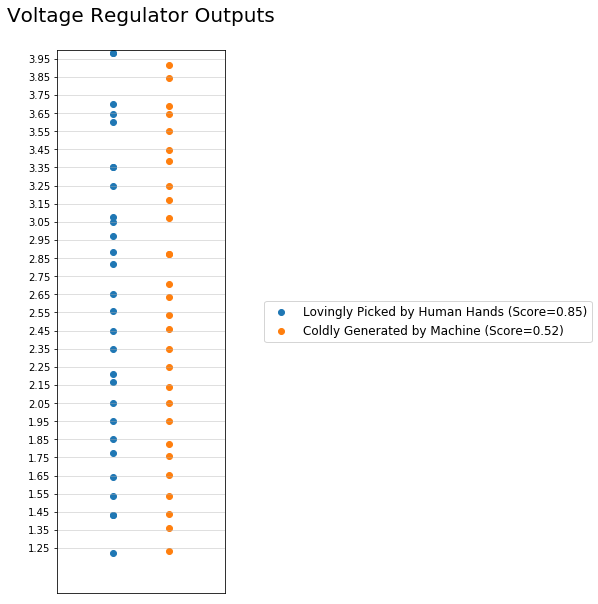

In [118]:
figure = plt.figure(1, figsize=(3,10))
x = [1 for _ in hand_picked_closest_values]
plt.scatter(x,hand_picked_closest_values,label="Lovingly Picked by Human Hands (Score=0.85)")
x = [2 for _ in best_found_closest_values]
plt.scatter(x,best_found_closest_values,label="Coldly Generated by Machine (Score=0.52)")
plt.xlim(0,3)
plt.ylim(1,4)
plt.grid(True, 'both', 'y', alpha=0.5)
plt.yticks(desired_vout_values)
plt.xticks([])
plt.legend(loc="center left", bbox_to_anchor=[1.2,0.5], prop={'size':12})
plt.title("Voltage Regulator Outputs\n", fontsize=20)
plt.show()

### Running the GA

In [ ]:
%%capture --no-stdout --no-display

from deap import creator, base, tools, algorithms

creator.create('FitnessMin', base.Fitness, weights=(-1.0,))
#creator.create('Individual', list, fitness=creator.FitnessMin)
creator.create('Individual', Chromosome, fitness=creator.FitnessMin)

resistor_values = [1,1,1,1,1,1,1,1]
num_switches = 8
num_nodes = 2 * (num_switches + len(resistor_values)) + 3
supply_voltage = 9 @ u_V

population_size = 200
num_generations = 15

toolbox = base.Toolbox()
toolbox.register('individual', generate_random_chromosome_2, creator.Individual, resistor_values, num_switches)
toolbox.register('population', tools.initRepeat, list, toolbox.individual, n=population_size)
toolbox.register('evaluate', evaluate_fitness)
#toolbox.register('mate', tools.cxOnePoint)
#toolbox.register('mate', tools.cxTwoPoint)
toolbox.register('mate', tools.cxUniform, indpb=0.1)
toolbox.register('mutate', tools.mutUniformInt, low=0, up=num_nodes-1, indpb=0.1)
#toolbox.register('select', tools.selNSGA2)
toolbox.register('select', tools.selBest)

population = toolbox.population()
fits = toolbox.map(toolbox.evaluate, population)
for fit, ind in zip(fits, population):
    ind.fitness.values = fit

print('\n\nFitnesses of Initial Population', '*' * 80)
for ind in population:
    print('fit =', ind.fitness.values)
print('*' * 80, '\n\n')
    
for gen in range(num_generations):
    offspring = algorithms.varOr(population, toolbox, lambda_=population_size, cxpb=0.5, mutpb=0.1)
    fits = toolbox.map(toolbox.evaluate, offspring)
    for fit, ind in zip(fits, offspring):
        ind.fitness.values = fit
    population = toolbox.select(offspring+population, k=population_size)
    print('\nGeneration =', gen, 'Best Fitness =', min([ind.fitness.values for ind in population]))

In [ ]:
reset()
global gnd, GND
GND = gnd = Net('0')
circ, nodes, sim_time = create_circuit(population[0], resistor_values, num_switches)
#print(circ)
sim = circ.simulator()
step_time = 0.01 @ u_ms
waveforms = sim.transient(step_time=step_time, end_time=sim_time@u_ms)
vout = waveforms[node(nodes[1])]

In [ ]:
vout_values = [round(v.value,2) for v in vout if 0<=v.value<=10]
print(sorted(set(vout_values)))
figure = plt.figure(1)
x = [1 for _ in vout_values]
plt.scatter(x,vout_values)
plt.xlim(0,2)
plt.ylim(0,4)
plt.show()

In [ ]:
import matplotlib.pyplot as plt
%matplotlib inline

time = waveforms.time                # Time values for each point on the waveforms.
vout = waveforms[node(nodes[1])]

figure = plt.figure(1)
plt.title('Voltage Regulator Output')
plt.xlabel('Time (ms)')
plt.ylabel('Voltage (V)')
plt.ylim(0,10)
#plt.xlim(0,100)
plt.plot(time*1000, vout)
plt.show()

### The Result

## The PCB